<h1>Quality Control Standard Pipeline</h1>

<h2>Read Me</h2>

<p>This pipeline is to evaluate the Quality Control Standard and compare different normalizations (TIC, IS) and evaluation QCS and tissue sample.</p>
<p>After evaluation, we can correct batch effects using three packages (Combat, WaveICA, NormAE) and compare them again.</p>
<p>Then, we can apply this pipeline to varying tissue samples.</p>
<p>It is recommended to replace the existing files into new files (such as upload the new file and change the name in cells for check file path).</p>
<p>As well each time we run the cell, it will overwrite the file (for instance, each time you run combat it will overwrite combat results for csv file).</p>
<p>To run this notebook, it is recommended to run via anaconda with r-environment or through vs code with r-environment.</p>

<h3 style="font-weight: bold; font-size: smaller;">Step 1: Go to Anaconda Navigator</h3>
<h3 style="font-weight: bold; font-size: smaller;">Step 2: Go to Environment</h3>
<h3 style="font-weight: bold; font-size: smaller;">Step 3: Click Create (plus sign) and create R-environment (choose R and give a name)</h3>
<h3 style="font-weight: bold; font-size: smaller;">Step 4: Either run notebook in VS Code or Anaconda (JupyterLab)</h3>
<h3 style="font-weight: bold; font-size: smaller;">Step 5: If you choose VS Code, you need to choose kernel at the top right and choose Jupyter kernel (or R-env directly)</h3>


## Inputs ##
1) Data_matrix_no_normalization (csv file obtained from SciLs lab directly)
2) Data_matrix_TIC_normalization (csv file obtained from SciLs lab directly)
3) QCS Analytes m/z values (ie: propranolol 260.16, D7-propranolol 267.14) (input value *if using VS code, input at the top bar)
4) Batch_info (sample construction) (csv file check the given example file *need to have "injection.order" and "batch" column)
5) Sample_set (tissue sample names, check the example given)

## Packages to download ##

In [7]:
## Packages to download other packages ##
#remotes::install_github("Bioconductor/BiocManager")

## Packages for RSD overview table ##
install.packages("htmltools")
install.packages("kableExtra")
install.packages("IRdisplay")

## Packages for Violin plot ##
install.packages("ggplot2")
install.packages("dplyr")

## Packages for PCA plot ##
#install.packages("ggplot2")
install.packages("stringr")
install.packages("zoo")
#install.packages("dplyr")

## Packages for QCS PCA plot ##
install.packages("ggrepel")
install.packages("cowplot")
install.packages("gridExtra")

## Packages for Tissue PCA plot ##
#install.packages("ggplot2")
#install.packages("dplyr")
#install.packages("ggrepel")
#install.packages("gridExtra")

## Package for excel sheet creating ##
install.packages("openxlsx")

cat("\033[1mSuccessfully Downloaded Packages\033[0m\n")

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료



Successfully Downloaded Packages


## Demo 1: QCS EVALUATION ## 

<p>Here you can evaluate your Quality Control Standards for raw data, TIC normalized data, and IS normalized data. For evaluation we have QCS RSD calculation, intensity plot and violin plot to assess their variation throughout intra/inter batch.You can change the file path and file name accordingly and change the sample_set based on names of your tissue samples.</p>

In [8]:
### Please edit the file path, file name ###
no_normalization_data <- read.csv("input/119feature_T&QCS_BaseRemoval_noNorm.csv", # check file path
                                  header = FALSE,
                                  check.name = FALSE,
                                  stringsAsFactors = FALSE)

TIC_normalization_data <- read.csv("input/119feature_T&QCS_BaseRemoval_TICNorm.csv", # cehck file path
                                   header = FALSE,
                                   check.name = FALSE,
                                   stringsAsFactors = FALSE) 

propranolol_mz_value <- as.numeric(readline("Enter Propranolol m/z value: ")) ## ie: 260.186

d7_propranolol_mz_value <- as.numeric(readline("Enter D7-propranolol m/z value: ")) ## ie: 267.187

batch_info <- read.csv("input/batch_info_TIC.csv", # check file path
                       header = TRUE,
                       check.name = FALSE,
                       stringsAsFactors = FALSE) 

cat("Change the sample_set accordingly to the dataset!")
sample_set <- c("ChickenHeart", "ChickenLiver", "GoatLiver") # please check your sample set if they are correctly named

Enter Propranolol m/z value:  260.186
Enter D7-propranolol m/z value:  267.187


Change the sample_set accordingly to the dataset!

In [263]:
# Check if "injection.order" column exists
if ("injection.order" %in% colnames(batch_info)) {
    print("Column 'injection.order' exists.")
} else {
    print("Column 'injection.order' does not exist. Please check/edit colname")
}

# Check if "batch" column exists
if ("batch" %in% colnames(batch_info)) {
    print("Column 'batch' exists.")
} else {
    print("Column 'batch' does not exist. Please check/edit colname")
}

[1] "Column 'injection.order' exists."
[1] "Column 'batch' exists."


<h2>No normalization dataset</h2>

In [2]:
### Making formatted table no_normalization ###

## Format the csv datasets ##
# Read the CSV file
rawdata <- no_normalization_data
mz_header <- unlist(strsplit(as.character(rawdata[9, 1]), ";"))[1]
peak_header <- unlist(strsplit(as.character(rawdata[9, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]
peak <- unlist(strsplit(as.character(rawdata[10, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]

# Initialize lists
mz_data_list <- list()
peak_data_list <- list()
combined_batch_data_list <- list()

# Extract data
for (i in 10:nrow(rawdata)){
  mz <- unlist(strsplit(as.character(rawdata[[i, 1]]), ";"))[1]
  peak <- unlist(strsplit(as.character(rawdata[i, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]
  mz_data_list[[i - 9]] <- mz
  peak_data_list[[i - 9]] <- peak
  combined_batch_data <- c(mz, peak)
  combined_batch_data_list[[i - 9]] <- combined_batch_data
}

# Combine data into a data frame
combined_batch_data_df <- as.data.frame(do.call(rbind, combined_batch_data_list), stringsAsFactors = FALSE)

# Set column names
colnames(combined_batch_data_df) <- c("mz", peak_header)

# make name column
combined_batch_data_df$name <- combined_batch_data_df$mz  # Assign 'name' column which is same as mz column

# Set 'rt' column to a constant value
combined_batch_data_df$rt <- 666 # Assigning rt a random number

# Reorder columns again
combined_batch_data_df <- combined_batch_data_df[, c("name", "mz", "rt", peak_header)]

# check if each sample set exist in columns
sample_set_exist <- logical(length(sample_set))

# Check if each sample set exists in any of the column names
for (i in seq_along(sample_set)) {
  sample_set_exist[i] <- any(grepl(sample_set[i], colnames(combined_batch_data_df)))
}

# Identify sample sets that do not exist in any column names
missing_sample_sets <- sample_set[!sample_set_exist]

if (length(missing_sample_sets) > 0) {
  message("Error: The following sample sets do not exist in any column names: ", paste(missing_sample_sets, collapse = ", ", "check your sample_set"))
} else {
  message("Successfully made formatted table. All sample sets exist in at least one column name.")
}

# Check if m/z values exist in rows
propranolol_mz_exist <- any(combined_batch_data_df$mz == propranolol_mz_value)
d7_propranolol_mz_exist <- any(combined_batch_data_df$mz == d7_propranolol_mz_value)

# Print messages based on existence
if (!propranolol_mz_exist) {
  message("Error: The propranolol m/z value ", propranolol_mz_value, " does not exist in any row.")
} else {
  message("The propranolol m/z value ", propranolol_mz_value, " exists in at least one row.")
}

if (!d7_propranolol_mz_exist) {
  message("Error: The D7-propranolol m/z value ", d7_propranolol_mz_value, " does not exist in any row.")
} else {
  message("The D7-propranolol m/z value ", d7_propranolol_mz_value, " exists in at least one row.")
}

# uncomment to check 
#print(combined_batch_data_df)
#print(colnames(combined_batch_data_df))

# making as a formatted csv file
write.csv(combined_batch_data_df,
          file = "dataset/formatted_no_norm_batch_data.csv",
          row.names = FALSE)

## Make batch info combined dataframe ##
# dataframe with injection order, batch info, batch data
combined_batch_data_df_transposed <- as.data.frame(t(combined_batch_data_df[, -(1:3)]))
colnames(combined_batch_data_df_transposed) <- combined_batch_data_df[, 1]
combined_batch_info_data <- cbind(batch_info[,-1], combined_batch_data_df_transposed)  

Successfully made formatted table. All sample sets exist in at least one column name.

The propranolol m/z value 260.186 exists in at least one row.

The D7-propranolol m/z value 267.187 exists in at least one row.



In [3]:
## QCS RSD Calculation ##
# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
propranolol_data <- cbind(batch_info_columns, propranolol_peak_data)

d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
d7_propranolol_data <- cbind(batch_info_columns, d7_propranolol_peak_data)

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}

# usage:
rsd_propranolol <- calculate_batch_rsd(propranolol_data, propranolol_mz_value)
cat("m/z value:", propranolol_mz_value, "\n")
print(rsd_propranolol)
                           
rsd_d7_propranolol <- calculate_batch_rsd(d7_propranolol_data, d7_propranolol_mz_value)
cat("m/z value:", d7_propranolol_mz_value, "\n")
print(rsd_d7_propranolol)

m/z value: 260.186 
       Batch    RSD
1 Intraday 1  70.5%
2 Intraday 2 41.41%
3 Intraday 3 34.07%
4   Interday 52.05%
m/z value: 267.187 
       Batch    RSD
1 Intraday 1 73.81%
2 Intraday 2 39.71%
3 Intraday 3 35.57%
4   Interday 53.15%


<h2>TIC normalization dataset</h2>

In [4]:
### Making formatted table TIC_normalization ###

## Format the csv datasets ##
# Read the CSV file
rawdata <- TIC_normalization_data
mz_header <- unlist(strsplit(as.character(rawdata[9, 1]), ";"))[1]
peak_header <- unlist(strsplit(as.character(rawdata[9, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]
peak <- unlist(strsplit(as.character(rawdata[10, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]

# Initialize lists
mz_data_list <- list()
peak_data_list <- list()
combined_batch_data_list <- list()

# Extract data
for (i in 10:nrow(rawdata)){
  mz <- unlist(strsplit(as.character(rawdata[[i, 1]]), ";"))[1]
  peak <- unlist(strsplit(as.character(rawdata[i, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]
  mz_data_list[[i - 9]] <- mz
  peak_data_list[[i - 9]] <- peak
  combined_batch_data <- c(mz, peak)
  combined_batch_data_list[[i - 9]] <- combined_batch_data
}

# Combine data into a data frame
combined_batch_data_df_TIC <- as.data.frame(do.call(rbind, combined_batch_data_list), stringsAsFactors = FALSE)

# Set column names
colnames(combined_batch_data_df_TIC) <- c("mz", peak_header)

# make name column
combined_batch_data_df_TIC$name <- combined_batch_data_df_TIC$mz  # Assign 'name' column which is same as mz column

# Set 'rt' column to a constant value
combined_batch_data_df_TIC$rt <- 666 # Assigning rt a random number

# Reorder columns again
combined_batch_data_df_TIC <- combined_batch_data_df_TIC[, c("name", "mz", "rt", peak_header)]

# uncomment to check 
#print(combined_batch_data_df)
#print(colnames(combined_batch_data_df))

# making as a formatted csv file
write.csv(combined_batch_data_df_TIC,
          file = "dataset/formatted_TIC_norm_batch_data.csv",
          row.names = FALSE)

## Make batch info combined dataframe ##
# dataframe with injection order, batch info, batch data
combined_batch_data_df_transposed_TIC <- as.data.frame(t(combined_batch_data_df_TIC[, -(1:3)]))
colnames(combined_batch_data_df_transposed_TIC) <- combined_batch_data_df_TIC[, 1]

combined_batch_info_data_TIC <- cbind(batch_info[,-1], combined_batch_data_df_transposed_TIC)  

In [5]:
## QCS RSD Calculation ##
# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data_TIC, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
propranolol_data_TIC <- cbind(batch_info_columns, propranolol_peak_data)

d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
d7_propranolol_data_TIC <- cbind(batch_info_columns, d7_propranolol_peak_data)

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}

# usage:
rsd_propranolol_TIC <- calculate_batch_rsd(propranolol_data_TIC, propranolol_mz_value)
cat("m/z value:", propranolol_mz_value, "\n")
print(rsd_propranolol_TIC)
                           
rsd_d7_propranolol_TIC <- calculate_batch_rsd(d7_propranolol_data_TIC, d7_propranolol_mz_value)
cat("m/z value:", d7_propranolol_mz_value, "\n")
print(rsd_d7_propranolol_TIC)

m/z value: 260.186 
       Batch    RSD
1 Intraday 1 63.51%
2 Intraday 2 38.88%
3 Intraday 3 36.26%
4   Interday 50.68%
m/z value: 267.187 
       Batch    RSD
1 Intraday 1 66.96%
2 Intraday 2 38.58%
3 Intraday 3 36.63%
4   Interday 53.14%


## IS Normalization ##

In [6]:
# IS normalization on no normalized dataset
# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
# propranolol
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
col_names <- rownames(propranolol_peak_data)
propranolol_data <- cbind(batch_info_columns, propranolol_peak_data)

propranolol_peak_data_trans <- as.data.frame(t(propranolol_peak_data))
colnames(propranolol_peak_data_trans) <- col_names 
propranolol_peak_data_trans <- as.numeric(propranolol_peak_data_trans)

# IS 
d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
col_names <- rownames(d7_propranolol_peak_data)
d7_propranolol_data <- cbind(batch_info_columns, d7_propranolol_peak_data)

d7_propranolol_peak_data_trans <- as.data.frame(t(d7_propranolol_peak_data))
colnames(d7_propranolol_peak_data_trans) <- col_names 
d7_propranolol_peak_data_trans <- as.numeric(d7_propranolol_peak_data_trans)

# IS normalization
ratio <- propranolol_peak_data_trans / d7_propranolol_peak_data_trans
ratio_df <- as.data.frame(ratio)
rownames(ratio_df) <- col_names
ratio_data <- cbind(batch_info_columns,ratio_df)

ratio_data_csv <- as.data.frame(t(ratio_data))
rownames(ratio_data_csv) <- colnames(ratio_data)
#print(ratio_data_app_csv)

# making as a formatted csv file
write.csv(ratio_data_csv,
          file = "dataset/formatted_IS_norm_batch_data.csv",
          row.names = TRUE)

In [7]:
# RSD calculation IS norm
## QCS RSD Calculation ## 

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}

# usage:
rsd_ratio <- calculate_batch_rsd(ratio_data, "ratio")
cat("m/z value:", "IS_Norm", "\n")
print(rsd_ratio)

m/z value: IS_Norm 
       Batch    RSD
1 Intraday 1 10.47%
2 Intraday 2  13.6%
3 Intraday 3 17.12%
4   Interday 14.11%


In [8]:
## Overview RSD Table Propranolol ##
overview_table_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  No_Norm_RSD = c(rsd_propranolol[,2]),
  TIC_Norm_RSD = c(rsd_propranolol_TIC[,2]),
  IS_Norm_RSD = c(rsd_ratio[,2])  
)
# Set the column names
colnames(overview_table_pro) <- c(paste("mz value:", propranolol_mz_value), "No_norm", "TIC_norm", "IS_norm")

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying rsd table
display_rsd_table_pro <- kable(overview_table_pro, format = "html", row.names = FALSE, 
                               col.names = c(paste("m/z value:", propranolol_mz_value), "No_norm", "TIC_norm", "IS_norm")) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_pro <- paste("<h2 style='text-align: center;'>Overview RSD Table Propranolol</h2>", 
                               as.character(display_rsd_table_pro))

# Save HTML table to a file
display_html(display_rsd_table_pro)
print("Notice: IS_norm = propranolol / d7_propranolol")


다음의 패키지를 부착합니다: ‘kableExtra’


The following object is masked from ‘package:dplyr’:

    group_rows




m/z value: 260.186,No_norm,TIC_norm,IS_norm
Intraday 1,70.5%,63.51%,10.47%
Intraday 2,41.41%,38.88%,13.6%
Intraday 3,34.07%,36.26%,17.12%
Interday,52.05%,50.68%,14.11%


[1] "Notice: IS_norm = propranolol / d7_propranolol"


In [9]:
## Overview RSD Table D7-propranolol ##
overview_table_d7 <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  No_Norm_RSD = c(rsd_d7_propranolol[,2]),
  TIC_Norm_RSD = c(rsd_d7_propranolol_TIC[,2]),
  IS_Norm_RSD = c(rsd_ratio[,2])  
)
# Set the column names
colnames(overview_table_d7) <- c(paste("mz value:", d7_propranolol_mz_value), "No_norm", "TIC_norm", "IS_norm")

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying rsd table
display_rsd_table_d7 <- kable(overview_table_d7, format = "html", row.names = FALSE, 
                               col.names = c(paste("m/z value:", d7_propranolol_mz_value), "No_norm", "TIC_norm", "IS_norm")) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_d7 <- paste("<h2 style='text-align: center;'>Overview RSD Table D7-Propranolol</h2>", 
                               as.character(display_rsd_table_d7))

# Save HTML table to a file
display_html(display_rsd_table_d7)
print("Notice: IS_norm = propranolol / d7_propranolol")

m/z value: 267.187,No_norm,TIC_norm,IS_norm
Intraday 1,73.81%,66.96%,10.47%
Intraday 2,39.71%,38.58%,13.6%
Intraday 3,35.57%,36.63%,17.12%
Interday,53.15%,53.14%,14.11%


[1] "Notice: IS_norm = propranolol / d7_propranolol"


<h2>Visualization</h2>

1. Intensity Plot (Intentisy vs Measurement Order) 
2. Violin Plot
3. PCA Plot (no norm, TIC norm) 

Red dotted line represents mean intensity. Black dotted lines represent standard deviation

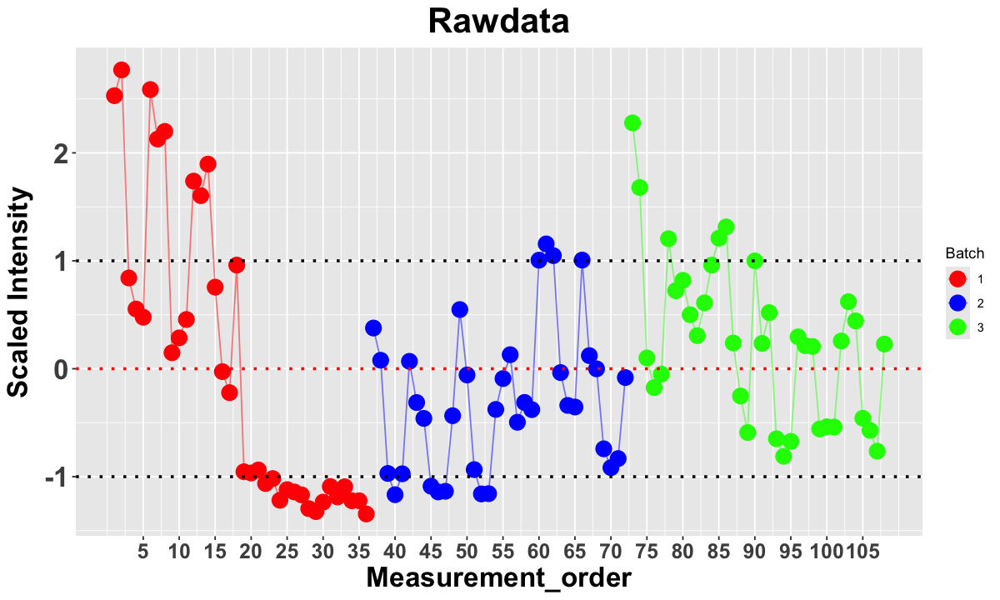

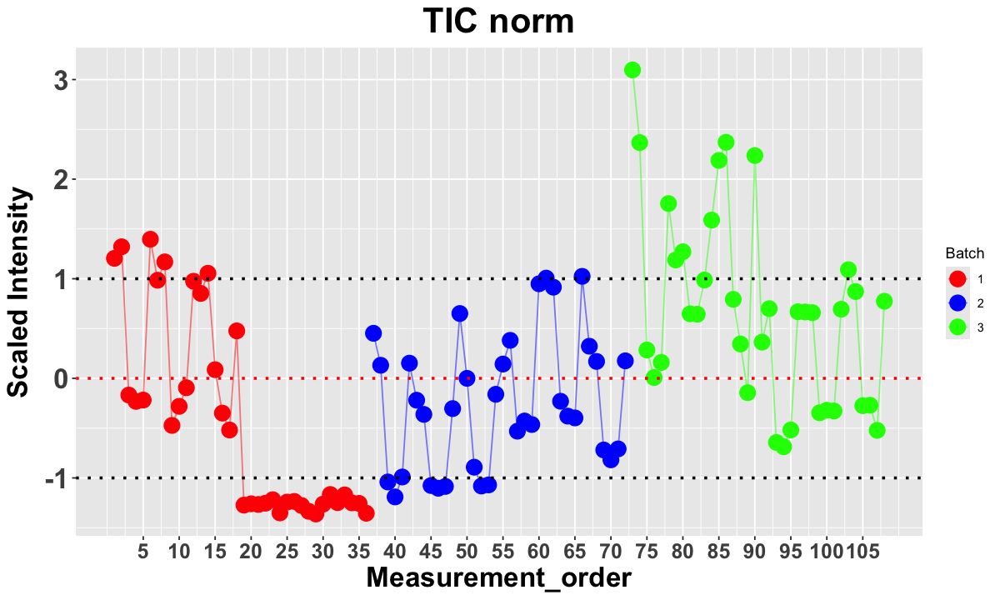

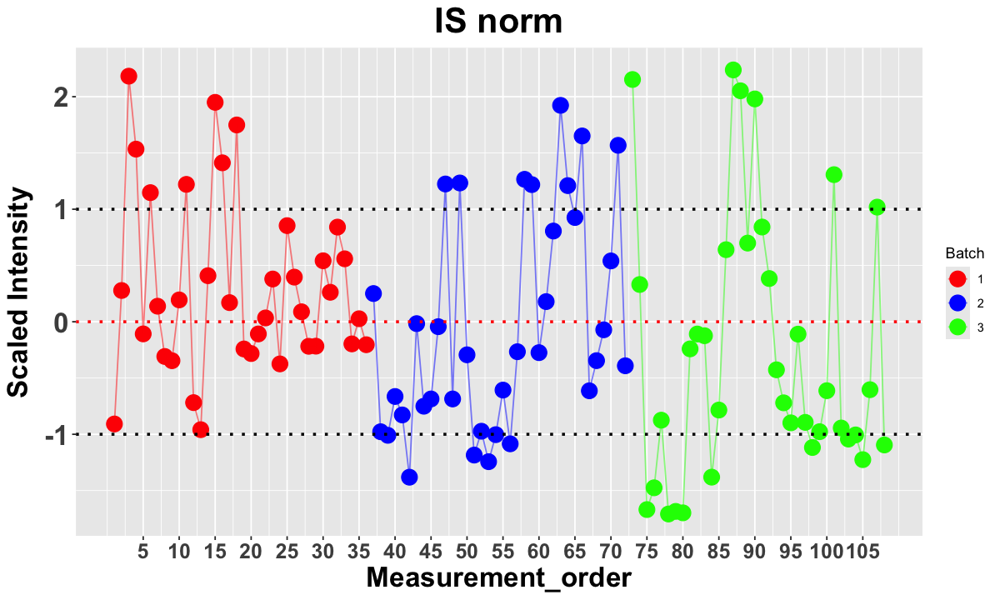

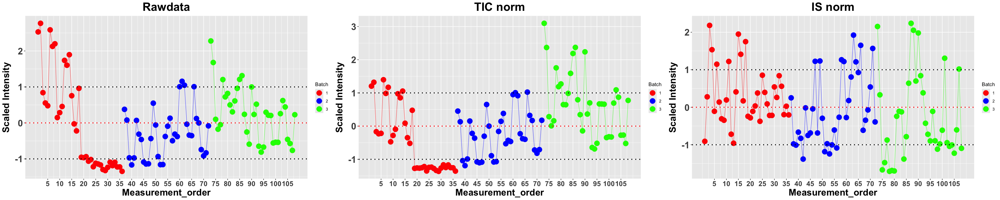

In [64]:
# Intensity Plot (Intensity vs Measurement Order)
# raw data #
# extract only qcs
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data, sample_set)

# ordering by injection_order
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

batch <- qcs_batch_info_data_ordered$batch

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))
propranolol_intensity <- scale(propranolol_intensity_values)

# intensity plot based on measurement_order
qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))

plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = propranolol_intensity
)

mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)

cat("Red dotted line represents mean intensity. Black dotted lines represent standard deviation")
# intensity plot
library(ggplot2)
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# intensity plot with mean and standard deviation lines
intensity_plot <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) +  # Let the points be colored according to batch
  geom_line(aes(group = Batch), alpha = 0.5) +  # Add lines between points, grouped by Batch
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  # Add black dotted line for mean
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") +  # Set axis labels
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) +  # Set breaks for x-axis
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("Rawdata") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"),  # Center and bold the title
    axis.title.x = element_text(size = 20, face = "bold"),  # Adjust x-axis label size and make it bold
    axis.title.y = element_text(size = 20, face = "bold"),  # Adjust y-axis label size and make it bold
    axis.text.x = element_text(size = 15, face = "bold"),  # Adjust x-axis tick label size and make it bold
    axis.text.y = element_text(size = 20, face = "bold")  # Adjust y-axis tick label size and make it bold
  )

print(intensity_plot)

# TIC norm #
# Intensity Plot (Intensity vs Measurement Order)
# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data_TIC, sample_set)

# ordering by injection_order
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

batch <- qcs_batch_info_data_ordered$batch

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))
propranolol_intensity <- scale(propranolol_intensity_values)

# intensity plot based on measurement_order
qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))

plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = propranolol_intensity
)

mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)

# intensity plot
library(ggplot2)
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# intensity plot with mean and standard deviation lines
intensity_plot_TIC <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) +  # Let the points be colored according to batch
  geom_line(aes(group = Batch), alpha = 0.5) +  # Add lines between points, grouped by Batch
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  # Add black dotted line for mean
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") +  # Set axis labels
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) +  # Set breaks for x-axis
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("TIC norm") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"),  # Center and bold the title
    axis.title.x = element_text(size = 20, face = "bold"),  # Adjust x-axis label size and make it bold
    axis.title.y = element_text(size = 20, face = "bold"),  # Adjust y-axis label size and make it bold
    axis.text.x = element_text(size = 15, face = "bold"),  # Adjust x-axis tick label size and make it bold
    axis.text.y = element_text(size = 20, face = "bold")  # Adjust y-axis tick label size and make it bold
  )
print(intensity_plot_TIC)

# IS norm #
# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data, sample_set)
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))
batch <- qcs_batch_info_data_ordered$batch

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))

d7_propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == d7_propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
d7_propranolol_intensity_values <- as.numeric(unlist(d7_propranolol_intensity))

ratio_intensity <- propranolol_intensity_values / d7_propranolol_intensity_values
ratio_intensity <- scale(ratio_intensity)


# making data frame
plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = ratio_intensity
)

mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)

# intensity plot
library(ggplot2)
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# intensity plot with mean and standard deviation lines
intensity_plot_IS <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) +  # Let the points be colored according to batch
  geom_line(aes(group = Batch), alpha = 0.5) +  # Add lines between points, grouped by Batch
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  # Add black dotted line for mean
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") +  # Set axis labels
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) +  # Set breaks for x-axis
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("IS norm") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"),  # Center and bold the title
    axis.title.x = element_text(size = 20, face = "bold"),  # Adjust x-axis label size and make it bold
    axis.title.y = element_text(size = 20, face = "bold"),  # Adjust y-axis label size and make it bold
    axis.text.x = element_text(size = 15, face = "bold"),  # Adjust x-axis tick label size and make it bold
    axis.text.y = element_text(size = 20, face = "bold")  # Adjust y-axis tick label size and make it bold
  )
print(intensity_plot_IS)

# Display combined
library(gridExtra)
options(repr.plot.width = 30, repr.plot.height = 6)  # Adjust width and height as desired
combined_intensity_plot <- grid.arrange(intensity_plot, intensity_plot_TIC, intensity_plot_IS, ncol = 3)

Gray dotted line represents median

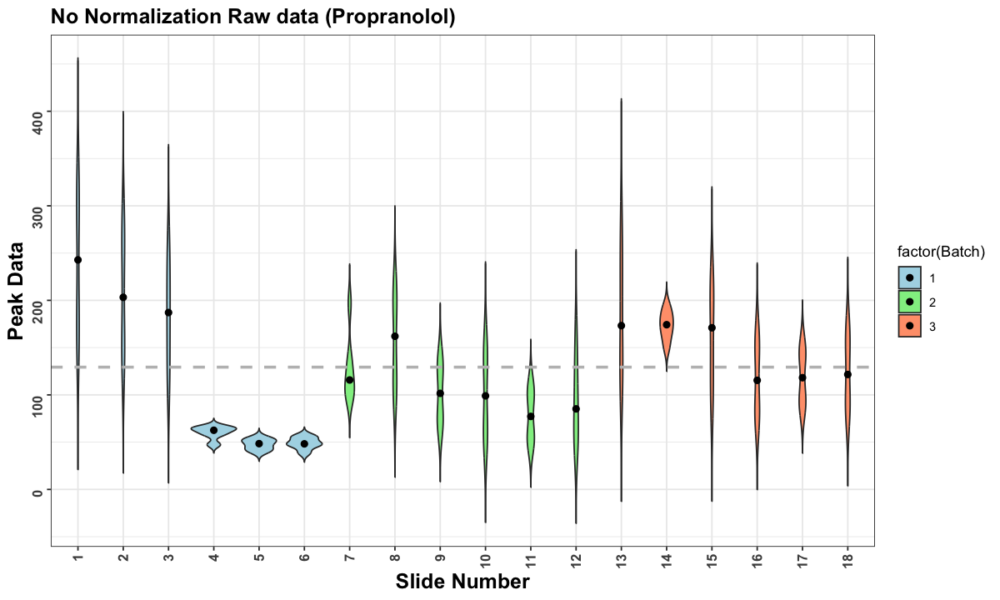

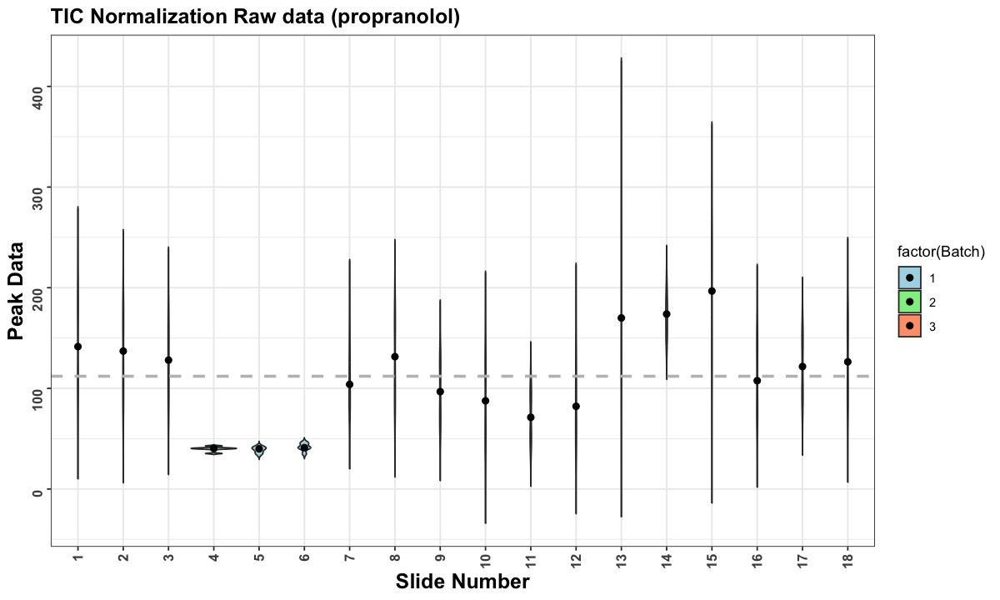

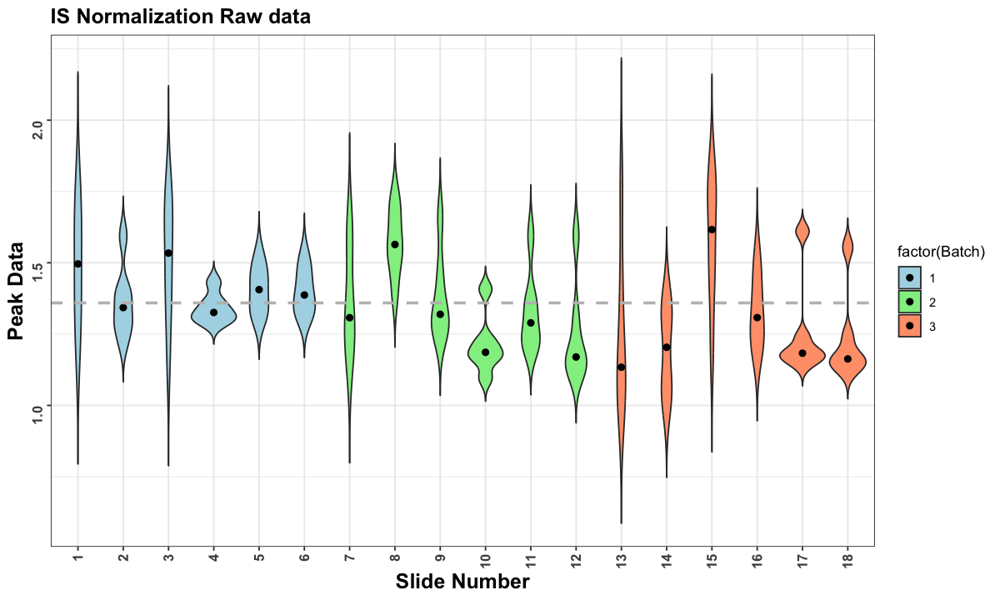

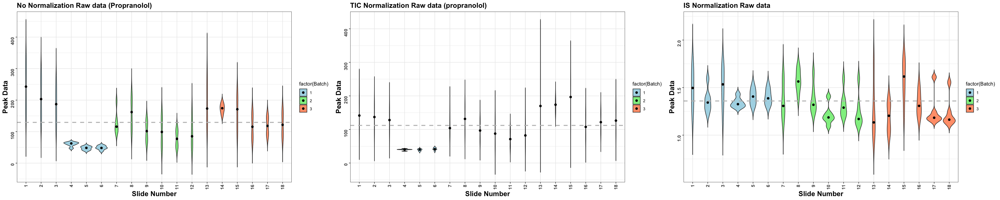

In [65]:
## Violin Plot ##

# violin plot for propranolol no normalization
# Load required library
library(ggplot2)
library(dplyr)

propranolol_data_trans <- as.data.frame(t(propranolol_data))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data <- violin_data %>%
  arrange(Slide)

# find mean of all samples
mean_value <- mean(violin_data$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired
cat("Gray dotted line represents median")

# Create a violin plot with adjusted width
violin_plot <- ggplot(violin_data, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "No Normalization Raw data (Propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot)

# violin plot for propranolol TIC normalization
propranolol_data_trans <- as.data.frame(t(propranolol_data_TIC))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_TIC <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_TIC <- violin_data_TIC %>%
  arrange(Slide)

# find mean of all samples
mean_value_TIC <- mean(violin_data_TIC$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_TIC <- ggplot(violin_data_TIC, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_TIC, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "TIC Normalization Raw data (propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_TIC)

# violin plot for IS_norm
propranolol_data_trans <- as.data.frame(t(ratio_data))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_IS <- data.frame(
  Slide = slide_number,
  Batch = ratio_data$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_IS <- violin_data_IS %>%
  arrange(Slide)

# find mean of all samples
mean_value_IS <- mean(violin_data_IS$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_IS <- ggplot(violin_data_IS, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_IS, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "IS Normalization Raw data") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_IS)

# Display combined
library(gridExtra)
options(repr.plot.width = 30, repr.plot.height = 6)  # Adjust width and height as desired
combined_violin_plot <- grid.arrange(violin_plot, violin_plot_TIC, violin_plot_IS, ncol = 3)

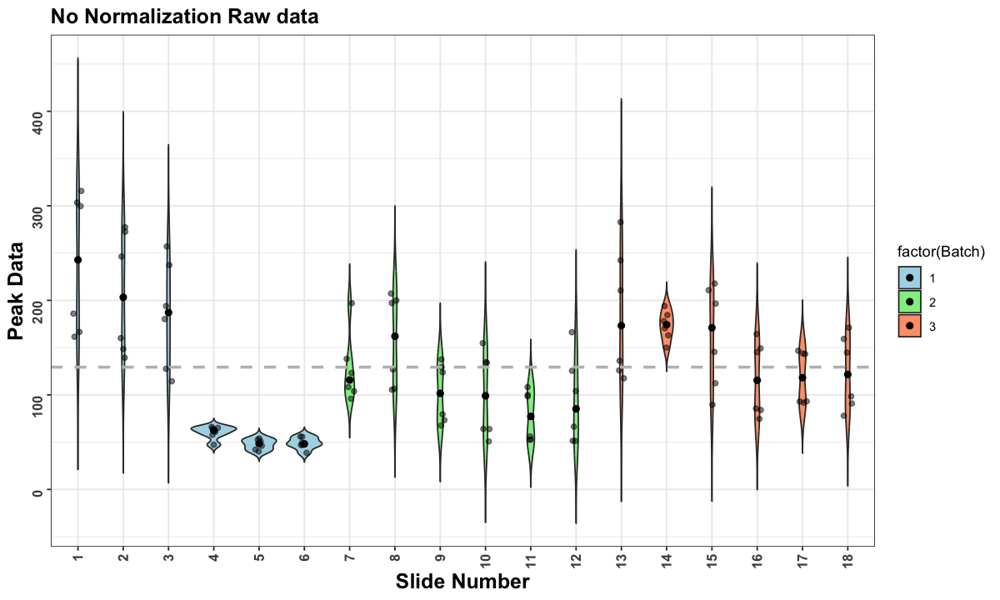

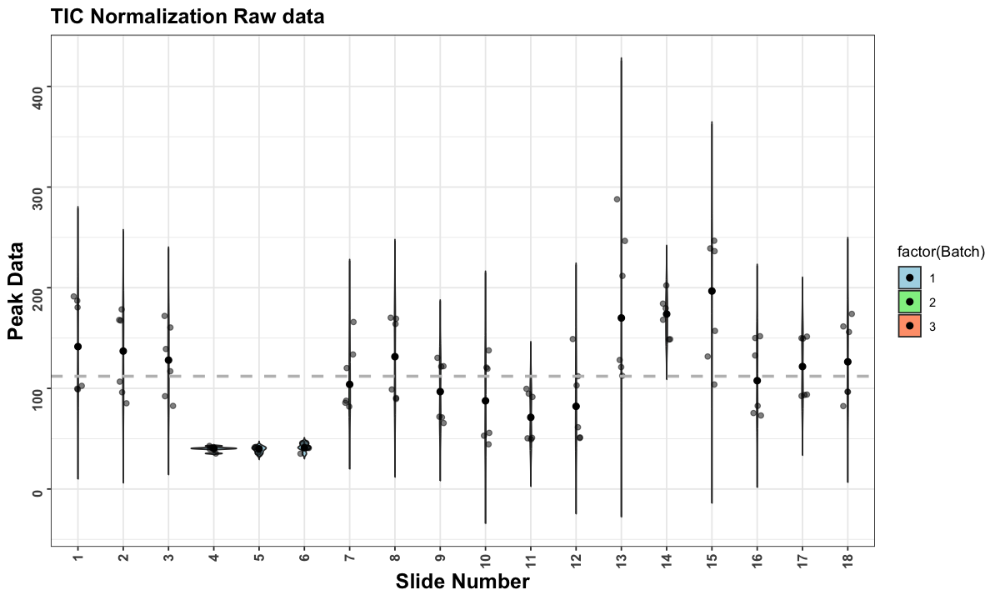

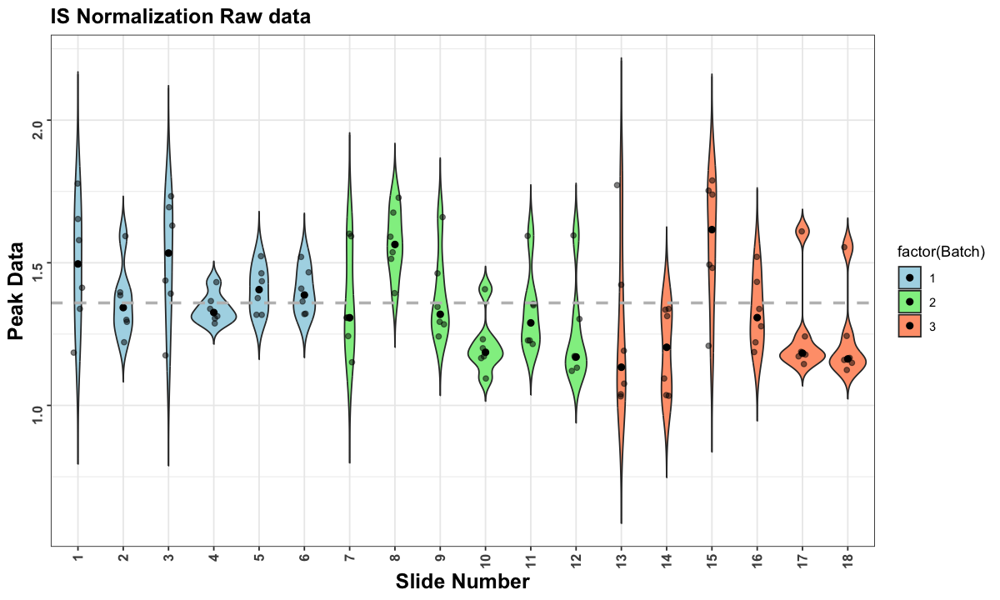

In [66]:
## Violin Plot with Jitter ##
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired


# no norm #
violin_plot_jit <- ggplot(violin_data, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "No Normalization Raw data") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )
print(violin_plot_jit)


# TIC norm #
violin_plot_TIC_jit <- ggplot(violin_data_TIC, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value_TIC, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "TIC Normalization Raw data") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )
print(violin_plot_TIC_jit)

# IS norm #
violin_plot_IS_jit <- ggplot(violin_data_IS, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value_IS, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "IS Normalization Raw data") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot with dots
print(violin_plot_IS_jit)

Total Score: 80.58 %

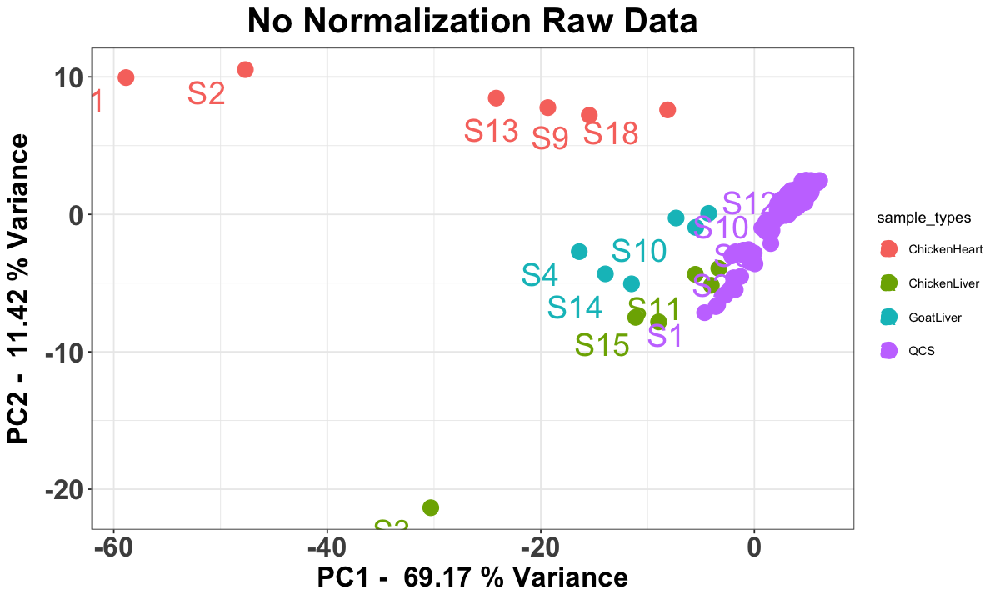

In [67]:
## PCA plot ##
# pca plot for no norm
library(ggplot2)
library(stringr)
library(zoo)
library(dplyr)

# format pca plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# convert all columns combined_batch_data_df as numeric
combined_batch_data_df_numeric <- combined_batch_data_df %>%
  mutate_all(as.numeric)

# extract combined_batch_data df 
adjusted <- combined_batch_data_df_numeric[, -(1:3)]
batch_matrix <- data.frame(adjusted)
sample_ID <- str_extract(colnames(batch_matrix), "(S|m/z)\\d+")

# Create the regular expression pattern for sample_set
pattern <- paste(sample_set, collapse = "|")

# Extract sample types from column names using the defined pattern
sample_types <- str_extract(colnames(batch_matrix), pattern)
sample_types[is.na(sample_types)] <- "QCS"

# Transpose the data so that samples are on rows and features on columns
batch_data_t <- t(as.matrix(batch_matrix))

# Create a new data frame with the transposed matrix
batch_data_t_df <- as.data.frame(batch_data_t)

# Perform PCA, assuming batch_data_t_df contains the transposed data
batch_pca <- prcomp(batch_data_t_df, center = TRUE, scale. = TRUE)

# Create a data frame for plotting the PCA
pca_data <- data.frame(Sample = sample_ID, batch_pca$x)

# Plot PCA with colored sample dots based on sample type
pca_data$Score <- pca_data$PC1 + pca_data$PC2
pca_data$Type <- sample_types

# Calculate the PC1 and PC2 scores
pc1_score <- batch_pca$sdev[1]^2
pc2_score <- batch_pca$sdev[2]^2

# Calculate the total score as the sum of PC1 and PC2 scores
total_score <- pc1_score + pc2_score

# Display the score 
total_score_text_recon <- paste("Total Score:", round(total_score / sum(batch_pca$sdev^2) * 100, 2), "%")
cat(total_score_text_recon)

# Create PCA plot
plot <- ggplot(pca_data, aes(x = PC1, y = PC2, color = sample_types, label = Sample)) +
  geom_point(size = 5) +
  geom_text(hjust = 1.5, vjust = 1.5, size = 8, check_overlap = TRUE) +  # Increased label size
  xlab(paste("PC1 - ", round(batch_pca$sdev[1]^2 / sum(batch_pca$sdev^2) * 100, 2), "% Variance")) +
  ylab(paste("PC2 - ", round(batch_pca$sdev[2]^2 / sum(batch_pca$sdev^2) * 100, 2), "% Variance")) +
  ggtitle("No Normalization Raw Data") +
  theme_bw() +
  theme(legend.position = "right", axis.text = element_text(size = 20, face='bold'), 
        axis.title = element_text(size = 20, face='bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'))
print(plot)

Total Score: 86.3 %

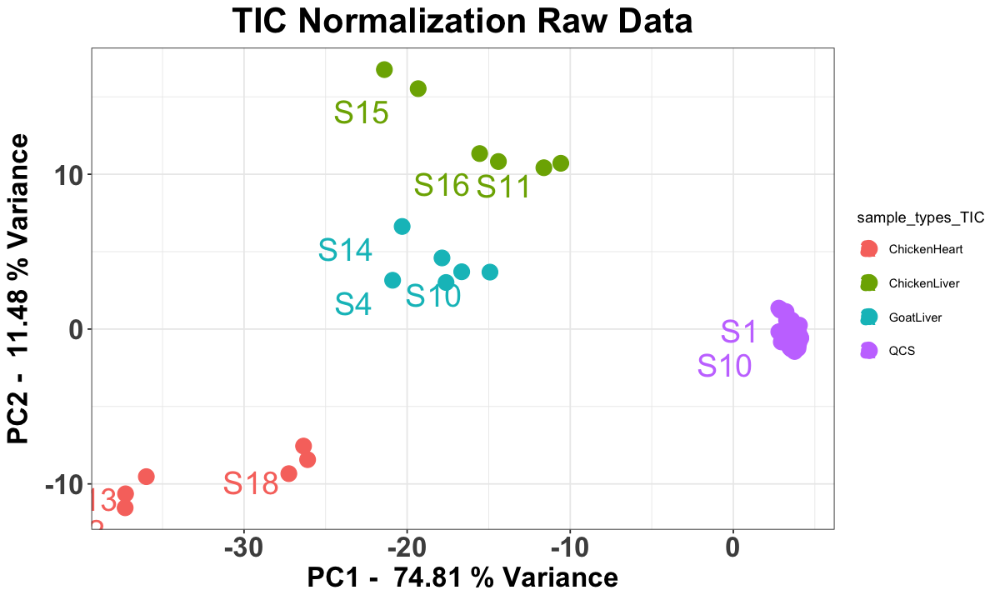

In [68]:
## PCA plot ##
# pca plot for TIC norm
library(ggplot2)
library(stringr)
library(zoo)
library(dplyr)

# format pca plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# convert all columns combined_batch_data_df as numeric
combined_batch_data_df_numeric <- combined_batch_data_df_TIC %>%
  mutate_all(as.numeric)

# extract combined_batch_data df 
adjusted <- combined_batch_data_df_numeric[, -(1:3)]
batch_matrix <- data.frame(adjusted)
sample_ID <- str_extract(colnames(batch_matrix), "(S|m/z)\\d+")

# Create the regular expression pattern for sample_set
pattern <- paste(sample_set, collapse = "|")

# Extract sample types from column names using the defined pattern
sample_types_TIC <- str_extract(colnames(batch_matrix), pattern)
sample_types_TIC[is.na(sample_types_TIC)] <- "QCS"

# Transpose the data so that samples are on rows and features on columns
batch_data_t <- t(as.matrix(batch_matrix))

# Create a new data frame with the transposed matrix
batch_data_t_df <- as.data.frame(batch_data_t)

# Perform PCA, assuming batch_data_t_df contains the transposed data
batch_pca_TIC <- prcomp(batch_data_t_df, center = TRUE, scale. = TRUE)

# Create a data frame for plotting the PCA
pca_data_TIC <- data.frame(Sample = sample_ID, batch_pca_TIC$x)

# Plot PCA with colored sample dots based on sample type
pca_data_TIC$Score <- pca_data_TIC$PC1 + pca_data_TIC$PC2
pca_data_TIC$Type <- sample_types_TIC

# Calculate the PC1 and PC2 scores
pc1_score <- batch_pca_TIC$sdev[1]^2
pc2_score <- batch_pca_TIC$sdev[2]^2

# Calculate the total score as the sum of PC1 and PC2 scores
total_score <- pc1_score + pc2_score

# Display the score 
total_score_text_recon <- paste("Total Score:", round(total_score / sum(batch_pca_TIC$sdev^2) * 100, 2), "%")
cat(total_score_text_recon)

# Create PCA plot
plot_TIC <- ggplot(pca_data_TIC, aes(x = PC1, y = PC2, color = sample_types_TIC, label = Sample)) +
  geom_point(size = 5) +
  geom_text(hjust = 1.5, vjust = 1.5, size = 8, check_overlap = TRUE) +  # Increased label size
  xlab(paste("PC1 - ", round(batch_pca_TIC$sdev[1]^2 / sum(batch_pca_TIC$sdev^2) * 100, 2), "% Variance")) +
  ylab(paste("PC2 - ", round(batch_pca_TIC$sdev[2]^2 / sum(batch_pca_TIC$sdev^2) * 100, 2), "% Variance")) +
  ggtitle("TIC Normalization Raw Data") +
  theme_bw() +
  theme(legend.position = "right", axis.text = element_text(size = 20, face='bold'), 
        axis.title = element_text(size = 20, face='bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'))
print(plot_TIC)

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


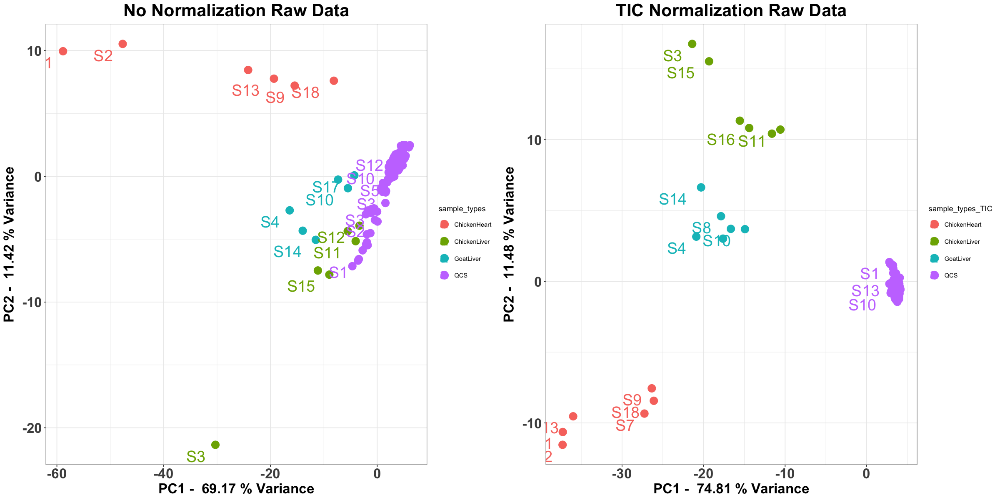

In [69]:
## Overview PCA Plot ##
library(gridExtra)
options(repr.plot.width = 20, repr.plot.height = 10)
combined_plots <- grid.arrange(plot, plot_TIC, ncol = 2)
print(combined_plots)

## Demo 2: QCS + Tissue Evaluation and Correction ##
1. QCS RSD 
2. QCS PCA plot --> Average distance of QCS
3. Tissue RSD 
4. Tissue PCA plot --> Intra/Intergroup distance of Tissue Samples
5. Correction
6. Comparision

## QCS RSD ##

In [70]:
## Overview RSD Table Propranolol ##
overview_table_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  No_Norm_RSD = c(rsd_propranolol[,2]),
  TIC_Norm_RSD = c(rsd_propranolol_TIC[,2]),
  IS_Norm_RSD = c(rsd_ratio[,2])  
)
# Set the column names
colnames(overview_table_pro) <- c(paste("mz value:", propranolol_mz_value), "No_norm", "TIC_norm", "IS_norm")

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying rsd table
display_rsd_table_pro <- kable(overview_table_pro, format = "html", row.names = FALSE, 
                               col.names = c(paste("m/z value:", propranolol_mz_value), "No_norm", "TIC_norm", "IS_norm")) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_pro <- paste("<h2 style='text-align: center;'>Overview RSD Table Propranolol</h2>", 
                               as.character(display_rsd_table_pro))

# Save HTML table to a file
display_html(display_rsd_table_pro)

m/z value: 260.186,No_norm,TIC_norm,IS_norm
Intraday 1,70.5%,63.51%,10.47%
Intraday 2,41.41%,38.88%,13.6%
Intraday 3,34.07%,36.26%,17.12%
Interday,52.05%,50.68%,14.11%


## QCS PCA Plot ##

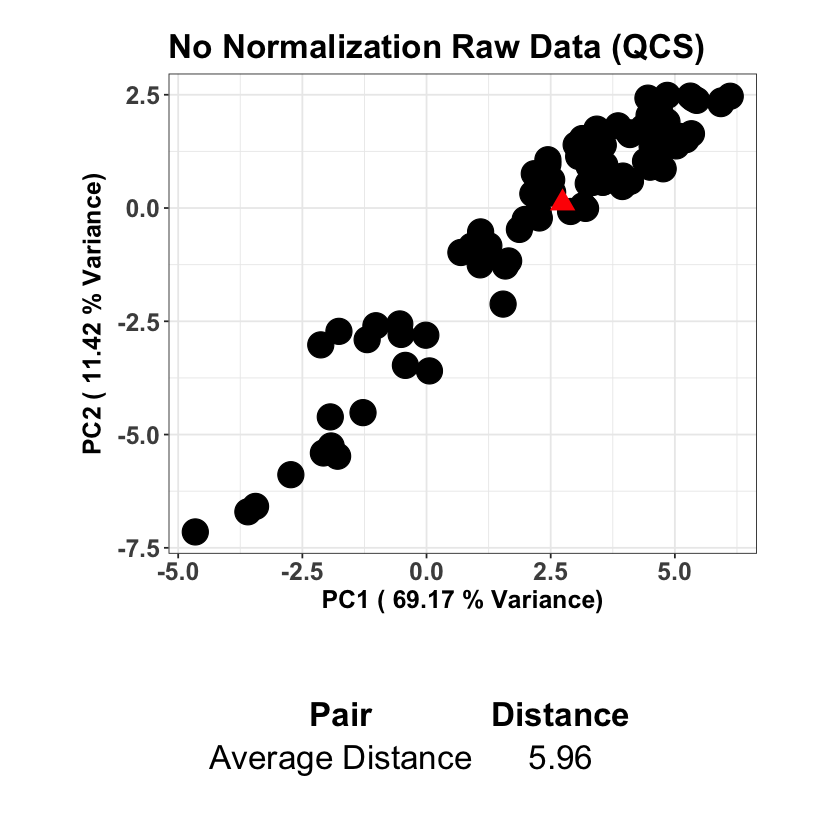

In [71]:
## PCA plot of QCS ##
# no normalization raw data
# Load necessary libraries
library(ggplot2)
library(ggrepel)
library(cowplot)
library(gridExtra)

# gets rid of plot format
options(repr.plot.width = NULL, repr.plot.height = NULL)

# Calculate PCA scores
pca_scores <- batch_pca$x

# Identify QCS samples based on sample types
qcs_samples <- which(sample_types == "QCS")

# Extract PCA scores for QCS samples
qcs_scores <- pca_scores[qcs_samples, ]

# Compute the centroid of QCS samples
qcs_centroid <- colMeans(qcs_scores)

# Calculate PC1 and PC2 variances
pc1_variance <- round(batch_pca$sdev[1]^2 / sum(batch_pca$sdev^2) * 100, 2)
pc2_variance <- round(batch_pca$sdev[2]^2 / sum(batch_pca$sdev^2) * 100, 2)

# Plot PCA plot with QCS samples and their centroid
pca_plot_qcs <- ggplot(data.frame(PC1 = qcs_scores[,1], PC2 = qcs_scores[,2]), aes(x = PC1, y = PC2)) +
  geom_point(size = 7) +  # Plot QCS samples
  geom_point(data = data.frame(PC1 = qcs_centroid[1], PC2 = qcs_centroid[2]), aes(x = PC1, y = PC2), shape = 17, fill = "red", color = "red", size = 5) +  # Plot centroid as triangle with filled red color
  labs(x = paste("PC1 (", pc1_variance, "% Variance)"), y = paste("PC2 (", pc2_variance, "% Variance)"), title = "No Normalization Raw Data (QCS)") +
  theme_bw() +
  theme(axis.title.x = element_text(face = "bold", size = 15),
        axis.title.y = element_text(face = "bold", size = 15),
        axis.text = element_text(size = 15, face = "bold"),
        plot.margin = margin(20, 50, 10, 50),  # Adjust the bottom margin to 10 units
        plot.title = element_text(face = "bold", size = 20))  # Make the plot title bold and size 20

# Calculate average distance of QCS samples from the centroid
qcs_centroid_distances <- sqrt(rowSums((qcs_scores - qcs_centroid)^2))
average_qcs_distance <- mean(qcs_centroid_distances)

# Create a data frame for average distance
average_distance_qcs_df <- data.frame(
  Pair = "Average Distance",
  Distance = average_qcs_distance
)

# Round distances for better presentation
average_distance_qcs_df$Distance <- round(average_distance_qcs_df$Distance, 2)

# Create a table plot
table_plot_qcs <- tableGrob(average_distance_qcs_df, theme = ttheme_minimal(base_size = 20), rows = NULL)

# Combine the PCA plot and the table
combined_plot_qcs <- plot_grid(pca_plot_qcs, table_plot_qcs, ncol = 1, align = "v", axis = "lr", rel_heights = c(3, 1))

# Print the combined plot
print(combined_plot_qcs)

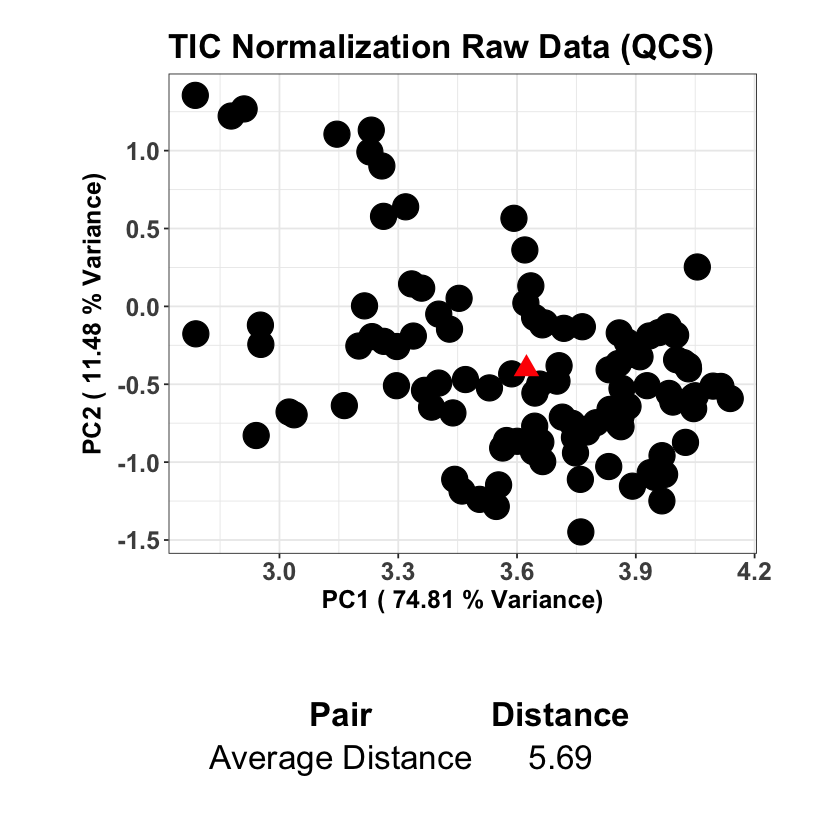

In [72]:
## PCA plot of QCS ##
# no normalization raw data
# Load necessary libraries
library(ggplot2)
library(ggrepel)
library(cowplot)
library(gridExtra)

# gets rid of plot format
options(repr.plot.width = NULL, repr.plot.height = NULL)

# Calculate PCA scores
pca_scores <- batch_pca_TIC$x

# Identify QCS samples based on sample types
qcs_samples <- which(sample_types_TIC == "QCS")

# Extract PCA scores for QCS samples
qcs_scores <- pca_scores[qcs_samples, ]

# Compute the centroid of QCS samples
qcs_centroid <- colMeans(qcs_scores)

# Calculate PC1 and PC2 variances
pc1_variance <- round(batch_pca_TIC$sdev[1]^2 / sum(batch_pca_TIC$sdev^2) * 100, 2)
pc2_variance <- round(batch_pca_TIC$sdev[2]^2 / sum(batch_pca_TIC$sdev^2) * 100, 2)

# Plot PCA plot with QCS samples and their centroid
pca_plot_qcs <- ggplot(data.frame(PC1 = qcs_scores[,1], PC2 = qcs_scores[,2]), aes(x = PC1, y = PC2)) +
  geom_point(size = 7) +  # Plot QCS samples
  geom_point(data = data.frame(PC1 = qcs_centroid[1], PC2 = qcs_centroid[2]), aes(x = PC1, y = PC2), shape = 17, fill = "red", color = "red", size = 5) +  # Plot centroid as triangle with filled red color
  labs(x = paste("PC1 (", pc1_variance, "% Variance)"), y = paste("PC2 (", pc2_variance, "% Variance)"), title = "TIC Normalization Raw Data (QCS)") +
  theme_bw() +
  theme(axis.title.x = element_text(face = "bold", size = 15),
        axis.title.y = element_text(face = "bold", size = 15),
        axis.text = element_text(size = 15, face = "bold"),
        plot.margin = margin(20, 50, 10, 50),  # Adjust the bottom margin to 10 units
        plot.title = element_text(face = "bold", size = 20))  # Make the plot title bold and size 20

# Calculate average distance of QCS samples from the centroid
qcs_centroid_distances <- sqrt(rowSums((qcs_scores - qcs_centroid)^2))
average_qcs_distance_TIC <- mean(qcs_centroid_distances)

# Create a data frame for average distance
average_distance_qcs_df <- data.frame(
  Pair = "Average Distance",
  Distance = average_qcs_distance_TIC
)

# Round distances for better presentation
average_distance_qcs_df$Distance <- round(average_distance_qcs_df$Distance, 2)

# Create a table plot
table_plot_qcs <- tableGrob(average_distance_qcs_df, theme = ttheme_minimal(base_size = 20), rows = NULL)

# Combine the PCA plot and the table
combined_plot_TIC_qcs <- plot_grid(pca_plot_qcs, table_plot_qcs, ncol = 1, align = "v", axis = "lr", rel_heights = c(3, 1))

# Print the combined plot
print(combined_plot_TIC_qcs)

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


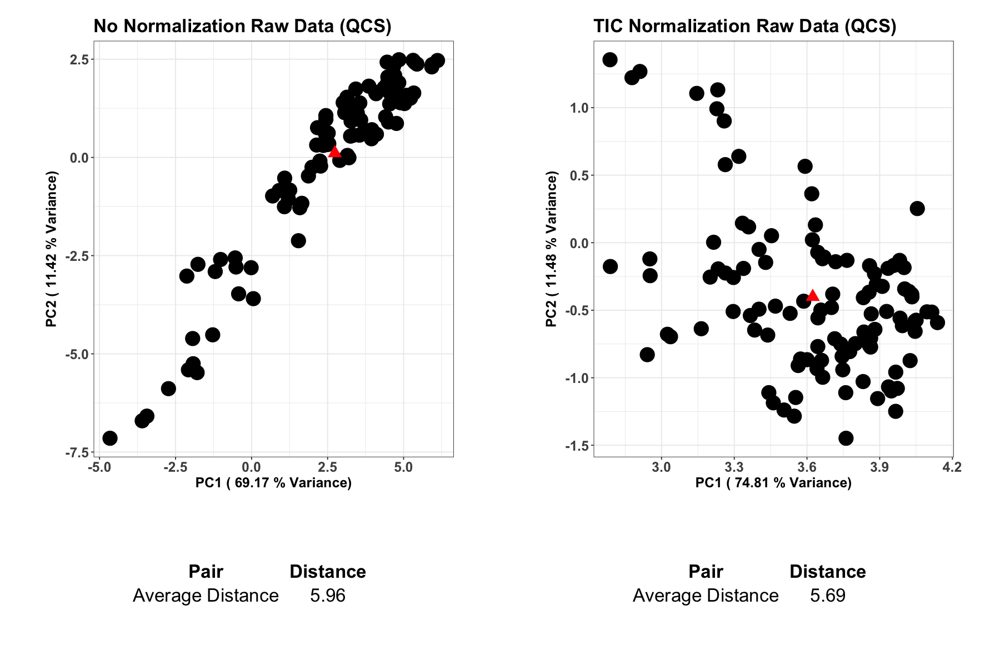

In [73]:
## Overview QCS PCA PLOT ##
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 10)
combined_plots <- grid.arrange(combined_plot_qcs, combined_plot_TIC_qcs, ncol = 2)
print(combined_plots)

## Average Distance of QCS ##

In [74]:
## Calculate QCS eucleadan distance ##
# No normalization
qcs_indices <- which(pca_data$Type == "QCS") # 108
pca_scores_qcs <- pca_data[qcs_indices, -which(names(pca_data) == "Score")]
numeric_cols <- sapply(pca_scores_qcs, is.numeric)
pca_scores_numeric <- pca_scores_qcs[, numeric_cols]

# calculate euclidean distance
euclidean_distances <- dist(pca_scores_numeric)
average_distance_ec <- mean(euclidean_distances)
cat("Average QCS distance for no normalization is", average_distance_ec, "\n")

Average QCS distance for no normalization is 5.728145 


In [75]:
## Calculate QCS eucleadan distance ##
# TIC normalization
qcs_indices <- which(pca_data_TIC$Type == "QCS") # 108
pca_scores_qcs <- pca_data_TIC[qcs_indices, -which(names(pca_data_TIC) == "Score")]
numeric_cols <- sapply(pca_scores_qcs, is.numeric)
pca_scores_numeric <- pca_scores_qcs[, numeric_cols]

# calculate euclidean distance
euclidean_distances <- dist(pca_scores_numeric)
average_distance_ec_TIC <- mean(euclidean_distances)
cat("Average QCS distance for TIC normalization is", average_distance_ec_TIC, "\n")

Average QCS distance for TIC normalization is 3.325513 


## Tissue RSD ##

In [76]:
## Tissue Variation RSD No Norm ##

# extract tissue samples based on the rownames
sample_set_regex <- paste(sample_set, collapse = "|")
sample_set_rows <- grep(sample_set_regex, rownames(combined_batch_info_data))
tissue_samples <- combined_batch_info_data[sample_set_rows,]
row_names <- rownames(tissue_samples)
tissue_samples <- as.data.frame(apply(tissue_samples, 2, as.numeric))
rownames(tissue_samples) <- row_names

# Function to calculate rsd for tissue
calculate_batch_rsd_combined <- function(tissue_samples) {
  # Function to calculate batch RSD for a given tissue dataset
  calculate_batch_rsd <- function(sample_dataset, batch_number) {
    # Extract data for the specified batch number
    batch_data <- sample_dataset[sample_dataset$batch == batch_number, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(batch_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(batch_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate interday RSD for a given tissue dataset
  calculate_interday_rsd <- function(sample_dataset) {
    # Extract data for interday calculation
    interday_data <- sample_dataset[, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(interday_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(interday_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate batch RSD for multiple batches
  calculate_batch_rsd_multiple <- function(sample_dataset, unique_batches) {
    rsd_results <- list()
    for (batch_number in unique_batches) {
      rsd_results[[as.character(batch_number)]] <- calculate_batch_rsd(sample_dataset, batch_number)
    }
    return(rsd_results)
  }
  
  # Extract unique tissue sample datasets for each tissue type
  unique_tissues <- unique(gsub(".*_(\\w+)_\\d+.*", "\\1", rownames(tissue_samples)))
  
  # Initialize list to store results for each tissue type
  rsd_results <- list()
  
  # Loop through each tissue type
  for (tissue_type in unique_tissues) {
    # Filter tissue samples for the current tissue type
    tissue_data <- tissue_samples[grep(paste0(tissue_type, "_"), rownames(tissue_samples)), ]
    
    # Order the dataset based on s_value
    sample_numbers <- as.numeric(gsub(".*S(\\d+)_.*", "\\1", rownames(tissue_data)))
    ordered_indices <- order(sample_numbers)
    tissue_data <- tissue_data[ordered_indices, ]
    
    # Replace negative values with 1
    tissue_data <- replace(tissue_data, tissue_data < 0, 1)
    
    # Calculate batch RSD for unique batches
    unique_batches <- unique(tissue_data$batch)
    rsd_results_tissue <- calculate_batch_rsd_multiple(tissue_data, unique_batches)
    
    # Calculate interday RSD
    interday_rsd <- calculate_interday_rsd(tissue_data)
    
    # Combine batch and interday RSD results into a data frame
    rsd_df_tissue <- data.frame(
      Batch = names(rsd_results_tissue),
      RSD = unlist(rsd_results_tissue)
    )
    rsd_df_tissue <- rbind(rsd_df_tissue, c("Interday", interday_rsd))
    rownames(rsd_df_tissue) <- NULL
    
    # Alter batch names to Intraday 1, Intraday 2, etc.
    batch_names <- c("Intraday 1", "Intraday 2", "Intraday 3")
    rsd_df_tissue$Batch <- ifelse(rsd_df_tissue$Batch == "Interday", "Interday", batch_names)
    
    # Store results for the current tissue type
    rsd_results[[tissue_type]] <- rsd_df_tissue
  }
  
  return(rsd_results)
}
rsd_results_combined <- calculate_batch_rsd_combined(tissue_samples)
#print(rsd_results_combined)

# Assuming rsd_results_combined is the output of calculate_batch_rsd_combined

library(kableExtra)
library(IRdisplay)

# Create a function to generate HTML tables for each tissue
generate_rsd_table <- function(rsd_results, tissue_name) {
  rsd_df <- rsd_results[[tissue_name]]
  kable(rsd_df, format = "html", row.names = FALSE) %>%
    kable_styling(full_width = FALSE)
}

# Generate HTML tables for each tissue
html_tables <- lapply(names(rsd_results_combined), function(tissue_name) {
  rsd_table <- generate_rsd_table(rsd_results_combined, tissue_name)
  table_name <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>", sep = "")
  paste("<div style='display: inline-block; margin-right: 20px; text-align: center;'>", table_name, as.character(rsd_table), "</div>")
})

# Combine HTML tables into a single string
html_content <- paste(html_tables, collapse = "")

# Wrap the combined HTML content in a div with text-align: center
centered_html_content <- paste("<div style='text-align: center;'>", html_content, "</div>")
cat("Tissue RSD for No Normalization")
# Display the centered HTML content in JupyterLab
display_html(centered_html_content)

Tissue RSD for No Normalization

Batch,RSD
Intraday 1,23.72 ± 8.48%
Intraday 2,25.12 ± 7.45%
Intraday 3,23.86 ± 9.95%
Interday,23.03 ± 5.61%
Batch,RSD
Intraday 1,37.55 ± 10.32%
Intraday 2,6.51 ± 5.53%
Intraday 3,11.49 ± 7.60%
Interday,41.29 ± 11.85%
Batch,RSD


In [77]:
## Tissue Variation RSD TIC norm ##

# extract tissue samples based on the rownames
sample_set_regex <- paste(sample_set, collapse = "|")
sample_set_rows <- grep(sample_set_regex, rownames(combined_batch_info_data_TIC))
tissue_samples <- combined_batch_info_data_TIC[sample_set_rows,]
row_names <- rownames(tissue_samples)
tissue_samples <- as.data.frame(apply(tissue_samples, 2, as.numeric))
rownames(tissue_samples) <- row_names

# Function to calculate rsd for tissue
calculate_batch_rsd_combined <- function(tissue_samples) {
  # Function to calculate batch RSD for a given tissue dataset
  calculate_batch_rsd <- function(sample_dataset, batch_number) {
    # Extract data for the specified batch number
    batch_data <- sample_dataset[sample_dataset$batch == batch_number, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(batch_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(batch_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate interday RSD for a given tissue dataset
  calculate_interday_rsd <- function(sample_dataset) {
    # Extract data for interday calculation
    interday_data <- sample_dataset[, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(interday_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(interday_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate batch RSD for multiple batches
  calculate_batch_rsd_multiple <- function(sample_dataset, unique_batches) {
    rsd_results <- list()
    for (batch_number in unique_batches) {
      rsd_results[[as.character(batch_number)]] <- calculate_batch_rsd(sample_dataset, batch_number)
    }
    return(rsd_results)
  }
  
  # Extract unique tissue sample datasets for each tissue type
  unique_tissues <- unique(gsub(".*_(\\w+)_\\d+.*", "\\1", rownames(tissue_samples)))
  
  # Initialize list to store results for each tissue type
  rsd_results <- list()
  
  # Loop through each tissue type
  for (tissue_type in unique_tissues) {
    # Filter tissue samples for the current tissue type
    tissue_data <- tissue_samples[grep(paste0(tissue_type, "_"), rownames(tissue_samples)), ]
    
    # Order the dataset based on s_value
    sample_numbers <- as.numeric(gsub(".*S(\\d+)_.*", "\\1", rownames(tissue_data)))
    ordered_indices <- order(sample_numbers)
    tissue_data <- tissue_data[ordered_indices, ]
    
    # Replace negative values with 1
    tissue_data <- replace(tissue_data, tissue_data < 0, 1)
    
    # Calculate batch RSD for unique batches
    unique_batches <- unique(tissue_data$batch)
    rsd_results_tissue <- calculate_batch_rsd_multiple(tissue_data, unique_batches)
    
    # Calculate interday RSD
    interday_rsd <- calculate_interday_rsd(tissue_data)
    
    # Combine batch and interday RSD results into a data frame
    rsd_df_tissue <- data.frame(
      Batch = names(rsd_results_tissue),
      RSD = unlist(rsd_results_tissue)
    )
    rsd_df_tissue <- rbind(rsd_df_tissue, c("Interday", interday_rsd))
    rownames(rsd_df_tissue) <- NULL
    
    # Alter batch names to Intraday 1, Intraday 2, etc.
    batch_names <- c("Intraday 1", "Intraday 2", "Intraday 3")
    rsd_df_tissue$Batch <- ifelse(rsd_df_tissue$Batch == "Interday", "Interday", batch_names)
    
    # Store results for the current tissue type
    rsd_results[[tissue_type]] <- rsd_df_tissue
  }
  
  return(rsd_results)
}
rsd_results_combined_TIC <- calculate_batch_rsd_combined(tissue_samples)
#print(rsd_results_combined)

# Assuming rsd_results_combined is the output of calculate_batch_rsd_combined

library(kableExtra)
library(IRdisplay)

# Create a function to generate HTML tables for each tissue
generate_rsd_table <- function(rsd_results, tissue_name) {
  rsd_df <- rsd_results[[tissue_name]]
  kable(rsd_df, format = "html", row.names = FALSE) %>%
    kable_styling(full_width = FALSE)
}

# Generate HTML tables for each tissue
html_tables_TIC <- lapply(names(rsd_results_combined_TIC), function(tissue_name) {
  rsd_table <- generate_rsd_table(rsd_results_combined_TIC, tissue_name)
  table_name <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>", sep = "")
  paste("<div style='display: inline-block; margin-right: 20px; text-align: center;'>", table_name, as.character(rsd_table), "</div>")
})

# Combine HTML tables into a single string
html_content_TIC <- paste(html_tables_TIC, collapse = "")

# Wrap the combined HTML content in a div with text-align: center
centered_html_content_TIC <- paste("<div style='text-align: center;'>", html_content_TIC, "</div>")
cat("Tissue RSD for TIC Normalization")
# Display the centered HTML content in JupyterLab
display_html(centered_html_content_TIC)

Tissue RSD for TIC Normalization

Batch,RSD
Intraday 1,8.68 ± 6.63%
Intraday 2,9.15 ± 5.28%
Intraday 3,10.27 ± 8.49%
Interday,13.41 ± 5.13%
Batch,RSD
Intraday 1,13.51 ± 8.94%
Intraday 2,6.67 ± 5.24%
Intraday 3,12.02 ± 7.56%
Interday,18.61 ± 7.56%
Batch,RSD


In [78]:
## Overview RSD Table ##

# Initialize an empty list to store combined HTML tables for each tissue
combined_html_list <- list()

# Iterate over each tissue type
for (tissue_name in names(rsd_results_combined)) {
  # Extract RSD tables for the current tissue type
  rsd_table <- generate_rsd_table(rsd_results_combined, tissue_name)
  rsd_table_TIC <- generate_rsd_table(rsd_results_combined_TIC, tissue_name)
  
  # Combine HTML tables for the current tissue type horizontally
  combined_rsd_table <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>",
                              "<div style='text-align: center;'>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>No Normalization</h3>", rsd_table, "</div>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>TIC Normalization</h3>", rsd_table_TIC, "</div>",
                              "</div>")
  
  # Add the combined HTML table to the list
  combined_html_list[[tissue_name]] <- combined_rsd_table
}

# Combine HTML tables into a single HTML table with two columns
combined_html <- paste("<table style='width:100%; border-collapse: collapse;'>", 
                       "<tr>", paste("<td style='vertical-align: top;'>", 
                                     unlist(combined_html_list), 
                                     "</td>", sep = ""), "</tr></table>")

# Wrap the combined HTML content in a div with text-align: center
centered_combined_html <- paste("<div style='text-align: center;'>", combined_html, "</div>")

# Display the centered HTML content in JupyterLab
display_html(centered_combined_html)

Batch,RSD
Intraday 1,23.72 ± 8.48%
Intraday 2,25.12 ± 7.45%
Intraday 3,23.86 ± 9.95%
Interday,23.03 ± 5.61%
Batch,RSD
Intraday 1,8.68 ± 6.63%
Intraday 2,9.15 ± 5.28%
Intraday 3,10.27 ± 8.49%
Interday,13.41 ± 5.13%
Batch,RSD


## Tissue PCA Plot ## 

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


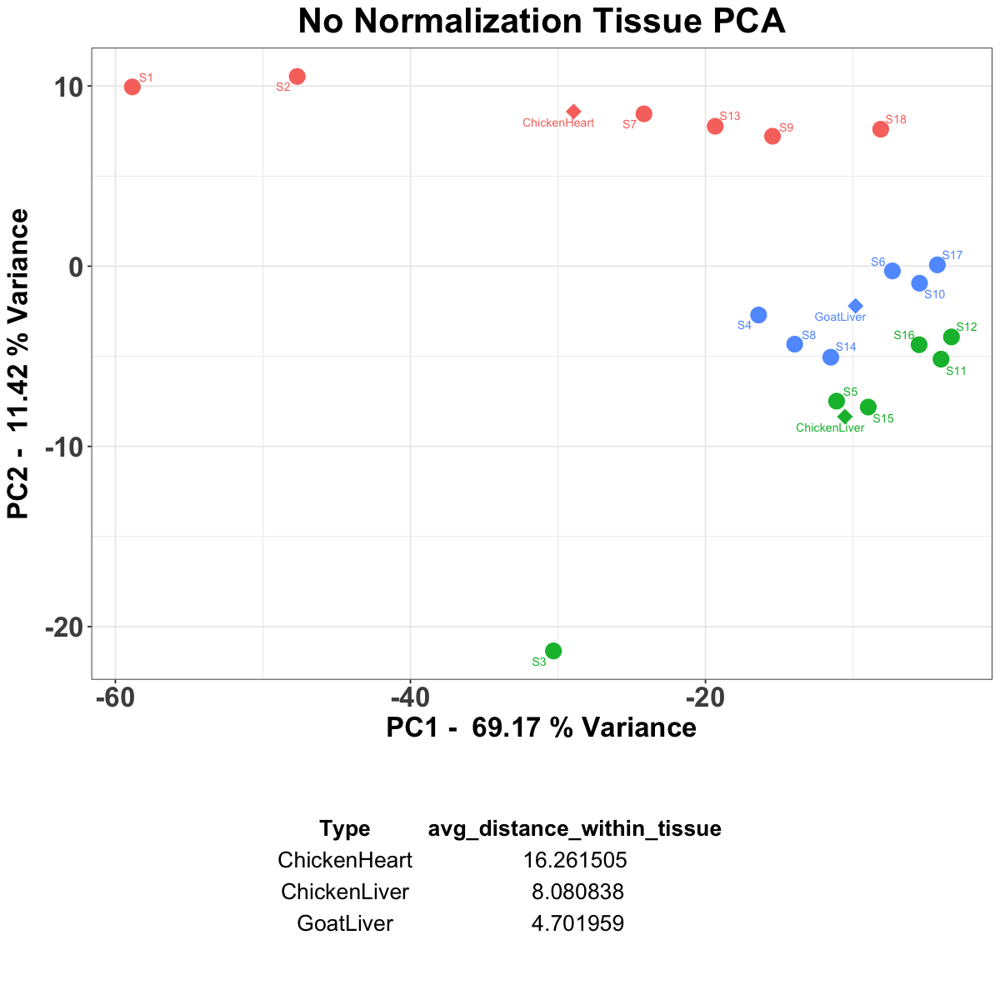

In [79]:
## Tissue PCA plot intragroup no norm ##
library(gridExtra)
library(dplyr)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Calculate distances between each sample and its corresponding centroid within each tissue type
tissue_pca_data_with_centroids <- left_join(tissue_pca_data, centroids, by = "Type")
tissue_pca_data_with_centroids <- tissue_pca_data_with_centroids %>%
  mutate(distance_to_centroid = sqrt((PC1 - Centroid_PC1)^2 + (PC2 - Centroid_PC2)^2))

# Calculate average distance within each tissue type
tissue_avg_distances <- tissue_pca_data_with_centroids %>%
  group_by(Type) %>%
  summarize(avg_distance_within_tissue = mean(distance_to_centroid))

# Create intragroup pca plot
tissue_intra_plot <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +
  labs(title = "No Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca$sdev[1]^2 / sum(batch_pca$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca$sdev[2]^2 / sum(batch_pca$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create table plot
table_plot <- tableGrob(tissue_avg_distances, rows = NULL, theme = ttheme_minimal(base_size = 16))

# Arrange PCA plot and table plot
combined_plot_intra <- grid.arrange(tissue_intra_plot, table_plot, ncol = 1, heights = c(3, 1))

# Print the combined plot
print(combined_plot_intra)

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


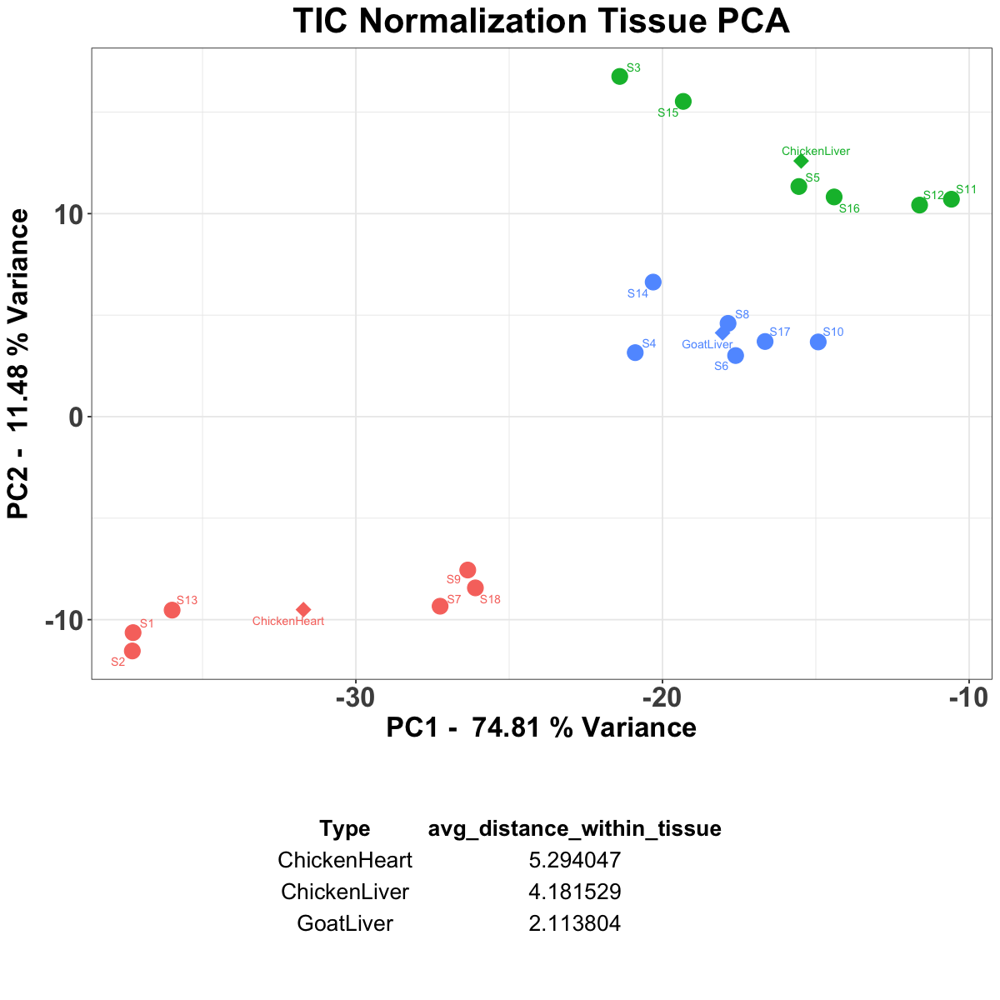

In [80]:
## Tissue PCA plot intragroup TIC norm ##
library(gridExtra)
library(dplyr)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_TIC %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Calculate distances between each sample and its corresponding centroid within each tissue type
tissue_pca_data_with_centroids <- left_join(tissue_pca_data, centroids, by = "Type")
tissue_pca_data_with_centroids <- tissue_pca_data_with_centroids %>%
  mutate(distance_to_centroid = sqrt((PC1 - Centroid_PC1)^2 + (PC2 - Centroid_PC2)^2))

# Calculate average distance within each tissue type
tissue_avg_distances_TIC <- tissue_pca_data_with_centroids %>%
  group_by(Type) %>%
  summarize(avg_distance_within_tissue = mean(distance_to_centroid))

# Create intragroup pca plot
tissue_intra_plot <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +
  labs(title = "TIC Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_TIC$sdev[1]^2 / sum(batch_pca_TIC$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_TIC$sdev[2]^2 / sum(batch_pca_TIC$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create table plot
table_plot <- tableGrob(tissue_avg_distances_TIC, rows = NULL, theme = ttheme_minimal(base_size = 16))

# Arrange PCA plot and table plot
combined_plot_TIC_intra <- grid.arrange(tissue_intra_plot, table_plot, ncol = 1, heights = c(3, 1))

# Print the combined plot
print(combined_plot_TIC_intra)

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name            grob
1 1 (1-1,1-1) arrange gtable[arrange]
2 2 (1-1,2-2) arrange gtable[arrange]


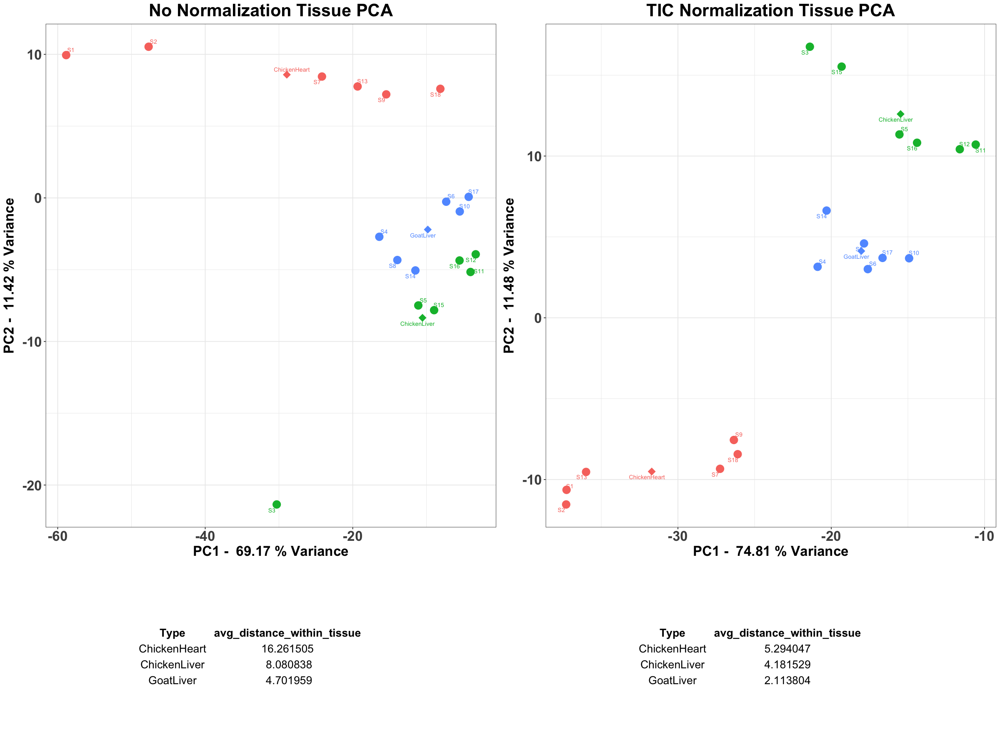

In [81]:
## Overview PCA plot ##
library(gridExtra)
options(repr.plot.width = 20, repr.plot.height = 15)  # Adjust width and height as desired
combined_plots <- grid.arrange(combined_plot_intra, combined_plot_TIC_intra, nrow = 1)
print(combined_plots)

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


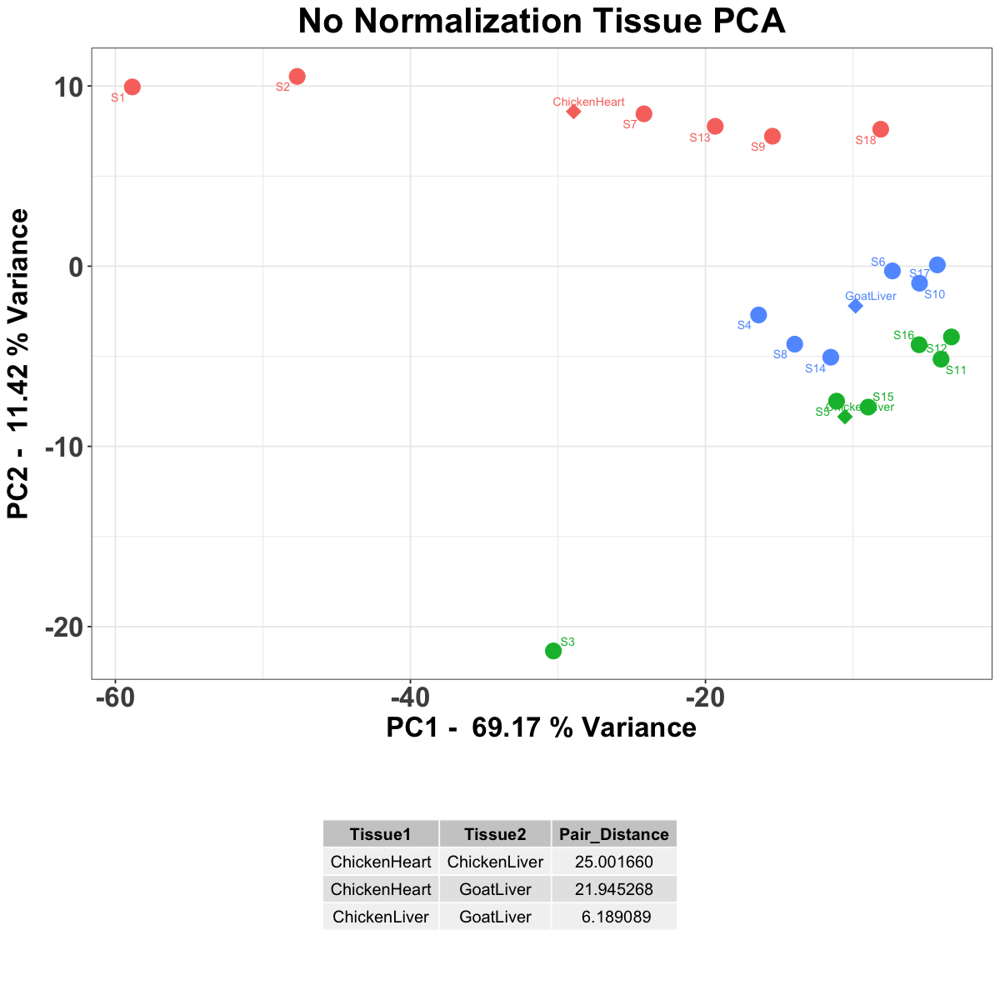

In [82]:
## Tissue with centroid PCA plot intergroup no norm ##
library(ggplot2)
library(dplyr)
library(ggrepel)
library(gridExtra)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired


# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Plot tissue-only PCA with centroids, data point labels, and axis labels
tissue_plot <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  # Using geom_text_repel to prevent label overlap
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  # Add labels for data points without overlap
  labs(title = "No Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca$sdev[1]^2 / sum(batch_pca$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca$sdev[2]^2 / sum(batch_pca$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# calculate intergroup distance #
# Create a data frame to store pairwise distances and tissue types
# Generate all possible combinations of tissue types
tissue_combinations <- combn(unique(centroids$Type), 2, simplify = TRUE)

# Initialize an empty data frame to store pairwise distances
centroid_distances_df <- data.frame(Tissue1 = character(), Tissue2 = character(), Pair_Distance = numeric())

# Iterate over each pair of tissue combinations
for (i in 1:ncol(tissue_combinations)) {
  tissue_pair <- tissue_combinations[, i]
  centroid1 <- centroids %>% filter(Type == tissue_pair[1])
  centroid2 <- centroids %>% filter(Type == tissue_pair[2])
  distance <- sqrt((centroid1$Centroid_PC1 - centroid2$Centroid_PC1)^2 + (centroid1$Centroid_PC2 - centroid2$Centroid_PC2)^2)
  centroid_distances_df <- rbind(centroid_distances_df, data.frame(Tissue1 = tissue_pair[1], Tissue2 = tissue_pair[2], Pair_Distance = distance))
}

# Create the tissue plot
tissue_intergroup_plot <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  
  labs(title = "No Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca$sdev[1]^2 / sum(batch_pca$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca$sdev[2]^2 / sum(batch_pca$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create a table grob for centroid distances
centroid_table <- tableGrob(centroid_distances_df, rows = NULL)

# Arrange plots and table vertically
combined_plot_inter <- grid.arrange(tissue_intergroup_plot, centroid_table, ncol = 1, heights = c(3, 1))
print(combined_plot_inter)

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


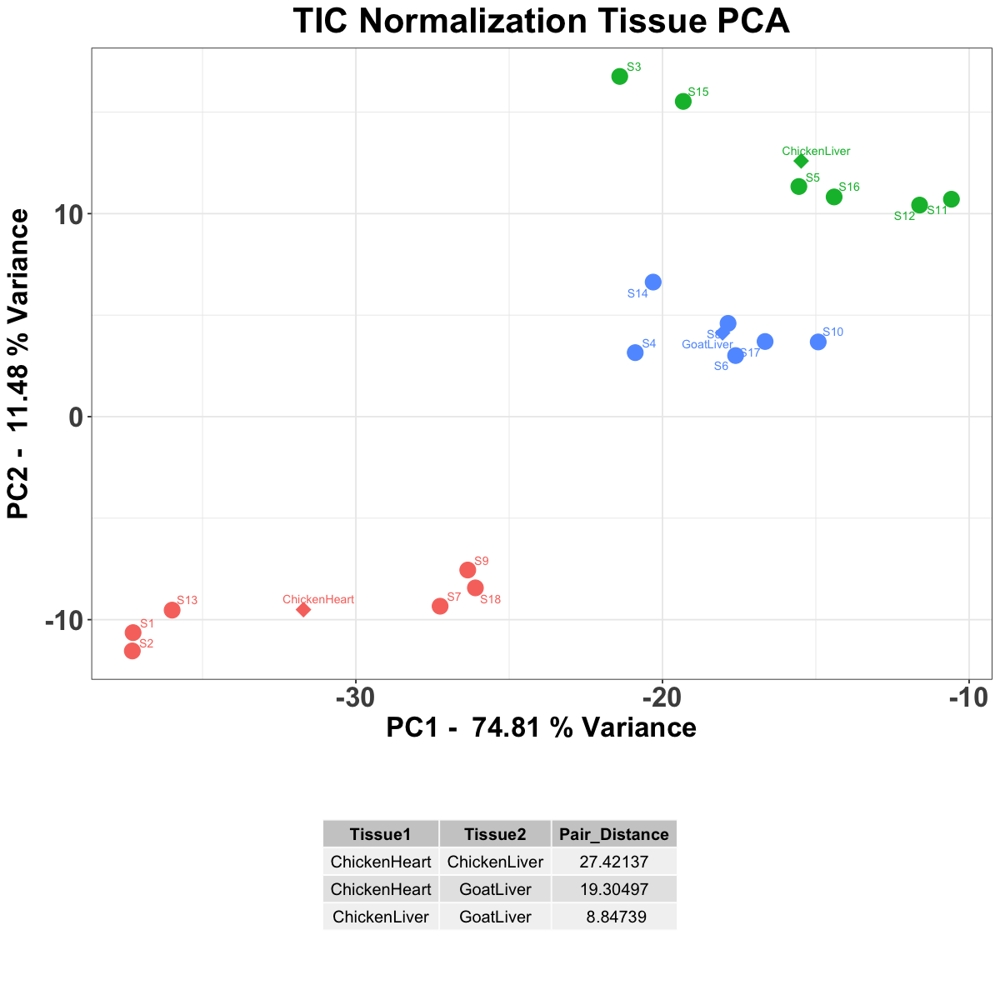

In [83]:
## Tissue with centroid PCA plot intergroup no norm ##
library(ggplot2)
library(dplyr)
library(ggrepel)
library(gridExtra)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_TIC %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Plot tissue-only PCA with centroids, data point labels, and axis labels
tissue_plot <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  # Using geom_text_repel to prevent label overlap
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  # Add labels for data points without overlap
  labs(title = "TIC Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_TIC$sdev[1]^2 / sum(batch_pca_TIC$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_TIC$sdev[2]^2 / sum(batch_pca_TIC$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# calculate intergroup distance #
# Create a data frame to store pairwise distances and tissue types
# Generate all possible combinations of tissue types
tissue_combinations <- combn(unique(centroids$Type), 2, simplify = TRUE)

# Initialize an empty data frame to store pairwise distances
centroid_distances_df_TIC <- data.frame(Tissue1 = character(), Tissue2 = character(), Pair_Distance = numeric())

# Iterate over each pair of tissue combinations
for (i in 1:ncol(tissue_combinations)) {
  tissue_pair <- tissue_combinations[, i]
  centroid1 <- centroids %>% filter(Type == tissue_pair[1])
  centroid2 <- centroids %>% filter(Type == tissue_pair[2])
  distance <- sqrt((centroid1$Centroid_PC1 - centroid2$Centroid_PC1)^2 + (centroid1$Centroid_PC2 - centroid2$Centroid_PC2)^2)
  centroid_distances_df_TIC <- rbind(centroid_distances_df_TIC, data.frame(Tissue1 = tissue_pair[1], Tissue2 = tissue_pair[2], Pair_Distance = distance))
}

# Create the tissue plot
tissue_intergroup_plot_TIC <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  
  labs(title = "TIC Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_TIC$sdev[1]^2 / sum(batch_pca_TIC$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_TIC$sdev[2]^2 / sum(batch_pca_TIC$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create a table grob for centroid distances
centroid_table_TIC <- tableGrob(centroid_distances_df_TIC, rows = NULL)

# Arrange plots and table vertically
combined_plot_TIC_inter <- grid.arrange(tissue_intergroup_plot_TIC, centroid_table_TIC, ncol = 1, heights = c(3, 1))
print(combined_plot_TIC_inter)

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name            grob
1 1 (1-1,1-1) arrange gtable[arrange]
2 2 (1-1,2-2) arrange gtable[arrange]


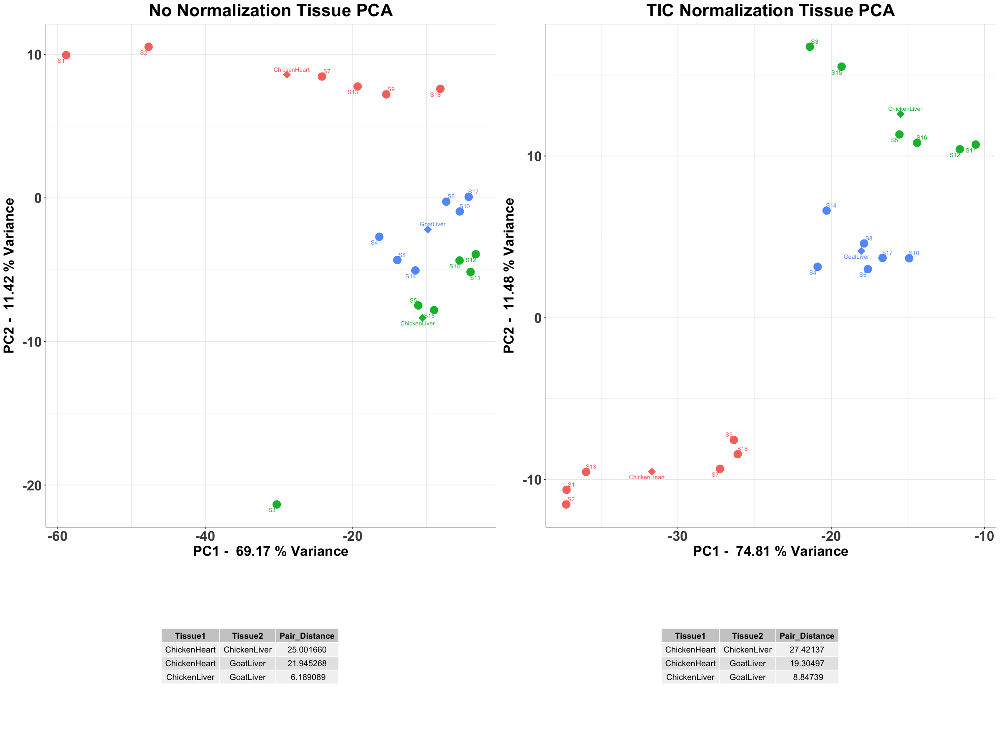

In [84]:
## Overview PCA plot ##
library(gridExtra)
options(repr.plot.width = 20, repr.plot.height = 15)  # Adjust width and height as desired
combined_plots <- grid.arrange(combined_plot_inter, combined_plot_TIC_inter, nrow = 1)
print(combined_plots)

## Correction ##
1. Combat
2. WaveICA
3. NormAE (You need to run externally, but you can obtain set up dataset to use for external code)
https://github.com/luyiyun/NormAE

For more Batch Effect Correction try this site: https://www.metaboanalyst.ca/MetaboAnalyst/upload/BatchUpload.xhtml

In [82]:
## Combat ##

# install packages for combat
install.packages("devtools")
library(devtools)

# Install sva package from GitHub
install_github("jtleek/sva")

# Load sva package
library(sva)

# obtaining peak_data
row_names <- combined_batch_data_df[, 1]
peak_data <- as.data.frame(combined_batch_data_df[,-(1:3)])
rownames(peak_data) <- row_names
peak_data_matrix <- as.matrix(peak_data)
peak_data_matrix <- apply(peak_data_matrix, 2, as.numeric)
rownames(peak_data_matrix) <- row_names

# obtaining batch_info
batch_data <- as.data.frame(t(combined_batch_info_data[,-(1)]))
batch_info_values <- as.vector(unlist(batch_data["batch", , drop = FALSE]))
batch_info_interday <- as.numeric(batch_info_values)
#print(length(batch_info_interday))

# running combat
combat_result_interday <- ComBat(dat = peak_data_matrix, batch = batch_info_interday)

# save dataset as csv file
write.csv(combat_result_interday,
          file = "dataset/combat_interday_corrected_data.csv",
          row.names = TRUE)

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

Using GitHub PAT from the git credential store.

Skipping install of 'sva' from a github remote, the SHA1 (f48f461b) has not changed since last install.
  Use `force = TRUE` to force installation



Found 3 batches
Adjusting for 0 covariate(s) or covariate level(s)
Standardizing Data across genes
Fitting L/S model and finding priors
Finding parametric adjustments
Adjusting the Data


In [39]:
## WaveICA ##

# install packages for WaveICA correction
install.packages("devtools", quite = TRUE)
library(devtools)
devtools::install_github("dengkuistat/WaveICA", host = "https://api.github.com", dependencies = TRUE)
library(WaveICA)

# obtaining peak_data
row_names <- combined_batch_data_df[, 1]
peak_data <- as.data.frame(combined_batch_data_df[,-(1:3)])
rownames(peak_data) <- row_names
peak_data_trans <- as.data.frame(t(peak_data))
peak_data_trans <- sapply(peak_data_trans, as.numeric)
rownames(peak_data_trans) <- colnames(peak_data)

# Convert peak_data_trans to a matrix
peak_data_matrix <- as.matrix(peak_data_trans)

# Keep the row names from peak_data_trans in the matrix
rownames(peak_data_matrix) <- rownames(peak_data_trans)

# obtaining batch_info
batch_data <- as.data.frame(t(combined_batch_info_data[,-(1)]))
batch_info_values <- as.vector(unlist(batch_data["batch", , drop = FALSE]))
batch_info_interday <- as.numeric(batch_info_values)
#print(length(batch_info_interday)) # 126 samples

# running waveICA
waveica_result_interday_matrix <- WaveICA(peak_data_matrix, batch = batch_info_interday, group = NULL)
waveica_result_interday <- as.data.frame(waveica_result_interday_matrix[["data_wave"]]) # 126 obs of 120 variables
waveica_result_interday <- as.data.frame(waveica_result_interday_matrix[["data_wave"]]) # 126 obs of 120 variables

# save dataset as csv file
write.csv(waveica_result_interday,
          file = "dataset/waveica_interday_corrected_data.csv",
          row.names = TRUE)

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

필요한 패키지를 로딩중입니다: usethis

Using GitHub PAT from the git credential store.

Skipping install of 'WaveICA' from a github remote, the SHA1 (5c091801) has not changed since last install.
  Use `force = TRUE` to force installation

Warning message:
“replacing previous import ‘pROC::cov’ by ‘stats::cov’ when loading ‘WaveICA’”
Warning message:
“replacing previous import ‘pROC::smooth’ by ‘stats::smooth’ when loading ‘WaveICA’”
Warning message:
“replacing previous import ‘pROC::var’ by ‘stats::var’ when loading ‘WaveICA’”

waveslim: Wavelet Method for 1/2/3D Signals (version = 1.8.4)




######Decomposition 1 ########
######Decomposition 2 ########
######Decomposition 3 ########
######Decomposition 4 ########
######Decomposition 5 ########
######Decomposition 6 ########
######Decomposition 7 ########
######Decomposition 8 ########
######Decomposition 9 ########
######Decomposition 10 ########
######Decomposition 11 ########
######Decomposition 12 ########
######Decomposition 13 ########
######Decomposition 14 ########
######Decomposition 15 ########
######Decomposition 16 ########
######Decomposition 17 ########
######Decomposition 18 ########
######Decomposition 19 ########
######Decomposition 20 ########
######Decomposition 21 ########
######Decomposition 22 ########
######Decomposition 23 ########
######Decomposition 24 ########
######Decomposition 25 ########
######Decomposition 26 ########
######Decomposition 27 ########
######Decomposition 28 ########
######Decomposition 29 ########
######Decomposition 30 ########
######Decomposition 31 ########
######Decompositi

In [84]:
## NormAE ##

## You need to run the normae externally, from here you can prepare dataset to be used for normae follow steps ##
## dataset preparation
# convert combined_batch_data_df into txt file
write.table(combined_batch_data_df, 
            file = "input/metabolomics_data_normae.txt", 
            sep = ",", 
            quote = FALSE, 
            row.names = FALSE)

# edit batch_info
library(dplyr)
batch_info <- read.csv("input/batch_info_TIC.csv", 
                       header = TRUE,
                       stringsAsFactors = FALSE)
# add column for group
batch_info <- batch_info %>%
  mutate(group = 1)

# Add a new column called "class"
batch_info <- batch_info %>%
  mutate(class = ifelse(grepl(paste(sample_set, collapse = "|"), sample.name), "Subject", "QC"))

# move the first three columns
combined_batch_data_df_norm <- combined_batch_data_df[, -(1:3)]

# Check if sample names match column names
names_match <- all(batch_info$sample.name %in% colnames(combined_batch_data_df_norm))

if (names_match) {
  print("The sample names in batch_info match the column names of combined_batch_data_df.")
} else {
  print("The sample names in batch_info do not match the column names of combined_batch_data_df.")
  
  # Extract column names from combined_batch_data_df
  col_names_combined <- colnames(combined_batch_data_df_norm)
  
  # Replace sample names in batch_info with column names from combined_batch_data_df
  batch_info$sample.name <- col_names_combined
}

# make it txt file
# we need two txt file one batch_info and one normae
write.table(batch_info,
            file = "input/batch_info_normae.txt",
            sep = ",",
            row.names = FALSE,
            quote = FALSE)
cat("Please go to https://github.com/luyiyun/NormAE and run NormAE and put Rec_nobe.csv and Ys.csv into dataset")
# After obtaining two txt file follow these steps to run NormAE
# Step 1: Go to https://github.com/luyiyun/NormAE
# Step 2: Click code and download zip
# Step 3: Open zip file (vs code/pycharm/python)
# Step 4: Check if dataset works with using dataset script (at the last you can change file path into normae and batch_info file path
# Step 5: If dataset works, open command (command prompt) and run underneath example code
# Step 6: python -m visdom.server (command to open visdom)
# Step 7: python main.py --task train --meta_data data\data12\norm.txt --device CPU --sample_data data\data12\batch.txt --visdom_port 8097 --save data\Training12 (command to train, change the file path)
# Step 8: python main.py --task remove --meta_data data\data12\norm.txt --sample_data data\data12\batch.txt --device CPU --visdom_port 8097 --save data\Training12 --load data/Training12/models.pth (command to correct batch, change the file path)
# Step 9: put on two files after NormAE (Rec_nobe.csv and Ys.csv) into dataset

## extract normae data from dataset
normae_result_interday <- read.csv("dataset/Rec_nobe_no_norm.csv",
                                  header = TRUE,
                                  stringsAsFactors = FALSE)

[1] "The sample names in batch_info do not match the column names of combined_batch_data_df."
Please go to https://github.com/luyiyun/NormAE and run NormAE and put Rec_nobe.csv and Ys.csv into dataset

## Comparision ##
1. QCS RSD
2. Intensity Plot
3. Violin Plot
4. PCA plot
5. Tissue RSD
6. Tissue PCA plot
7. Average Distance

In [85]:
## QCS RSD Table ## Combat
data <- read.csv("dataset/combat_interday_corrected_data.csv", # check file path
                 header = TRUE,
                 stringsAsFactors = FALSE,
                 row.names = 1) 
row_names <- rownames(data)
batch_info_norm <- read.csv("input/batch_info_TIC.csv", # check file path
                            header = TRUE,
                            stringsAsFactors = FALSE)

injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data) 
new_row_names <- c("injection_order", "batch", row_names)
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))

# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(transposed_data, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
propranolol_data_combat <- cbind(batch_info_columns, propranolol_peak_data)

d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
d7_propranolol_data_combat <- cbind(batch_info_columns, d7_propranolol_peak_data)

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}

# usage:
cat("RSD for Combat:\n")                                   
rsd_propranolol_combat <- calculate_batch_rsd(propranolol_data_combat, propranolol_mz_value)
cat("m/z value:", propranolol_mz_value, "\n")
print(rsd_propranolol_combat)

rsd_d7_propranolol_combat <- calculate_batch_rsd(d7_propranolol_data_combat, d7_propranolol_mz_value)
cat("m/z value:", d7_propranolol_mz_value, "\n")
print(rsd_d7_propranolol_combat)

RSD for Combat:
m/z value: 260.186 
       Batch    RSD
1 Intraday 1 57.82%
2 Intraday 2 48.44%
3 Intraday 3 38.62%
4   Interday 48.24%
m/z value: 267.187 
       Batch    RSD
1 Intraday 1 59.23%
2 Intraday 2 47.31%
3 Intraday 3 39.03%
4   Interday 48.62%


In [86]:
## QCS RSD Table ## WaveICA

data <- as.data.frame(t(waveica_result_interday))
# or if you are reading directly from file 
#data <- read.csv("dataset/waveica_interday_corrected_data.csv",
                 #header = TRUE,
                 #stringsAsFactors = FALSE,
                 #row.names = 1) 
#data <- as.data.frame(t(data))

row_names <- rownames(data)
batch_info_norm <- read.csv("input/batch_info_TIC.csv", # check file path
                            header = TRUE,
                            stringsAsFactors = FALSE)

injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data)
new_row_names <- c("injection_order", "batch", row_names)
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))

# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
sample_set <- c("ChickenHeart", "ChickenLiver", "GoatLiver")
qcs_batch_info_data <- extract_qcs_data(transposed_data, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
propranolol_data_wave <- cbind(batch_info_columns, propranolol_peak_data)

d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
d7_propranolol_data_wave <- cbind(batch_info_columns, d7_propranolol_peak_data)

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}

# usage:
cat("RSD for WaveICA:\n")                                   
rsd_propranolol_wave <- calculate_batch_rsd(propranolol_data_wave, propranolol_mz_value)
cat("m/z value:", propranolol_mz_value, "\n")
print(rsd_propranolol_wave)

rsd_d7_propranolol_wave <- calculate_batch_rsd(d7_propranolol_data_wave, d7_propranolol_mz_value)
cat("m/z value:", d7_propranolol_mz_value, "\n")
print(rsd_d7_propranolol_wave)

RSD for WaveICA:
m/z value: 260.186 
       Batch    RSD
1 Intraday 1 42.24%
2 Intraday 2 33.07%
3 Intraday 3 35.51%
4   Interday 36.97%
m/z value: 267.187 
       Batch    RSD
1 Intraday 1 39.16%
2 Intraday 2 30.04%
3 Intraday 3 32.49%
4   Interday 33.92%


In [87]:
## QCS RSD Table ## NormAE
data <- read.csv("dataset/Rec_nobe_no_norm.csv", # check file path
                 header = TRUE, 
                 stringsAsFactors = FALSE,
                 row.names = 1)
row_names <- rownames(data)
batch_info_norm <- read.csv("dataset/Ys.csv", # check file path
                            header = TRUE,
                            stringsAsFactors = FALSE)

injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data)
new_row_names <- c("injection_order", "batch", row_names)
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))

# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(transposed_data, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
propranolol_data_norm <- cbind(batch_info_columns, propranolol_peak_data)
propranolol_data_norm$batch <- propranolol_data_norm$batch + 1

d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
d7_propranolol_data_norm <- cbind(batch_info_columns, d7_propranolol_peak_data)

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}
# usage:
cat("RSD for NormAE:\n")                    
rsd_propranolol_norm <- calculate_batch_rsd(propranolol_data_norm, propranolol_mz_value)
cat("m/z value:", propranolol_mz_value, "\n")
print(rsd_propranolol_norm)

rsd_d7_propranolol_norm <- calculate_batch_rsd(d7_propranolol_data_norm, d7_propranolol_mz_value)
cat("m/z value:", d7_propranolol_mz_value, "\n")
print(rsd_d7_propranolol_norm)

RSD for NormAE:
m/z value: 260.186 
       Batch    RSD
1 Intraday 1 22.55%
2 Intraday 2 22.04%
3 Intraday 3 19.79%
4   Interday 21.36%
m/z value: 267.187 
       Batch    RSD
1 Intraday 0 25.86%
2 Intraday 1 25.66%
3 Intraday 2 23.58%
4   Interday 24.93%


In [88]:
## RSD Overview Table ##
# Create overview RSD table for Propranolol
overview_table_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  Combat_RSD = rsd_propranolol_combat[2],
  WaveICA_RSD = rsd_propranolol_wave[2],
  NormAE_RSD = rsd_propranolol_norm[2]
)

# Set the column names
colnames(overview_table_pro) <- c(paste("m/z value:", propranolol_mz_value), "Combat", "WaveICA", "NormAE")

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying overview RSD table
display_rsd_table_pro <- kable(overview_table_pro, format = "html", row.names = FALSE) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_pro <- paste("<h2 style='text-align: center;'>Overview RSD Table Propranolol</h2>", 
                               as.character(display_rsd_table_pro))

# Save HTML table to a file
display_html(display_rsd_table_pro)

# Create overview RSD table for d7-Propranolol
overview_table_d7_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  Combat_RSD = rsd_d7_propranolol_combat[2],
  WaveICA_RSD = rsd_d7_propranolol_wave[2],
  NormAE_RSD = rsd_d7_propranolol_norm[2]
)

# Set the column names
colnames(overview_table_d7_pro) <- c(paste("m/z value:", d7_propranolol_mz_value), "Combat", "WaveICA", "NormAE")

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying overview RSD table
display_rsd_table_d7_pro <- kable(overview_table_d7_pro, format = "html", row.names = FALSE) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_d7_pro <- paste("<h2 style='text-align: center;'>Overview RSD Table D7-Propranolol</h2>", 
                               as.character(display_rsd_table_d7_pro))

# Save HTML table to a file
display_html(display_rsd_table_d7_pro)

m/z value: 260.186,Combat,WaveICA,NormAE
Intraday 1,57.82%,42.24%,22.55%
Intraday 2,48.44%,33.07%,22.04%
Intraday 3,38.62%,35.51%,19.79%
Interday,48.24%,36.97%,21.36%


m/z value: 267.187,Combat,WaveICA,NormAE
Intraday 1,59.23%,39.16%,25.86%
Intraday 2,47.31%,30.04%,25.66%
Intraday 3,39.03%,32.49%,23.58%
Interday,48.62%,33.92%,24.93%


## Visualization ##
1. Intensity Plot (Intensity vs Measurement Order)
2. Violin Plot
3. PCA Plot
4. QCS PCA Plot
5. Tissue PCA Plot

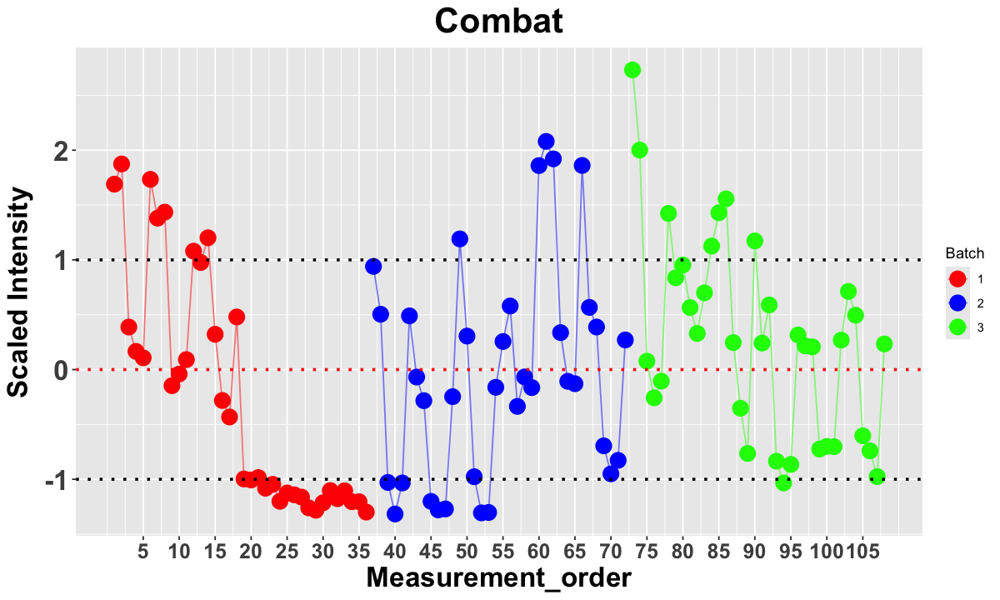

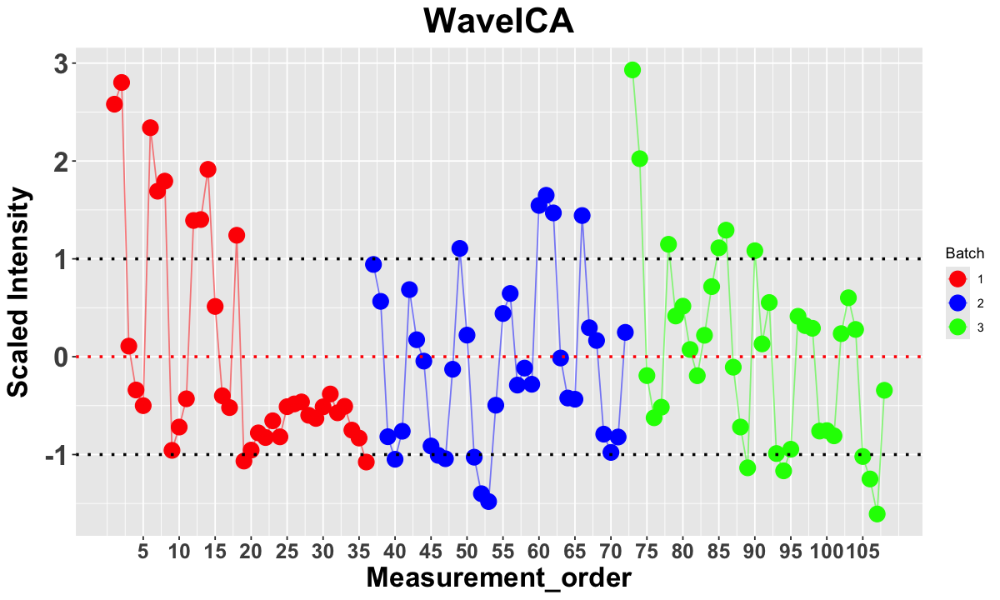

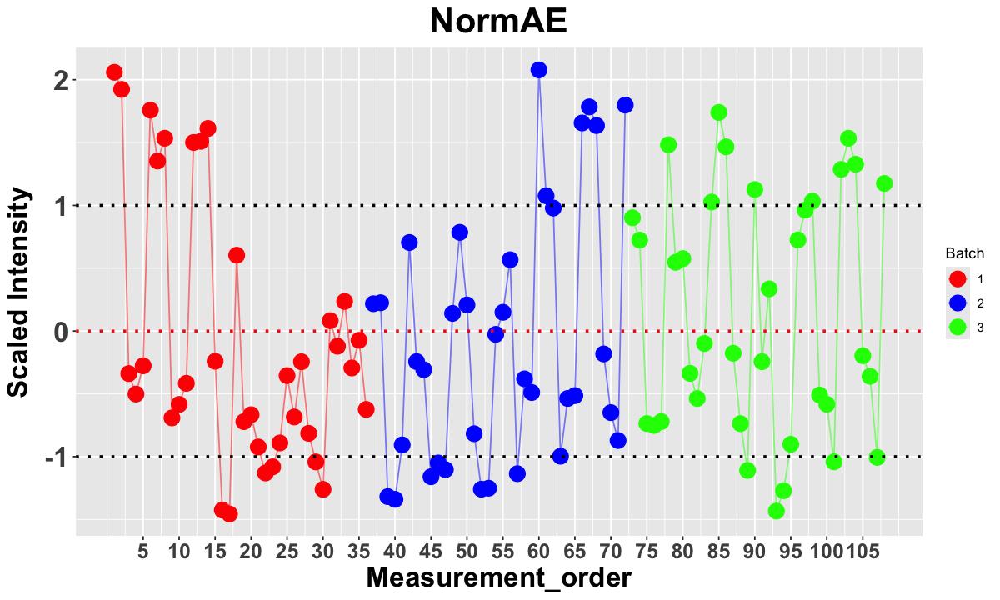

TableGrob (2 x 2) "arrange": 3 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]
3 3 (2-2,1-1) arrange gtable[layout]


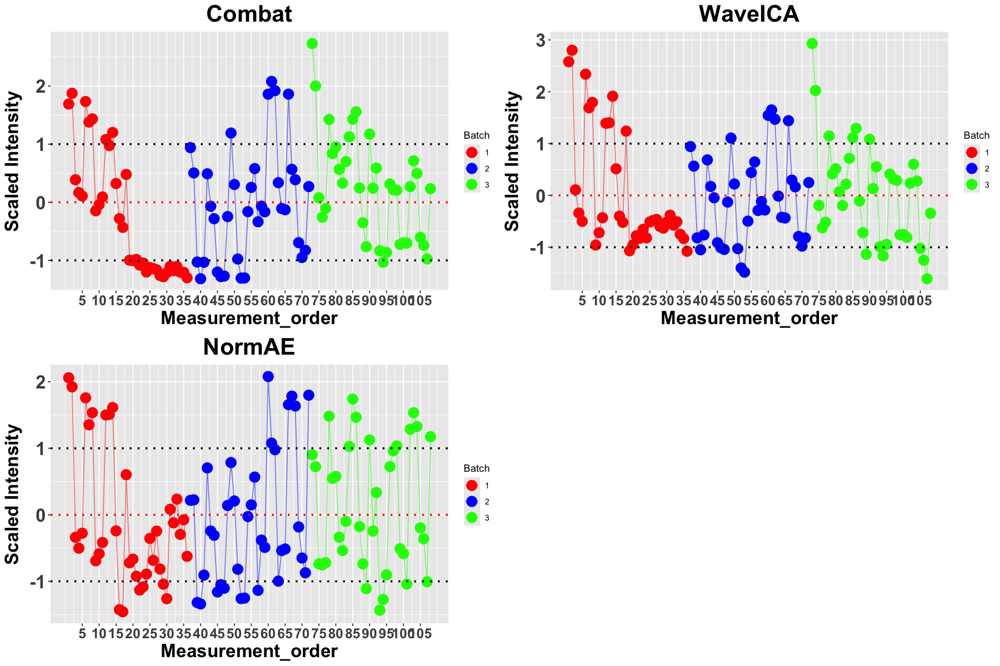

In [89]:
## Intensity Plot (Intensity vs Measurement Order ##
# Combat #

# function to extract only qcs
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}
# reading combat dataset
combined_batch_info_data_combat <- read.csv("dataset/combat_interday_corrected_data.csv", # check file path
                                     header = TRUE,
                                     stringsAsFactors = FALSE,
                                     row.names = 1)

batch_info <- read.csv("input/batch_info_TIC.csv", # check file path
                       header = TRUE,
                       stringsAsFactors = FALSE)
                       
combined_batch_info_data_combat <- as.data.frame(t(combined_batch_info_data_combat)) 
combined_batch_info_data_combat <- cbind(batch_info[,-1], combined_batch_info_data_combat)  

qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data_combat, sample_set)
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

batch <- qcs_batch_info_data_ordered$batch
qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))
propranolol_intensity <- scale(propranolol_intensity_values)

plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = propranolol_intensity
)
mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)
options(repr.plot.width = 10, repr.plot.height = 6)  


# intensity plot with mean and standard deviation lines
library(ggplot2)
intensity_plot_combat <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) +  
  geom_line(aes(group = Batch), alpha = 0.5) + 
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") + 
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) + 
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("Combat") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"), 
    axis.title.x = element_text(size = 20, face = "bold"), 
    axis.title.y = element_text(size = 20, face = "bold"),  
    axis.text.x = element_text(size = 15, face = "bold"),  
    axis.text.y = element_text(size = 20, face = "bold")  
  )
print(intensity_plot_combat)

# WaveICA #
# reading waveica dataset
combined_batch_info_data_wave <- as.data.frame(t(waveica_result_interday))

batch_info <- read.csv("input/batch_info_TIC.csv", # check file path
                       header = TRUE,
                       stringsAsFactors = FALSE)
                       
combined_batch_info_data_wave <- as.data.frame(t(combined_batch_info_data_wave)) 
combined_batch_info_data_wave <- cbind(batch_info[,-1], combined_batch_info_data_wave)  

qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data_wave, sample_set)
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

batch <- qcs_batch_info_data_ordered$batch
qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))
propranolol_intensity <- scale(propranolol_intensity_values)

plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = propranolol_intensity
)
mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired
# intensity plot with mean and standard deviation lines
library(ggplot2)
intensity_plot_wave <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) + 
  geom_line(aes(group = Batch), alpha = 0.5) + 
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  # Add black dotted line for mean
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") + 
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) + 
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("WaveICA") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"),  
    axis.title.x = element_text(size = 20, face = "bold"),  
    axis.title.y = element_text(size = 20, face = "bold"),  
    axis.text.x = element_text(size = 15, face = "bold"),  
    axis.text.y = element_text(size = 20, face = "bold") 
  )
print(intensity_plot_wave)

# NormAE #
combined_batch_info_data_norm <- read.csv("dataset/Rec_nobe_no_norm.csv", # check file path
                                            header = TRUE,
                                            stringsAsFactors = FALSE,
                                            row.names = 1) 

batch_info <- read.csv("dataset/Ys.csv", # check file path
                       header = TRUE,
                       stringsAsFactors = FALSE)

batch_info$batch <- batch_info$batch + 1

combined_batch_info_data_norm <- as.data.frame(t(combined_batch_info_data_norm)) 
combined_batch_info_data_norm <- cbind(batch_info[,(2:3)], combined_batch_info_data_norm)  

qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data_norm, sample_set)
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

batch <- qcs_batch_info_data_ordered$batch
# intensity plot based on measurement_order
qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))
propranolol_intensity <- scale(propranolol_intensity_values)

plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = propranolol_intensity
)

mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)

# intensity plot
library(ggplot2)
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired
# intensity plot with mean and standard deviation lines
intensity_plot_norm <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) +  # Let the points be colored according to batch
  geom_line(aes(group = Batch), alpha = 0.5) +  # Add lines between points, grouped by Batch
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  # Add black dotted line for mean
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") +  # Set axis labels
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) +  # Set breaks for x-axis
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("NormAE") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"),  # Center and bold the title
    axis.title.x = element_text(size = 20, face = "bold"),  # Adjust x-axis label size and make it bold
    axis.title.y = element_text(size = 20, face = "bold"),  # Adjust y-axis label size and make it bold
    axis.text.x = element_text(size = 15, face = "bold"),  # Adjust x-axis tick label size and make it bold
    axis.text.y = element_text(size = 20, face = "bold")  # Adjust y-axis tick label size and make it bold
  )
print(intensity_plot_norm)

## Overview Intensity PLOT ##
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 10)
combined_intensity_plots <- grid.arrange(intensity_plot_combat, intensity_plot_wave, intensity_plot_norm, ncol = 2)
print(combined_intensity_plots)

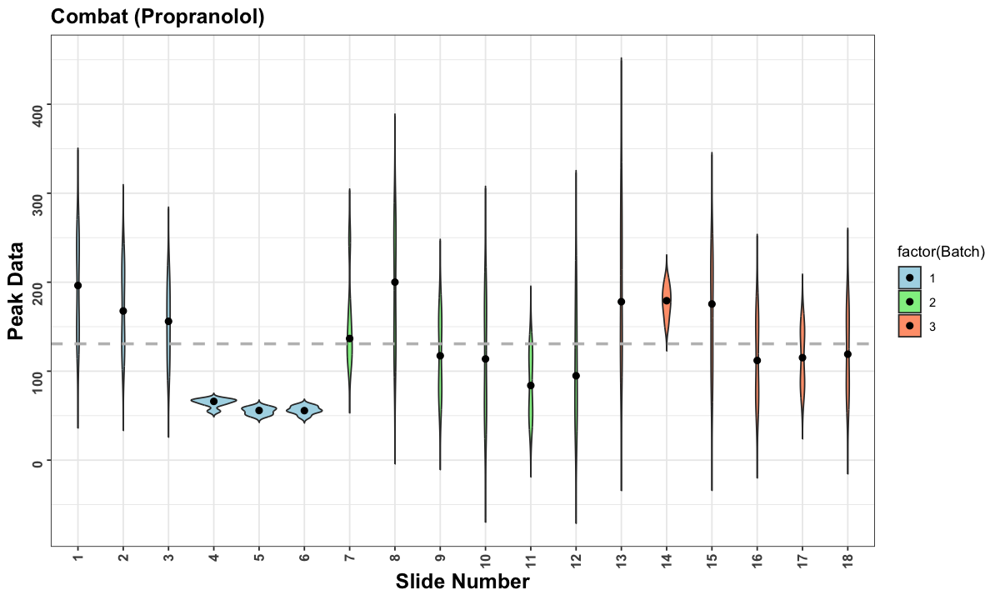

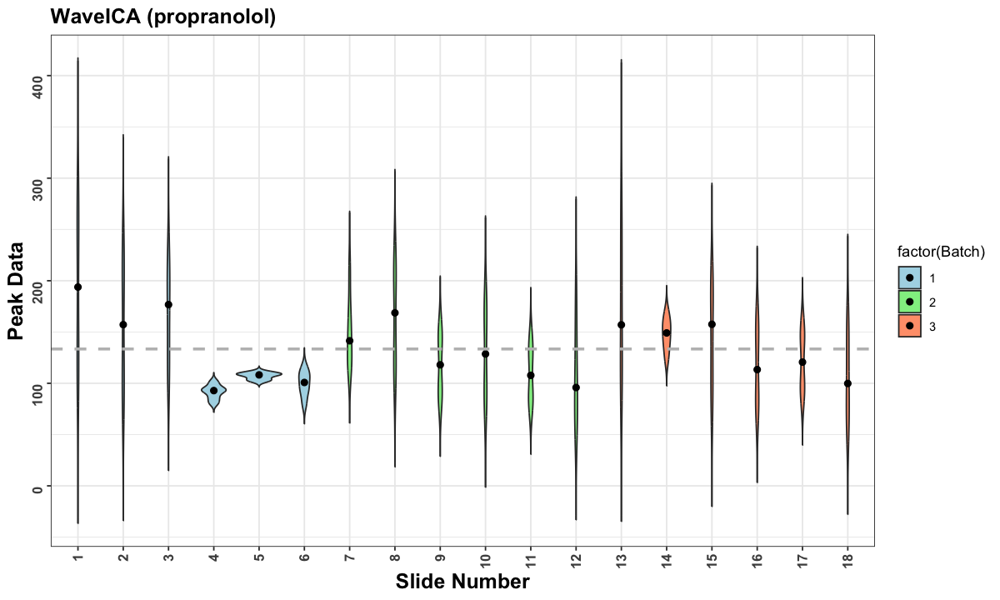

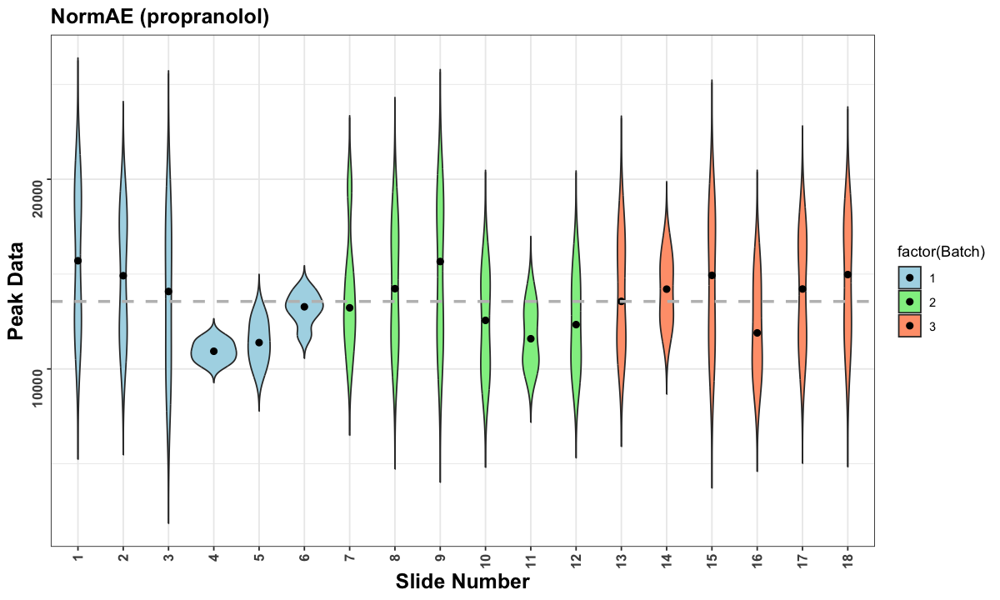

TableGrob (2 x 2) "arrange": 3 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]
3 3 (2-2,1-1) arrange gtable[layout]


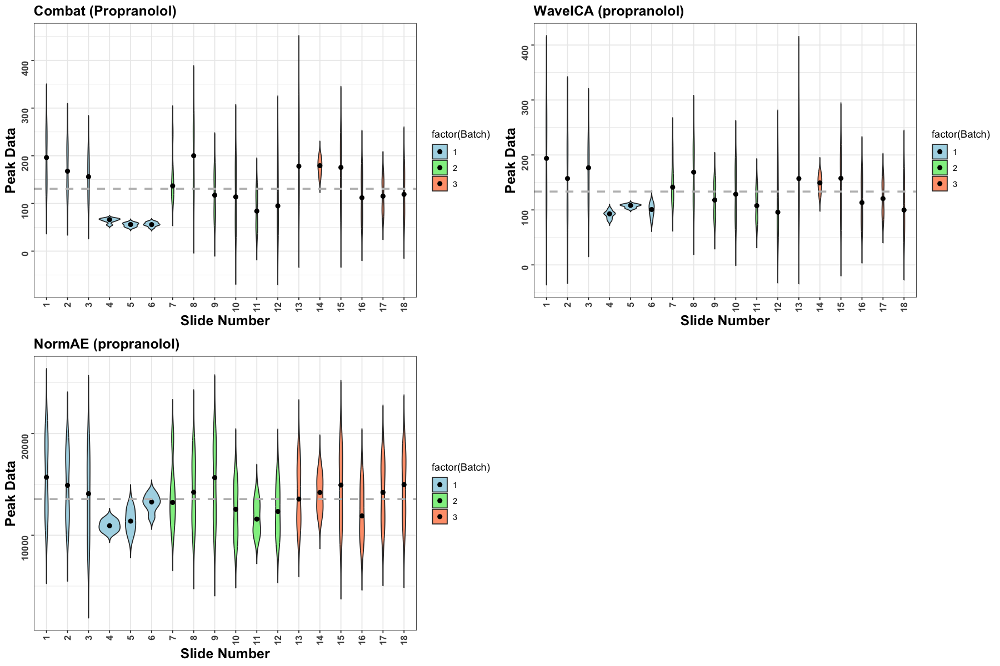

In [153]:
## Violin Plot for propranolol ##

# violin plot for propranolol combat
# Load required library
library(ggplot2)
library(dplyr)

propranolol_data_trans <- as.data.frame(t(propranolol_data_combat))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_combat <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data_combat$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_combat <- violin_data_combat %>%
  arrange(Slide)

# find mean of all samples
mean_value_combat <- mean(violin_data_combat$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_combat <- ggplot(violin_data_combat, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_combat, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "Combat (Propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  
  )

# Display the violin plot
print(violin_plot_combat)

# violin plot for propranolol Waveica
propranolol_data_trans <- as.data.frame(t(propranolol_data_wave))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_wave <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data_wave$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_wave <- violin_data_wave %>%
  arrange(Slide)

# find mean of all samples
mean_value_wave <- mean(violin_data_wave$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_wave <- ggplot(violin_data_wave, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_wave, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "WaveICA (propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_wave)

# violin plot for propranolol normae
propranolol_data_trans <- as.data.frame(t(propranolol_data_norm))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_norm <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_norm <- violin_data_norm %>%
  arrange(Slide)

# find mean of all samples
mean_value_norm <- mean(violin_data_norm$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_norm <- ggplot(violin_data_norm, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_norm, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "NormAE (propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_norm)


## Overview Intensity PLOT ##
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 10)
combined_violin_plots <- grid.arrange(violin_plot_combat, violin_plot_wave, violin_plot_norm, ncol = 2)
print(combined_violin_plots)

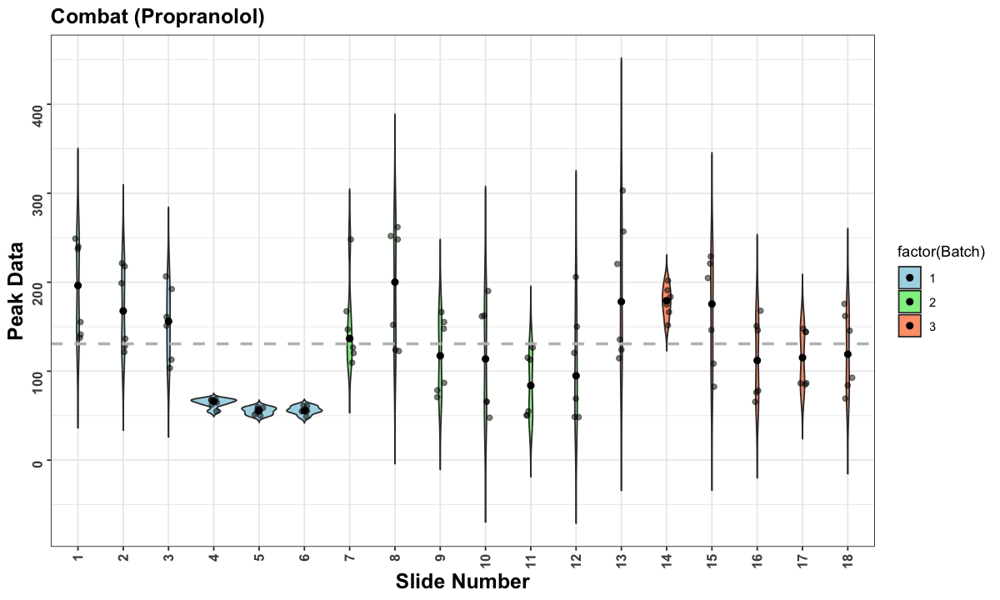

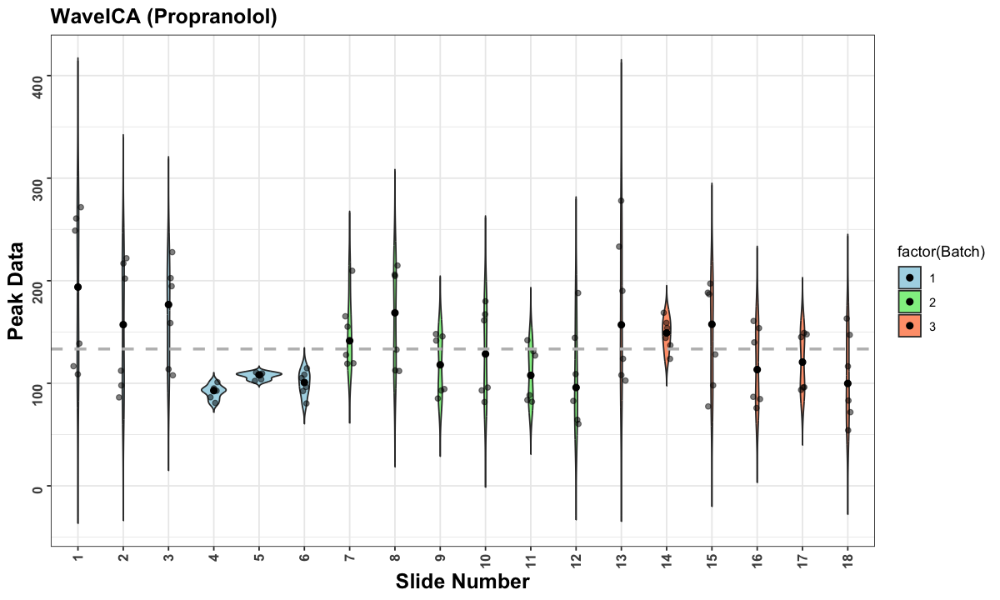

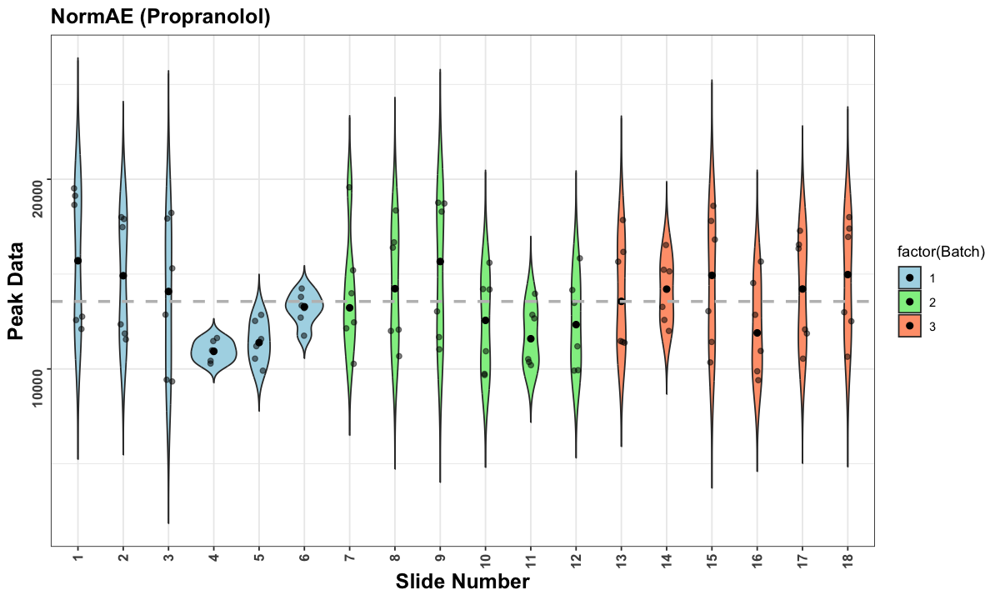

TableGrob (2 x 2) "arrange": 3 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]
3 3 (2-2,1-1) arrange gtable[layout]


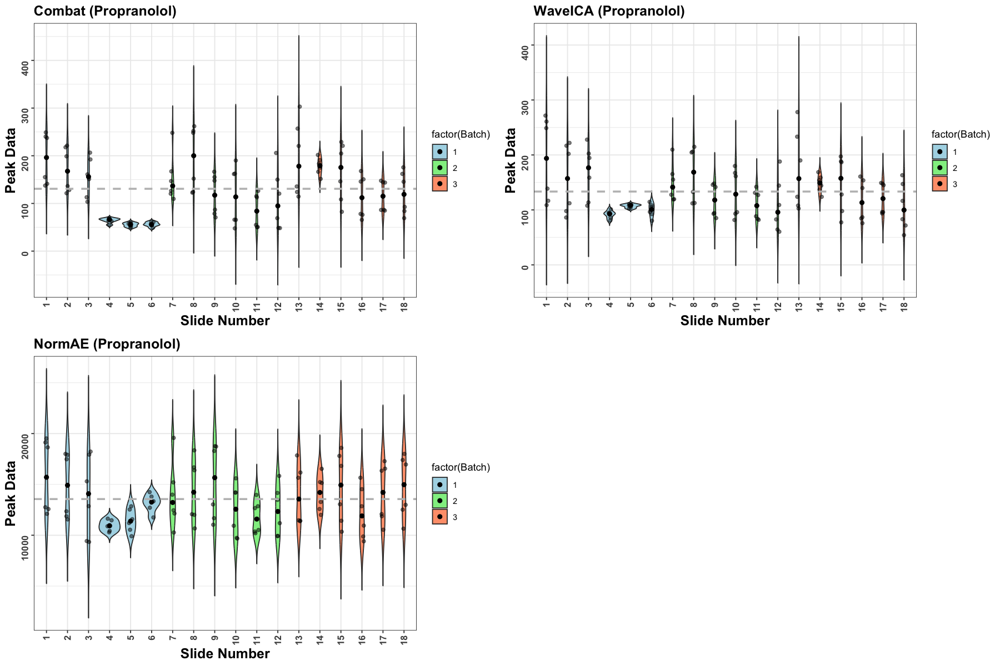

In [155]:
## Violin Plot with Jitter ##
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# combat #
violin_plot_combat_jit <- ggplot(violin_data_combat, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value_combat, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "Combat (Propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )
print(violin_plot_combat_jit)

# waveica #
violin_plot_wave_jit <- ggplot(violin_data_wave, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value_wave, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "WaveICA (Propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )
print(violin_plot_wave_jit)

# normae #
violin_plot_norm_jit <- ggplot(violin_data_norm, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value_norm, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "NormAE (Propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot with dots
print(violin_plot_norm_jit)

## Overview Intensity PLOT ##
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 10)
combined_violin_plots <- grid.arrange(violin_plot_combat_jit, violin_plot_wave_jit, violin_plot_norm_jit, ncol = 2)
print(combined_violin_plots)

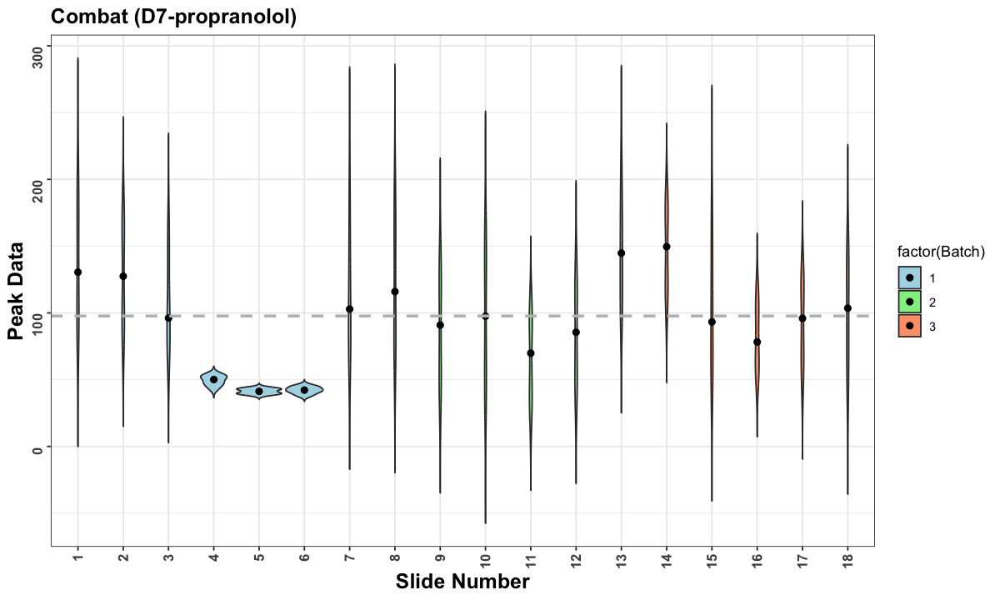

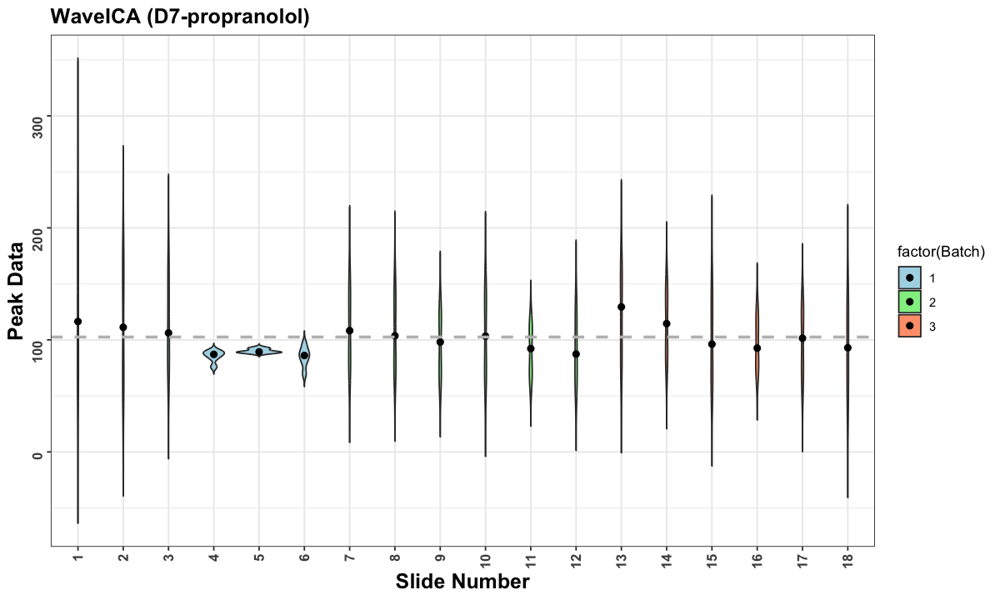

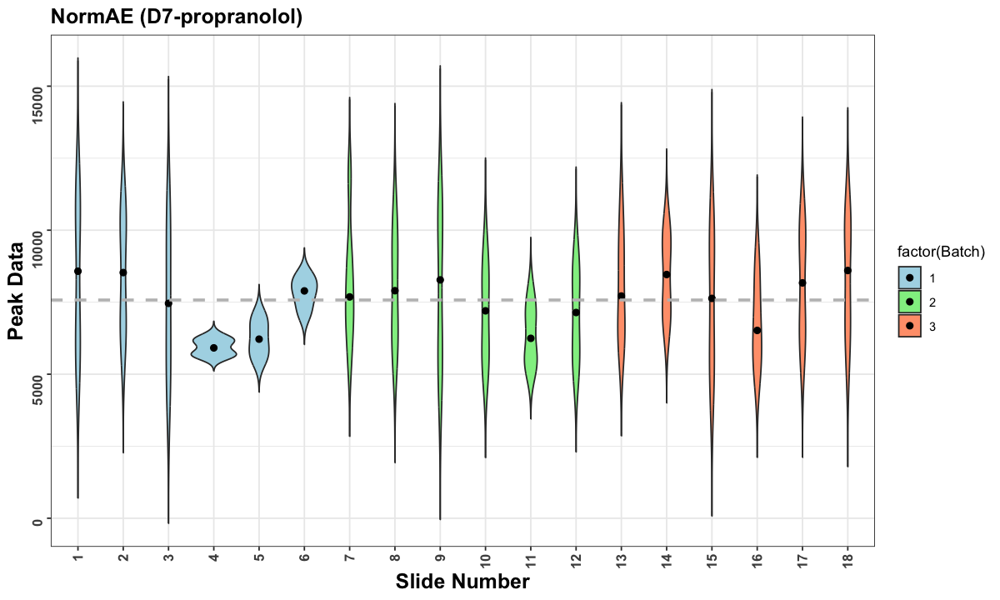

TableGrob (2 x 2) "arrange": 3 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]
3 3 (2-2,1-1) arrange gtable[layout]


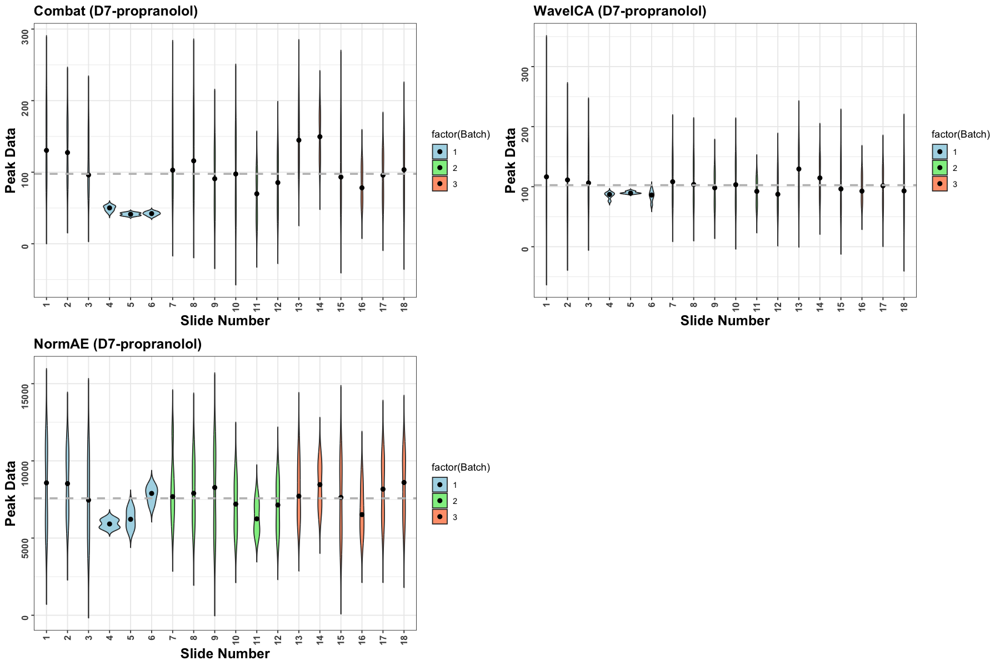

In [92]:
## Violin plot for d7-propranolol ##
# violin plot for d7-propranolol for combat
propranolol_data_trans <- as.data.frame(t(d7_propranolol_data_combat))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_combat <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_combat <- violin_data_combat %>%
  arrange(Slide)

# find mean of all samples
mean_value_combat <- mean(violin_data_combat$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_d7_combat <- ggplot(violin_data_combat, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_combat, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "Combat (D7-propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_d7_combat)

# violin plot for d7-propranolol for wave
propranolol_data_trans <- as.data.frame(t(d7_propranolol_data_wave))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_wave <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_wave <- violin_data_wave %>%
  arrange(Slide)

# find mean of all samples
mean_value_wave <- mean(violin_data_wave$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_d7_wave <- ggplot(violin_data_wave, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_wave, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "WaveICA (D7-propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_d7_wave)

# violin plot for d7-propranolol for norm
propranolol_data_trans <- as.data.frame(t(d7_propranolol_data_norm))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_norm <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_norm <- violin_data_norm %>%
  arrange(Slide)

# find mean of all samples
mean_value_norm <- mean(violin_data_norm$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_d7_norm <- ggplot(violin_data_norm, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_norm, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "NormAE (D7-propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_d7_norm)

## Overview Intensity PLOT ##
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 10)
combined_violin_plots <- grid.arrange(violin_plot_d7_combat, violin_plot_d7_wave, violin_plot_d7_norm, ncol = 2)
print(combined_violin_plots)

Total Score: 80.38 %Total Score: 81.91 %

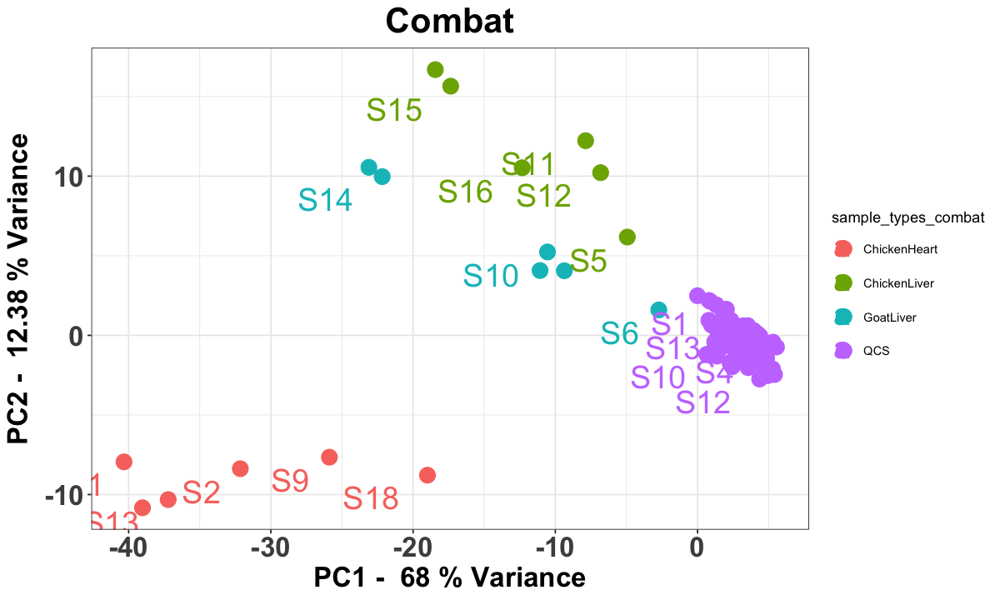

Total Score: 86.73 %

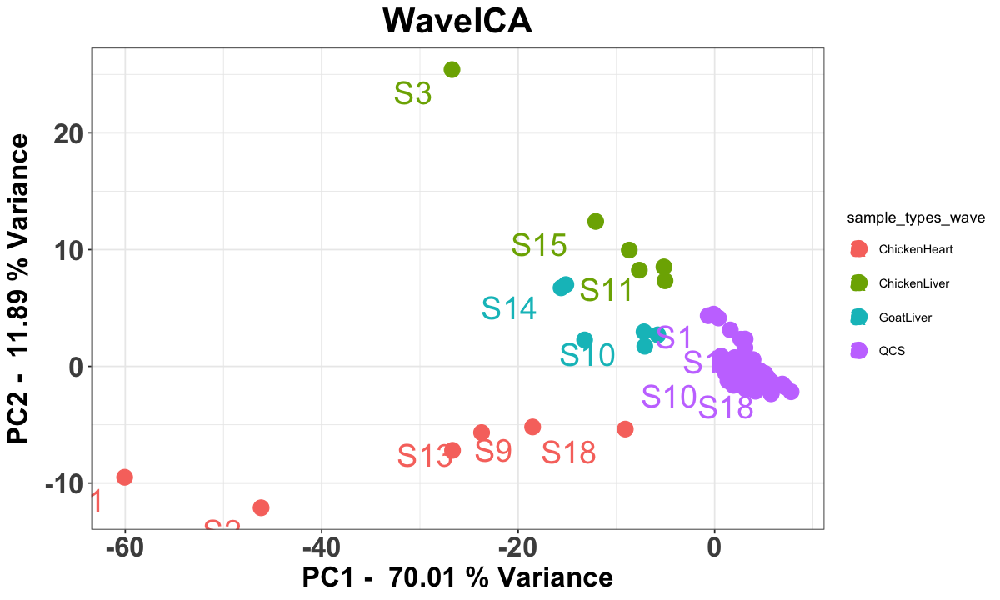

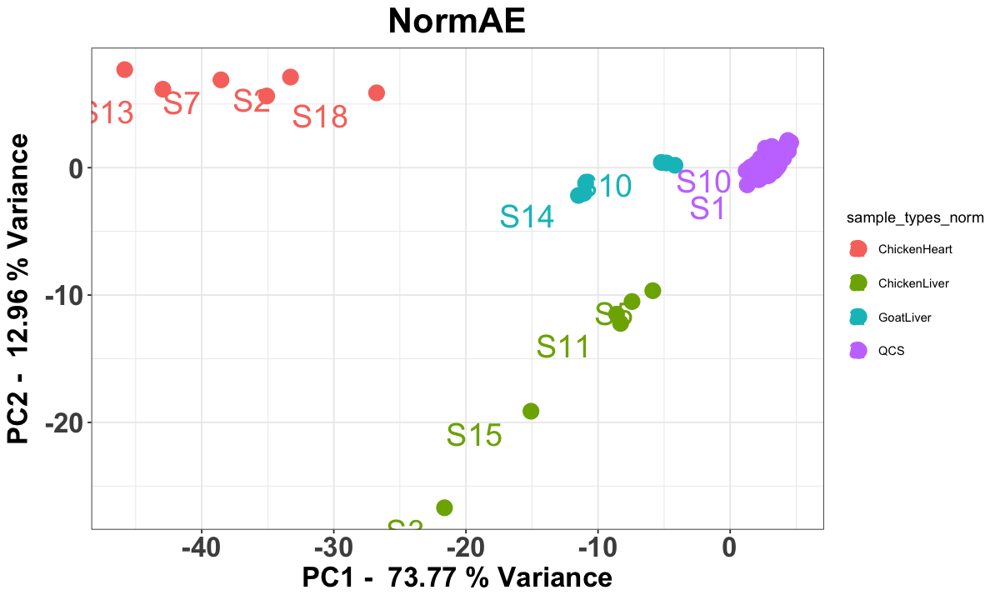

TableGrob (2 x 2) "arrange": 3 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]
3 3 (2-2,1-1) arrange gtable[layout]


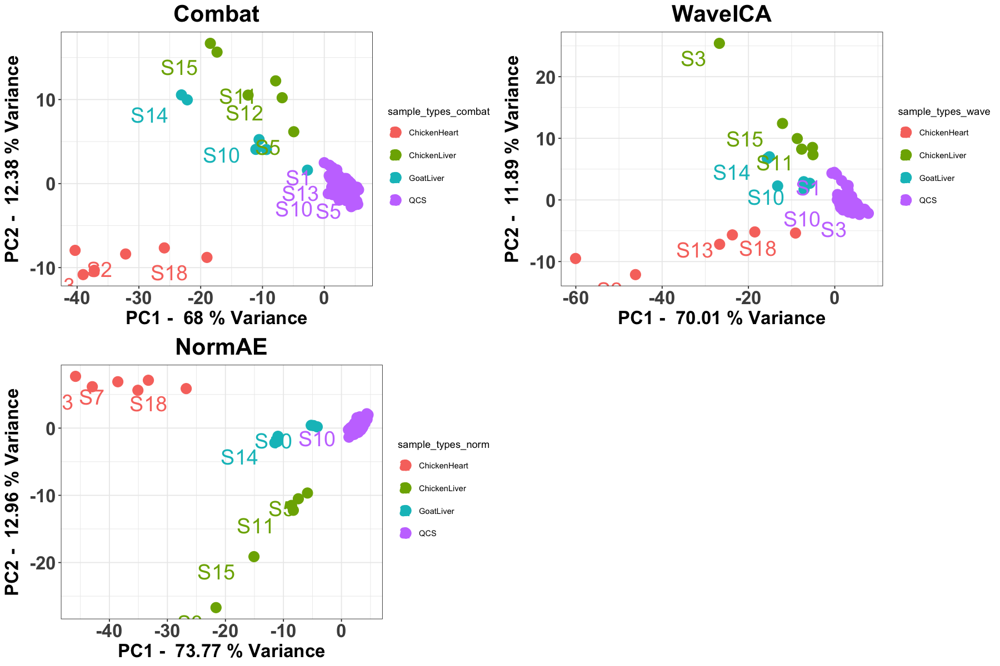

In [93]:
## PCA plot ##
library(stringr)
# pca plot for combat
options(repr.plot.width = 10, repr.plot.height = 6) 
adjusted <- read.csv("dataset/combat_interday_corrected_data.csv", # check file path
                     header = TRUE,
                     stringsAsFactors = FALSE,
                     row.names = 1)

batch_matrix <- data.frame(adjusted)
sample_ID <- str_extract(colnames(batch_matrix), "(S|m/z)\\d+")

# Create the regular expression pattern for sample_set
pattern <- paste(sample_set, collapse = "|")

# Extract sample types from column names using the defined pattern
sample_types_combat <- str_extract(colnames(batch_matrix), pattern)
sample_types_combat[is.na(sample_types_combat)] <- "QCS"

# Transpose the data so that samples are on rows and features on columns
batch_data_t <- t(as.matrix(batch_matrix))

# Create a new data frame with the transposed matrix
batch_data_t_df <- as.data.frame(batch_data_t)

# Perform PCA, assuming batch_data_t_df contains the transposed data
batch_pca_combat <- prcomp(batch_data_t_df, center = TRUE, scale. = TRUE)

# Create a data frame for plotting the PCA
pca_data_combat <- data.frame(Sample = sample_ID, batch_pca_combat$x)

# Plot PCA with colored sample dots based on sample type
pca_data_combat$Score <- pca_data_combat$PC1 + pca_data_combat$PC2
pca_data_combat$Type <- sample_types_combat

# Calculate the PC1 and PC2 scores
pc1_score <- batch_pca_combat$sdev[1]^2
pc2_score <- batch_pca_combat$sdev[2]^2

# Calculate the total score as the sum of PC1 and PC2 scores
total_score <- pc1_score + pc2_score

# Display the score 
total_score_text_recon <- paste("Total Score:", round(total_score / sum(batch_pca_combat$sdev^2) * 100, 2), "%")
cat(total_score_text_recon)

# Create PCA plot
plot_combat <- ggplot(pca_data_combat, aes(x = PC1, y = PC2, color = sample_types_combat, label = Sample)) +
  geom_point(size = 5) +
  geom_text(hjust = 1.5, vjust = 1.5, size = 8, check_overlap = TRUE) +  # Increased label size
  xlab(paste("PC1 - ", round(batch_pca_combat$sdev[1]^2 / sum(batch_pca_combat$sdev^2) * 100, 2), "% Variance")) +
  ylab(paste("PC2 - ", round(batch_pca_combat$sdev[2]^2 / sum(batch_pca_combat$sdev^2) * 100, 2), "% Variance")) +
  ggtitle("Combat") +
  theme_bw() +
  theme(legend.position = "right", axis.text = element_text(size = 20, face='bold'), 
        axis.title = element_text(size = 20, face='bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'))
print(plot_combat)

# pca plot for waveica
adjusted <- as.data.frame(t(waveica_result_interday))

batch_matrix <- data.frame(adjusted)
sample_ID <- str_extract(colnames(batch_matrix), "(S|m/z)\\d+")

# Create the regular expression pattern for sample_set
pattern <- paste(sample_set, collapse = "|")

# Extract sample types from column names using the defined pattern
sample_types_wave <- str_extract(colnames(batch_matrix), pattern)
sample_types_wave[is.na(sample_types_wave)] <- "QCS"

# Transpose the data so that samples are on rows and features on columns
batch_data_t <- t(as.matrix(batch_matrix))

# Create a new data frame with the transposed matrix
batch_data_t_df <- as.data.frame(batch_data_t)

# Perform PCA, assuming batch_data_t_df contains the transposed data
batch_pca_wave <- prcomp(batch_data_t_df, center = TRUE, scale. = TRUE)

# Create a data frame for plotting the PCA
pca_data_wave <- data.frame(Sample = sample_ID, batch_pca_wave$x)

# Plot PCA with colored sample dots based on sample type
pca_data_wave$Score <- pca_data_wave$PC1 + pca_data_wave$PC2
pca_data_wave$Type <- sample_types_wave

# Calculate the PC1 and PC2 scores
pc1_score <- batch_pca_wave$sdev[1]^2
pc2_score <- batch_pca_wave$sdev[2]^2

# Calculate the total score as the sum of PC1 and PC2 scores
total_score <- pc1_score + pc2_score

# Display the score 
total_score_text_recon <- paste("Total Score:", round(total_score / sum(batch_pca_wave$sdev^2) * 100, 2), "%")
cat(total_score_text_recon)

# Create PCA plot
plot_wave <- ggplot(pca_data_wave, aes(x = PC1, y = PC2, color = sample_types_wave, label = Sample)) +
  geom_point(size = 5) +
  geom_text(hjust = 1.5, vjust = 1.5, size = 8, check_overlap = TRUE) +  # Increased label size
  xlab(paste("PC1 - ", round(batch_pca_wave$sdev[1]^2 / sum(batch_pca_wave$sdev^2) * 100, 2), "% Variance")) +
  ylab(paste("PC2 - ", round(batch_pca_wave$sdev[2]^2 / sum(batch_pca_wave$sdev^2) * 100, 2), "% Variance")) +
  ggtitle("WaveICA") +
  theme_bw() +
  theme(legend.position = "right", axis.text = element_text(size = 20, face='bold'), 
        axis.title = element_text(size = 20, face='bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'))
print(plot_wave)

# pca plot for normae
adjusted <- read.csv("dataset/Rec_nobe_no_norm.csv", # check file path
                     header = TRUE,
                     stringsAsFactors = FALSE)
adjusted <- adjusted[, -1]

batch_matrix <- data.frame(adjusted)
sample_ID <- str_extract(colnames(batch_matrix), "(S|m/z)\\d+")

# Create the regular expression pattern for sample_set
pattern <- paste(sample_set, collapse = "|")

# Extract sample types from column names using the defined pattern
sample_types_norm <- str_extract(colnames(batch_matrix), pattern)
sample_types_norm[is.na(sample_types_norm)] <- "QCS"

# Transpose the data so that samples are on rows and features on columns
batch_data_t <- t(as.matrix(batch_matrix))

# Create a new data frame with the transposed matrix
batch_data_t_df <- as.data.frame(batch_data_t)

# Perform PCA, assuming batch_data_t_df contains the transposed data
batch_pca_norm <- prcomp(batch_data_t_df, center = TRUE, scale. = TRUE)

# Create a data frame for plotting the PCA
pca_data_norm <- data.frame(Sample = sample_ID, batch_pca_norm$x)

# Plot PCA with colored sample dots based on sample type
pca_data_norm$Score <- pca_data_norm$PC1 + pca_data_norm$PC2
pca_data_norm$Type <- sample_types_norm

# Calculate the PC1 and PC2 scores
pc1_score <- batch_pca_norm$sdev[1]^2
pc2_score <- batch_pca_norm$sdev[2]^2

# Calculate the total score as the sum of PC1 and PC2 scores
total_score <- pc1_score + pc2_score

# Display the score 
total_score_text_recon <- paste("Total Score:", round(total_score / sum(batch_pca_norm$sdev^2) * 100, 2), "%")
cat(total_score_text_recon)

# Create PCA plot
plot_norm <- ggplot(pca_data_norm, aes(x = PC1, y = PC2, color = sample_types_norm, label = Sample)) +
  geom_point(size = 5) +
  geom_text(hjust = 1.5, vjust = 1.5, size = 8, check_overlap = TRUE) +  # Increased label size
  xlab(paste("PC1 - ", round(batch_pca_norm$sdev[1]^2 / sum(batch_pca_norm$sdev^2) * 100, 2), "% Variance")) +
  ylab(paste("PC2 - ", round(batch_pca_norm$sdev[2]^2 / sum(batch_pca_norm$sdev^2) * 100, 2), "% Variance")) +
  ggtitle("NormAE") +
  theme_bw() +
  theme(legend.position = "right", axis.text = element_text(size = 20, face='bold'), 
        axis.title = element_text(size = 20, face='bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'))
print(plot_norm)

## Overview PCA PLOT ##
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 10)
combined_pca_plots <- grid.arrange(plot_combat, plot_wave, plot_norm, ncol = 2)
print(combined_pca_plots)

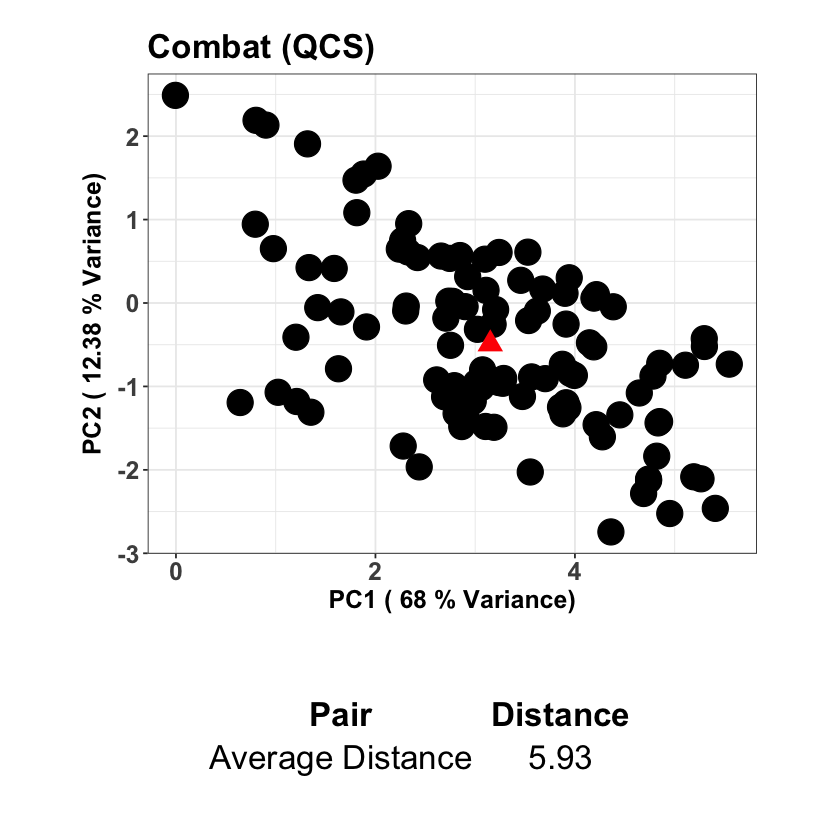

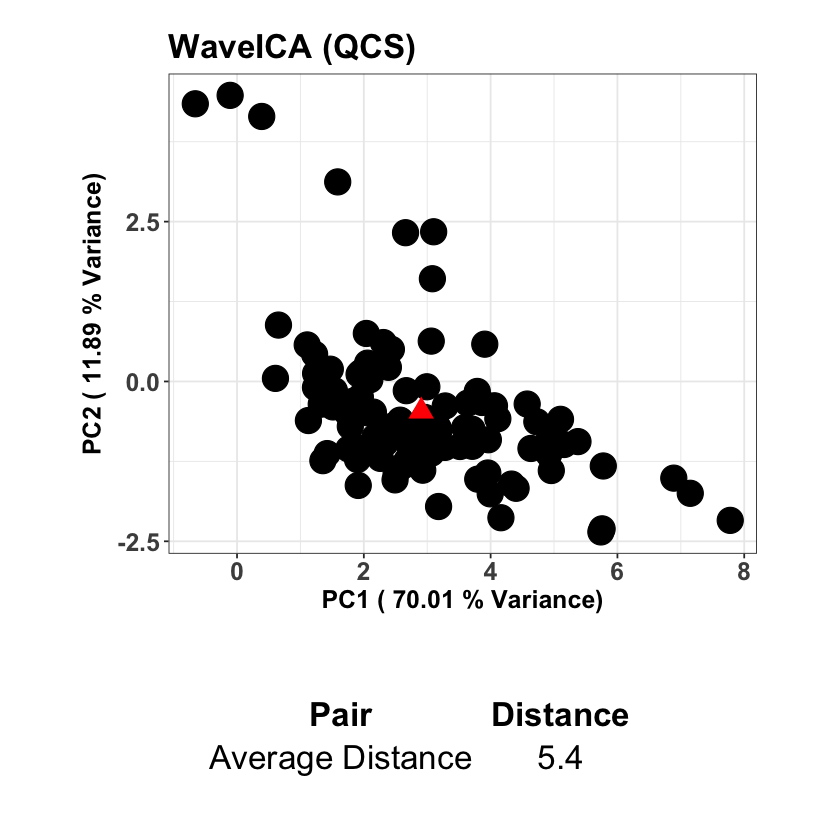

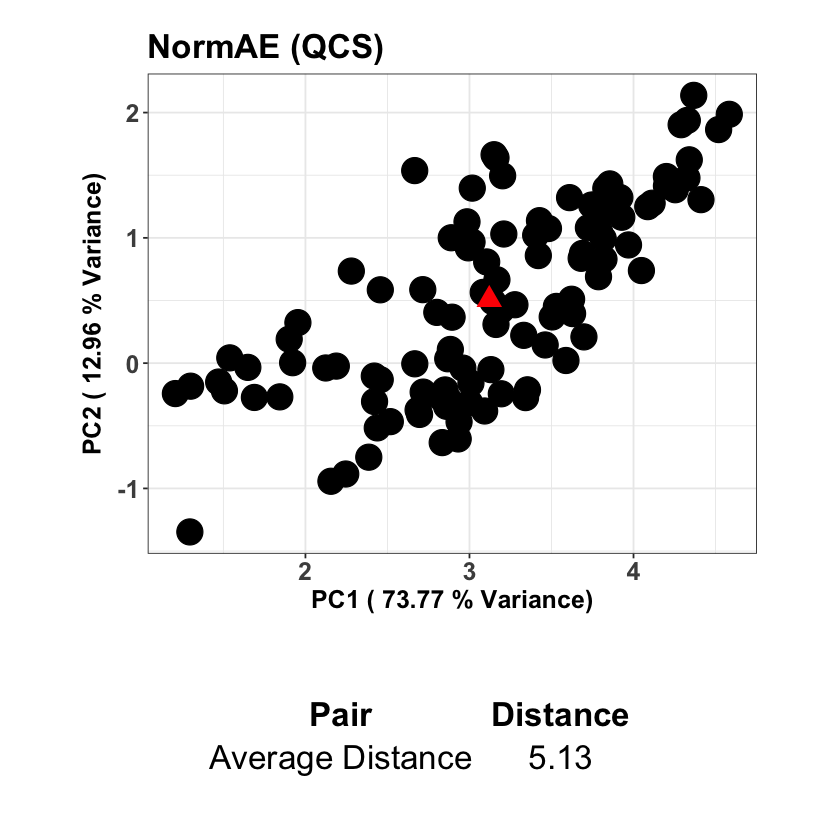

TableGrob (2 x 2) "arrange": 3 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]
3 3 (2-2,1-1) arrange gtable[layout]


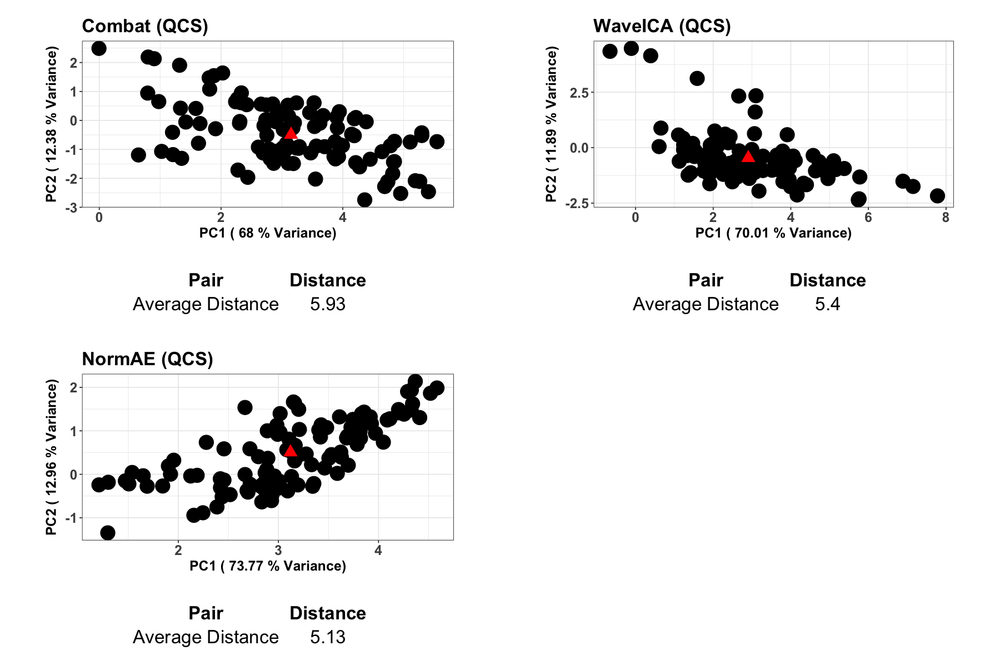

In [94]:
## QCS PCA Plot ##
# combat
# no normalization raw data
# Load necessary libraries
library(ggplot2)
library(ggrepel)
library(cowplot)
library(gridExtra)

# gets rid of plot format
options(repr.plot.width = NULL, repr.plot.height = NULL)

# Calculate PCA scores
pca_scores <- batch_pca_combat$x

# Identify QCS samples based on sample types
qcs_samples <- which(sample_types_combat == "QCS")

# Extract PCA scores for QCS samples
qcs_scores <- pca_scores[qcs_samples, ]

# Compute the centroid of QCS samples
qcs_centroid <- colMeans(qcs_scores)

# Calculate PC1 and PC2 variances
pc1_variance <- round(batch_pca_combat$sdev[1]^2 / sum(batch_pca_combat$sdev^2) * 100, 2)
pc2_variance <- round(batch_pca_combat$sdev[2]^2 / sum(batch_pca_combat$sdev^2) * 100, 2)

# Plot PCA plot with QCS samples and their centroid
pca_plot_qcs_combat <- ggplot(data.frame(PC1 = qcs_scores[,1], PC2 = qcs_scores[,2]), aes(x = PC1, y = PC2)) +
  geom_point(size = 7) +  # Plot QCS samples
  geom_point(data = data.frame(PC1 = qcs_centroid[1], PC2 = qcs_centroid[2]), aes(x = PC1, y = PC2), shape = 17, fill = "red", color = "red", size = 5) +  # Plot centroid as triangle with filled red color
  labs(x = paste("PC1 (", pc1_variance, "% Variance)"), y = paste("PC2 (", pc2_variance, "% Variance)"), title = "Combat (QCS)") +
  theme_bw() +
  theme(axis.title.x = element_text(face = "bold", size = 15),
        axis.title.y = element_text(face = "bold", size = 15),
        axis.text = element_text(size = 15, face = "bold"),
        plot.margin = margin(20, 50, 10, 50),  # Adjust the bottom margin to 10 units
        plot.title = element_text(face = "bold", size = 20))  # Make the plot title bold and size 20

# Calculate average distance of QCS samples from the centroid
qcs_centroid_distances <- sqrt(rowSums((qcs_scores - qcs_centroid)^2))
average_qcs_distance_combat <- mean(qcs_centroid_distances)

# Create a data frame for average distance
average_distance_qcs_df_combat <- data.frame(
  Pair = "Average Distance",
  Distance = average_qcs_distance_combat
)

# Round distances for better presentation
average_distance_qcs_df_combat$Distance <- round(average_distance_qcs_df_combat$Distance, 2)

# Create a table plot
table_plot_qcs <- tableGrob(average_distance_qcs_df_combat, theme = ttheme_minimal(base_size = 20), rows = NULL)

# Combine the PCA plot and the table
combined_plot_combat_qcs <- plot_grid(pca_plot_qcs_combat, table_plot_qcs, ncol = 1, align = "v", axis = "lr", rel_heights = c(3, 1))

# Print the combined plot
print(combined_plot_combat_qcs)

# waveica
## PCA plot of QCS ##
# no normalization raw data
# Load necessary libraries
library(ggplot2)
library(ggrepel)
library(cowplot)
library(gridExtra)

# gets rid of plot format
options(repr.plot.width = NULL, repr.plot.height = NULL)

# Calculate PCA scores
pca_scores <- batch_pca_wave$x

# Identify QCS samples based on sample types
qcs_samples <- which(sample_types_wave == "QCS")

# Extract PCA scores for QCS samples
qcs_scores <- pca_scores[qcs_samples, ]

# Compute the centroid of QCS samples
qcs_centroid <- colMeans(qcs_scores)

# Calculate PC1 and PC2 variances
pc1_variance <- round(batch_pca_wave$sdev[1]^2 / sum(batch_pca_wave$sdev^2) * 100, 2)
pc2_variance <- round(batch_pca_wave$sdev[2]^2 / sum(batch_pca_wave$sdev^2) * 100, 2)

# Plot PCA plot with QCS samples and their centroid
pca_plot_qcs_wave <- ggplot(data.frame(PC1 = qcs_scores[,1], PC2 = qcs_scores[,2]), aes(x = PC1, y = PC2)) +
  geom_point(size = 7) +  # Plot QCS samples
  geom_point(data = data.frame(PC1 = qcs_centroid[1], PC2 = qcs_centroid[2]), aes(x = PC1, y = PC2), shape = 17, fill = "red", color = "red", size = 5) +  # Plot centroid as triangle with filled red color
  labs(x = paste("PC1 (", pc1_variance, "% Variance)"), y = paste("PC2 (", pc2_variance, "% Variance)"), title = "WaveICA (QCS)") +
  theme_bw() +
  theme(axis.title.x = element_text(face = "bold", size = 15),
        axis.title.y = element_text(face = "bold", size = 15),
        axis.text = element_text(size = 15, face = "bold"),
        plot.margin = margin(20, 50, 10, 50),  # Adjust the bottom margin to 10 units
        plot.title = element_text(face = "bold", size = 20))  # Make the plot title bold and size 20

# Calculate average distance of QCS samples from the centroid
qcs_centroid_distances <- sqrt(rowSums((qcs_scores - qcs_centroid)^2))
average_qcs_distance_wave <- mean(qcs_centroid_distances)

# Create a data frame for average distance
average_distance_qcs_df_wave <- data.frame(
  Pair = "Average Distance",
  Distance = average_qcs_distance_wave
)

# Round distances for better presentation
average_distance_qcs_df_wave$Distance <- round(average_distance_qcs_df_wave$Distance, 2)

# Create a table plot
table_plot_qcs <- tableGrob(average_distance_qcs_df_wave, theme = ttheme_minimal(base_size = 20), rows = NULL)

# Combine the PCA plot and the table
combined_plot_wave_qcs <- plot_grid(pca_plot_qcs_wave, table_plot_qcs, ncol = 1, align = "v", axis = "lr", rel_heights = c(3, 1))

# Print the combined plot
print(combined_plot_wave_qcs)


# normae
## PCA plot of QCS ##
# no normalization raw data
# Load necessary libraries
library(ggplot2)
library(ggrepel)
library(cowplot)
library(gridExtra)

# gets rid of plot format
options(repr.plot.width = NULL, repr.plot.height = NULL)

# Calculate PCA scores
pca_scores <- batch_pca_norm$x

# Identify QCS samples based on sample types
qcs_samples <- which(sample_types_norm == "QCS")

# Extract PCA scores for QCS samples
qcs_scores <- pca_scores[qcs_samples, ]

# Compute the centroid of QCS samples
qcs_centroid <- colMeans(qcs_scores)

# Calculate PC1 and PC2 variances
pc1_variance <- round(batch_pca_norm$sdev[1]^2 / sum(batch_pca_norm$sdev^2) * 100, 2)
pc2_variance <- round(batch_pca_norm$sdev[2]^2 / sum(batch_pca_norm$sdev^2) * 100, 2)

# Plot PCA plot with QCS samples and their centroid
pca_plot_qcs_norm <- ggplot(data.frame(PC1 = qcs_scores[,1], PC2 = qcs_scores[,2]), aes(x = PC1, y = PC2)) +
  geom_point(size = 7) +  # Plot QCS samples
  geom_point(data = data.frame(PC1 = qcs_centroid[1], PC2 = qcs_centroid[2]), aes(x = PC1, y = PC2), shape = 17, fill = "red", color = "red", size = 5) +  # Plot centroid as triangle with filled red color
  labs(x = paste("PC1 (", pc1_variance, "% Variance)"), y = paste("PC2 (", pc2_variance, "% Variance)"), title = "NormAE (QCS)") +
  theme_bw() +
  theme(axis.title.x = element_text(face = "bold", size = 15),
        axis.title.y = element_text(face = "bold", size = 15),
        axis.text = element_text(size = 15, face = "bold"),
        plot.margin = margin(20, 50, 10, 50),  # Adjust the bottom margin to 10 units
        plot.title = element_text(face = "bold", size = 20))  # Make the plot title bold and size 20

# Calculate average distance of QCS samples from the centroid
qcs_centroid_distances <- sqrt(rowSums((qcs_scores - qcs_centroid)^2))
average_qcs_distance_norm <- mean(qcs_centroid_distances)

# Create a data frame for average distance
average_distance_qcs_df_norm <- data.frame(
  Pair = "Average Distance",
  Distance = average_qcs_distance_norm
)

# Round distances for better presentation
average_distance_qcs_df_norm$Distance <- round(average_distance_qcs_df_norm$Distance, 2)

# Create a table plot
table_plot_qcs <- tableGrob(average_distance_qcs_df_norm, theme = ttheme_minimal(base_size = 20), rows = NULL)

# Combine the PCA plot and the table
combined_plot_norm_qcs <- plot_grid(pca_plot_qcs_norm, table_plot_qcs, ncol = 1, align = "v", axis = "lr", rel_heights = c(3, 1))

# Print the combined plot
print(combined_plot_norm_qcs)

## Overview PCA PLOT ##
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 10)
combined_qcs_pca_plots <- grid.arrange(combined_plot_combat_qcs, combined_plot_wave_qcs, combined_plot_norm_qcs, ncol = 2)
print(combined_qcs_pca_plots)

In [95]:
## Calculate QCS eucleadan distance ##
# Combat 
qcs_indices <- which(pca_data_combat$Type == "QCS") 
pca_scores_qcs <- pca_data_combat[qcs_indices, -which(names(pca_data_combat) == "Score")]
numeric_cols <- sapply(pca_scores_qcs, is.numeric)
pca_scores_numeric <- pca_scores_qcs[, numeric_cols]

# calculate euclidean distance
euclidean_distances <- dist(pca_scores_numeric)
average_distance_ec_combat <- mean(euclidean_distances)
cat("Average QCS distance for Combat normalization is", average_distance_ec_combat, "\n")

# WaveICA
qcs_indices <- which(pca_data_wave$Type == "QCS") 
pca_scores_qcs <- pca_data_wave[qcs_indices, -which(names(pca_data_wave) == "Score")]
numeric_cols <- sapply(pca_scores_qcs, is.numeric)
pca_scores_numeric <- pca_scores_qcs[, numeric_cols]

# calculate euclidean distance
euclidean_distances <- dist(pca_scores_numeric)
average_distance_ec_wave <- mean(euclidean_distances)
cat("Average QCS distance for WaveICA normalization is", average_distance_ec_wave, "\n")

# NormAE
qcs_indices <- which(pca_data_norm$Type == "QCS") 
pca_scores_qcs <- pca_data_norm[qcs_indices, -which(names(pca_data_norm) == "Score")]
numeric_cols <- sapply(pca_scores_qcs, is.numeric)
pca_scores_numeric <- pca_scores_qcs[, numeric_cols]

# calculate euclidean distance
euclidean_distances <- dist(pca_scores_numeric)
average_distance_ec_norm <- mean(euclidean_distances)
cat("Average QCS distance for Norm normalization is", average_distance_ec_norm, "\n")

Average QCS distance for Combat normalization is 5.248275 
Average QCS distance for WaveICA normalization is 4.753652 
Average QCS distance for Norm normalization is 3.29667 


In [96]:
## Tissue RSD Table ##
## Tissue Variation RSD Combat ##
## QCS RSD Calculation ## combat

data <- read.csv("dataset/combat_interday_corrected_data.csv", # check file path
                 header = TRUE,
                 stringsAsFactors = FALSE,
                 row.names = 1) 
row_names <- rownames(data)
batch_info_norm <- read.csv("input/batch_info_TIC.csv", # check file path
                            header = TRUE,
                            stringsAsFactors = FALSE)
injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data)
new_row_names <- c("injection_order", "batch", row_names)
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))
sample_set <- c("ChickenHeart", "ChickenLiver", "GoatLiver")
sample_set_regex <- paste(sample_set, collapse = "|")
sample_set_rows <- grep(sample_set_regex, rownames(transposed_data))
tissue_samples <- transposed_data[sample_set_rows,]
row_names <- rownames(tissue_samples)
tissue_samples <- as.data.frame(apply(tissue_samples, 2, as.numeric))
rownames(tissue_samples) <- row_names

# Function to calculate rsd for tissue
calculate_batch_rsd_combined <- function(tissue_samples) {
  # Function to calculate batch RSD for a given tissue dataset
  calculate_batch_rsd <- function(sample_dataset, batch_number) {
    # Extract data for the specified batch number
    batch_data <- sample_dataset[sample_dataset$batch == batch_number, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(batch_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(batch_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate interday RSD for a given tissue dataset
  calculate_interday_rsd <- function(sample_dataset) {
    # Extract data for interday calculation
    interday_data <- sample_dataset[, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(interday_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(interday_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate batch RSD for multiple batches
  calculate_batch_rsd_multiple <- function(sample_dataset, unique_batches) {
    rsd_results <- list()
    for (batch_number in unique_batches) {
      rsd_results[[as.character(batch_number)]] <- calculate_batch_rsd(sample_dataset, batch_number)
    }
    return(rsd_results)
  }
  
  # Extract unique tissue sample datasets for each tissue type
  unique_tissues <- unique(gsub(".*_(\\w+)_\\d+.*", "\\1", rownames(tissue_samples)))
  
  # Initialize list to store results for each tissue type
  rsd_results <- list()
  
  # Loop through each tissue type
  for (tissue_type in unique_tissues) {
    # Filter tissue samples for the current tissue type
    tissue_data <- tissue_samples[grep(paste0(tissue_type, "_"), rownames(tissue_samples)), ]
    
    # Order the dataset based on s_value
    sample_numbers <- as.numeric(gsub(".*S(\\d+)_.*", "\\1", rownames(tissue_data)))
    ordered_indices <- order(sample_numbers)
    tissue_data <- tissue_data[ordered_indices, ]
    
    # Replace negative values with 1
    tissue_data <- replace(tissue_data, tissue_data < 0, 1)
    
    # Calculate batch RSD for unique batches
    unique_batches <- unique(tissue_data$batch)
    rsd_results_tissue <- calculate_batch_rsd_multiple(tissue_data, unique_batches)
    
    # Calculate interday RSD
    interday_rsd <- calculate_interday_rsd(tissue_data)
    
    # Combine batch and interday RSD results into a data frame
    rsd_df_tissue <- data.frame(
      Batch = names(rsd_results_tissue),
      RSD = unlist(rsd_results_tissue)
    )
    rsd_df_tissue <- rbind(rsd_df_tissue, c("Interday", interday_rsd))
    rownames(rsd_df_tissue) <- NULL
    
    # Alter batch names to Intraday 1, Intraday 2, etc.
    batch_names <- c("Intraday 1", "Intraday 2", "Intraday 3")
    rsd_df_tissue$Batch <- ifelse(rsd_df_tissue$Batch == "Interday", "Interday", batch_names)
    
    # Store results for the current tissue type
    rsd_results[[tissue_type]] <- rsd_df_tissue
  }
  
  return(rsd_results)
}

rsd_results_combined_combat <- calculate_batch_rsd_combined(tissue_samples)
#print(rsd_results_combined_combat)

# Assuming rsd_results_combined is the output of calculate_batch_rsd_combined

library(kableExtra)
library(IRdisplay)

# Create a function to generate HTML tables for each tissue
generate_rsd_table <- function(rsd_results, tissue_name) {
  rsd_df <- rsd_results[[tissue_name]]
  kable(rsd_df, format = "html", row.names = FALSE) %>%
    kable_styling(full_width = FALSE)
}

# Generate HTML tables for each tissue
html_tables_combat <- lapply(names(rsd_results_combined_combat), function(tissue_name) {
  rsd_table <- generate_rsd_table(rsd_results_combined_combat, tissue_name)
  table_name <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>", sep = "")
  paste("<div style='display: inline-block; margin-right: 20px; text-align: center;'>", table_name, as.character(rsd_table), "</div>")
})

# Combine HTML tables into a single string
html_content_combat <- paste(html_tables_combat, collapse = "")

# Wrap the combined HTML content in a div with text-align: center
centered_html_content_combat <- paste("<div style='text-align: center;'>", html_content_combat, "</div>")

# Display the centered HTML content in JupyterLab
display_html(centered_html_content_combat)

Batch,RSD
Intraday 1,21.95 ± 9.34%
Intraday 2,29.78 ± 11.92%
Intraday 3,27.63 ± 13.00%
Interday,32.26 ± 13.97%
Batch,RSD
Intraday 1,35.48 ± 11.20%
Intraday 2,7.49 ± 6.36%
Intraday 3,12.35 ± 7.94%
Interday,26.44 ± 16.06%
Batch,RSD


In [97]:
## Tissue Variation RSD WaveICA ##
data <- as.data.frame(t(waveica_result_interday)) 
row_names <- rownames(data)
batch_info_norm <- read.csv("input/batch_info_TIC.csv", # check file path
                            header = TRUE,
                            stringsAsFactors = FALSE)

injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data)
new_row_names <- c("injection_order", "batch", row_names)
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))
sample_set_regex <- paste(sample_set, collapse = "|")
sample_set_rows <- grep(sample_set_regex, rownames(transposed_data)) #126 obs of 121 variables
tissue_samples <- transposed_data[sample_set_rows,]
row_names <- rownames(tissue_samples)
tissue_samples <- as.data.frame(apply(tissue_samples, 2, as.numeric))
rownames(tissue_samples) <- row_names

# run function
rsd_results_combined_wave <- calculate_batch_rsd_combined(tissue_samples)
#print(rsd_results_combined_wave)

# generate RSD table as html
library(kableExtra)
library(IRdisplay)

# Create a function to generate HTML tables for each tissue
generate_rsd_table <- function(rsd_results, tissue_name) {
  rsd_df <- rsd_results[[tissue_name]]
  kable(rsd_df, format = "html", row.names = FALSE) %>%
    kable_styling(full_width = FALSE)
}

# Generate HTML tables for each tissue
html_tables_wave <- lapply(names(rsd_results_combined_wave), function(tissue_name) {
  rsd_table <- generate_rsd_table(rsd_results_combined_wave, tissue_name)
  table_name <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>", sep = "")
  paste("<div style='display: inline-block; margin-right: 20px; text-align: center;'>", table_name, as.character(rsd_table), "</div>")
})

# Combine HTML tables into a single string
html_content_wave <- paste(html_tables_wave, collapse = "")

# Wrap the combined HTML content in a div with text-align: center
centered_html_content_wave <- paste("<div style='text-align: center;'>", html_content_wave, "</div>")

# Display the centered HTML content in JupyterLab
display_html(centered_html_content_wave)

Batch,RSD
Intraday 1,17.69 ± 16.22%
Intraday 2,19.88 ± 7.04%
Intraday 3,24.69 ± 16.19%
Interday,21.13 ± 11.08%
Batch,RSD
Intraday 1,36.21 ± 17.90%
Intraday 2,5.11 ± 4.64%
Intraday 3,12.33 ± 15.01%
Interday,29.77 ± 14.73%
Batch,RSD


In [98]:
## Tissue Variation RSD NormAE ##

## QCS RSD Table ## NormAE
data <- read.csv("dataset/Rec_nobe_no_norm.csv", # check file path
                 header = TRUE,
                 stringsAsFactors = FALSE)
row_names <- data[,1]
rownames(data) <- row_names
data <- data[, -1]

batch_info_norm <- read.csv("dataset/Ys.csv", # check file path
                            header = TRUE,
                            stringsAsFactors = FALSE)

injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data)
new_row_names <- c("injection_order", "batch", row_names)
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))
sample_set_regex <- paste(sample_set, collapse = "|")
sample_set_rows <- grep(sample_set_regex, rownames(transposed_data)) #126 obs of 121 variables
tissue_samples <- transposed_data[sample_set_rows,]
row_names <- rownames(tissue_samples)
tissue_samples <- as.data.frame(apply(tissue_samples, 2, as.numeric))
rownames(tissue_samples) <- row_names

# run function
rsd_results_combined_norm <- calculate_batch_rsd_combined(tissue_samples)

# generate RSD table as html
library(kableExtra)
library(IRdisplay)

# Create a function to generate HTML tables for each tissue
generate_rsd_table <- function(rsd_results, tissue_name) {
  rsd_df <- rsd_results[[tissue_name]]
  kable(rsd_df, format = "html", row.names = FALSE) %>%
    kable_styling(full_width = FALSE)
}

# Generate HTML tables for each tissue
html_tables_norm <- lapply(names(rsd_results_combined_norm), function(tissue_name) {
  rsd_table <- generate_rsd_table(rsd_results_combined_norm, tissue_name)
  table_name <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>", sep = "")
  paste("<div style='display: inline-block; margin-right: 20px; text-align: center;'>", table_name, as.character(rsd_table), "</div>")
})

# Combine HTML tables into a single string
html_content_norm <- paste(html_tables_norm, collapse = "")

# Wrap the combined HTML content in a div with text-align: center
centered_html_content_norm <- paste("<div style='text-align: center;'>", html_content_norm, "</div>")

# Display the centered HTML content in JupyterLab
display_html(centered_html_content_norm)

Batch,RSD
Intraday 1,20.66 ± 8.33%
Intraday 2,20.06 ± 4.88%
Intraday 3,20.02 ± 6.60%
Interday,16.10 ± 4.43%
Batch,RSD
Intraday 1,37.57 ± 11.89%
Intraday 2,2.76 ± 2.66%
Intraday 3,19.94 ± 7.51%
Interday,22.77 ± 7.38%
Batch,RSD


TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


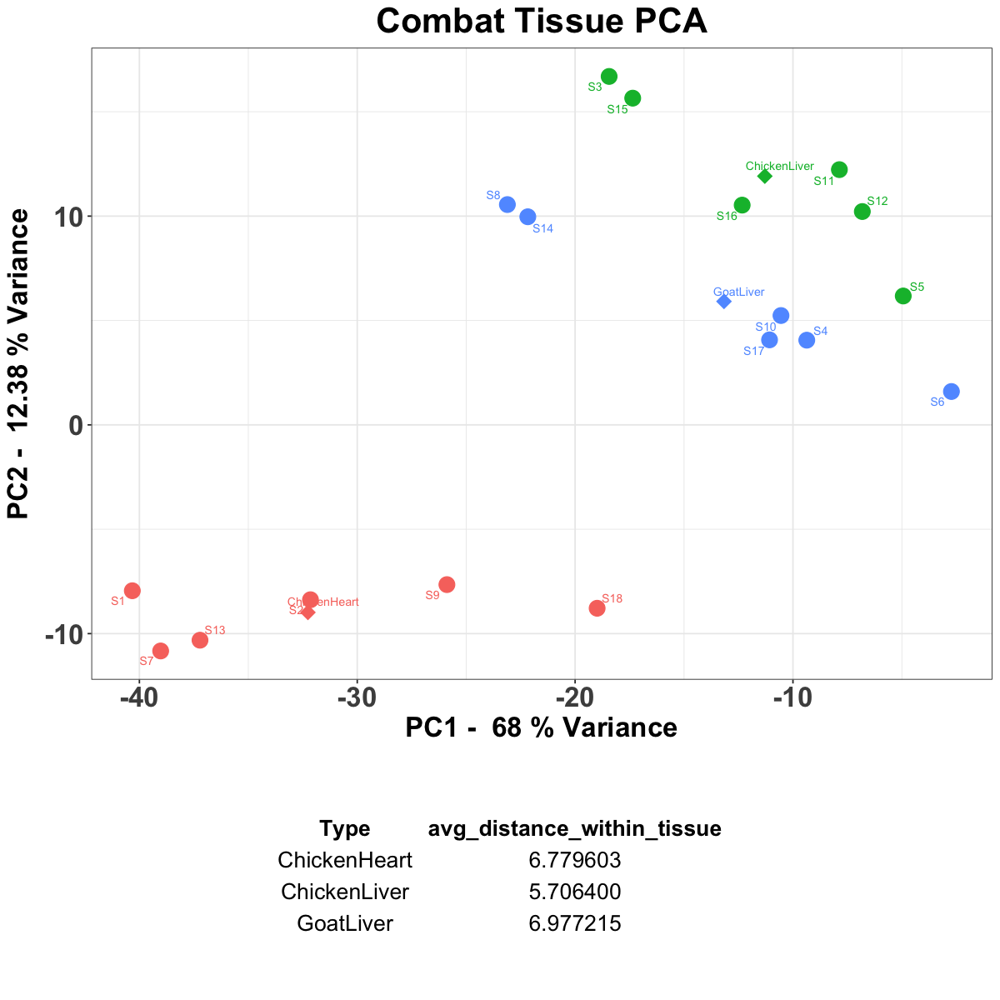

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


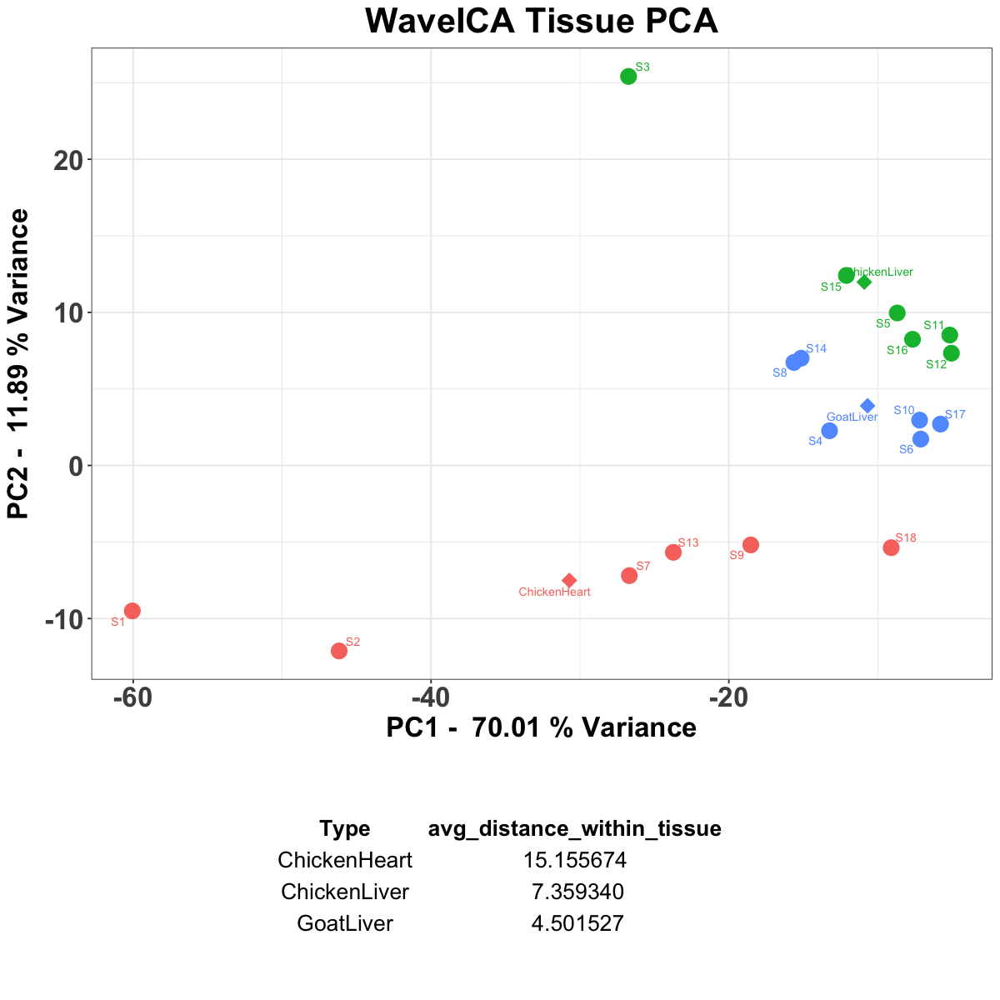

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


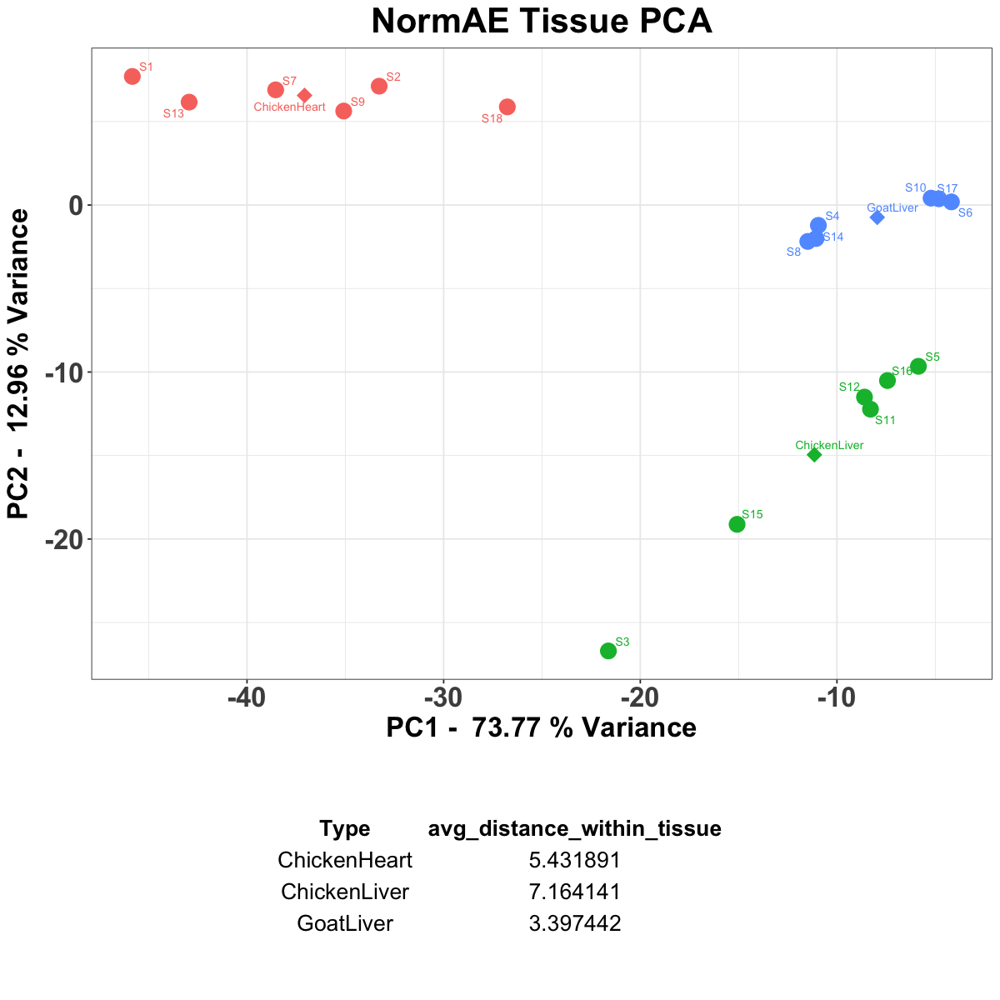

In [99]:
## Tissue PCA Plot Intragroup Combat ##
## Tissue PCA plot intragroup no norm ##
library(gridExtra)
library(dplyr)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_combat %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Calculate distances between each sample and its corresponding centroid within each tissue type
tissue_pca_data_with_centroids <- left_join(tissue_pca_data, centroids, by = "Type")
tissue_pca_data_with_centroids <- tissue_pca_data_with_centroids %>%
  mutate(distance_to_centroid = sqrt((PC1 - Centroid_PC1)^2 + (PC2 - Centroid_PC2)^2))

# Calculate average distance within each tissue type
tissue_avg_distances_combat <- tissue_pca_data_with_centroids %>%
  group_by(Type) %>%
  summarize(avg_distance_within_tissue = mean(distance_to_centroid))

# Create intragroup pca plot
tissue_intra_plot_combat <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +
  labs(title = "Combat Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_combat$sdev[1]^2 / sum(batch_pca_combat$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_combat$sdev[2]^2 / sum(batch_pca_combat$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create table plot
table_plot_combat <- tableGrob(tissue_avg_distances_combat, rows = NULL, theme = ttheme_minimal(base_size = 16))

# Arrange PCA plot and table plot
combined_plot_combat_intra <- grid.arrange(tissue_intra_plot_combat, table_plot_combat, ncol = 1, heights = c(3, 1))

# Print the combined plot
print(combined_plot_combat_intra)

##################################################################################################################################
## Tissue PCA Plot Intragroup WaveICA ##
## Tissue PCA plot intragroup no norm ##
library(gridExtra)
library(dplyr)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_wave %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Calculate distances between each sample and its corresponding centroid within each tissue type
tissue_pca_data_with_centroids <- left_join(tissue_pca_data, centroids, by = "Type")
tissue_pca_data_with_centroids <- tissue_pca_data_with_centroids %>%
  mutate(distance_to_centroid = sqrt((PC1 - Centroid_PC1)^2 + (PC2 - Centroid_PC2)^2))

# Calculate average distance within each tissue type
tissue_avg_distances_wave <- tissue_pca_data_with_centroids %>%
  group_by(Type) %>%
  summarize(avg_distance_within_tissue = mean(distance_to_centroid))

# Create intragroup pca plot
tissue_intra_plot_wave <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +
  labs(title = "WaveICA Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_wave$sdev[1]^2 / sum(batch_pca_wave$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_wave$sdev[2]^2 / sum(batch_pca_wave$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create table plot
table_plot_wave <- tableGrob(tissue_avg_distances_wave, rows = NULL, theme = ttheme_minimal(base_size = 16))

# Arrange PCA plot and table plot
combined_plot_wave_intra <- grid.arrange(tissue_intra_plot_wave, table_plot_wave, ncol = 1, heights = c(3, 1))

# Print the combined plot
print(combined_plot_wave_intra)

##################################################################################################################################
## Tissue PCA plot intragroup no norm ##
library(gridExtra)
library(dplyr)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_norm %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Calculate distances between each sample and its corresponding centroid within each tissue type
tissue_pca_data_with_centroids <- left_join(tissue_pca_data, centroids, by = "Type")
tissue_pca_data_with_centroids <- tissue_pca_data_with_centroids %>%
  mutate(distance_to_centroid = sqrt((PC1 - Centroid_PC1)^2 + (PC2 - Centroid_PC2)^2))

# Calculate average distance within each tissue type
tissue_avg_distances_norm <- tissue_pca_data_with_centroids %>%
  group_by(Type) %>%
  summarize(avg_distance_within_tissue = mean(distance_to_centroid))

# Create intragroup pca plot
tissue_intra_plot_norm <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +
  labs(title = "NormAE Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_norm$sdev[1]^2 / sum(batch_pca_norm$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_norm$sdev[2]^2 / sum(batch_pca_norm$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create table plot
table_plot_norm <- tableGrob(tissue_avg_distances_norm, rows = NULL, theme = ttheme_minimal(base_size = 16))

# Arrange PCA plot and table plot
combined_plot_norm_intra <- grid.arrange(tissue_intra_plot_norm, table_plot_norm, ncol = 1, heights = c(3, 1))

# Print the combined plot
print(combined_plot_norm_intra)

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


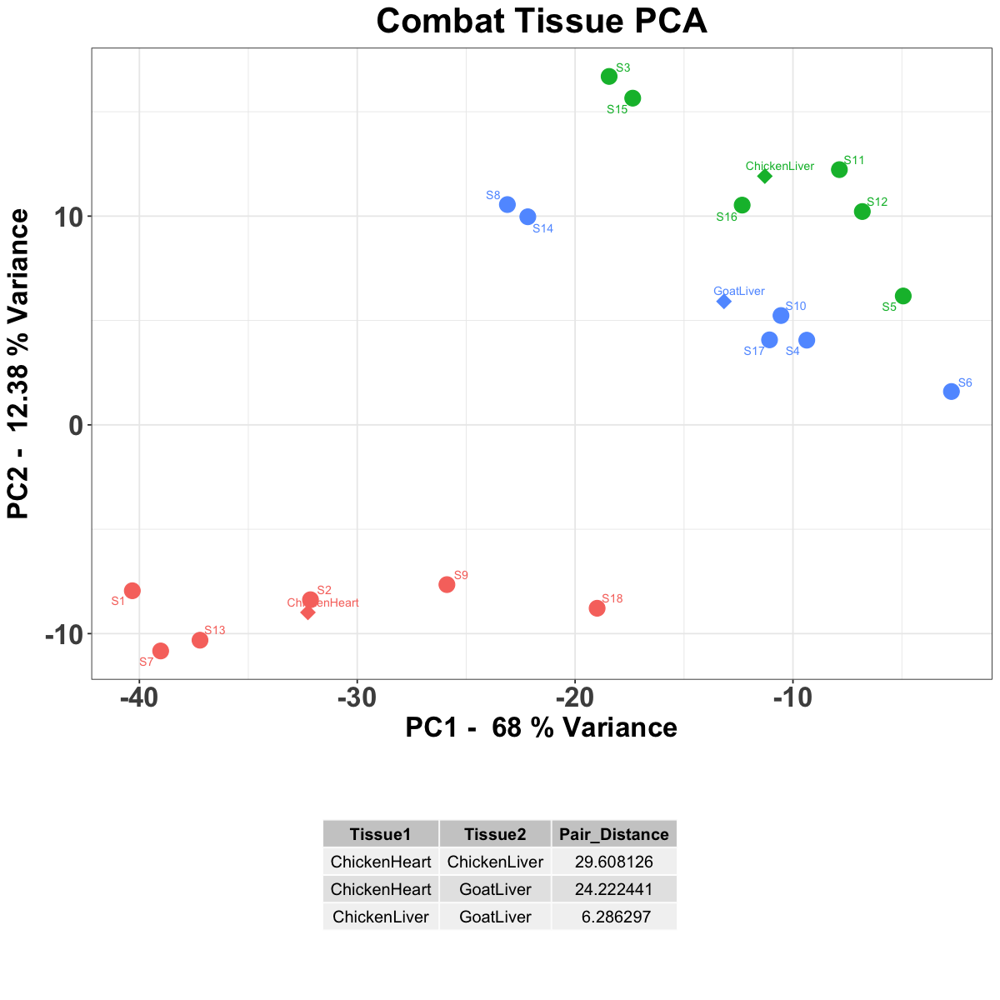

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


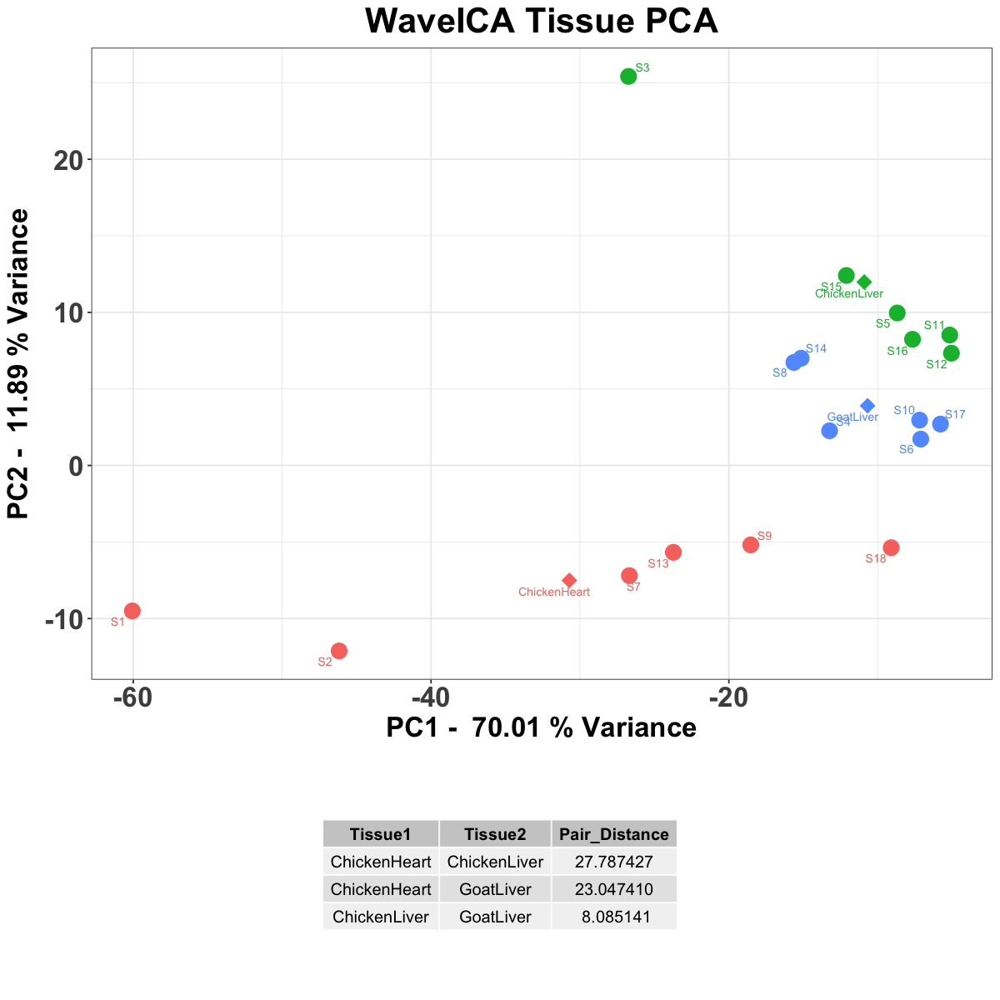

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


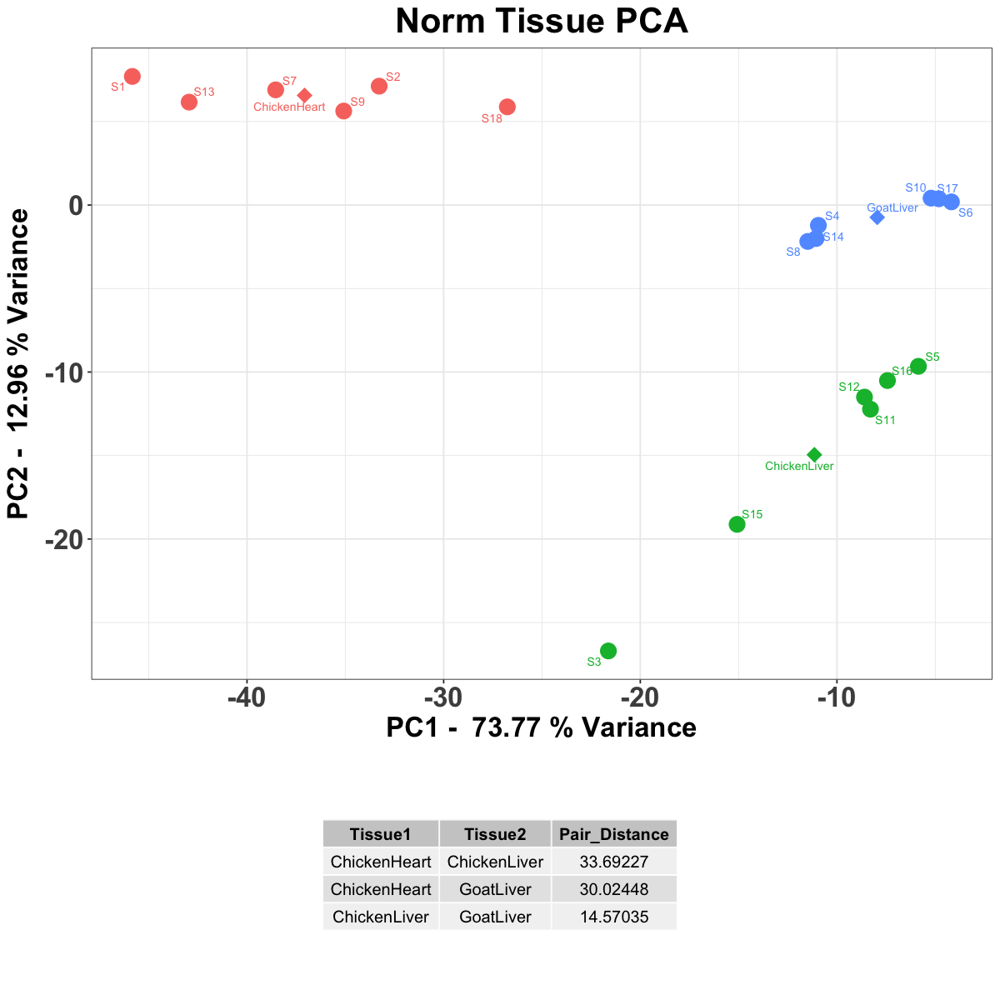

In [100]:
## Tissue PCA Plot ##
# Combat #
## Tissue with centroid PCA plot intergroup no norm ##
library(ggplot2)
library(dplyr)
library(ggrepel)
library(gridExtra)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_combat %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Plot tissue-only PCA with centroids, data point labels, and axis labels
tissue_plot <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  # Using geom_text_repel to prevent label overlap
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  # Add labels for data points without overlap
  labs(title = "Combat Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_combat$sdev[1]^2 / sum(batch_pca_combat$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_combat$sdev[2]^2 / sum(batch_pca_combat$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# calculate intergroup distance #
# Create a data frame to store pairwise distances and tissue types
# Generate all possible combinations of tissue types
tissue_combinations <- combn(unique(centroids$Type), 2, simplify = TRUE)

# Initialize an empty data frame to store pairwise distances
centroid_distances_df_combat <- data.frame(Tissue1 = character(), Tissue2 = character(), Pair_Distance = numeric())

# Iterate over each pair of tissue combinations
for (i in 1:ncol(tissue_combinations)) {
  tissue_pair <- tissue_combinations[, i]
  centroid1 <- centroids %>% filter(Type == tissue_pair[1])
  centroid2 <- centroids %>% filter(Type == tissue_pair[2])
  distance <- sqrt((centroid1$Centroid_PC1 - centroid2$Centroid_PC1)^2 + (centroid1$Centroid_PC2 - centroid2$Centroid_PC2)^2)
  centroid_distances_df_combat <- rbind(centroid_distances_df_combat, data.frame(Tissue1 = tissue_pair[1], Tissue2 = tissue_pair[2], Pair_Distance = distance))
}

# Create the tissue plot
tissue_intergroup_plot_combat <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  
  labs(title = "Combat Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_combat$sdev[1]^2 / sum(batch_pca_combat$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_combat$sdev[2]^2 / sum(batch_pca_combat$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create a table grob for centroid distances
centroid_table_combat <- tableGrob(centroid_distances_df_combat, rows = NULL)

# Arrange plots and table vertically
combined_plot_combat_inter <- grid.arrange(tissue_intergroup_plot_combat, centroid_table_combat, ncol = 1, heights = c(3, 1))
print(combined_plot_combat_inter)

########################################################################################################################
# WaveICA #
## Tissue with centroid PCA plot intergroup no norm ##
library(ggplot2)
library(dplyr)
library(ggrepel)
library(gridExtra)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_wave %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Plot tissue-only PCA with centroids, data point labels, and axis labels
tissue_plot <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  # Using geom_text_repel to prevent label overlap
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  # Add labels for data points without overlap
  labs(title = "WaveICA Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_wave$sdev[1]^2 / sum(batch_pca_wave$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_wave$sdev[2]^2 / sum(batch_pca_wave$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# calculate intergroup distance #
# Create a data frame to store pairwise distances and tissue types
# Generate all possible combinations of tissue types
tissue_combinations <- combn(unique(centroids$Type), 2, simplify = TRUE)

# Initialize an empty data frame to store pairwise distances
centroid_distances_df_wave <- data.frame(Tissue1 = character(), Tissue2 = character(), Pair_Distance = numeric())

# Iterate over each pair of tissue combinations
for (i in 1:ncol(tissue_combinations)) {
  tissue_pair <- tissue_combinations[, i]
  centroid1 <- centroids %>% filter(Type == tissue_pair[1])
  centroid2 <- centroids %>% filter(Type == tissue_pair[2])
  distance <- sqrt((centroid1$Centroid_PC1 - centroid2$Centroid_PC1)^2 + (centroid1$Centroid_PC2 - centroid2$Centroid_PC2)^2)
  centroid_distances_df_wave <- rbind(centroid_distances_df_wave, data.frame(Tissue1 = tissue_pair[1], Tissue2 = tissue_pair[2], Pair_Distance = distance))
}

# Create the tissue plot
tissue_intergroup_plot_wave <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  
  labs(title = "WaveICA Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_wave$sdev[1]^2 / sum(batch_pca_wave$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_wave$sdev[2]^2 / sum(batch_pca_wave$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create a table grob for centroid distances
centroid_table_wave <- tableGrob(centroid_distances_df_wave, rows = NULL)

# Arrange plots and table vertically
combined_plot_wave_inter <- grid.arrange(tissue_intergroup_plot_wave, centroid_table_wave, ncol = 1, heights = c(3, 1))
print(combined_plot_wave_inter)

########################################################################################################################
# NormAE #
## Tissue with centroid PCA plot intergroup no norm ##
library(ggplot2)
library(dplyr)
library(ggrepel)
library(gridExtra)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_norm %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Plot tissue-only PCA with centroids, data point labels, and axis labels
tissue_plot <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  # Using geom_text_repel to prevent label overlap
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  # Add labels for data points without overlap
  labs(title = "Norm Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_norm$sdev[1]^2 / sum(batch_pca_norm$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_norm$sdev[2]^2 / sum(batch_pca_norm$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# calculate intergroup distance #
# Create a data frame to store pairwise distances and tissue types
# Generate all possible combinations of tissue types
tissue_combinations <- combn(unique(centroids$Type), 2, simplify = TRUE)

# Initialize an empty data frame to store pairwise distances
centroid_distances_df_norm <- data.frame(Tissue1 = character(), Tissue2 = character(), Pair_Distance = numeric())

# Iterate over each pair of tissue combinations
for (i in 1:ncol(tissue_combinations)) {
  tissue_pair <- tissue_combinations[, i]
  centroid1 <- centroids %>% filter(Type == tissue_pair[1])
  centroid2 <- centroids %>% filter(Type == tissue_pair[2])
  distance <- sqrt((centroid1$Centroid_PC1 - centroid2$Centroid_PC1)^2 + (centroid1$Centroid_PC2 - centroid2$Centroid_PC2)^2)
  centroid_distances_df_norm <- rbind(centroid_distances_df_norm, data.frame(Tissue1 = tissue_pair[1], Tissue2 = tissue_pair[2], Pair_Distance = distance))
}

# Create the tissue plot
tissue_intergroup_plot_norm <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  
  labs(title = "Norm Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_norm$sdev[1]^2 / sum(batch_pca_norm$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_norm$sdev[2]^2 / sum(batch_pca_norm$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create a table grob for centroid distances
centroid_table_norm <- tableGrob(centroid_distances_df_norm, rows = NULL)

# Arrange plots and table vertically
combined_plot_norm_inter <- grid.arrange(tissue_intergroup_plot_norm, centroid_table_norm, ncol = 1, heights = c(3, 1))
print(combined_plot_norm_inter)

## Conclusion: Overview Comparision ##
1. RSD Table (QCS, Tissue)
2. Violin Plot
3. Intensity Plot
4. Average Distance
5. PCA Plot

In [101]:
## QCS RSD ##

## RSD Overview Table ##
# Create overview RSD table for Propranolol
overview_table_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  No_norm_RSD = rsd_propranolol[2],  
  TIC_norm_RSD = rsd_propranolol_TIC[2],
  IS_norm_RSD = rsd_ratio[2],
  Combat_RSD = rsd_propranolol_combat[2],
  WaveICA_RSD = rsd_propranolol_wave[2],
  NormAE_RSD = rsd_propranolol_norm[2]
)

# Set the column names
colnames(overview_table_pro) <- c(paste("m/z value:", propranolol_mz_value),"No Norm","TIC Norm","IS Norm", "Combat", "WaveICA", "NormAE")
library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying overview RSD table
display_rsd_table_pro <- kable(overview_table_pro, format = "html", row.names = FALSE) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_pro <- paste("<h2 style='text-align: center;'>Overview RSD Table Propranolol</h2>", 
                               as.character(display_rsd_table_pro))

# Save HTML table to a file
display_html(display_rsd_table_pro)

# Create overview RSD table for d7-Propranolol
overview_table_d7_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  No_norm_RSD = rsd_d7_propranolol[2],
  TIC_norm_RSD = rsd_d7_propranolol[2],
  IS_norm_RSD = rsd_ratio[2],
  Combat_RSD = rsd_d7_propranolol_combat[2],
  WaveICA_RSD = rsd_d7_propranolol_wave[2],
  NormAE_RSD = rsd_d7_propranolol_norm[2]
)

# Set the column names
colnames(overview_table_d7_pro) <- c(paste("m/z value:", d7_propranolol_mz_value),"No Norm","TIC Norm","IS Norm","Combat", "WaveICA", "NormAE")

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying overview RSD table
display_rsd_table_d7_pro <- kable(overview_table_d7_pro, format = "html", row.names = FALSE) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_d7_pro <- paste("<h2 style='text-align: center;'>Overview RSD Table D7-Propranolol</h2>", 
                               as.character(display_rsd_table_d7_pro))

# Save HTML table to a file
display_html(display_rsd_table_d7_pro)

m/z value: 260.186,No Norm,TIC Norm,IS Norm,Combat,WaveICA,NormAE
Intraday 1,70.5%,63.51%,10.47%,57.82%,42.24%,22.55%
Intraday 2,41.41%,38.88%,13.6%,48.44%,33.07%,22.04%
Intraday 3,34.07%,36.26%,17.12%,38.62%,35.51%,19.79%
Interday,52.05%,50.68%,14.11%,48.24%,36.97%,21.36%


m/z value: 267.187,No Norm,TIC Norm,IS Norm,Combat,WaveICA,NormAE
Intraday 1,73.81%,73.81%,10.47%,59.23%,39.16%,25.86%
Intraday 2,39.71%,39.71%,13.6%,47.31%,30.04%,25.66%
Intraday 3,35.57%,35.57%,17.12%,39.03%,32.49%,23.58%
Interday,53.15%,53.15%,14.11%,48.62%,33.92%,24.93%


In [102]:
## Tissue RSD ##
## Overview RSD Table ##

# Initialize an empty list to store combined HTML tables for each tissue
combined_html_list <- list()

# Iterate over each tissue type
for (tissue_name in names(rsd_results_combined)) {
  # Extract RSD tables for the current tissue type
  rsd_table <- generate_rsd_table(rsd_results_combined, tissue_name)
  rsd_table_TIC <- generate_rsd_table(rsd_results_combined_TIC, tissue_name)  
  rsd_table_combat <- generate_rsd_table(rsd_results_combined_combat, tissue_name)
  rsd_table_wave <- generate_rsd_table(rsd_results_combined_wave, tissue_name)
  rsd_table_norm <- generate_rsd_table(rsd_results_combined_norm, tissue_name)

  # Combine HTML tables for the current tissue type horizontally
  combined_rsd_table <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>",
                              "<div style='text-align: center;'>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>No Norm Raw Data</h3>", rsd_table, "</div>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>TIC Norm</h3>", rsd_table_TIC, "</div>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>Combat</h3>", rsd_table_combat, "</div>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>WaveICA</h3>", rsd_table_wave, "</div>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>NormAE</h3>", rsd_table_norm, "</div>",
                              "</div>")
  
  # Add the combined HTML table to the list
  combined_html_list[[tissue_name]] <- combined_rsd_table
}

# Combine HTML tables into a single HTML table with four columns
combined_html <- paste("<table style='width:100%; border-collapse: collapse;'>", 
                       "<tr>", paste("<td style='vertical-align: top;'>", 
                                     unlist(combined_html_list), 
                                     "</td>", sep = ""), "</tr></table>")

# Wrap the combined HTML content in a div with text-align: center
centered_combined_html <- paste("<div style='text-align: center;'>", combined_html, "</div>")

# Display the centered HTML content in JupyterLab
display_html(centered_combined_html)

Batch,RSD
Intraday 1,23.72 ± 8.48%
Intraday 2,25.12 ± 7.45%
Intraday 3,23.86 ± 9.95%
Interday,23.03 ± 5.61%
Batch,RSD
Intraday 1,8.68 ± 6.63%
Intraday 2,9.15 ± 5.28%
Intraday 3,10.27 ± 8.49%
Interday,13.41 ± 5.13%
Batch,RSD


TableGrob (3 x 2) "arrange": 6 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]
3 3 (2-2,1-1) arrange gtable[layout]
4 4 (2-2,2-2) arrange gtable[layout]
5 5 (3-3,1-1) arrange gtable[layout]
6 6 (3-3,2-2) arrange gtable[layout]


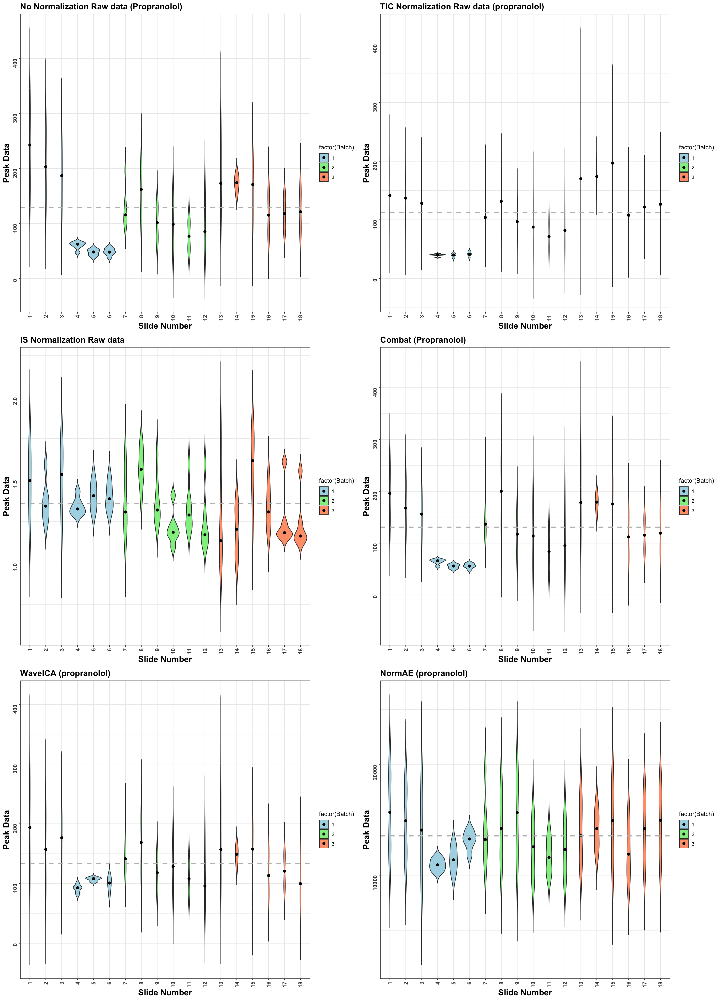

In [103]:
## Violin Plot ##
options(repr.plot.width = 18, repr.plot.height = 25)
combined_plots_violin <- grid.arrange(violin_plot, violin_plot_TIC, violin_plot_IS, violin_plot_combat, violin_plot_wave, violin_plot_norm, nrow = 3)
print(combined_plots_violin)

[1] "black dotted line represent standard deviation while red dotted line represent mean of intensity"
TableGrob (3 x 2) "arrange": 6 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]
3 3 (2-2,1-1) arrange gtable[layout]
4 4 (2-2,2-2) arrange gtable[layout]
5 5 (3-3,1-1) arrange gtable[layout]
6 6 (3-3,2-2) arrange gtable[layout]


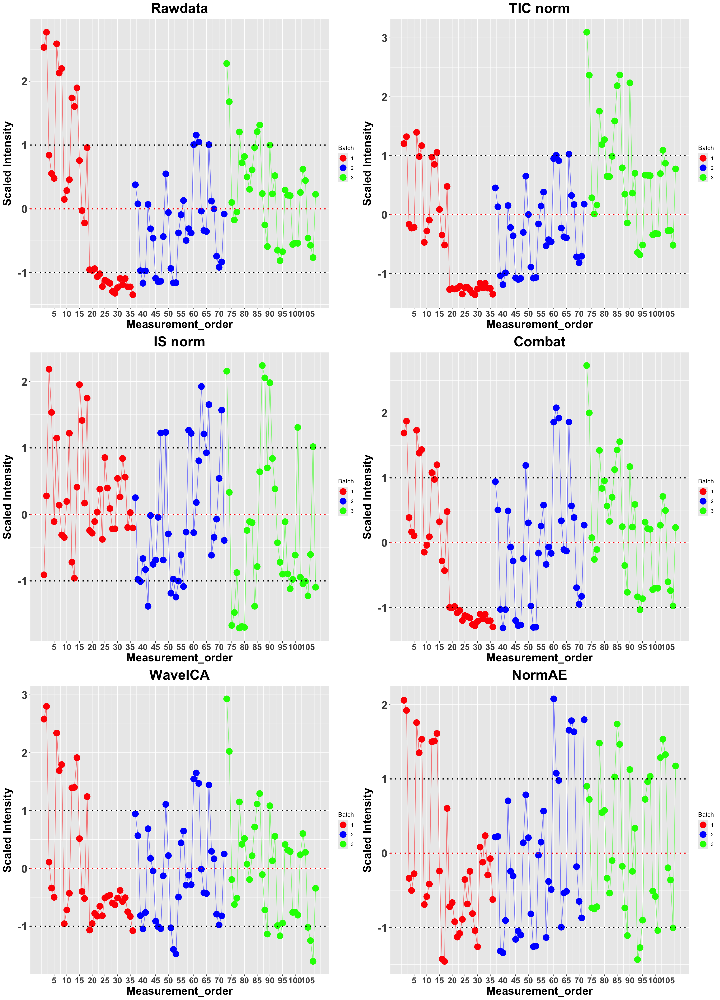

In [104]:
## Intensity Plot ##
library(gridExtra)
options(repr.plot.width = 18, repr.plot.height = 25)
print("black dotted line represent standard deviation while red dotted line represent mean of intensity")
combined_plots_intensity <- grid.arrange(intensity_plot, intensity_plot_TIC, intensity_plot_IS, intensity_plot_combat, intensity_plot_wave,
                                      intensity_plot_norm, nrow = 3)
print(combined_plots_intensity)

TableGrob (3 x 2) "arrange": 5 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]
3 3 (2-2,1-1) arrange gtable[layout]
4 4 (2-2,2-2) arrange gtable[layout]
5 5 (3-3,1-1) arrange gtable[layout]


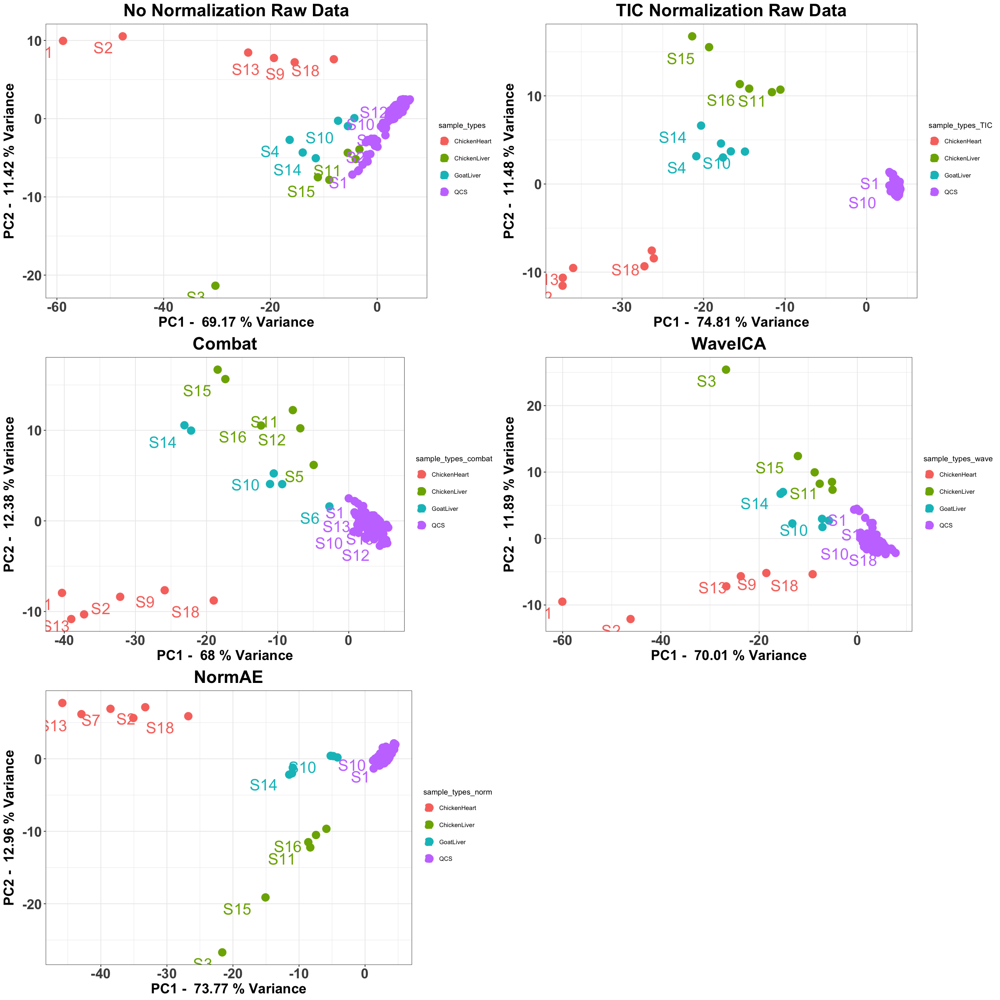

In [105]:
## PCA PLOT ##
library(gridExtra)
options(repr.plot.width = 20, repr.plot.height = 20)
combined_plots <- grid.arrange(plot, plot_TIC, plot_combat, plot_wave, plot_norm, nrow = 3)
print(combined_plots)

TableGrob (3 x 2) "arrange": 5 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]
3 3 (2-2,1-1) arrange gtable[layout]
4 4 (2-2,2-2) arrange gtable[layout]
5 5 (3-3,1-1) arrange gtable[layout]


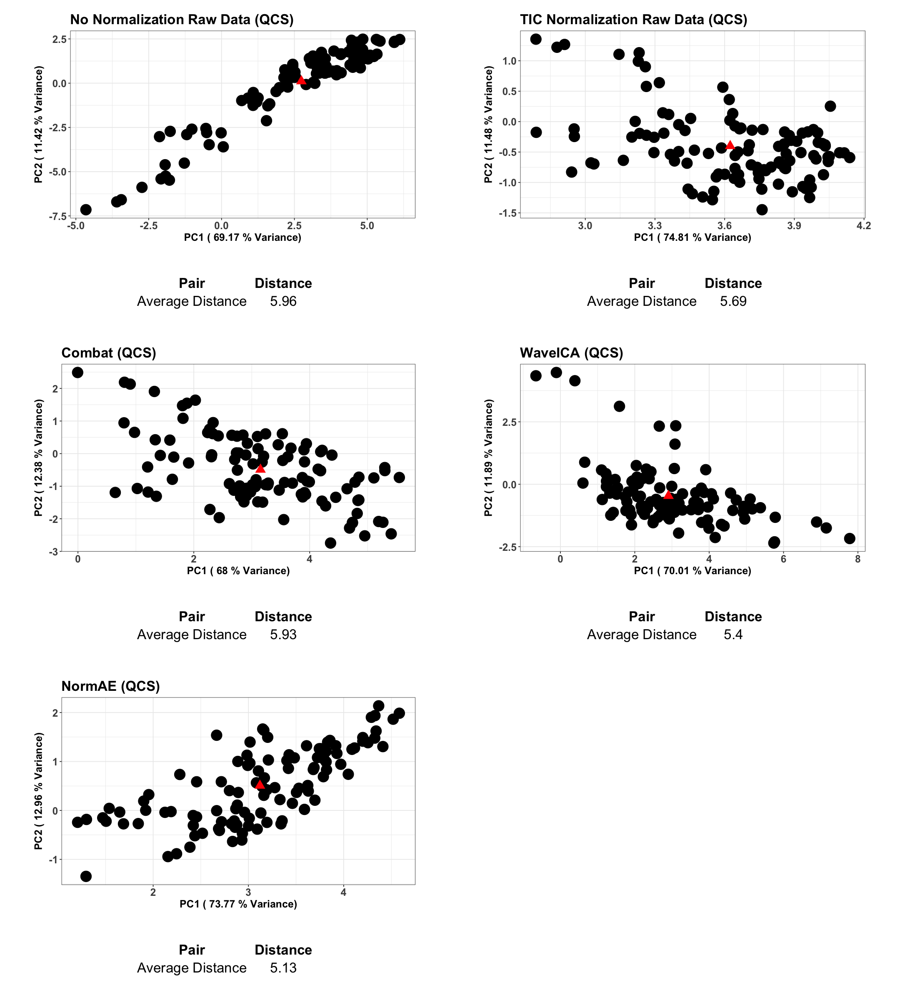

In [106]:
## QCS PCA PLOT ##
library(gridExtra)
options(repr.plot.width = 18, repr.plot.height = 20)
combined_plots <- grid.arrange(combined_plot_qcs, combined_plot_TIC_qcs, combined_plot_combat_qcs, combined_plot_wave_qcs, combined_plot_norm_qcs, nrow = 3)
print(combined_plots)

Warning message:
“ggrepel: 10 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 10 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


TableGrob (3 x 2) "arrange": 5 grobs
  z     cells    name            grob
1 1 (1-1,1-1) arrange gtable[arrange]
2 2 (1-1,2-2) arrange gtable[arrange]
3 3 (2-2,1-1) arrange gtable[arrange]
4 4 (2-2,2-2) arrange gtable[arrange]
5 5 (3-3,1-1) arrange gtable[arrange]


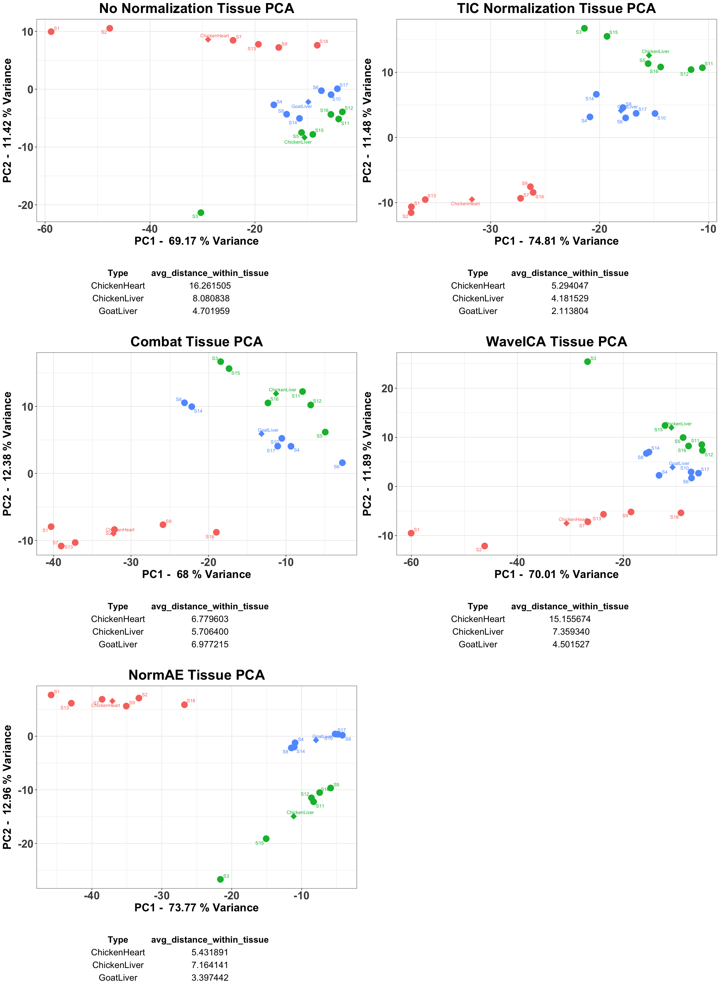

In [107]:
## TISSUE Intraday PLOT ##
options(repr.plot.width = 18, repr.plot.height = 25)
combined_plots_intraday <- grid.arrange(combined_plot_intra,combined_plot_TIC_intra, combined_plot_combat_intra, combined_plot_wave_intra, combined_plot_norm_intra, nrow = 3)
print(combined_plots_intraday)

Warning message:
“ggrepel: 10 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 10 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


TableGrob (3 x 2) "arrange": 5 grobs
  z     cells    name            grob
1 1 (1-1,1-1) arrange gtable[arrange]
2 2 (1-1,2-2) arrange gtable[arrange]
3 3 (2-2,1-1) arrange gtable[arrange]
4 4 (2-2,2-2) arrange gtable[arrange]
5 5 (3-3,1-1) arrange gtable[arrange]


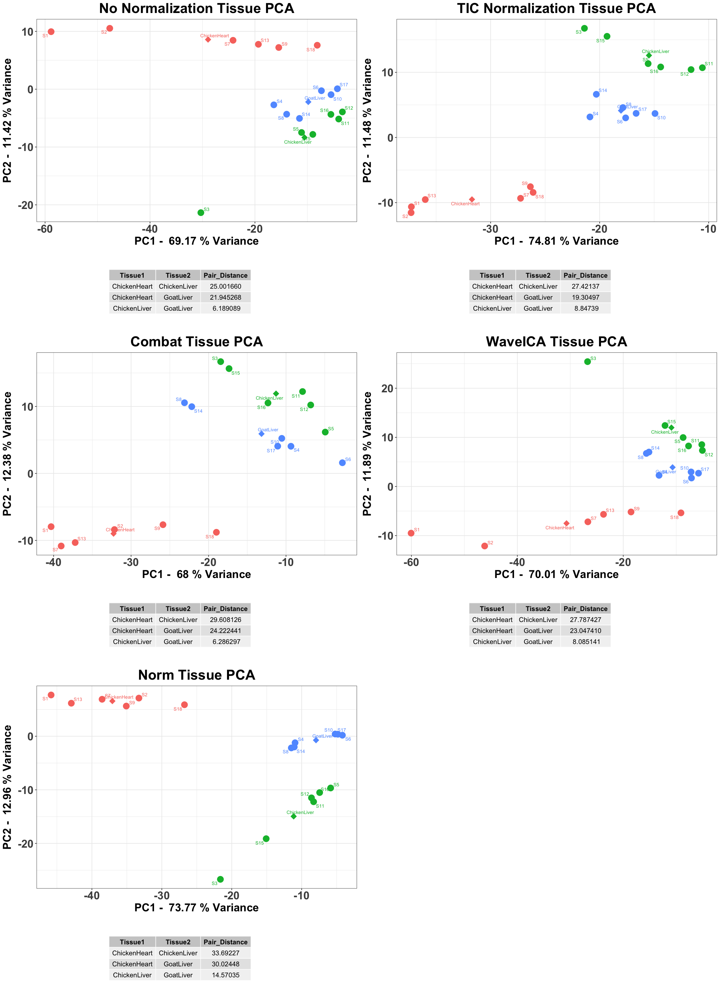

In [108]:
## TISSUE Intraday PLOT ##
options(repr.plot.width = 18, repr.plot.height = 25)
combined_plots_interday <- grid.arrange(combined_plot_inter, combined_plot_TIC_inter, combined_plot_combat_inter,
                                        combined_plot_wave_inter, combined_plot_norm_inter, nrow = 3)
print(combined_plots_interday)

In [109]:
## Overview Average Distance Table ##

# Create separate rows for each tissue value
merged_data <- data.frame(
  Average_distances = c("QCS(centroid)", "QCS(euclidean)", "Tissue(intragroup)", "Tissue(intergroup)"),
  No_norm = c(average_qcs_distance, average_distance_ec, paste(tissue_avg_distances$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df$Pair_Distance, collapse = ", ")),
  TIC_norm = c(average_qcs_distance_TIC, average_distance_ec_TIC, paste(tissue_avg_distances_TIC$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_TIC$Pair_Distance, collapse = ", ")),
  Combat_norm = c(average_qcs_distance_combat, average_distance_ec_combat, paste(tissue_avg_distances_combat$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_combat$Pair_Distance, collapse = ", ")),
  WaveICA_norm = c(average_qcs_distance_wave, average_distance_ec_wave, paste(tissue_avg_distances_wave$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_wave$Pair_Distance, collapse = ", ")),
  NormAE_norm = c(average_qcs_distance_norm, average_distance_ec_norm, paste(tissue_avg_distances_norm$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_norm$Pair_Distance, collapse = ", "))
)

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying overview RSD table
display_rsd_table_pro <- kable(merged_data, format = "html", row.names = FALSE) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_pro <- paste("<h2 style='text-align: center;'>Average Distance</h2>", 
                               as.character(display_rsd_table_pro))

# Save HTML table to a file
display_html(display_rsd_table_pro)

Average_distances,No_norm,TIC_norm,Combat_norm,WaveICA_norm,NormAE_norm
QCS(centroid),5.95512601964299,5.69279890033456,5.93351507515199,5.40450116756693,5.13498209726165
QCS(euclidean),5.72814537565927,3.32551299586035,5.24827452059474,4.75365221023581,3.29666974190151
Tissue(intragroup),"16.2615051837195, 8.08083755964266, 4.70195922746115","5.29404702556746, 4.18152905919939, 2.11380435626099","6.77960346314757, 5.70639965680669, 6.97721515978037","15.1556737984592, 7.3593404299247, 4.50152734731132","5.43189112705596, 7.16414097699874, 3.39744177501494"
Tissue(intergroup),"25.0016599355236, 21.9452681570071, 6.18908931038246","27.4213730250543, 19.304969998136, 8.84738987154798","29.6081260187539, 24.2224406706592, 6.28629668477942","27.7874274128242, 23.0474102519077, 8.08514107701859","33.6922708791818, 30.0244769850658, 14.5703458604153"


In [110]:
## Best Correction Package ##
# ranking based on qcs interday rsd_value
overview_table_d7_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  No_norm_RSD = rsd_d7_propranolol[2],  
  TIC_norm_RSD = rsd_d7_propranolol_TIC[2],
  IS_norm_RSD = rsd_ratio[2],   
  Combat_RSD = rsd_d7_propranolol_combat[2],
  WaveICA_RSD = rsd_d7_propranolol_wave[2],
  NormAE_RSD = rsd_d7_propranolol_norm[2]
)
# Set the column names
colnames(overview_table_d7_pro) <- c(paste("m/z value:", d7_propranolol_mz_value),"No Norm","TIC Norm","IS Norm","Combat", "WaveICA", "NormAE")

# Convert percentage strings to numeric values
overview_table_d7_pro[4, -1] <- as.numeric(gsub("%", "", overview_table_d7_pro[4, -1]))
rsd_values <- overview_table_d7_pro[4, -1] 
rsd_values <- as.numeric(rsd_values)
sorted_columns <- names(overview_table_d7_pro)[-1][order(rsd_values)]
cat("Ranking correction based on QCS interday RSD value from smallest to largest: ")
print(sorted_columns)

# ranking based on QCS average distance
merged_data <- data.frame(
  Average_distances = c("QCS(centroid)", "QCS(euclidean)", "Tissue(intragroup)", "Tissue(intergroup)"),
  No_norm = c(average_qcs_distance, average_distance_ec, paste(tissue_avg_distances$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df$Pair_Distance, collapse = ", ")),
  TIC_norm = c(average_qcs_distance_TIC, average_distance_ec_TIC, paste(tissue_avg_distances_TIC$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_TIC$Pair_Distance, collapse = ", ")),
  Combat_norm = c(average_qcs_distance_combat, average_distance_ec_combat, paste(tissue_avg_distances_combat$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_combat$Pair_Distance, collapse = ", ")),
  WaveICA_norm = c(average_qcs_distance_wave, average_distance_ec_wave, paste(tissue_avg_distances_wave$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_wave$Pair_Distance, collapse = ", ")),
  NormAE_norm = c(average_qcs_distance_norm, average_distance_ec_norm, paste(tissue_avg_distances_norm$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_norm$Pair_Distance, collapse = ", "))
)
centroid_row <- merged_data[1, -1]  # Extract the "centroid" row
euclidean_row <- merged_data[2, -1]  # Extract the "euclidean" row
centroid_row_numeric <- as.data.frame(lapply(centroid_row, as.numeric))
euclidean_row_numeric <- as.data.frame(lapply(euclidean_row, as.numeric))
average_row <- colMeans(rbind(centroid_row_numeric, euclidean_row_numeric))
#print(average_row) # uncomment to see values
sorted_columns_qcs <- names(merged_data)[-1][order(average_row)]
cat("Ranking correction based on QCS average distance (avg of centroid and euclidean) from smallest to largest: ")
print(sorted_columns_qcs)

# ranking based on Tissue average distance
intra_row <- merged_data[3, -1]  # Extract the intragroup row
inter_row <- merged_data[4, -1]  # Extract the intergroup row

avg_values <- function(string) {
  values <- as.numeric(unlist(strsplit(string, ", ")))
  mean(values)
}
intra_averages <- sapply(intra_row, avg_values)
#print(intra_averages) # uncomment to see values
cat("Ranking correction based on Tissue average intragroup distance from smallest to largest: ")
sort_columns_intra <- names(merged_data)[-1][order(intra_averages)]
print(sort_columns_intra)

inter_averages <- sapply(inter_row, avg_values)
#print(inter_averages) # uncomment to see values
cat("Ranking correction based on Tissue average intergroup distance from largest to smallest: ")
sort_columns_inter <- names(merged_data)[-1][order(-inter_averages)]
print(sort_columns_inter)

# ranking based on tissue rsd
extract_interday_rsd <- function(rsd_results_combined, sample_set) {
  # Define a function to extract numeric values from strings with the specified pattern
  extract_numeric <- function(x) {
    as.numeric(gsub("[^0-9.]+", "", strsplit(x, "±")[[1]][1]))
  }
  
  # Define a function to extract the interday RSD value for a single tissue
  extract_interday_rsd_single <- function(rsd_results, tissue_name) {
    rsd_df <- rsd_results[[tissue_name]]
    interday_rsd <- rsd_df[4, "RSD"]
    return(interday_rsd)
  }
  
  # Initialize a list to store interday RSD values for each tissue
  interday_rsd_values <- list()
  
  # Set indices for interday RSD beforehand
  interday_indices <- c("No Norm","TIC Norm","Combat", "WaveICA", "NormAE")
  
  # Iterate over each tissue type in the sample_set
  for (tissue_name in sample_set) {
    # Initialize a list to store interday RSD values for the current tissue across different rsd_results_combined
    interday_rsd <- list()
    
    # Iterate over each rsd_results_combined
    for (rsd_results in rsd_results_combined) {
      # Extract interday RSD values for the current tissue type from each rsd_results_combined
      interday_rsd[[length(interday_rsd) + 1]] <- extract_interday_rsd_single(rsd_results, tissue_name)
    }
    
    # Add interday RSD values for the current tissue to the main list
    names(interday_rsd) <- interday_indices  # Set names based on predefined indices
    interday_rsd_values[[tissue_name]] <- interday_rsd
  }
  
  # Define a function to sort interday RSD values for each tissue type
  sort_interday_rsd <- function(interday_rsd_values) {
    sorted_names_list <- list()
    for (tissue_name in sample_set) {
      interday_rsd <- interday_rsd_values[[tissue_name]]
      sorted_names <- lapply(interday_rsd, function(x) {
        extract_numeric(x)
      })
      sorted_indices <- names(interday_rsd)[order(unlist(sorted_names))]
      sorted_indices <- factor(sorted_indices, levels = interday_indices)
      sorted_names_list[[tissue_name]] <- sorted_indices
    }
    return(sorted_names_list)
  }
  
  # Call the sorting function
  sorted_names <- sort_interday_rsd(interday_rsd_values)
  
  # Print sorted names for each tissue type
  for (tissue_name in sample_set) {
    cat("Sorted names for", tissue_name, ":", paste(sorted_names[[tissue_name]], collapse = " "), "\n")
  }
}
cat("Ranking correction based on Tissue RSD table from smallest to largest: \n")

extract_interday_rsd(list(rsd_results_combined,rsd_results_combined_TIC, rsd_results_combined_combat, rsd_results_combined_wave,
                                                       rsd_results_combined_norm), sample_set)

Ranking correction based on QCS interday RSD value from smallest to largest: [1] "IS Norm"  "NormAE"   "WaveICA"  "Combat"   "TIC Norm" "No Norm" 
Ranking correction based on QCS average distance (avg of centroid and euclidean) from smallest to largest: [1] "NormAE_norm"  "TIC_norm"     "WaveICA_norm" "Combat_norm"  "No_norm"     
Ranking correction based on Tissue average intragroup distance from smallest to largest: [1] "TIC_norm"     "NormAE_norm"  "Combat_norm"  "WaveICA_norm" "No_norm"     
Ranking correction based on Tissue average intergroup distance from largest to smallest: [1] "NormAE_norm"  "Combat_norm"  "WaveICA_norm" "TIC_norm"     "No_norm"     
Ranking correction based on Tissue RSD table from smallest to largest: 
Sorted names for ChickenHeart : NormAE TIC Norm Combat WaveICA No Norm 
Sorted names for ChickenLiver : TIC Norm NormAE Combat WaveICA No Norm 
Sorted names for GoatLiver : TIC Norm NormAE WaveICA No Norm Combat 


## Outputs ##
1. 5 Datasets as csv file (no norm, TIC norm, combat, waveICA, normAE) --> check dataset file
2. Excel sheets (no norm, TIC norm, combat, waveICA, normAE)

In [111]:
## Excel Sheet ##
library(openxlsx)

create_batch_dataset_excel <- function(data, num_batches, propranolol_mz_value, file_name) {
  library(openxlsx)
  
  # Create a new Excel workbook
  wb <- createWorkbook()
  
  # Add sheets for Dataset, Intraday, and Interday
  sheet_names <- c("Dataset", paste0("Intraday ", 1:num_batches), "Interday")
  for (sheet_name in sheet_names) {
    addWorksheet(wb, sheet_name)
  }
  
  # Function to extract dataset for a specific batch
  extract_batch_dataset <- function(data, batch_number) {
    subset(data, batch == batch_number)
  }
  
  # Loop through each batch and write data to corresponding sheets
  for (i in 1:num_batches) {
    batch_dataset <- extract_batch_dataset(data, i)
    colnames(batch_dataset) <- sub("^X", "", colnames(batch_dataset))
    numeric_batch_dataset <- as.numeric(batch_dataset[,colnames(batch_dataset) == propranolol_mz_value, drop = TRUE])
    
    intraday_rsd <- calculate_rsd(numeric_batch_dataset)
    batch_dataset$intraday_rsd <- intraday_rsd
    batch_dataset <- as.data.frame(batch_dataset)
    
    # Write data to Intraday sheet
    writeData(wb, sheet = paste0("Intraday ", i), x = batch_dataset, rowNames = TRUE, colNames = TRUE)
  }
  
  # Calculate Interday RSD for all data
  numeric_interday_dataset <- as.numeric(data[,colnames(data) == propranolol_mz_value, drop = TRUE])
  interday_rsd <- calculate_rsd(numeric_interday_dataset)
  data$interday_rsd <- interday_rsd
  
  # Write data to Dataset and Interday sheets
  writeData(wb, sheet = "Dataset", x = data, rowNames = TRUE, colNames = TRUE)
  writeData(wb, sheet = "Interday", x = data, rowNames = TRUE, colNames = TRUE)
  
  # Save the workbook to a file
  file_path <- paste0("dataset/", file_name, ".xlsx")
  saveWorkbook(wb, file_path)
  
  return(file_path)
}
cat("Please change the number of batch and check the given dataset")

# Example usage:
if (exists("propranolol_data") && length(propranolol_data) > 0) {
    create_batch_dataset_excel(propranolol_data, 3, propranolol_mz_value, "propranolol_batch_dataset")
}
if (exists("propranolol_data_TIC") && length(propranolol_data_TIC) > 0) {
    create_batch_dataset_excel(propranolol_data_TIC, 3, propranolol_mz_value, "propranolol_batch_dataset_TIC")
}
if (exists("ratio_data") && length(ratio_data) > 0) {
    create_batch_dataset_excel(ratio_data, 3, propranolol_mz_value, "propranolol_batch_dataset_IS")
}
if (exists("propranolol_data_combat") && length(propranolol_data_combat) > 0) {
    create_batch_dataset_excel(propranolol_data_combat, 3, propranolol_mz_value, "propranolol_batch_dataset_combat")
}
if (exists("propranolol_data_wave") && length(propranolol_data_wave) > 0) {
    create_batch_dataset_excel(propranolol_data_wave, 3, propranolol_mz_value, "propranolol_batch_dataset_wave")
}
if (exists("propranolol_data_norm") && length(propranolol_data_norm) > 0) {
    create_batch_dataset_excel(propranolol_data_norm, 3, propranolol_mz_value, "propranolol_batch_dataset_normae")
}

Please change the number of batch and check the given dataset

[1] "dataset/propranolol_batch_dataset.xlsx"

[1] "dataset/propranolol_batch_dataset_TIC.xlsx"

[1] "dataset/propranolol_batch_dataset_IS.xlsx"

[1] "dataset/propranolol_batch_dataset_combat.xlsx"

[1] "dataset/propranolol_batch_dataset_wave.xlsx"

[1] "dataset/propranolol_batch_dataset_normae.xlsx"

## Pipeline #3 Real Sample Application ##
1. QCS RSD
2. QCS PCA Plot
3. Sample Features RSD
4. Sample Features PCA Plot
5. Correction
6. Comparision

## Input ##
1) Data_matrix_no_normalization
2) Data_matrix_TIC_normalization
3) QCS Analytes m/z values (ie: propranolol 260.16, D7-propranolol 267.14)
4) Batch_info (sample construction)
5) Sample_set (tissue sample construction)

In [114]:
### Please edit the file path, file name ###
no_normalization_data <- read.csv("input_app/120feature_T&QCS_noNorm.csv",
                                  header = FALSE,
                                  check.name = FALSE,
                                  stringsAsFactors = FALSE)

TIC_normalization_data <- read.csv("input_app/120feature_T&QCS_TICNorm.csv",
                                   header = FALSE,
                                   check.name = FALSE,
                                   stringsAsFactors = FALSE) 

propranolol_mz_value <- as.numeric(readline("Enter Propranolol m/z value: ")) ## ie: 260.14

d7_propranolol_mz_value <- as.numeric(readline("Enter D7-propranolol m/z value: ")) ## ie: 267.187

batch_info <- read.csv("input_app/app_batch_info_TIC.csv",
                       header = TRUE,
                       check.name = FALSE,
                       stringsAsFactors = FALSE) 

sample_set <- c("ChickenHeart", "ChickenLiver", "GoatLiver")

Enter Propranolol m/z value:  260.14
Enter D7-propranolol m/z value:  267.187


In [116]:
# Check if "injection.order" column exists
if ("injection.order" %in% colnames(batch_info)) {
    print("Column 'injection.order' exists.")
} else {
    print("Column 'injection.order' does not exist. Please check/edit colname")
}

# Check if "batch" column exists
if ("batch" %in% colnames(batch_info)) {
    print("Column 'batch' exists.")
} else {
    print("Column 'batch' does not exist. Please check/edit colname")
}

[1] "Column 'injection.order' exists."
[1] "Column 'batch' exists."


## No Normalization Dataset ##

In [117]:
### Making formatted table no_normalization ###

## Format the csv datasets ##
# Read the CSV file
rawdata <- no_normalization_data
mz_header <- unlist(strsplit(as.character(rawdata[9, 1]), ";"))[1]
peak_header <- unlist(strsplit(as.character(rawdata[9, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]
peak <- unlist(strsplit(as.character(rawdata[10, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]

# Initialize lists
mz_data_list <- list()
peak_data_list <- list()
combined_batch_data_list <- list()

# Extract data
for (i in 10:nrow(rawdata)){
  mz <- unlist(strsplit(as.character(rawdata[[i, 1]]), ";"))[1]
  peak <- unlist(strsplit(as.character(rawdata[i, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]
  mz_data_list[[i - 9]] <- mz
  peak_data_list[[i - 9]] <- peak
  combined_batch_data <- c(mz, peak)
  combined_batch_data_list[[i - 9]] <- combined_batch_data
}

# Combine data into a data frame
combined_batch_data_df <- as.data.frame(do.call(rbind, combined_batch_data_list), stringsAsFactors = FALSE)

# Set column names
colnames(combined_batch_data_df) <- c("mz", peak_header)

# make name column
combined_batch_data_df$name <- combined_batch_data_df$mz  # Assign 'name' column which is same as mz column

# Set 'rt' column to a constant value
combined_batch_data_df$rt <- 666 # Assigning rt a random number

# Reorder columns again
combined_batch_data_df <- combined_batch_data_df[, c("name", "mz", "rt", peak_header)]

# check if each sample set exist in columns
sample_set_exist <- logical(length(sample_set))

# Check if each sample set exists in any of the column names
for (i in seq_along(sample_set)) {
  sample_set_exist[i] <- any(grepl(sample_set[i], colnames(combined_batch_data_df)))
}

# Identify sample sets that do not exist in any column names
missing_sample_sets <- sample_set[!sample_set_exist]

if (length(missing_sample_sets) > 0) {
  message("Error: The following sample sets do not exist in any column names: ", paste(missing_sample_sets, collapse = ", ", "check your sample_set"))
} else {
  message("Successfully made formatted table. All sample sets exist in at least one column name.")
}

# Check if m/z values exist in rows
propranolol_mz_exist <- any(combined_batch_data_df$mz == propranolol_mz_value)
d7_propranolol_mz_exist <- any(combined_batch_data_df$mz == d7_propranolol_mz_value)

# Print messages based on existence
if (!propranolol_mz_exist) {
  message("Error: The propranolol m/z value ", propranolol_mz_value, " does not exist in any row.")
} else {
  message("The propranolol m/z value ", propranolol_mz_value, " exists in at least one row.")
}

if (!d7_propranolol_mz_exist) {
  message("Error: The D7-propranolol m/z value ", d7_propranolol_mz_value, " does not exist in any row.")
} else {
  message("The D7-propranolol m/z value ", d7_propranolol_mz_value, " exists in at least one row.")
}

# making as a formatted csv file
write.csv(combined_batch_data_df,
          file = "dataset_app/app_formatted_no_norm_batch_data.csv",
          row.names = FALSE)

## Make batch info combined dataframe ##
# dataframe with injection order, batch info, batch data
combined_batch_data_df_transposed <- as.data.frame(t(combined_batch_data_df[, -(1:3)]))
colnames(combined_batch_data_df_transposed) <- combined_batch_data_df[, 1]
combined_batch_info_data <- cbind(batch_info[,-1], combined_batch_data_df_transposed)  

Successfully made formatted table. All sample sets exist in at least one column name.

The propranolol m/z value 260.14 exists in at least one row.

The D7-propranolol m/z value 267.187 exists in at least one row.



## TIC Normalization Dataset ##

In [118]:
### Making formatted table TIC_normalization ###

## Format the csv datasets ##
# Read the CSV file
rawdata <- TIC_normalization_data
mz_header <- unlist(strsplit(as.character(rawdata[9, 1]), ";"))[1]
peak_header <- unlist(strsplit(as.character(rawdata[9, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]
peak <- unlist(strsplit(as.character(rawdata[10, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]

# Initialize lists
mz_data_list <- list()
peak_data_list <- list()
combined_batch_data_list <- list()

# Extract data
for (i in 10:nrow(rawdata)){
  mz <- unlist(strsplit(as.character(rawdata[[i, 1]]), ";"))[1]
  peak <- unlist(strsplit(as.character(rawdata[i, 1]), ";"))[5:length(unlist(strsplit(as.character(rawdata[9, 1]), ";")))]
  mz_data_list[[i - 9]] <- mz
  peak_data_list[[i - 9]] <- peak
  combined_batch_data <- c(mz, peak)
  combined_batch_data_list[[i - 9]] <- combined_batch_data
}

# Combine data into a data frame
combined_batch_data_df_TIC <- as.data.frame(do.call(rbind, combined_batch_data_list), stringsAsFactors = FALSE)

# Set column names
colnames(combined_batch_data_df_TIC) <- c("mz", peak_header)

# make name column
combined_batch_data_df_TIC$name <- combined_batch_data_df_TIC$mz  # Assign 'name' column which is same as mz column

# Set 'rt' column to a constant value
combined_batch_data_df_TIC$rt <- 666 # Assigning rt a random number

# Reorder columns again
combined_batch_data_df_TIC <- combined_batch_data_df_TIC[, c("name", "mz", "rt", peak_header)]

# uncomment to check 
#print(combined_batch_data_df)
#print(colnames(combined_batch_data_df))

# making as a formatted csv file
write.csv(combined_batch_data_df_TIC,
          file = "dataset_app/app_formatted_TIC_norm_batch_data.csv",
          row.names = TRUE)

## Make batch info combined dataframe ##
# dataframe with injection order, batch info, batch data
combined_batch_data_df_transposed_TIC <- as.data.frame(t(combined_batch_data_df_TIC[, -(1:3)]))
colnames(combined_batch_data_df_transposed_TIC) <- combined_batch_data_df_TIC[, 1]

combined_batch_info_data_TIC <- cbind(batch_info[,-1], combined_batch_data_df_transposed_TIC)  

## IS Normalization ##

In [119]:
# IS Norm #
# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
# propranolol
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
col_names <- rownames(propranolol_peak_data)
propranolol_data <- cbind(batch_info_columns, propranolol_peak_data)

propranolol_peak_data_trans <- as.data.frame(t(propranolol_peak_data))
colnames(propranolol_peak_data_trans) <- col_names 
propranolol_peak_data_trans <- as.numeric(propranolol_peak_data_trans)

# IS 
d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
col_names <- rownames(d7_propranolol_peak_data)
d7_propranolol_data <- cbind(batch_info_columns, d7_propranolol_peak_data)

d7_propranolol_peak_data_trans <- as.data.frame(t(d7_propranolol_peak_data))
colnames(d7_propranolol_peak_data_trans) <- col_names 
d7_propranolol_peak_data_trans <- as.numeric(d7_propranolol_peak_data_trans)

# IS normalization
ratio <- propranolol_peak_data_trans / d7_propranolol_peak_data_trans
ratio_df <- as.data.frame(ratio)
rownames(ratio_df) <- col_names
ratio_data_app <- cbind(batch_info_columns,ratio_df)

ratio_data_app_csv <- as.data.frame(t(ratio_data_app))
rownames(ratio_data_app_csv) <- colnames(ratio_data_app)
#print(ratio_data_app_csv)

# making as a formatted csv file
write.csv(ratio_data_app_csv,
          file = "dataset_app/app_formatted_IS_norm_batch_data.csv",
          row.names = TRUE)

## QCS Evaluation ##

In [120]:
## QCS RSD Table ##
# no norm #
# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
propranolol_data_app <- cbind(batch_info_columns, propranolol_peak_data)

d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
d7_propranolol_data_app <- cbind(batch_info_columns, d7_propranolol_peak_data)

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}

# usage:
rsd_propranolol_app <- calculate_batch_rsd(propranolol_data_app, propranolol_mz_value)
#cat("m/z value:", propranolol_mz_value, "\n")
#print(rsd_propranolol)
                           
rsd_d7_propranolol_app <- calculate_batch_rsd(d7_propranolol_data_app, d7_propranolol_mz_value)
#cat("m/z value:", d7_propranolol_mz_value, "\n")
#print(rsd_d7_propranolol)

# TIC norm #
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data_TIC, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
propranolol_data_TIC_app <- cbind(batch_info_columns, propranolol_peak_data)

d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
d7_propranolol_data_TIC_app <- cbind(batch_info_columns, d7_propranolol_peak_data)

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}

# usage:
rsd_propranolol_TIC_app <- calculate_batch_rsd(propranolol_data_TIC_app, propranolol_mz_value)
#cat("m/z value:", propranolol_mz_value, "\n")
#print(rsd_propranolol_TIC)
                           
rsd_d7_propranolol_TIC_app <- calculate_batch_rsd(d7_propranolol_data_TIC_app, d7_propranolol_mz_value)
#cat("m/z value:", d7_propranolol_mz_value, "\n")
#print(rsd_d7_propranolol_TIC)

# IS Norm #
# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
# propranolol
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
col_names <- rownames(propranolol_peak_data)
propranolol_data <- cbind(batch_info_columns, propranolol_peak_data)

propranolol_peak_data_trans <- as.data.frame(t(propranolol_peak_data))
colnames(propranolol_peak_data_trans) <- col_names 
propranolol_peak_data_trans <- as.numeric(propranolol_peak_data_trans)

# IS 
d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
col_names <- rownames(d7_propranolol_peak_data)
d7_propranolol_data <- cbind(batch_info_columns, d7_propranolol_peak_data)

d7_propranolol_peak_data_trans <- as.data.frame(t(d7_propranolol_peak_data))
colnames(d7_propranolol_peak_data_trans) <- col_names 
d7_propranolol_peak_data_trans <- as.numeric(d7_propranolol_peak_data_trans)

# IS normalization
ratio <- propranolol_peak_data_trans / d7_propranolol_peak_data_trans
ratio_df <- as.data.frame(ratio)
rownames(ratio_df) <- col_names
ratio_data_app <- cbind(batch_info_columns,ratio_df)

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}

# usage:
rsd_ratio_app <- calculate_batch_rsd(ratio_data_app, "ratio")
#cat("m/z value:", "IS_Norm", "\n")
#print(rsd_ratio)

# Display overview RSD table #
overview_table_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  No_Norm_RSD = c(rsd_propranolol_app[,2]),
  TIC_Norm_RSD = c(rsd_propranolol_TIC_app[,2]),
  IS_Norm_RSD = c(rsd_ratio_app[,2])  
)
# Set the column names
colnames(overview_table_pro) <- c(paste("mz value:", propranolol_mz_value), "No_norm", "TIC_norm", "IS_norm")

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying rsd table
display_rsd_table_pro <- kable(overview_table_pro, format = "html", row.names = FALSE, 
                               col.names = c(paste("m/z value:", propranolol_mz_value), "No_norm", "TIC_norm", "IS_norm")) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_pro <- paste("<h2 style='text-align: center;'>Overview RSD Table Propranolol</h2>", 
                               as.character(display_rsd_table_pro))

# Save HTML table to a file
display_html(display_rsd_table_pro)
print("Notice: IS_norm =  (propranolol / d7_propranolol)")

m/z value: 260.14,No_norm,TIC_norm,IS_norm
Intraday 1,70.22%,63.3%,10.55%
Intraday 2,41%,38.6%,13.8%
Intraday 3,34.17%,36.6%,17.33%
Interday,52.15%,50.78%,14.3%


[1] "Notice: IS_norm =  (propranolol / d7_propranolol)"


<h2>Visualization</h2>

1. Intensity Plot (Intentisy vs Measurement Order) 
2. Violin Plot
3. PCA Plot (no norm, TIC norm) 

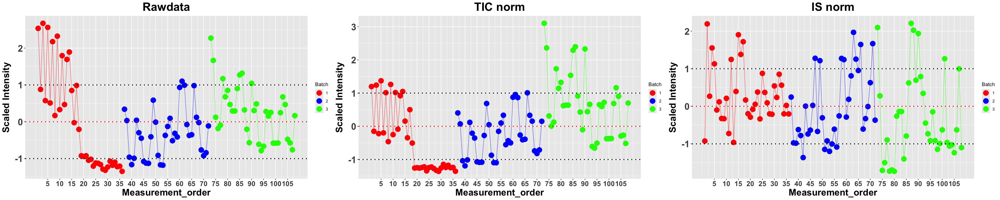

In [124]:
# Violin Plot #
# Intensity Plot (Intensity vs Measurement Order)
# raw data #
# extract only qcs
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data, sample_set)

# ordering by injection_order
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

batch <- qcs_batch_info_data_ordered$batch

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))
propranolol_intensity <- scale(propranolol_intensity_values)

# intensity plot based on measurement_order
qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))

plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = propranolol_intensity
)

mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)

# intensity plot
library(ggplot2)
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# intensity plot with mean and standard deviation lines
intensity_plot_app <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) +  # Let the points be colored according to batch
  geom_line(aes(group = Batch), alpha = 0.5) +  # Add lines between points, grouped by Batch
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  # Add black dotted line for mean
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") +  # Set axis labels
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) +  # Set breaks for x-axis
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("Rawdata") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"),  # Center and bold the title
    axis.title.x = element_text(size = 20, face = "bold"),  # Adjust x-axis label size and make it bold
    axis.title.y = element_text(size = 20, face = "bold"),  # Adjust y-axis label size and make it bold
    axis.text.x = element_text(size = 15, face = "bold"),  # Adjust x-axis tick label size and make it bold
    axis.text.y = element_text(size = 20, face = "bold")  # Adjust y-axis tick label size and make it bold
  )

#print(intensity_plot)

# TIC norm #
# Intensity Plot (Intensity vs Measurement Order)
# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data_TIC, sample_set)

# ordering by injection_order
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

batch <- qcs_batch_info_data_ordered$batch

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))
propranolol_intensity <- scale(propranolol_intensity_values)

# intensity plot based on measurement_order
qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))

plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = propranolol_intensity
)

mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)

# intensity plot
library(ggplot2)
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# intensity plot with mean and standard deviation lines
intensity_plot_TIC_app <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) +  # Let the points be colored according to batch
  geom_line(aes(group = Batch), alpha = 0.5) +  # Add lines between points, grouped by Batch
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  # Add black dotted line for mean
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") +  # Set axis labels
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) +  # Set breaks for x-axis
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("TIC norm") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"),  # Center and bold the title
    axis.title.x = element_text(size = 20, face = "bold"),  # Adjust x-axis label size and make it bold
    axis.title.y = element_text(size = 20, face = "bold"),  # Adjust y-axis label size and make it bold
    axis.text.x = element_text(size = 15, face = "bold"),  # Adjust x-axis tick label size and make it bold
    axis.text.y = element_text(size = 20, face = "bold")  # Adjust y-axis tick label size and make it bold
  )
#print(intensity_plot_TIC)

# IS norm #
# get rid of tissue samples
qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data, sample_set)
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))
batch <- qcs_batch_info_data_ordered$batch

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))

d7_propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == d7_propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
d7_propranolol_intensity_values <- as.numeric(unlist(d7_propranolol_intensity))

ratio_intensity <- propranolol_intensity_values / d7_propranolol_intensity_values
ratio_intensity <- scale(ratio_intensity)


# making data frame
plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = ratio_intensity
)

mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)

# intensity plot
library(ggplot2)
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# intensity plot with mean and standard deviation lines
intensity_plot_IS_app <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) +  # Let the points be colored according to batch
  geom_line(aes(group = Batch), alpha = 0.5) +  # Add lines between points, grouped by Batch
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  # Add black dotted line for mean
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") +  # Set axis labels
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) +  # Set breaks for x-axis
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("IS norm") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"),  # Center and bold the title
    axis.title.x = element_text(size = 20, face = "bold"),  # Adjust x-axis label size and make it bold
    axis.title.y = element_text(size = 20, face = "bold"),  # Adjust y-axis label size and make it bold
    axis.text.x = element_text(size = 15, face = "bold"),  # Adjust x-axis tick label size and make it bold
    axis.text.y = element_text(size = 20, face = "bold")  # Adjust y-axis tick label size and make it bold
  )
#print(intensity_plot_IS)
# display
library(gridExtra)
options(repr.plot.width = 30, repr.plot.height = 6)  # Adjust width and height as desired
combined_intensity_plot_app <- grid.arrange(intensity_plot_app, intensity_plot_TIC_app,
                                            intensity_plot_IS_app, ncol = 3)

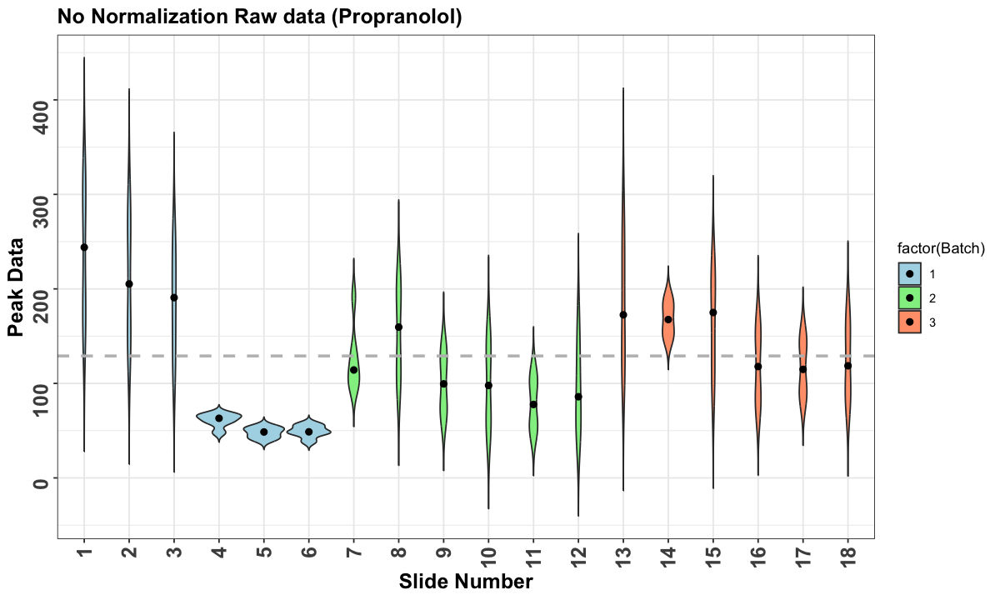

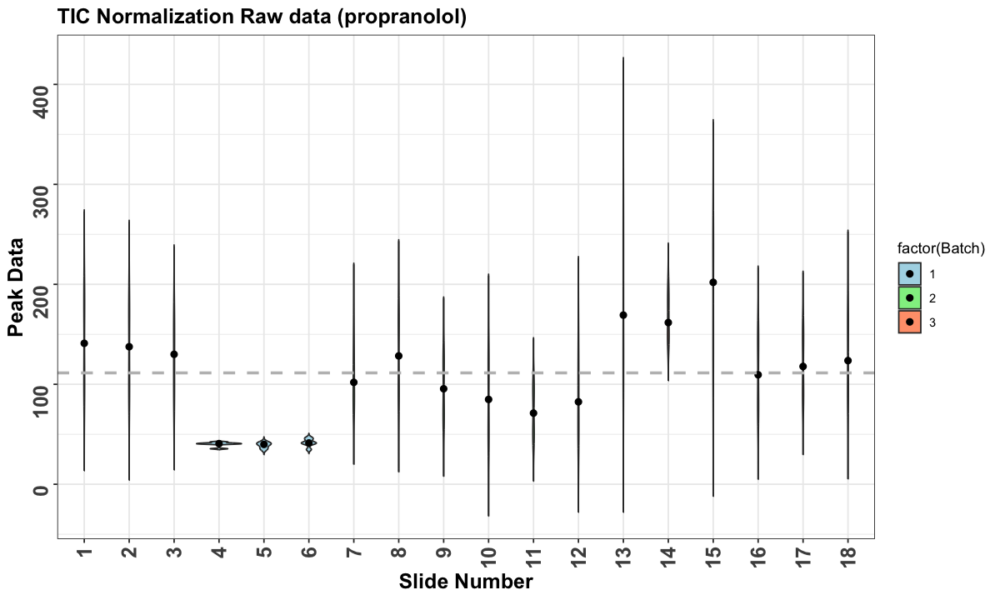

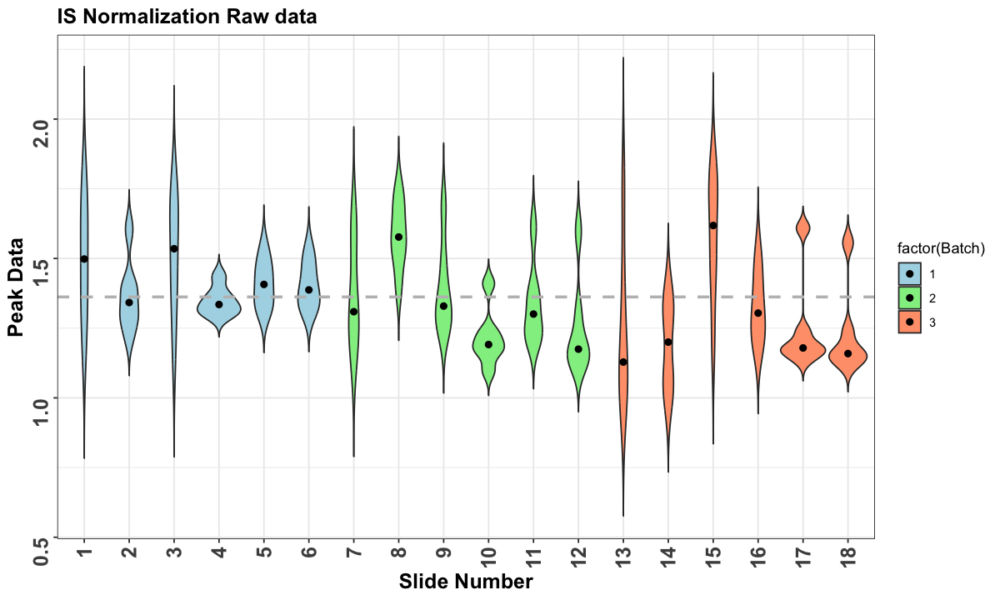

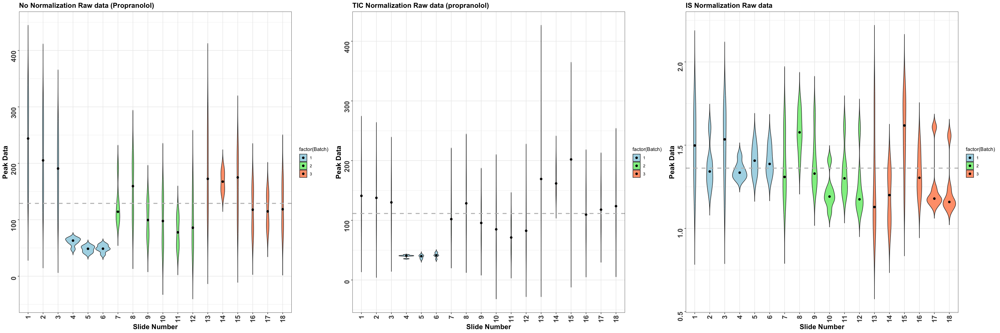

In [125]:
## Violin plot ##
# violin plot for propranolol no normalization
# Load required library
library(ggplot2)
library(dplyr)

propranolol_data_trans <- as.data.frame(t(propranolol_data_app))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data_app$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data <- violin_data %>%
  arrange(Slide)

# find mean of all samples
mean_value <- mean(violin_data$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_app <- ggplot(violin_data, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "No Normalization Raw data (Propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold", size = 15),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold", size = 15),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_app)

# violin plot for propranolol TIC normalization
propranolol_data_trans <- as.data.frame(t(propranolol_data_TIC_app))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_TIC <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data_TIC_app$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_TIC <- violin_data_TIC %>%
  arrange(Slide)

# find mean of all samples
mean_value_TIC <- mean(violin_data_TIC$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_TIC_app <- ggplot(violin_data_TIC, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_TIC, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "TIC Normalization Raw data (propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold", size = 15),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold", size = 15),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_TIC_app)

# violin plot for IS_norm
propranolol_data_trans <- as.data.frame(t(ratio_data_app))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_IS <- data.frame(
  Slide = slide_number,
  Batch = ratio_data_app$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_IS <- violin_data_IS %>%
  arrange(Slide)

# find mean of all samples
mean_value_IS <- mean(violin_data_IS$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_IS_app <- ggplot(violin_data_IS, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_IS, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "IS Normalization Raw data") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold", size = 15),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold", size = 15),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_IS_app)

# Display combined
library(gridExtra)
options(repr.plot.width = 30, repr.plot.height = 10)  # Adjust width and height as desired
combined_violin_plot <- grid.arrange(violin_plot_app, violin_plot_TIC_app, violin_plot_IS_app, ncol = 3)  

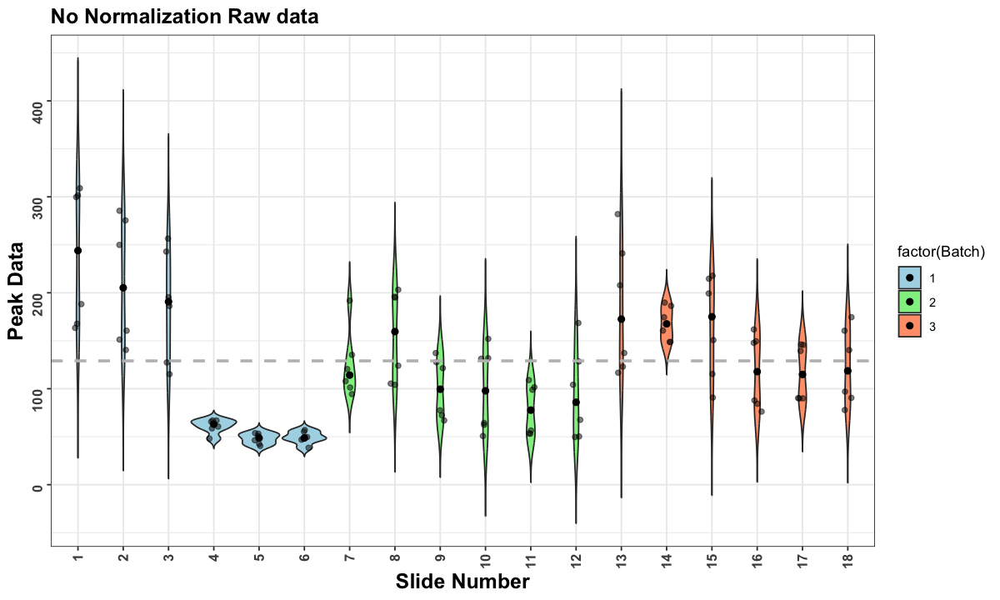

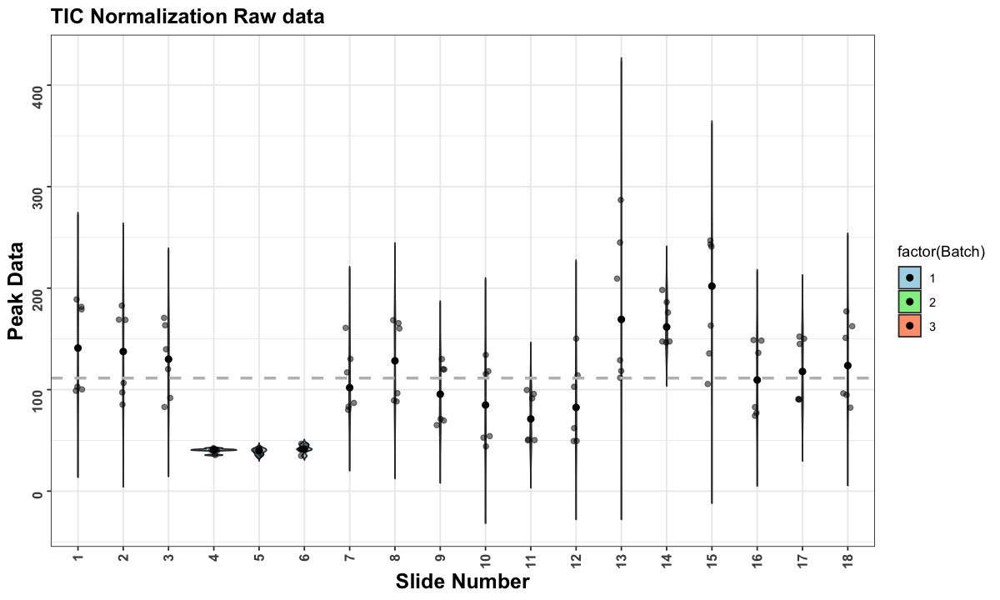

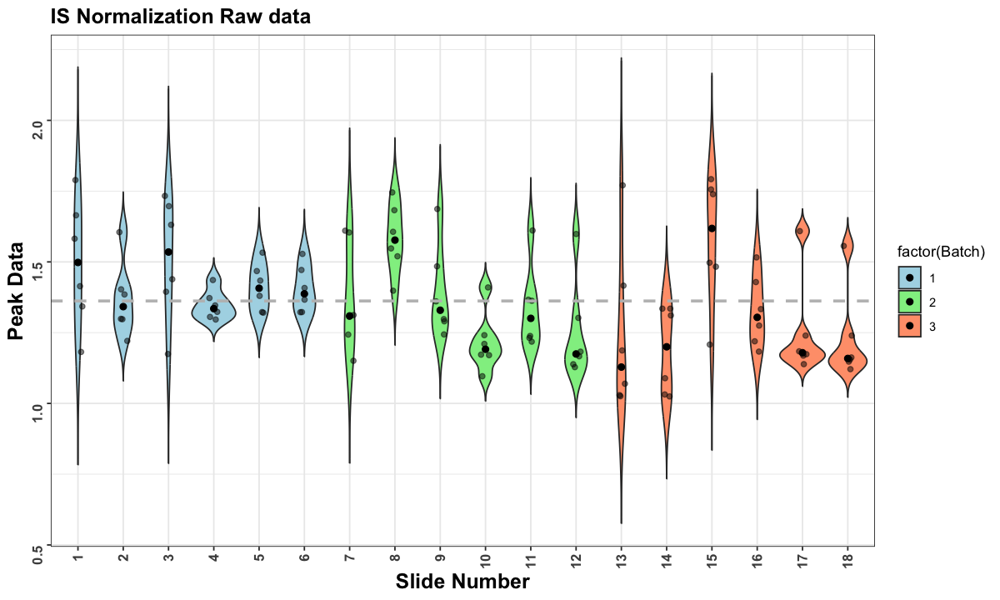

In [126]:
## Violin Plot with Jitter ##
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# no norm #
violin_plot_jit_app <- ggplot(violin_data, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "No Normalization Raw data") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )
print(violin_plot_jit_app)


# TIC norm #
violin_plot_TIC_jit_app <- ggplot(violin_data_TIC, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value_TIC, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "TIC Normalization Raw data") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )
print(violin_plot_TIC_jit_app)

# IS norm #
violin_plot_IS_jit_app <- ggplot(violin_data_IS, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value_IS, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "IS Normalization Raw data") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot with dots
print(violin_plot_IS_jit_app)

Total Score: 81.28 %Total Score: 86.5 %

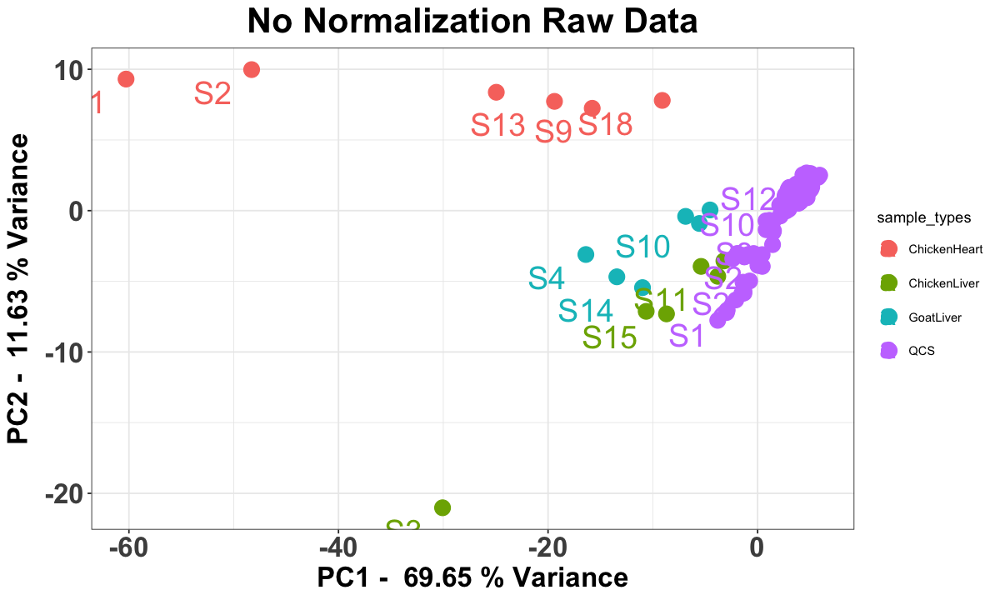

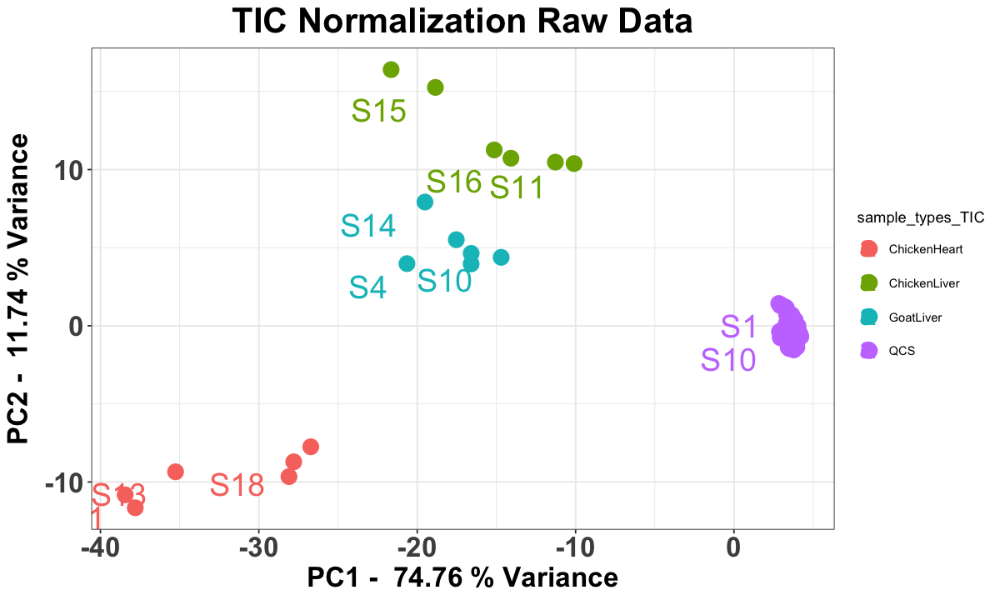

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


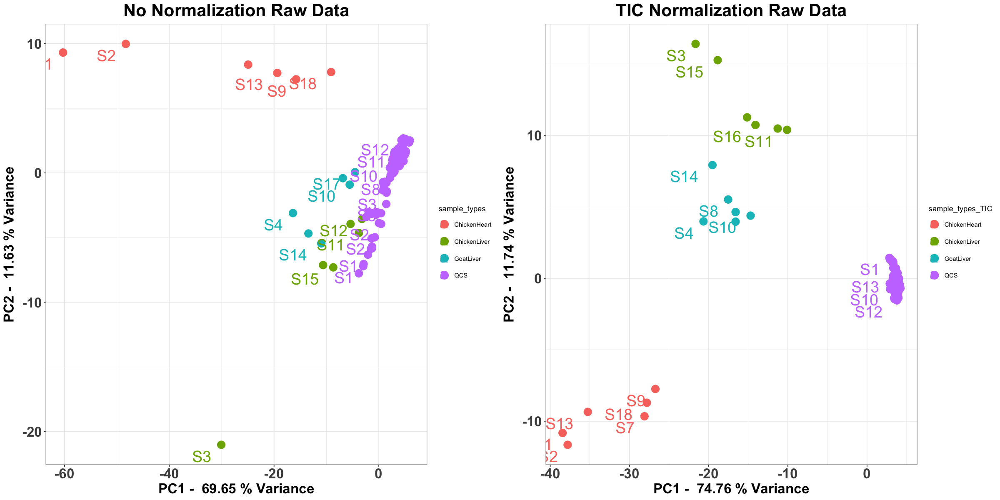

In [127]:
# PCA Plot #
# pca plot for no norm
library(ggplot2)
library(stringr)
library(zoo)
library(dplyr)

# format pca plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# convert all columns combined_batch_data_df as numeric
combined_batch_data_df_numeric <- combined_batch_data_df %>%
  mutate_all(as.numeric)

# extract combined_batch_data df 
adjusted <- combined_batch_data_df_numeric[, -(1:3)]
batch_matrix <- data.frame(adjusted)
sample_ID <- str_extract(colnames(batch_matrix), "(S|m/z)\\d+")

# Create the regular expression pattern for sample_set
pattern <- paste(sample_set, collapse = "|")

# Extract sample types from column names using the defined pattern
sample_types <- str_extract(colnames(batch_matrix), pattern)
sample_types[is.na(sample_types)] <- "QCS"

# Transpose the data so that samples are on rows and features on columns
batch_data_t <- t(as.matrix(batch_matrix))

# Create a new data frame with the transposed matrix
batch_data_t_df <- as.data.frame(batch_data_t)

# Perform PCA, assuming batch_data_t_df contains the transposed data
batch_pca_app <- prcomp(batch_data_t_df, center = TRUE, scale. = TRUE)

# Create a data frame for plotting the PCA
pca_data_app <- data.frame(Sample = sample_ID, batch_pca_app$x)

# Plot PCA with colored sample dots based on sample type
pca_data_app$Score <- pca_data_app$PC1 + pca_data_app$PC2
pca_data_app$Type <- sample_types

# Calculate the PC1 and PC2 scores
pc1_score <- batch_pca_app$sdev[1]^2
pc2_score <- batch_pca_app$sdev[2]^2

# Calculate the total score as the sum of PC1 and PC2 scores
total_score <- pc1_score + pc2_score

# Display the score 
total_score_text_recon <- paste("Total Score:", round(total_score / sum(batch_pca_app$sdev^2) * 100, 2), "%")
cat(total_score_text_recon)

# Create PCA plot
plot_app <- ggplot(pca_data_app, aes(x = PC1, y = PC2, color = sample_types, label = Sample)) +
  geom_point(size = 5) +
  geom_text(hjust = 1.5, vjust = 1.5, size = 8, check_overlap = TRUE) +  # Increased label size
  xlab(paste("PC1 - ", round(batch_pca_app$sdev[1]^2 / sum(batch_pca_app$sdev^2) * 100, 2), "% Variance")) +
  ylab(paste("PC2 - ", round(batch_pca_app$sdev[2]^2 / sum(batch_pca_app$sdev^2) * 100, 2), "% Variance")) +
  ggtitle("No Normalization Raw Data") +
  theme_bw() +
  theme(legend.position = "right", axis.text = element_text(size = 20, face='bold'), 
        axis.title = element_text(size = 20, face='bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'))
print(plot_app)            

# pca plot for TIC norm
library(ggplot2)
library(stringr)
library(zoo)
library(dplyr)

# format pca plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# convert all columns combined_batch_data_df as numeric
combined_batch_data_df_numeric <- combined_batch_data_df_TIC %>%
  mutate_all(as.numeric)

# extract combined_batch_data df 
adjusted <- combined_batch_data_df_numeric[, -(1:3)]
batch_matrix <- data.frame(adjusted)
sample_ID <- str_extract(colnames(batch_matrix), "(S|m/z)\\d+")

# Create the regular expression pattern for sample_set
pattern <- paste(sample_set, collapse = "|")

# Extract sample types from column names using the defined pattern
sample_types_TIC <- str_extract(colnames(batch_matrix), pattern)
sample_types_TIC[is.na(sample_types_TIC)] <- "QCS"

# Transpose the data so that samples are on rows and features on columns
batch_data_t <- t(as.matrix(batch_matrix))

# Create a new data frame with the transposed matrix
batch_data_t_df <- as.data.frame(batch_data_t)

# Perform PCA, assuming batch_data_t_df contains the transposed data
batch_pca_TIC_app <- prcomp(batch_data_t_df, center = TRUE, scale. = TRUE)

# Create a data frame for plotting the PCA
pca_data_TIC_app <- data.frame(Sample = sample_ID, batch_pca_TIC_app$x)

# Plot PCA with colored sample dots based on sample type
pca_data_TIC_app$Score <- pca_data_TIC_app$PC1 + pca_data_TIC_app$PC2
pca_data_TIC_app$Type <- sample_types_TIC

# Calculate the PC1 and PC2 scores
pc1_score <- batch_pca_TIC_app$sdev[1]^2
pc2_score <- batch_pca_TIC_app$sdev[2]^2

# Calculate the total score as the sum of PC1 and PC2 scores
total_score <- pc1_score + pc2_score

# Display the score 
total_score_text_recon <- paste("Total Score:", round(total_score / sum(batch_pca_TIC_app$sdev^2) * 100, 2), "%")
cat(total_score_text_recon)

# Create PCA plot
plot_TIC_app <- ggplot(pca_data_TIC_app, aes(x = PC1, y = PC2, color = sample_types_TIC, label = Sample)) +
  geom_point(size = 5) +
  geom_text(hjust = 1.5, vjust = 1.5, size = 8, check_overlap = TRUE) +  # Increased label size
  xlab(paste("PC1 - ", round(batch_pca_TIC_app$sdev[1]^2 / sum(batch_pca_TIC_app$sdev^2) * 100, 2), "% Variance")) +
  ylab(paste("PC2 - ", round(batch_pca_TIC_app$sdev[2]^2 / sum(batch_pca_TIC_app$sdev^2) * 100, 2), "% Variance")) +
  ggtitle("TIC Normalization Raw Data") +
  theme_bw() +
  theme(legend.position = "right", axis.text = element_text(size = 20, face='bold'), 
        axis.title = element_text(size = 20, face='bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'))
print(plot_TIC_app)
                         
## Overview PCA Plot ##
library(gridExtra)
options(repr.plot.width = 20, repr.plot.height = 10)
combined_plots <- grid.arrange(plot_app, plot_TIC_app, ncol = 2)
print(combined_plots)

## Tissue Evaluation ##

In [128]:
## Overview RSD Table Propranolol ##
overview_table_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  No_Norm_RSD = c(rsd_propranolol_app[,2]),
  TIC_Norm_RSD = c(rsd_propranolol_TIC_app[,2]),
  IS_Norm_RSD = c(rsd_ratio_app[,2])  
)
# Set the column names
colnames(overview_table_pro) <- c(paste("mz value:", propranolol_mz_value), "No_norm", "TIC_norm", "IS_norm")

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying rsd table
display_rsd_table_pro <- kable(overview_table_pro, format = "html", row.names = FALSE, 
                               col.names = c(paste("m/z value:", propranolol_mz_value), "No_norm", "TIC_norm", "IS_norm")) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_pro <- paste("<h2 style='text-align: center;'>Overview RSD Table Propranolol</h2>", 
                               as.character(display_rsd_table_pro))

# Save HTML table to a file
display_html(display_rsd_table_pro)

m/z value: 260.14,No_norm,TIC_norm,IS_norm
Intraday 1,70.22%,63.3%,10.55%
Intraday 2,41%,38.6%,13.8%
Intraday 3,34.17%,36.6%,17.33%
Interday,52.15%,50.78%,14.3%


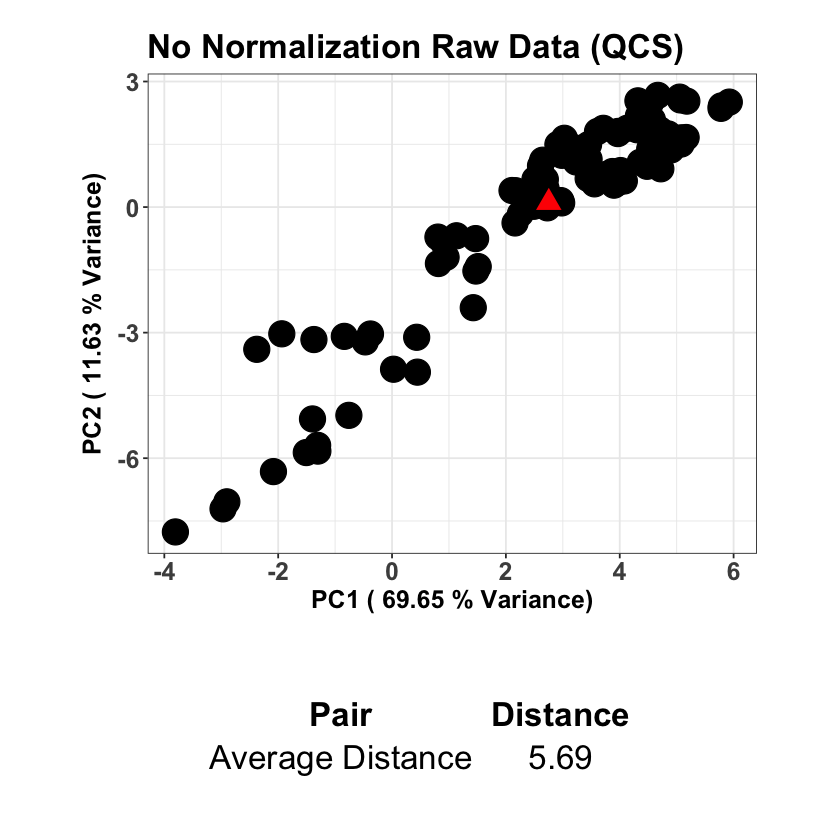

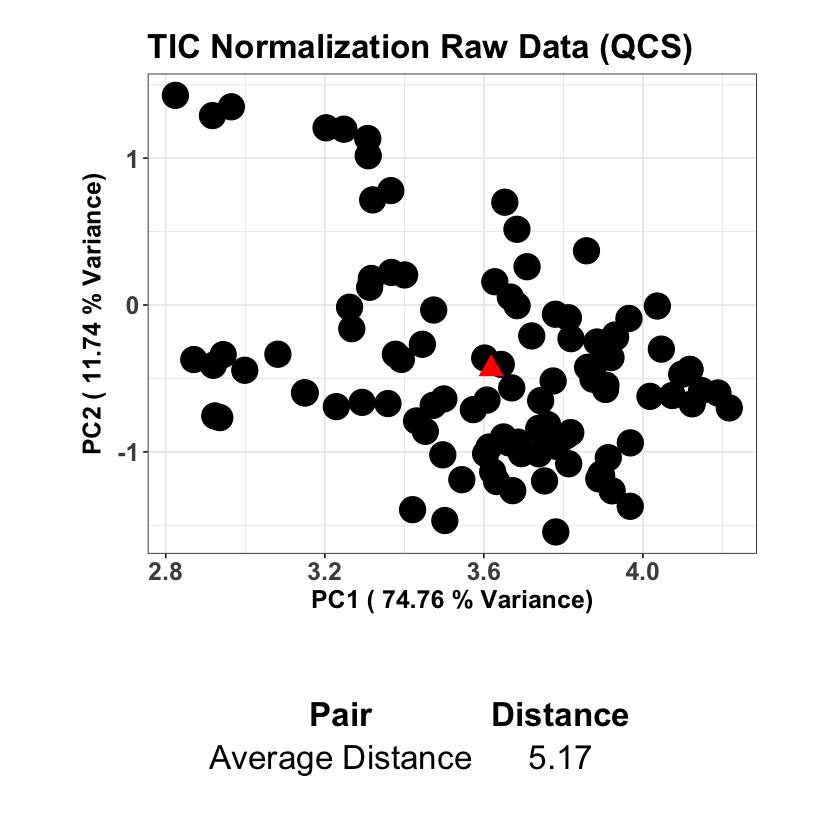

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


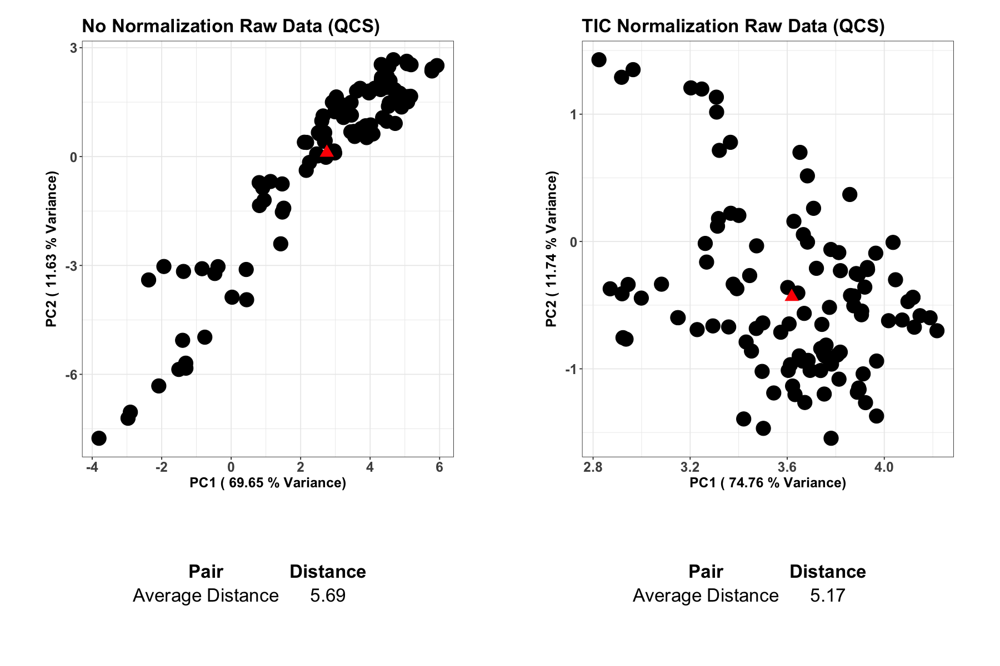

In [129]:
## PCA plot of QCS ##
# no normalization raw data
# Load necessary libraries
library(ggplot2)
library(ggrepel)
library(cowplot)
library(gridExtra)

# gets rid of plot format
options(repr.plot.width = NULL, repr.plot.height = NULL)

# Calculate PCA scores
pca_scores <- batch_pca_app$x

# Identify QCS samples based on sample types
qcs_samples <- which(sample_types == "QCS")

# Extract PCA scores for QCS samples
qcs_scores <- pca_scores[qcs_samples, ]

# Compute the centroid of QCS samples
qcs_centroid <- colMeans(qcs_scores)

# Calculate PC1 and PC2 variances
pc1_variance <- round(batch_pca_app$sdev[1]^2 / sum(batch_pca_app$sdev^2) * 100, 2)
pc2_variance <- round(batch_pca_app$sdev[2]^2 / sum(batch_pca_app$sdev^2) * 100, 2)

# Plot PCA plot with QCS samples and their centroid
pca_plot_qcs_app <- ggplot(data.frame(PC1 = qcs_scores[,1], PC2 = qcs_scores[,2]), aes(x = PC1, y = PC2)) +
  geom_point(size = 7) +  # Plot QCS samples
  geom_point(data = data.frame(PC1 = qcs_centroid[1], PC2 = qcs_centroid[2]), aes(x = PC1, y = PC2), shape = 17, fill = "red", color = "red", size = 5) +  # Plot centroid as triangle with filled red color
  labs(x = paste("PC1 (", pc1_variance, "% Variance)"), y = paste("PC2 (", pc2_variance, "% Variance)"), title = "No Normalization Raw Data (QCS)") +
  theme_bw() +
  theme(axis.title.x = element_text(face = "bold", size = 15),
        axis.title.y = element_text(face = "bold", size = 15),
        axis.text = element_text(size = 15, face = "bold"),
        plot.margin = margin(20, 50, 10, 50),  # Adjust the bottom margin to 10 units
        plot.title = element_text(face = "bold", size = 20))  # Make the plot title bold and size 20

# Calculate average distance of QCS samples from the centroid
qcs_centroid_distances <- sqrt(rowSums((qcs_scores - qcs_centroid)^2))
average_qcs_distance_app <- mean(qcs_centroid_distances)

# Create a data frame for average distance
average_distance_qcs_df <- data.frame(
  Pair = "Average Distance",
  Distance = average_qcs_distance_app
)

# Round distances for better presentation
average_distance_qcs_df$Distance <- round(average_distance_qcs_df$Distance, 2)

# Create a table plot
table_plot_qcs <- tableGrob(average_distance_qcs_df, theme = ttheme_minimal(base_size = 20), rows = NULL)

# Combine the PCA plot and the table
combined_plot_qcs_app <- plot_grid(pca_plot_qcs_app, table_plot_qcs, ncol = 1, align = "v", axis = "lr", rel_heights = c(3, 1))
print(combined_plot_qcs_app)


## PCA plot of QCS ##
# TIC normalization raw data
# Load necessary libraries
library(ggplot2)
library(ggrepel)
library(cowplot)
library(gridExtra)

# gets rid of plot format
options(repr.plot.width = NULL, repr.plot.height = NULL)

# Calculate PCA scores
pca_scores <- batch_pca_TIC_app$x

# Identify QCS samples based on sample types
qcs_samples <- which(sample_types == "QCS")

# Extract PCA scores for QCS samples
qcs_scores <- pca_scores[qcs_samples, ]

# Compute the centroid of QCS samples
qcs_centroid <- colMeans(qcs_scores)

# Calculate PC1 and PC2 variances
pc1_variance <- round(batch_pca_TIC_app$sdev[1]^2 / sum(batch_pca_TIC_app$sdev^2) * 100, 2)
pc2_variance <- round(batch_pca_TIC_app$sdev[2]^2 / sum(batch_pca_TIC_app$sdev^2) * 100, 2)

# Plot PCA plot with QCS samples and their centroid
pca_plot_qcs_app <- ggplot(data.frame(PC1 = qcs_scores[,1], PC2 = qcs_scores[,2]), aes(x = PC1, y = PC2)) +
  geom_point(size = 7) +  # Plot QCS samples
  geom_point(data = data.frame(PC1 = qcs_centroid[1], PC2 = qcs_centroid[2]), aes(x = PC1, y = PC2), shape = 17, fill = "red", color = "red", size = 5) +  # Plot centroid as triangle with filled red color
  labs(x = paste("PC1 (", pc1_variance, "% Variance)"), y = paste("PC2 (", pc2_variance, "% Variance)"), title = "TIC Normalization Raw Data (QCS)") +
  theme_bw() +
  theme(axis.title.x = element_text(face = "bold", size = 15),
        axis.title.y = element_text(face = "bold", size = 15),
        axis.text = element_text(size = 15, face = "bold"),
        plot.margin = margin(20, 50, 10, 50),  # Adjust the bottom margin to 10 units
        plot.title = element_text(face = "bold", size = 20))  # Make the plot title bold and size 20

# Calculate average distance of QCS samples from the centroid
qcs_centroid_distances <- sqrt(rowSums((qcs_scores - qcs_centroid)^2))
average_qcs_distance_TIC_app <- mean(qcs_centroid_distances)

# Create a data frame for average distance
average_distance_qcs_df <- data.frame(
  Pair = "Average Distance",
  Distance = average_qcs_distance_TIC_app
)

# Round distances for better presentation
average_distance_qcs_df$Distance <- round(average_distance_qcs_df$Distance, 2)

# Create a table plot
table_plot_qcs <- tableGrob(average_distance_qcs_df, theme = ttheme_minimal(base_size = 20), rows = NULL)

# Combine the PCA plot and the table
combined_plot_TIC_qcs_app <- plot_grid(pca_plot_qcs_app, table_plot_qcs, ncol = 1, align = "v", axis = "lr", rel_heights = c(3, 1))

# Print the combined plot
print(combined_plot_TIC_qcs_app)

# Overview QCS PCA plot #
## Overview QCS PCA PLOT ##
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 10)
combined_plots_app <- grid.arrange(combined_plot_qcs_app, combined_plot_TIC_qcs_app, ncol = 2)
print(combined_plots_app)

In [130]:
## Calculate QCS eucleadan distance ##
# No normalization
qcs_indices <- which(pca_data_app$Type == "QCS") # 108
pca_scores_qcs <- pca_data_app[qcs_indices, -which(names(pca_data_app) == "Score")]
numeric_cols <- sapply(pca_scores_qcs, is.numeric)
pca_scores_numeric <- pca_scores_qcs[, numeric_cols]

# calculate euclidean distance
euclidean_distances <- dist(pca_scores_numeric)
average_distance_ec_app <- mean(euclidean_distances)
cat("Average QCS distance for no normalization is", average_distance_ec_app, "\n")

Average QCS distance for no normalization is 5.588882 


In [131]:
## Calculate QCS eucleadan distance ##
# TIC normalization
qcs_indices <- which(pca_data_TIC_app$Type == "QCS") # 108
pca_scores_qcs <- pca_data_TIC_app[qcs_indices, -which(names(pca_data_TIC_app) == "Score")]
numeric_cols <- sapply(pca_scores_qcs, is.numeric)
pca_scores_numeric <- pca_scores_qcs[, numeric_cols]

# calculate euclidean distance
euclidean_distances <- dist(pca_scores_numeric)
average_distance_ec_TIC_app <- mean(euclidean_distances)
cat("Average QCS distance for TIC normalization is", average_distance_ec_TIC_app, "\n")

Average QCS distance for TIC normalization is 3.309569 


Batch,RSD
Intraday 1,26.06 ± 8.25%
Intraday 2,24.88 ± 7.11%
Intraday 3,22.80 ± 9.89%
Interday,23.52 ± 5.77%
Batch,RSD
Intraday 1,9.55 ± 7.26%
Intraday 2,8.61 ± 5.49%
Intraday 3,9.48 ± 7.97%
Interday,13.18 ± 5.64%
Batch,RSD


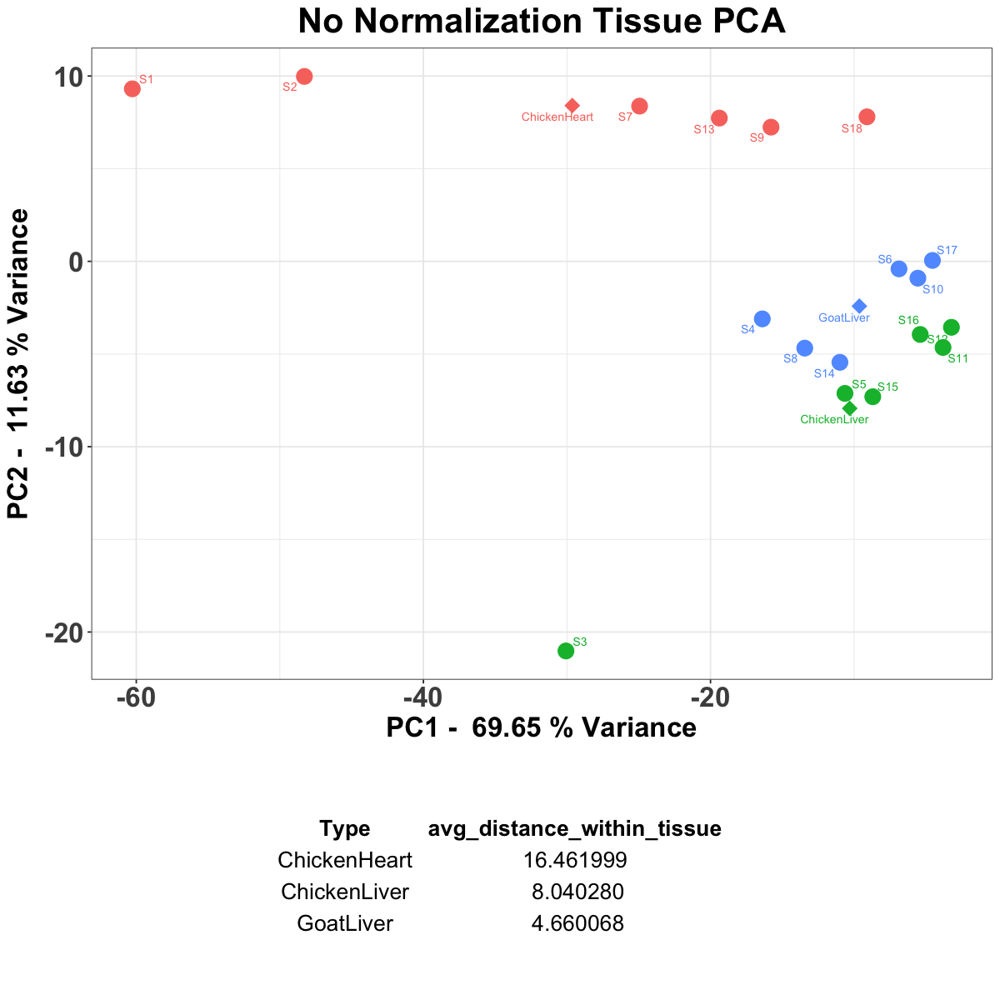

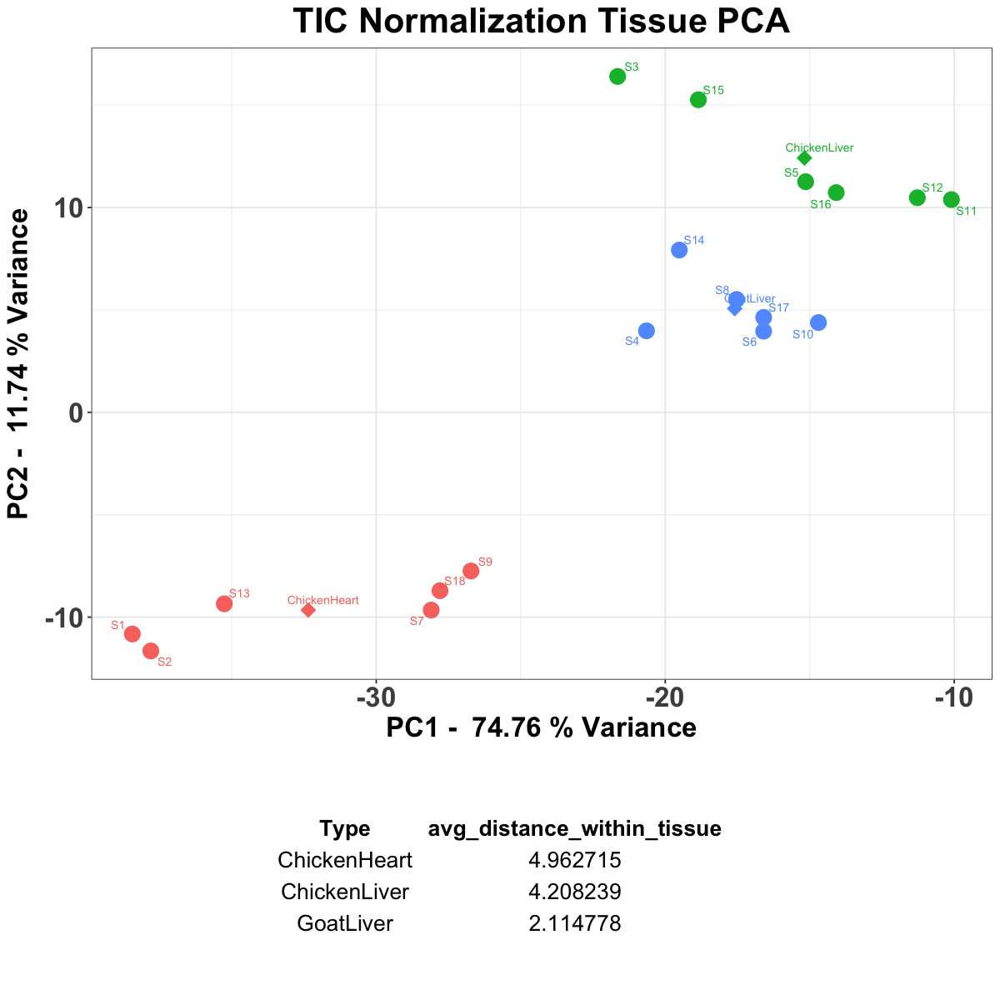

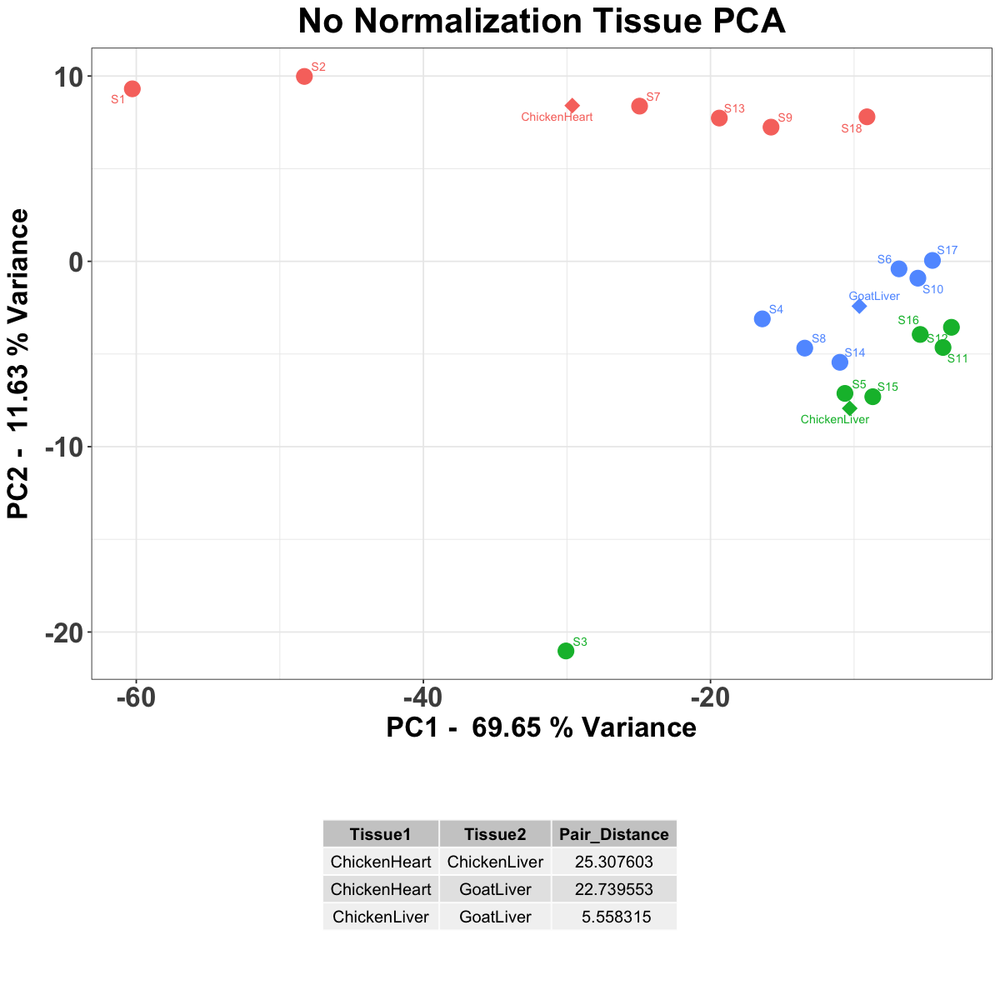

Average_distances,No_norm,TIC_norm
QCS(centroid),5.68792592863425,5.17055971850608
QCS(euclidean),5.58888195331204,3.30956852922702
Tissue(intragroup),"16.4619987446869, 8.04027981461993, 4.66006784860712","4.96271535668062, 4.20823859146443, 2.11477798959575"
Tissue(intergroup),"25.3076026343663, 22.7395528721276, 5.55831516021798","27.9640559221218, 20.8420400811023, 7.73908209769892"


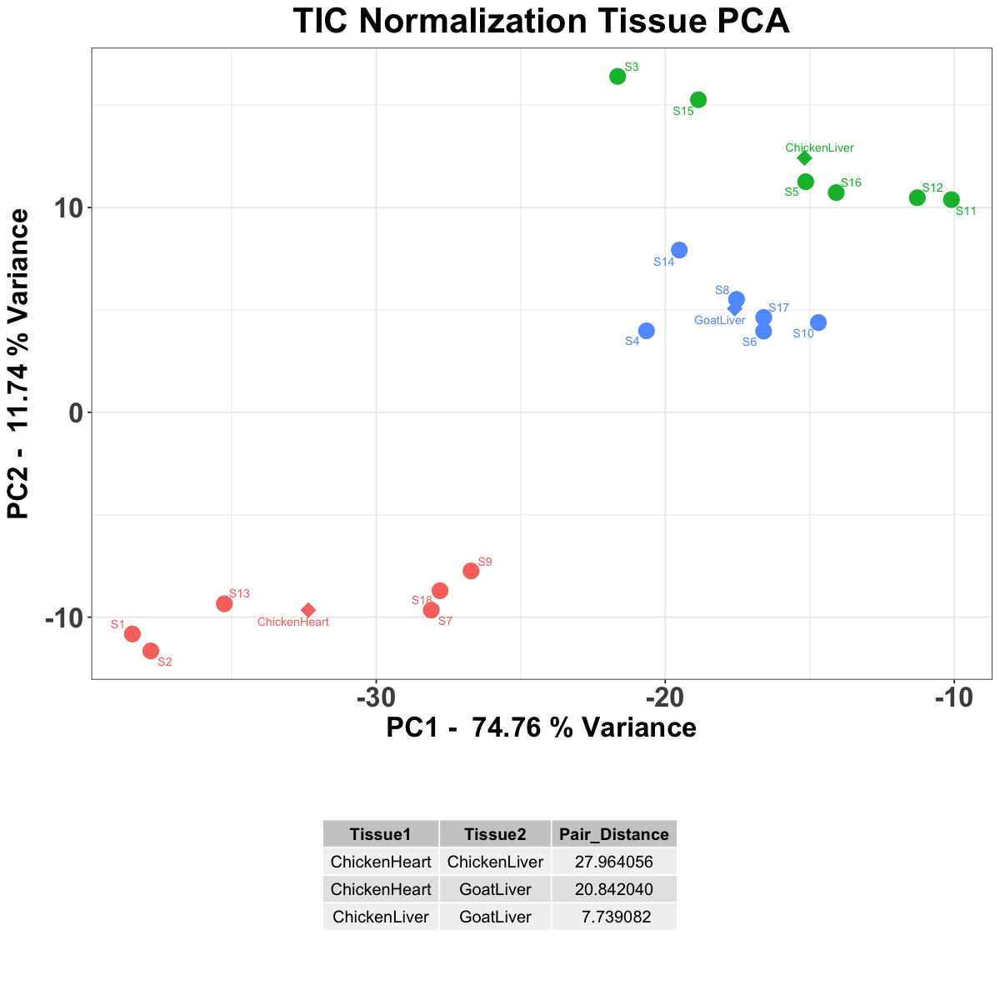

In [132]:
## Tissue Evaluation ##
## Tissue Variation RSD No Norm ##
# extract tissue samples based on the rownames
sample_set_regex <- paste(sample_set, collapse = "|")
sample_set_rows <- grep(sample_set_regex, rownames(combined_batch_info_data))
tissue_samples <- combined_batch_info_data[sample_set_rows,]
row_names <- rownames(tissue_samples)
tissue_samples <- as.data.frame(apply(tissue_samples, 2, as.numeric))
rownames(tissue_samples) <- row_names

# Function to calculate rsd for tissue
calculate_batch_rsd_combined <- function(tissue_samples) {
  # Function to calculate batch RSD for a given tissue dataset
  calculate_batch_rsd <- function(sample_dataset, batch_number) {
    # Extract data for the specified batch number
    batch_data <- sample_dataset[sample_dataset$batch == batch_number, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(batch_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(batch_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate interday RSD for a given tissue dataset
  calculate_interday_rsd <- function(sample_dataset) {
    # Extract data for interday calculation
    interday_data <- sample_dataset[, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(interday_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(interday_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate batch RSD for multiple batches
  calculate_batch_rsd_multiple <- function(sample_dataset, unique_batches) {
    rsd_results <- list()
    for (batch_number in unique_batches) {
      rsd_results[[as.character(batch_number)]] <- calculate_batch_rsd(sample_dataset, batch_number)
    }
    return(rsd_results)
  }
  
  # Extract unique tissue sample datasets for each tissue type
  unique_tissues <- unique(gsub(".*_(\\w+)_\\d+.*", "\\1", rownames(tissue_samples)))
  
  # Initialize list to store results for each tissue type
  rsd_results <- list()
  
  # Loop through each tissue type
  for (tissue_type in unique_tissues) {
    # Filter tissue samples for the current tissue type
    tissue_data <- tissue_samples[grep(paste0(tissue_type, "_"), rownames(tissue_samples)), ]
    
    # Order the dataset based on s_value
    sample_numbers <- as.numeric(gsub(".*S(\\d+)_.*", "\\1", rownames(tissue_data)))
    ordered_indices <- order(sample_numbers)
    tissue_data <- tissue_data[ordered_indices, ]
    
    # Replace negative values with 1
    tissue_data <- replace(tissue_data, tissue_data < 0, 1)
    
    # Calculate batch RSD for unique batches
    unique_batches <- unique(tissue_data$batch)
    rsd_results_tissue <- calculate_batch_rsd_multiple(tissue_data, unique_batches)
    
    # Calculate interday RSD
    interday_rsd <- calculate_interday_rsd(tissue_data)
    
    # Combine batch and interday RSD results into a data frame
    rsd_df_tissue <- data.frame(
      Batch = names(rsd_results_tissue),
      RSD = unlist(rsd_results_tissue)
    )
    rsd_df_tissue <- rbind(rsd_df_tissue, c("Interday", interday_rsd))
    rownames(rsd_df_tissue) <- NULL
    
    # Alter batch names to Intraday 1, Intraday 2, etc.
    batch_names <- c("Intraday 1", "Intraday 2", "Intraday 3")
    rsd_df_tissue$Batch <- ifelse(rsd_df_tissue$Batch == "Interday", "Interday", batch_names)
    
    # Store results for the current tissue type
    rsd_results[[tissue_type]] <- rsd_df_tissue
  }
  
  return(rsd_results)
}
rsd_results_combined_app <- calculate_batch_rsd_combined(tissue_samples)

## Tissue Variation RSD TIC norm ##
# extract tissue samples based on the rownames
sample_set_regex <- paste(sample_set, collapse = "|")
sample_set_rows <- grep(sample_set_regex, rownames(combined_batch_info_data_TIC))
tissue_samples <- combined_batch_info_data_TIC[sample_set_rows,]
row_names <- rownames(tissue_samples)
tissue_samples <- as.data.frame(apply(tissue_samples, 2, as.numeric))
rownames(tissue_samples) <- row_names

# Function to calculate rsd for tissue
calculate_batch_rsd_combined <- function(tissue_samples) {
  # Function to calculate batch RSD for a given tissue dataset
  calculate_batch_rsd <- function(sample_dataset, batch_number) {
    # Extract data for the specified batch number
    batch_data <- sample_dataset[sample_dataset$batch == batch_number, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(batch_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(batch_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate interday RSD for a given tissue dataset
  calculate_interday_rsd <- function(sample_dataset) {
    # Extract data for interday calculation
    interday_data <- sample_dataset[, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(interday_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(interday_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate batch RSD for multiple batches
  calculate_batch_rsd_multiple <- function(sample_dataset, unique_batches) {
    rsd_results <- list()
    for (batch_number in unique_batches) {
      rsd_results[[as.character(batch_number)]] <- calculate_batch_rsd(sample_dataset, batch_number)
    }
    return(rsd_results)
  }
  
  # Extract unique tissue sample datasets for each tissue type
  unique_tissues <- unique(gsub(".*_(\\w+)_\\d+.*", "\\1", rownames(tissue_samples)))
  
  # Initialize list to store results for each tissue type
  rsd_results <- list()
  
  # Loop through each tissue type
  for (tissue_type in unique_tissues) {
    # Filter tissue samples for the current tissue type
    tissue_data <- tissue_samples[grep(paste0(tissue_type, "_"), rownames(tissue_samples)), ]
    
    # Order the dataset based on s_value
    sample_numbers <- as.numeric(gsub(".*S(\\d+)_.*", "\\1", rownames(tissue_data)))
    ordered_indices <- order(sample_numbers)
    tissue_data <- tissue_data[ordered_indices, ]
    
    # Replace negative values with 1
    tissue_data <- replace(tissue_data, tissue_data < 0, 1)
    
    # Calculate batch RSD for unique batches
    unique_batches <- unique(tissue_data$batch)
    rsd_results_tissue <- calculate_batch_rsd_multiple(tissue_data, unique_batches)
    
    # Calculate interday RSD
    interday_rsd <- calculate_interday_rsd(tissue_data)
    
    # Combine batch and interday RSD results into a data frame
    rsd_df_tissue <- data.frame(
      Batch = names(rsd_results_tissue),
      RSD = unlist(rsd_results_tissue)
    )
    rsd_df_tissue <- rbind(rsd_df_tissue, c("Interday", interday_rsd))
    rownames(rsd_df_tissue) <- NULL
    
    # Alter batch names to Intraday 1, Intraday 2, etc.
    batch_names <- c("Intraday 1", "Intraday 2", "Intraday 3")
    rsd_df_tissue$Batch <- ifelse(rsd_df_tissue$Batch == "Interday", "Interday", batch_names)
    
    # Store results for the current tissue type
    rsd_results[[tissue_type]] <- rsd_df_tissue
  }
  
  return(rsd_results)
}
rsd_results_combined_TIC_app <- calculate_batch_rsd_combined(tissue_samples)

## Overview RSD Table ##

# Initialize an empty list to store combined HTML tables for each tissue
combined_html_list <- list()

# Iterate over each tissue type
for (tissue_name in names(rsd_results_combined_app)) {
  # Extract RSD tables for the current tissue type
  rsd_table_app <- generate_rsd_table(rsd_results_combined_app, tissue_name)
  rsd_table_TIC_app <- generate_rsd_table(rsd_results_combined_TIC_app, tissue_name)
  
  # Combine HTML tables for the current tissue type horizontally
  combined_rsd_table <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>",
                              "<div style='text-align: center;'>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>No Normalization</h3>", rsd_table_app, "</div>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>TIC Normalization</h3>", rsd_table_TIC_app, "</div>",
                              "</div>")
  
  # Add the combined HTML table to the list
  combined_html_list[[tissue_name]] <- combined_rsd_table
}

# Combine HTML tables into a single HTML table with two columns
combined_html <- paste("<table style='width:100%; border-collapse: collapse;'>", 
                       "<tr>", paste("<td style='vertical-align: top;'>", 
                                     unlist(combined_html_list), 
                                     "</td>", sep = ""), "</tr></table>")

# Wrap the combined HTML content in a div with text-align: center
centered_combined_html <- paste("<div style='text-align: center;'>", combined_html, "</div>")

# Display the centered HTML content in JupyterLab
display_html(centered_combined_html)

## Tissue PCA plot intragroup no norm ##
library(gridExtra)
library(dplyr)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_app %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Calculate distances between each sample and its corresponding centroid within each tissue type
tissue_pca_data_with_centroids <- left_join(tissue_pca_data, centroids, by = "Type")
tissue_pca_data_with_centroids <- tissue_pca_data_with_centroids %>%
  mutate(distance_to_centroid = sqrt((PC1 - Centroid_PC1)^2 + (PC2 - Centroid_PC2)^2))

# Calculate average distance within each tissue type
tissue_avg_distances_app <- tissue_pca_data_with_centroids %>%
  group_by(Type) %>%
  summarize(avg_distance_within_tissue = mean(distance_to_centroid))

# Create intragroup pca plot
tissue_intra_plot_app <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +
  labs(title = "No Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_app$sdev[1]^2 / sum(batch_pca_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_app$sdev[2]^2 / sum(batch_pca_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create table plot
table_plot <- tableGrob(tissue_avg_distances_app, rows = NULL, theme = ttheme_minimal(base_size = 16))

# Arrange PCA plot and table plot
combined_plot_intra_app <- grid.arrange(tissue_intra_plot_app, table_plot, ncol = 1, heights = c(3, 1))

## Tissue PCA plot intragroup TIC norm ##
library(gridExtra)
library(dplyr)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_TIC_app %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Calculate distances between each sample and its corresponding centroid within each tissue type
tissue_pca_data_with_centroids <- left_join(tissue_pca_data, centroids, by = "Type")
tissue_pca_data_with_centroids <- tissue_pca_data_with_centroids %>%
  mutate(distance_to_centroid = sqrt((PC1 - Centroid_PC1)^2 + (PC2 - Centroid_PC2)^2))

# Calculate average distance within each tissue type
tissue_avg_distances_TIC_app <- tissue_pca_data_with_centroids %>%
  group_by(Type) %>%
  summarize(avg_distance_within_tissue = mean(distance_to_centroid))

# Create intragroup pca plot
tissue_intra_plot_app <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +
  labs(title = "TIC Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_TIC_app$sdev[1]^2 / sum(batch_pca_TIC_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_TIC_app$sdev[2]^2 / sum(batch_pca_TIC_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create table plot
table_plot <- tableGrob(tissue_avg_distances_TIC_app, rows = NULL, theme = ttheme_minimal(base_size = 16))

# Arrange PCA plot and table plot
combined_plot_TIC_intra_app <- grid.arrange(tissue_intra_plot_app, table_plot, ncol = 1, heights = c(3, 1))

# Intergroup #
## Tissue with centroid PCA plot intergroup no norm ##
library(ggplot2)
library(dplyr)
library(ggrepel)
library(gridExtra)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired


# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_app %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Plot tissue-only PCA with centroids, data point labels, and axis labels
tissue_plot_app <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  # Using geom_text_repel to prevent label overlap
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  # Add labels for data points without overlap
  labs(title = "No Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_app$sdev[1]^2 / sum(batch_pca_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_app$sdev[2]^2 / sum(batch_pca_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# calculate intergroup distance #
# Create a data frame to store pairwise distances and tissue types
# Generate all possible combinations of tissue types
tissue_combinations <- combn(unique(centroids$Type), 2, simplify = TRUE)

# Initialize an empty data frame to store pairwise distances
centroid_distances_df_app <- data.frame(Tissue1 = character(), Tissue2 = character(), Pair_Distance = numeric())

# Iterate over each pair of tissue combinations
for (i in 1:ncol(tissue_combinations)) {
  tissue_pair <- tissue_combinations[, i]
  centroid1 <- centroids %>% filter(Type == tissue_pair[1])
  centroid2 <- centroids %>% filter(Type == tissue_pair[2])
  distance <- sqrt((centroid1$Centroid_PC1 - centroid2$Centroid_PC1)^2 + (centroid1$Centroid_PC2 - centroid2$Centroid_PC2)^2)
  centroid_distances_df_app <- rbind(centroid_distances_df_app, data.frame(Tissue1 = tissue_pair[1], Tissue2 = tissue_pair[2], Pair_Distance = distance))
}

# Create the tissue plot
tissue_intergroup_plot_app <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  
  labs(title = "No Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_app$sdev[1]^2 / sum(batch_pca_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_app$sdev[2]^2 / sum(batch_pca_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create a table grob for centroid distances
centroid_table <- tableGrob(centroid_distances_df_app, rows = NULL)

# Arrange plots and table vertically
combined_plot_inter_app <- grid.arrange(tissue_intergroup_plot_app, centroid_table,
                                        ncol = 1,
                                        heights = c(3, 1))

## Tissue with centroid PCA plot intergroup TIC norm ##
library(ggplot2)
library(dplyr)
library(ggrepel)
library(gridExtra)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_TIC_app %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Plot tissue-only PCA with centroids, data point labels, and axis labels
tissue_plot_app <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  # Using geom_text_repel to prevent label overlap
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  # Add labels for data points without overlap
  labs(title = "TIC Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_TIC_app$sdev[1]^2 / sum(batch_pca_TIC_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_TIC_app$sdev[2]^2 / sum(batch_pca_TIC_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# calculate intergroup distance #
# Create a data frame to store pairwise distances and tissue types
# Generate all possible combinations of tissue types
tissue_combinations <- combn(unique(centroids$Type), 2, simplify = TRUE)

# Initialize an empty data frame to store pairwise distances
centroid_distances_df_TIC_app <- data.frame(Tissue1 = character(), Tissue2 = character(), Pair_Distance = numeric())

# Iterate over each pair of tissue combinations
for (i in 1:ncol(tissue_combinations)) {
  tissue_pair <- tissue_combinations[, i]
  centroid1 <- centroids %>% filter(Type == tissue_pair[1])
  centroid2 <- centroids %>% filter(Type == tissue_pair[2])
  distance <- sqrt((centroid1$Centroid_PC1 - centroid2$Centroid_PC1)^2 + (centroid1$Centroid_PC2 - centroid2$Centroid_PC2)^2)
  centroid_distances_df_TIC_app <- rbind(centroid_distances_df_TIC_app, data.frame(Tissue1 = tissue_pair[1], Tissue2 = tissue_pair[2], Pair_Distance = distance))
}

# Create the tissue plot
tissue_intergroup_plot_TIC_app <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  
  labs(title = "TIC Normalization Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_TIC_app$sdev[1]^2 / sum(batch_pca_TIC_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_TIC_app$sdev[2]^2 / sum(batch_pca_TIC_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create a table grob for centroid distances
centroid_table_TIC <- tableGrob(centroid_distances_df_TIC_app, rows = NULL)

# Arrange plots and table vertically
combined_plot_TIC_inter_app <- grid.arrange(tissue_intergroup_plot_TIC_app, centroid_table_TIC, ncol = 1, heights = c(3, 1))

## Average Distance Table ##
# Create separate rows for each tissue value
merged_data <- data.frame(
  Average_distances = c("QCS(centroid)", "QCS(euclidean)", "Tissue(intragroup)", "Tissue(intergroup)"),
  No_norm = c(average_qcs_distance_app, average_distance_ec_app, paste(tissue_avg_distances_app$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_app$Pair_Distance, collapse = ", ")),
  TIC_norm = c(average_qcs_distance_TIC_app, average_distance_ec_TIC_app, paste(tissue_avg_distances_TIC_app$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_TIC_app$Pair_Distance, collapse = ", "))
  #Combat_norm = c(average_qcs_distance_combat, average_distance_ec_combat, paste(tissue_avg_distances_combat$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_combat$Pair_Distance, collapse = ", ")),
  #WaveICA_norm = c(average_qcs_distance_wave, average_distance_ec_wave, paste(tissue_avg_distances_wave$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_wave$Pair_Distance, collapse = ", ")),
  #NormAE_norm = c(average_qcs_distance_norm, average_distance_ec_norm, paste(tissue_avg_distances_norm$avg_distance_within_tissue, collapse = ", "), paste(centroid_distances_df_norm$Pair_Distance, collapse = ", "))
)

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying overview RSD table
display_merged_data <- kable(merged_data, format = "html", row.names = FALSE) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_merged_data <- paste("<h2 style='text-align: center;'>Average Distance</h2>", 
                               as.character(display_merged_data))

# Save HTML table to a file
display_html(display_merged_data)

## Correction ##

In [133]:
package_choice <- readline("Which package do you want to use (combat, waveica, normae, all)? ")
cat("Notice: for NormAE you need to run externally")
# Check user input and run corresponding R script(s)
if(tolower(package_choice) == "combat") {
  source("scripts/combat_script.R")
} else if(tolower(package_choice) == "waveica") {
  source("scripts/waveica_script.R")
} else if(tolower(package_choice) == "normae") {
  source("scripts/normae_script.R")
} else if(tolower(package_choice) == "all") {
  source("scripts/combat_script.R")
  source("scripts/waveica_script.R")
  source("scripts/normae_script.R")
} else {
  cat("Invalid package choice!\n")
}


Which package do you want to use (combat, waveica, normae, all)?  combat


Notice: for NormAE you need to run externally

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

Using GitHub PAT from the git credential store.

Skipping install of 'sva' from a github remote, the SHA1 (f48f461b) has not changed since last install.
  Use `force = TRUE` to force installation

필요한 패키지를 로딩중입니다: mgcv

필요한 패키지를 로딩중입니다: nlme


다음의 패키지를 부착합니다: ‘nlme’


The following object is masked from ‘package:dplyr’:

    collapse


This is mgcv 1.9-1. For overview type 'help("mgcv-package")'.

필요한 패키지를 로딩중입니다: genefilter



Running Combat
Found 3 batches
Adjusting for 0 covariate(s) or covariate level(s)
Standardizing Data across genes
Fitting L/S model and finding priors
Finding parametric adjustments
Adjusting the Data
Successfully saved corrected dataset in dataset_app


In [140]:
# Here are code to run them individually youself #
# Combat #
# Install and load devtools package if you haven't already
install.packages("devtools")
library(devtools)

# Install sva package from GitHub
install_github("jtleek/sva")

# running combat
library (sva)

# obtaining peak_data
row_names <- combined_batch_data_df[, 1]
peak_data <- as.data.frame(combined_batch_data_df[,-(1:3)])
rownames(peak_data) <- row_names
peak_data_matrix <- as.matrix(peak_data)
peak_data_matrix <- apply(peak_data_matrix, 2, as.numeric)
rownames(peak_data_matrix) <- row_names

# obtaining batch_info
batch_data <- as.data.frame(t(combined_batch_info_data[,-(1)]))
batch_info_values <- as.vector(unlist(batch_data["batch", , drop = FALSE]))
batch_info_interday <- as.numeric(batch_info_values)
#print(length(batch_info_interday))

# running combat
combat_result_interday <- ComBat(dat = peak_data_matrix, batch = batch_info_interday)
#print(combat_result_interday)

# save dataset as csv file
write.csv(combat_result_interday,
          file = "dataset_app/app_combat_interday_corrected_data.csv",
          row.names = TRUE)

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

Using GitHub PAT from the git credential store.

Skipping install of 'sva' from a github remote, the SHA1 (f48f461b) has not changed since last install.
  Use `force = TRUE` to force installation



Found 3 batches
Adjusting for 0 covariate(s) or covariate level(s)
Standardizing Data across genes
Fitting L/S model and finding priors
Finding parametric adjustments
Adjusting the Data


In [234]:
# Here are code to run them individually youself #
# WaveICA #
# install packages for WaveICA correction
install.packages("devtools", quite = TRUE)
library(devtools)
devtools::install_github("dengkuistat/WaveICA", host = "https://api.github.com", dependencies = TRUE)
library(WaveICA)

# obtaining peak_data
row_names <- combined_batch_data_df[, 1]
peak_data <- as.data.frame(combined_batch_data_df[,-(1:3)])
rownames(peak_data) <- row_names
peak_data_trans <- as.data.frame(t(peak_data))
peak_data_trans <- sapply(peak_data_trans, as.numeric)
rownames(peak_data_trans) <- colnames(peak_data)

# Convert peak_data_trans to a matrix
peak_data_matrix <- as.matrix(peak_data_trans)

# Keep the row names from peak_data_trans in the matrix
rownames(peak_data_matrix) <- rownames(peak_data_trans)

# obtaining batch_info
batch_data <- as.data.frame(t(combined_batch_info_data[,-(1)]))
batch_info_values <- as.vector(unlist(batch_data["batch", , drop = FALSE]))
batch_info_interday <- as.numeric(batch_info_values)
#print(length(batch_info_interday)) # 126 samples

# running waveICA
waveica_result_interday_matrix <- WaveICA(peak_data_matrix, batch = batch_info_interday, group = NULL)
waveica_result_interday_app <- as.data.frame(waveica_result_interday_matrix[["data_wave"]]) # 126 obs of 120 variables

# save dataset as csv file
write.csv(waveica_result_interday_app,
          file = "dataset_app/app_waveica_interday_corrected_data.csv",
          row.names = TRUE)

'.Library'내 HTML 패키지 목록을 업데이트 하고 있습니다

Making 'packages.html' ...
 완료

Using GitHub PAT from the git credential store.

Skipping install of 'WaveICA' from a github remote, the SHA1 (5c091801) has not changed since last install.
  Use `force = TRUE` to force installation



######Decomposition 1 ########
######Decomposition 2 ########
######Decomposition 3 ########
######Decomposition 4 ########
######Decomposition 5 ########
######Decomposition 6 ########
######Decomposition 7 ########
######Decomposition 8 ########
######Decomposition 9 ########
######Decomposition 10 ########
######Decomposition 11 ########
######Decomposition 12 ########
######Decomposition 13 ########
######Decomposition 14 ########
######Decomposition 15 ########
######Decomposition 16 ########
######Decomposition 17 ########
######Decomposition 18 ########
######Decomposition 19 ########
######Decomposition 20 ########
######Decomposition 21 ########
######Decomposition 22 ########
######Decomposition 23 ########
######Decomposition 24 ########
######Decomposition 25 ########
######Decomposition 26 ########
######Decomposition 27 ########
######Decomposition 28 ########
######Decomposition 29 ########
######Decomposition 30 ########
######Decomposition 31 ########
######Decompositi

In [260]:
# Here are code to run them individually youself #
# NormAE #
# dataset preparation
# convert combined_batch_data_df into txt file
write.table(combined_batch_data_df, 
            file = "input_app/app_metabolomics_data_normae.txt", 
            sep = ",", 
            quote = FALSE, 
            row.names = FALSE)

# edit batch_info
library(dplyr)
batch_info <- read.csv("input_app/app_batch_info_TIC.csv", 
                       header = TRUE,
                       stringsAsFactors = FALSE)
# add column for group
batch_info <- batch_info %>%
  mutate(group = 1)

# Add a new column called "class"
batch_info <- batch_info %>%
  mutate(class = ifelse(grepl(paste(sample_set, collapse = "|"), sample.name), "Subject", "QC"))

# move the first three columns
combined_batch_data_df_norm <- combined_batch_data_df[, -(1:3)]

# Check if sample names match column names
names_match <- all(batch_info$sample.name %in% colnames(combined_batch_data_df_norm))

if (names_match) {
  print("The sample names in batch_info match the column names of combined_batch_data_df.")
} else {
  print("The sample names in batch_info do not match the column names of combined_batch_data_df.")
  
  # Extract column names from combined_batch_data_df
  col_names_combined <- colnames(combined_batch_data_df_norm)
  
  # Replace sample names in batch_info with column names from combined_batch_data_df
  batch_info$sample.name <- col_names_combined
}

# make it txt file
write.table(batch_info,
            file = "input_app/app_batch_info_normae.txt",
            sep = ",",
            row.names = FALSE,
            quote = FALSE)

## RUN NormAE accordingly to this github https://github.com/luyiyun/NormAE
# After obtaining two txt file follow these steps to run NormAE
# Step 1: Go to https://github.com/luyiyun/NormAE
# Step 2: Click code and download zip
# Step 3: Open zip file (vs code/pycharm/python)
# Step 4: Check if dataset works with using dataset script (at the last you can change file path into normae and batch_info file path
# Step 5: If dataset works, open command (command prompt) and run underneath example code
# Step 6: python -m visdom.server (command to open visdom)
# Step 7: python main.py --task train --meta_data data\data12\norm.txt --device CPU --sample_data data\data12\batch.txt --visdom_port 8097 --save data\Training12 (command to train, change the file path)
# Step 8: python main.py --task remove --meta_data data\data12\norm.txt --sample_data data\data12\batch.txt --device CPU --visdom_port 8097 --save data\Training12 --load data/Training12/models.pth (command to correct batch, change the file path)
# Step 9: put on two files after NormAE (Rec_nobe.csv and Ys.csv) into dataset

## extract normae data from dataset 
# change the file path after you obtained and uploaded the normae dataset
normae_result_interday <- read.csv("dataset_app/app_Rec_nobe_no_norm.csv",
                                  header = TRUE,
                                  stringsAsFactors = FALSE)

[1] "The sample names in batch_info do not match the column names of combined_batch_data_df."


Warning message in file(file, "rt"):
“파일 'dataset_app/app_Rec_nobe_no_norm.csv'를 여는데 실패했습니다: No such file or directory”


ERROR: Error in file(file, "rt"): 커넥션을 열 수 없습니다


## Comparison ##
If you did not run the certain package, it will give error

In [134]:
## QCS RSD Table ## Combat

## QCS RSD Calculation ## combat
data <- read.csv("dataset_app/app_combat_interday_corrected_data.csv", # check file path
                 header = TRUE,
                 stringsAsFactors = FALSE,
                 row.names = 1) 

row_names <- rownames(data)
batch_info_norm <- read.csv("input_app/app_batch_info_TIC.csv", # check file path
                            header = TRUE,
                            stringsAsFactors = FALSE)

injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data) # 
new_row_names <- c("injection_order", "batch", row_names) 
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))

# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
sample_set <- c("ChickenHeart", "ChickenLiver", "GoatLiver")
qcs_batch_info_data <- extract_qcs_data(transposed_data, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
propranolol_data_combat_app <- cbind(batch_info_columns, propranolol_peak_data)

d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
d7_propranolol_data_combat_app <- cbind(batch_info_columns, d7_propranolol_peak_data)

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}

# usage:
cat("RSD for Combat:\n")                                   
rsd_propranolol_combat_app <- calculate_batch_rsd(propranolol_data_combat_app, propranolol_mz_value)
cat("m/z value:", propranolol_mz_value, "\n")
print(rsd_propranolol_combat_app)

rsd_d7_propranolol_combat_app <- calculate_batch_rsd(d7_propranolol_data_combat_app, d7_propranolol_mz_value)
cat("m/z value:", d7_propranolol_mz_value, "\n")
print(rsd_d7_propranolol_combat_app)

RSD for Combat:
m/z value: 260.14 
       Batch    RSD
1 Intraday 1 57.63%
2 Intraday 2 48.25%
3 Intraday 3 38.85%
4   Interday 48.17%
m/z value: 267.187 
       Batch    RSD
1 Intraday 1  59.3%
2 Intraday 2 47.29%
3 Intraday 3 39.29%
4   Interday 48.71%


In [135]:
## QCS RSD Table ## WaveICA
# or if you are reading directly from file 
data <- read.csv("dataset_app/app_waveica_interday_corrected_data.csv",
                 header = TRUE,
                 stringsAsFactors = FALSE,
                 row.names = 1) 

colnames(data) <- sub("^X", "", colnames(data))

data <- as.data.frame(t(data))

row_names <- rownames(data)
batch_info_norm <- read.csv("input_app/app_batch_info_TIC.csv",
                            header = TRUE,
                            stringsAsFactors = FALSE)

injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data)
new_row_names <- c("injection_order", "batch", row_names)
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))

# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
sample_set <- c("ChickenHeart", "ChickenLiver", "GoatLiver")
qcs_batch_info_data <- extract_qcs_data(transposed_data, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
propranolol_data_wave_app <- cbind(batch_info_columns, propranolol_peak_data)

d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
d7_propranolol_data_wave_app <- cbind(batch_info_columns, d7_propranolol_peak_data)

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}

# usage:
cat("RSD for WaveICA:\n")                                   
rsd_propranolol_wave_app <- calculate_batch_rsd(propranolol_data_wave_app, propranolol_mz_value)
cat("m/z value:", propranolol_mz_value, "\n")
print(rsd_propranolol_wave_app)

rsd_d7_propranolol_wave_app <- calculate_batch_rsd(d7_propranolol_data_wave_app, d7_propranolol_mz_value)
cat("m/z value:", d7_propranolol_mz_value, "\n")
print(rsd_d7_propranolol_wave_app)

RSD for WaveICA:
m/z value: 260.14 
       Batch    RSD
1 Intraday 1 42.05%
2 Intraday 2 33.04%
3 Intraday 3 35.99%
4   Interday 37.06%
m/z value: 267.187 
       Batch    RSD
1 Intraday 1 39.46%
2 Intraday 2 30.31%
3 Intraday 3 33.31%
4   Interday 34.39%


In [136]:
## QCS RSD Table ## NormAE
data <- read.csv("dataset_app/app_Rec_nobe_no_norm.csv",
                 header = TRUE,
                 stringsAsFactors = FALSE,
                 row.names = 1)
row_names <- rownames(data)
batch_info_norm <- read.csv("dataset_app/Ys.csv",
                            header = TRUE,
                            stringsAsFactors = FALSE)

injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data)
new_row_names <- c("injection_order", "batch", row_names)
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))

# extract tissue samples away function
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}

# get rid of tissue samples
sample_set <- c("ChickenHeart", "ChickenLiver", "GoatLiver")
qcs_batch_info_data <- extract_qcs_data(transposed_data, sample_set)
batch_info_columns <- qcs_batch_info_data[, 1:2, drop = FALSE]

# extract qcs data
propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == propranolol_mz_value, drop = FALSE]
propranolol_data_norm_app <- cbind(batch_info_columns, propranolol_peak_data)
propranolol_data_norm_app$batch <- propranolol_data_norm_app$batch + 1

d7_propranolol_peak_data <- qcs_batch_info_data[,colnames(qcs_batch_info_data) == d7_propranolol_mz_value, drop = FALSE]
d7_propranolol_data_norm_app <- cbind(batch_info_columns, d7_propranolol_peak_data)

# function to calculate RSD
calculate_rsd <- function(data) {
  sd_value <- sd(data)
  mean_value <- mean(data)
  rsd <- (sd_value / mean_value) * 100
  return(rsd)
}

# function to calculate rsd for each batch
calculate_batch_rsd <- function(data, mz_value) {
  # Convert mz_value to character
  mz_value <- as.character(mz_value)
  # Convert column to numeric
  data[[mz_value]] <- as.numeric(data[[mz_value]], na.rm = TRUE)
  # Calculate RSD for each batch, rounding to two decimal places
  batch_rsd <- aggregate(data[[mz_value]],
                         by = list(batch = data$batch),
                         FUN = function(x) round(calculate_rsd(x), 2))
  # Rename columns
  colnames(batch_rsd) <- c("Batch", "RSD")
  # Calculate interday RSD, rounding to two decimal places
  interday_rsd <- round(calculate_rsd(data[[mz_value]]), 2)
  # Create a new row for interday RSD
  interday_row <- data.frame(Batch = "Interday", RSD = interday_rsd)
  # Combine batch_rsd with interday_rsd
  batch_rsd <- rbind(batch_rsd, interday_row)
  # Replace all RSD values with percentage symbol
  batch_rsd$RSD <- paste0(batch_rsd$RSD, "%")
  # Replace batch labels with "Intraday 1", "Intraday 2", "Intraday 3"
  batch_rsd$Batch <- ifelse(batch_rsd$Batch == "Interday", "Interday", paste0("Intraday ", batch_rsd$Batch))
  
  return(batch_rsd)
}

# usage:
cat("RSD for NormAE:\n")                    
rsd_propranolol_norm_app <- calculate_batch_rsd(propranolol_data_norm_app, propranolol_mz_value)
cat("m/z value:", propranolol_mz_value, "\n")
print(rsd_propranolol_norm_app)

rsd_d7_propranolol_norm_app <- calculate_batch_rsd(d7_propranolol_data_norm_app, d7_propranolol_mz_value)
cat("m/z value:", d7_propranolol_mz_value, "\n")
print(rsd_d7_propranolol_norm_app)

Warning message in file(file, "rt"):
“파일 'dataset_app/app_Rec_nobe_no_norm.csv'를 여는데 실패했습니다: No such file or directory”


ERROR: Error in file(file, "rt"): 커넥션을 열 수 없습니다


In [137]:
## RSD Overview Table ##

# Create overview table with four columns
overview_table <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  Combat_RSD = NA,
  WaveICA_RSD = NA,
  NormAE_RSD = NA
)

# Assign variables if they exist and their length is greater than 0
if (exists("rsd_propranolol_combat_app") && length(rsd_propranolol_combat_app) > 0) {
  overview_table$Combat_RSD <- rsd_propranolol_combat_app[2]
}

if (exists("rsd_propranolol_wave_app") && length(rsd_propranolol_wave_app) > 0) {
  overview_table$WaveICA_RSD <- rsd_propranolol_wave_app[2]
}

if (exists("rsd_propranolol_norm_app") && length(rsd_propranolol_norm_app) > 0) {
  overview_table$NormAE_RSD <- rsd_propranolol_norm_app[2]
}

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying overview RSD table
display_rsd_table <- kable(overview_table, format = "html") %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table <- paste("<h2 style='text-align: center;'>Overview RSD Table Propranolol</h2>", 
                           as.character(display_rsd_table))

# Save HTML table to a file
display_html(display_rsd_table)

# Create overview RSD table for d7-Propranolol
overview_table_d7_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  Combat_RSD = NA,
  WaveICA_RSD = NA,
  NormAE_RSD = NA
)

# Assign variables if they exist and their length is greater than 0
if (exists("rsd_d7_propranolol_combat_app") && length(rsd_d7_propranolol_combat_app) > 0) {
  overview_table_d7_pro$Combat_RSD <- rsd_d7_propranolol_combat_app[2]
}

if (exists("rsd_d7_propranolol_wave_app") && length(rsd_d7_propranolol_wave_app) > 0) {
  overview_table_d7_pro$WaveICA_RSD <- rsd_d7_propranolol_wave_app[2]
}

if (exists("rsd_d7_propranolol_norm_app") && length(rsd_d7_propranolol_norm_app) > 0) {
  overview_table_d7_pro$NormAE_RSD <- rsd_d7_propranolol_norm_app[2]
}

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying overview RSD table
display_rsd_table_d7_pro <- kable(overview_table_d7_pro, format = "html", row.names = FALSE) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_d7_pro <- paste("<h2 style='text-align: center;'>Overview RSD Table D7-Propranolol</h2>", 
                               as.character(display_rsd_table_d7_pro))

# Save HTML table to a file
display_html(display_rsd_table_d7_pro)

Row_Names,Combat_RSD,WaveICA_RSD,NormAE_RSD
Intraday 1,57.63%,42.05%,NA
Intraday 2,48.25%,33.04%,NA
Intraday 3,38.85%,35.99%,NA
Interday,48.17%,37.06%,NA


Row_Names,Combat_RSD,WaveICA_RSD,NormAE_RSD
Intraday 1,59.3%,39.46%,NA
Intraday 2,47.29%,30.31%,NA
Intraday 3,39.29%,33.31%,NA
Interday,48.71%,34.39%,NA


<h2>Visualization</h2>

1. Intensity Plot (Intentisy vs Measurement Order) 
2. Violin Plot
3. PCA Plot (no norm, TIC norm) 

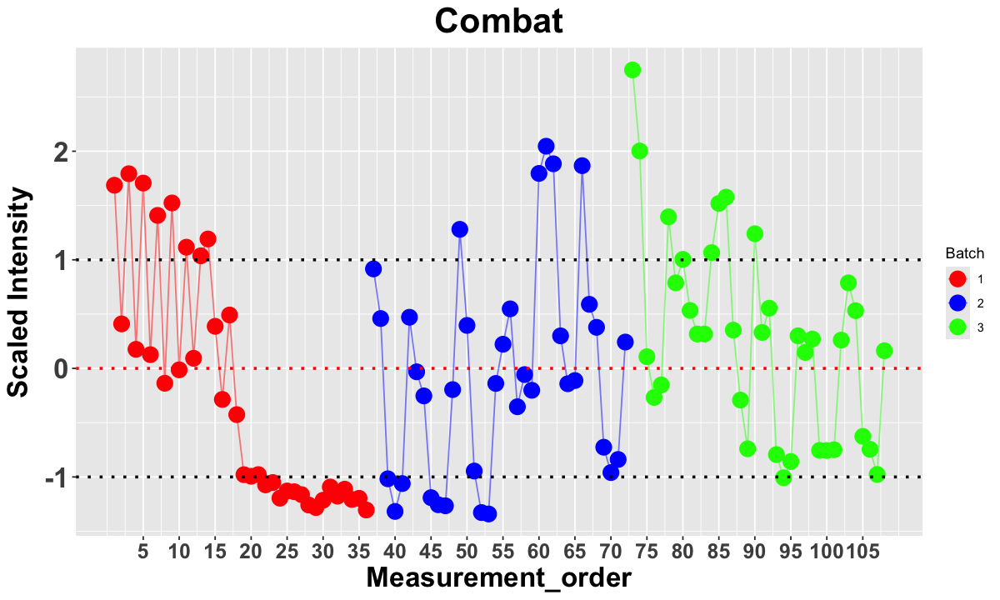

In [145]:
## Intensity Plot (Intensity vs Measurement Order ##
# Combat #

# function to extract only qcs
extract_qcs_data <- function(dataset, sample_set) {
  pattern <- paste(sample_set, collapse = "|")
  
  # Extract tissue rows
  tissue_rows <- grep(pattern, rownames(dataset))
  
  # Subset dataframe to exclude tissue rows
  qcs_data <- dataset[-tissue_rows, , drop = FALSE]
  
  return(qcs_data)
}
# reading combat dataset
combined_batch_info_data_combat <- read.csv("dataset_app/app_combat_interday_corrected_data.csv", #check file path
                                     header = TRUE,
                                     stringsAsFactors = FALSE,
                                     row.names = 1)

batch_info <- read.csv("input_app/app_batch_info_TIC.csv", #check file path
                       header = TRUE,
                       stringsAsFactors = FALSE)
                       
combined_batch_info_data_combat <- as.data.frame(t(combined_batch_info_data_combat)) 
combined_batch_info_data_combat <- cbind(batch_info[,-1], combined_batch_info_data_combat)  

qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data_combat, sample_set)
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

batch <- qcs_batch_info_data_ordered$batch
qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))
propranolol_intensity <- scale(propranolol_intensity_values)

plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = propranolol_intensity
)

mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired
# intensity plot with mean and standard deviation lines
library(ggplot2)
intensity_plot_combat_app <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) +  # Let the points be colored according to batch
  geom_line(aes(group = Batch), alpha = 0.5) +  # Add lines between points, grouped by Batch
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  # Add black dotted line for mean
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") +  # Set axis labels
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) +  # Set breaks for x-axis
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("Combat") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"),  # Center and bold the title
    axis.title.x = element_text(size = 20, face = "bold"),  # Adjust x-axis label size and make it bold
    axis.title.y = element_text(size = 20, face = "bold"),  # Adjust y-axis label size and make it bold
    axis.text.x = element_text(size = 15, face = "bold"),  # Adjust x-axis tick label size and make it bold
    axis.text.y = element_text(size = 20, face = "bold")  # Adjust y-axis tick label size and make it bold
  )
print(intensity_plot_combat_app)

In [146]:
## Intensity Plot (Intensity vs Measurement Order ##
# WaveICA #
# reading waveica dataset
combined_batch_info_data_combat <- as.data.frame(t(waveica_result_interday_app))

batch_info <- read.csv("input/app_batch_info_TIC.csv",
                       header = TRUE,
                       stringsAsFactors = FALSE)
                       
combined_batch_info_data_combat <- as.data.frame(t(combined_batch_info_data_combat)) #126 obs of 119 variables 
combined_batch_info_data_combat <- cbind(batch_info[,-1], combined_batch_info_data_combat)  

qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data_combat, sample_set)
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

batch <- qcs_batch_info_data_ordered$batch
qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))
propranolol_intensity <- scale(propranolol_intensity_values)

plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = propranolol_intensity
)
mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired
# intensity plot with mean and standard deviation lines
library(ggplot2)
intensity_plot_wave_app <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) +  # Let the points be colored according to batch
  geom_line(aes(group = Batch), alpha = 0.5) +  # Add lines between points, grouped by Batch
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  # Add black dotted line for mean
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") +  # Set axis labels
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) +  # Set breaks for x-axis
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("WaveICA") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"),  # Center and bold the title
    axis.title.x = element_text(size = 20, face = "bold"),  # Adjust x-axis label size and make it bold
    axis.title.y = element_text(size = 20, face = "bold"),  # Adjust y-axis label size and make it bold
    axis.text.x = element_text(size = 15, face = "bold"),  # Adjust x-axis tick label size and make it bold
    axis.text.y = element_text(size = 20, face = "bold")  # Adjust y-axis tick label size and make it bold
  )
print(intensity_plot_wave_app)

ERROR: Error in eval(expr, envir, enclos): 객체 'waveica_result_interday_app'를 찾을 수 없습니다


In [147]:
## Intensity Plot (Intensity vs Measurement Order ##
# NormAE #
combined_batch_info_data_combat <- read.csv("dataset/app_Rec_nobe_no_norm.csv",
                                            header = TRUE,
                                            stringsAsFactors = FALSE,
                                            row.names = 1) #119 x 126

batch_info <- read.csv("dataset/app_Ys.csv",
                       header = TRUE,
                       stringsAsFactors = FALSE)

batch_info$batch <- batch_info$batch + 1

combined_batch_info_data_combat <- as.data.frame(t(combined_batch_info_data_combat)) #126 x 119
combined_batch_info_data_combat <- cbind(batch_info[,(2:3)], combined_batch_info_data_combat)  

qcs_batch_info_data <- extract_qcs_data(combined_batch_info_data_combat, sample_set)
qcs_batch_info_data_ordered <- qcs_batch_info_data[order(qcs_batch_info_data$batch), ]

batch <- qcs_batch_info_data_ordered$batch
# intensity plot based on measurement_order
qcs_batch_info_data_ordered$measurement_order <- seq_len(nrow(qcs_batch_info_data_ordered))

propranolol_intensity <- qcs_batch_info_data_ordered[,colnames(qcs_batch_info_data_ordered) == propranolol_mz_value, drop = FALSE] # 126 obs 1 variable
propranolol_intensity_values <- as.numeric(unlist(propranolol_intensity))
propranolol_intensity <- scale(propranolol_intensity_values)

plot_data_scaled <- data.frame(
  Measurement_order = qcs_batch_info_data_ordered$measurement_order,
  Batch = qcs_batch_info_data_ordered$batch,
  Intensity = propranolol_intensity
)

mean_intensity <- mean(plot_data_scaled$Intensity)
sd_intensity <- sd(plot_data_scaled$Intensity)
batch_unique <- unique(plot_data_scaled$Batch)

# intensity plot
library(ggplot2)
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired
# intensity plot with mean and standard deviation lines
intensity_plot_norm_app <- ggplot(plot_data_scaled, aes(x = Measurement_order, y = Intensity, color = factor(Batch))) +
  geom_point(size = 5) +  # Let the points be colored according to batch
  geom_line(aes(group = Batch), alpha = 0.5) +  # Add lines between points, grouped by Batch
  geom_hline(yintercept = mean_intensity, linetype = "dotted", color = "red", linewidth = 1) +  # Add black dotted line for mean
  geom_hline(yintercept = mean_intensity + sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean + standard deviation
  geom_hline(yintercept = mean_intensity - sd_intensity, linetype = "dotted", color = "black", linewidth = 1) +  # Add gray dotted line for mean - standard deviation
  labs(x = "Measurement_order", y = "Scaled Intensity", color = "Batch") +  # Set axis labels
  scale_x_continuous(breaks = seq(5, max(plot_data_scaled$Measurement_order), by = 5)) +  # Set breaks for x-axis
  scale_color_manual(values = c("1" = "red", "2" = "blue", "3" = "green")) +  
  ggtitle("NormAE") +
  theme(
    plot.title = element_text(size = 25, hjust = 0.5, face = "bold"),  # Center and bold the title
    axis.title.x = element_text(size = 20, face = "bold"),  # Adjust x-axis label size and make it bold
    axis.title.y = element_text(size = 20, face = "bold"),  # Adjust y-axis label size and make it bold
    axis.text.x = element_text(size = 15, face = "bold"),  # Adjust x-axis tick label size and make it bold
    axis.text.y = element_text(size = 20, face = "bold")  # Adjust y-axis tick label size and make it bold
  )
print(intensity_plot_norm_app)

Warning message in file(file, "rt"):
“파일 'dataset/app_Rec_nobe_no_norm.csv'를 여는데 실패했습니다: No such file or directory”


ERROR: Error in file(file, "rt"): 커넥션을 열 수 없습니다


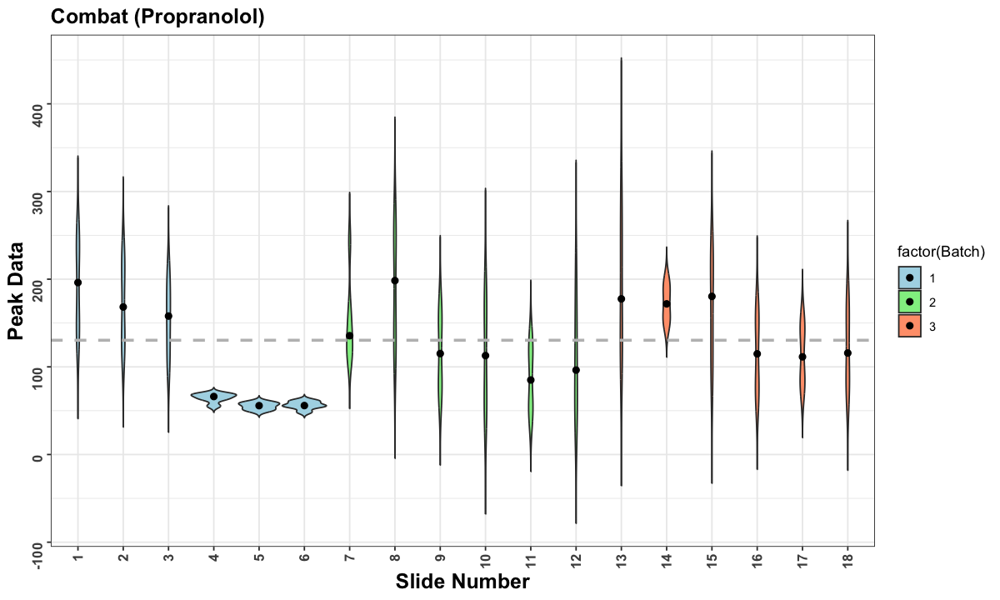

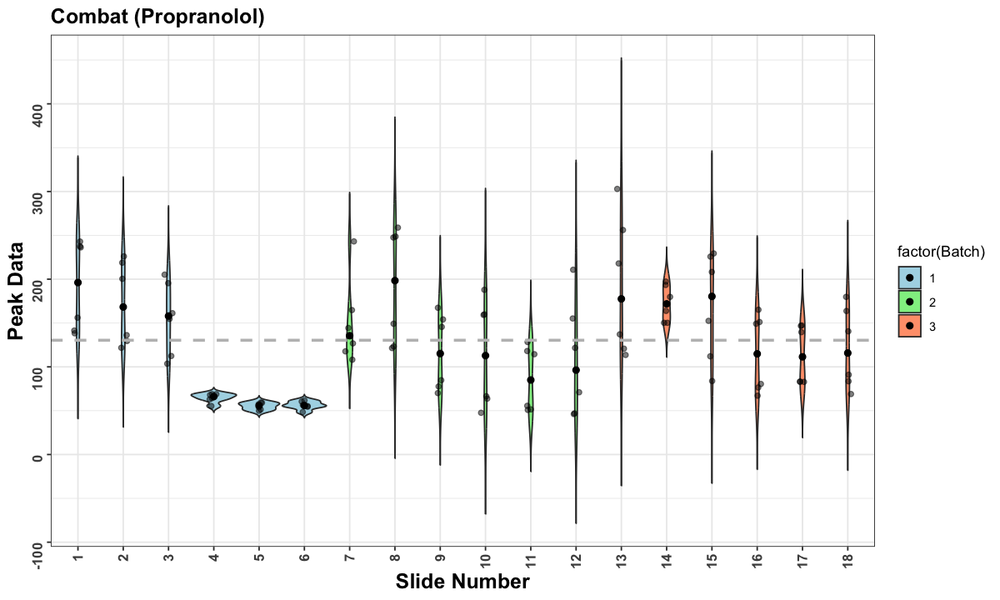

In [148]:
## Violin Plot for propranolol ##
# violin plot for propranolol combat
# Load required library
library(ggplot2)
library(dplyr)

propranolol_data_trans <- as.data.frame(t(propranolol_data_combat_app))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_combat <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data_combat$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_combat <- violin_data_combat %>%
  arrange(Slide)

# find mean of all samples
mean_value_combat <- mean(violin_data_combat$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_combat_app <- ggplot(violin_data_combat, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_combat, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "Combat (Propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_combat_app)

## Violin Plot with Jitter ##
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# combat #
violin_plot_combat_jit <- ggplot(violin_data_combat, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value_combat, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "Combat (Propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )
print(violin_plot_combat_jit)

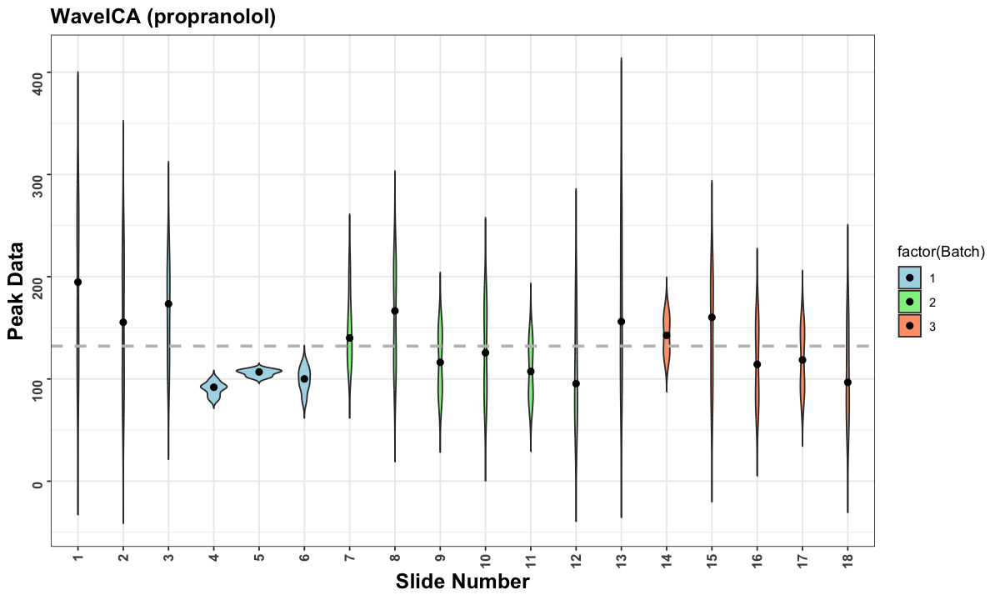

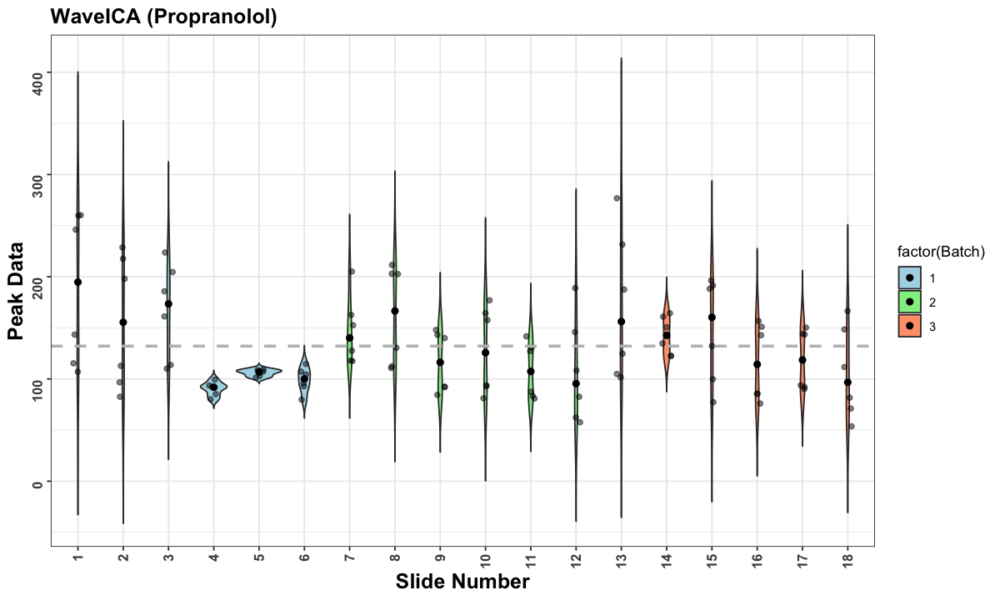

In [152]:
## Violin Plot for propranolol ##
# violin plot for propranolol Waveica
propranolol_data_trans <- as.data.frame(t(propranolol_data_wave_app))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_wave <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data_wave$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_wave <- violin_data_wave %>%
  arrange(Slide)

# find mean of all samples
mean_value_wave <- mean(violin_data$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_wave_app <- ggplot(violin_data_wave, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "WaveICA (propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_wave_app)

## Violin Plot with Jitter ##
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# combat #
violin_plot_wave_jit <- ggplot(violin_data_wave, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value_wave, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "WaveICA (Propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )
print(violin_plot_wave_jit)

In [151]:
## Violin Plot for propranolol ##
# violin plot for propranolol normae
propranolol_data_trans <- as.data.frame(t(propranolol_data_norm_app))
propranolol_data_trans[] <- lapply(propranolol_data_trans, as.numeric)

# Extract slide number
slide_number <- gsub("^.*S(\\d+)_.*", "\\1", names(propranolol_data_trans))
slide_number <- as.numeric(slide_number)

# Create violin plot data frame
violin_data_norm <- data.frame(
  Slide = slide_number,
  Batch = propranolol_data$batch,
  Value = unlist(propranolol_data_trans[3, ])
)

# Sort the data frame based on the Slide column
violin_data_norm <- violin_data_norm %>%
  arrange(Slide)

# find mean of all samples
mean_value_norm <- mean(violin_data_norm$Value)

# format the violin plot
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# Create a violin plot with adjusted width
violin_plot_norm_app <- ggplot(violin_data_norm, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_hline(yintercept = mean_value_norm, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "NormAE (propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )

# Display the violin plot
print(violin_plot_norm_app)

## Violin Plot with Jitter ##
options(repr.plot.width = 10, repr.plot.height = 6)  # Adjust width and height as desired

# combat #
violin_plot_norm_jit <- ggplot(violin_data_norm, aes(x = factor(Slide), y = Value, fill = factor(Batch))) +
  geom_violin(position = position_dodge(width = 0.5), trim = FALSE, width = 1) +
  stat_summary(fun = median, geom = "point", shape = 20, size = 3, color = "black") +
  geom_point(position = position_jitter(width = 0.1), alpha = 0.5) +  # Add jittered points
  geom_hline(yintercept = mean_value_norm, linetype = "dashed", color = "gray", linewidth = 1) +
  scale_fill_manual(values = c("1" = "#ADD8E6", "2" = "#90EE90", "3" = "#FFA07A")) +
  labs(x = "Slide Number", y = "Peak Data", title = "NormAE (Propranolol)") +
  theme_bw() +
  theme(
    axis.text.x = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.text.y = element_text(angle = 90, vjust = 0.5, hjust = 1, face = "bold"),
    axis.title = element_text(face = "bold", size = 15),  # Bold and increase size of axis titles
    plot.title = element_text(face = "bold", size = 15),  # Bold and increase size of plot title
    axis.text = element_text(size = 10)  # Increase size of axis values
  )
print(violin_plot_norm_jit)

ERROR: Error in eval(expr, envir, enclos): 객체 'propranolol_data_norm_app'를 찾을 수 없습니다


Total Score: 81.17 %

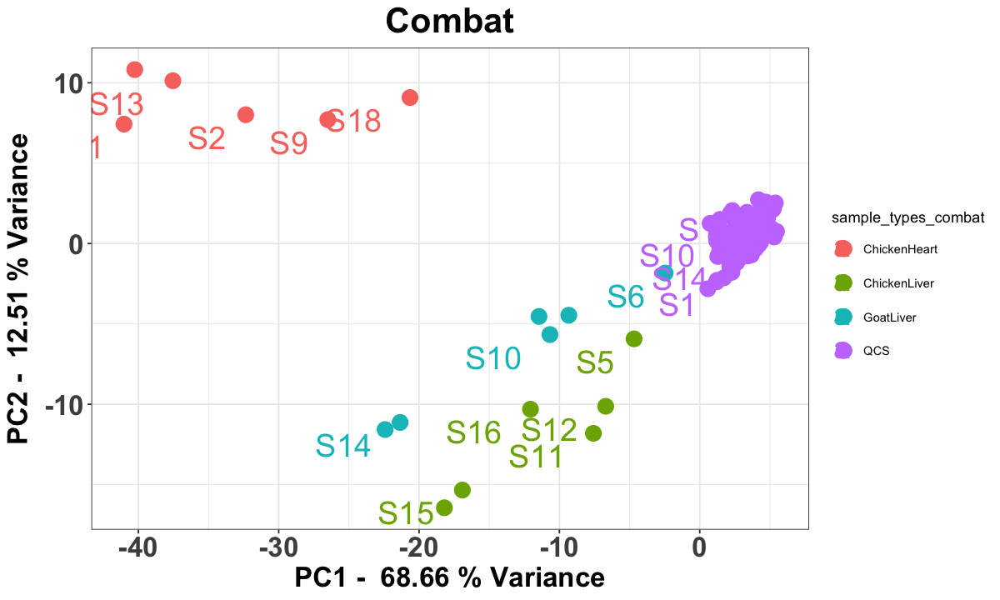

In [230]:
## PCA plot ##
# pca plot for combat
library(stringr)
options(repr.plot.width = 10, repr.plot.height = 6)  
adjusted <- read.csv("dataset_app/app_combat_interday_corrected_data.csv", # check file path
                     stringsAsFactors = FALSE,
                     row.names = 1)

batch_matrix <- data.frame(adjusted)
sample_ID <- str_extract(colnames(batch_matrix), "(S|m/z)\\d+")

# Create the regular expression pattern for sample_set
pattern <- paste(sample_set, collapse = "|")

# Extract sample types from column names using the defined pattern
sample_types_combat <- str_extract(colnames(batch_matrix), pattern)
sample_types_combat[is.na(sample_types_combat)] <- "QCS"

# Transpose the data so that samples are on rows and features on columns
batch_data_t <- t(as.matrix(batch_matrix))

# Create a new data frame with the transposed matrix
batch_data_t_df <- as.data.frame(batch_data_t)

# Perform PCA, assuming batch_data_t_df contains the transposed data
batch_pca_combat_app <- prcomp(batch_data_t_df, center = TRUE, scale. = TRUE)

# Create a data frame for plotting the PCA
pca_data_combat_app <- data.frame(Sample = sample_ID, batch_pca_combat_app$x)

# Plot PCA with colored sample dots based on sample type
pca_data_combat_app$Score <- pca_data_combat_app$PC1 + pca_data_combat_app$PC2
pca_data_combat_app$Type <- sample_types_combat

# Calculate the PC1 and PC2 scores
pc1_score <- batch_pca_combat_app$sdev[1]^2
pc2_score <- batch_pca_combat_app$sdev[2]^2

# Calculate the total score as the sum of PC1 and PC2 scores
total_score <- pc1_score + pc2_score

# Display the score 
total_score_text_recon <- paste("Total Score:", round(total_score / sum(batch_pca_combat_app$sdev^2) * 100, 2), "%")
cat(total_score_text_recon)

# Create PCA plot
plot_combat_app <- ggplot(pca_data_combat_app, aes(x = PC1, y = PC2, color = sample_types_combat, label = Sample)) +
  geom_point(size = 5) +
  geom_text(hjust = 1.5, vjust = 1.5, size = 8, check_overlap = TRUE) +  # Increased label size
  xlab(paste("PC1 - ", round(batch_pca_combat_app$sdev[1]^2 / sum(batch_pca_combat_app$sdev^2) * 100, 2), "% Variance")) +
  ylab(paste("PC2 - ", round(batch_pca_combat_app$sdev[2]^2 / sum(batch_pca_combat_app$sdev^2) * 100, 2), "% Variance")) +
  ggtitle("Combat") +
  theme_bw() +
  theme(legend.position = "right", axis.text = element_text(size = 20, face='bold'), 
        axis.title = element_text(size = 20, face='bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'))
print(plot_combat_app)

Total Score: 82.33 %

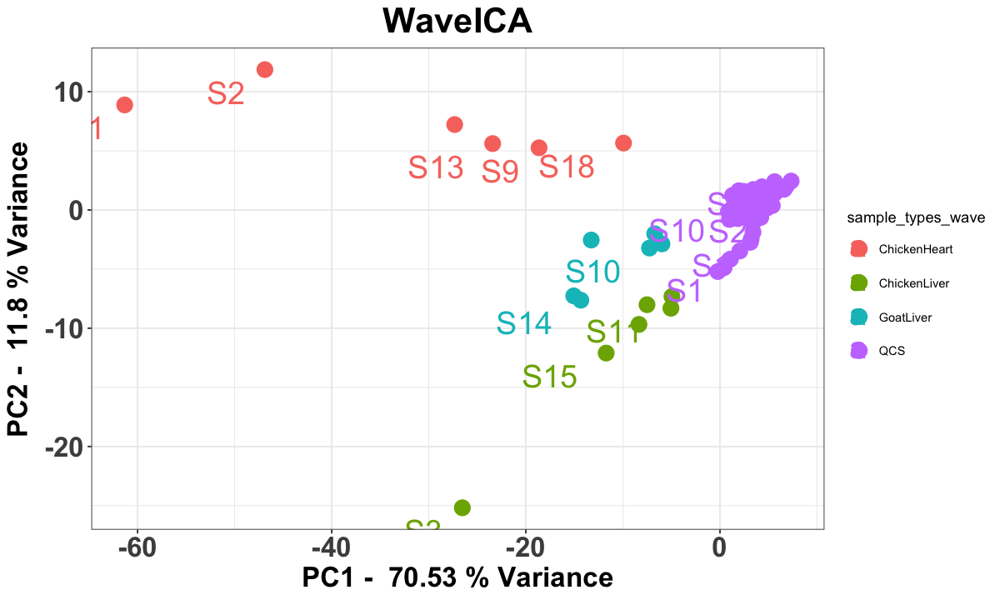

In [231]:
# pca plot for waveica
options(repr.plot.width = 10, repr.plot.height = 6)  
adjusted <- as.data.frame(t(waveica_result_interday_app))

batch_matrix <- data.frame(adjusted)
sample_ID <- str_extract(colnames(batch_matrix), "(S|m/z)\\d+")

# Create the regular expression pattern for sample_set
pattern <- paste(sample_set, collapse = "|")

# Extract sample types from column names using the defined pattern
sample_types_wave <- str_extract(colnames(batch_matrix), pattern)
sample_types_wave[is.na(sample_types_wave)] <- "QCS"

# Transpose the data so that samples are on rows and features on columns
batch_data_t <- t(as.matrix(batch_matrix))

# Create a new data frame with the transposed matrix
batch_data_t_df <- as.data.frame(batch_data_t)

# Perform PCA, assuming batch_data_t_df contains the transposed data
batch_pca_wave_app <- prcomp(batch_data_t_df, center = TRUE, scale. = TRUE)

# Create a data frame for plotting the PCA
pca_data_wave_app <- data.frame(Sample = sample_ID, batch_pca_wave_app$x)

# Plot PCA with colored sample dots based on sample type
pca_data_wave_app$Score <- pca_data_wave_app$PC1 + pca_data_wave_app$PC2
pca_data_wave_app$Type <- sample_types_wave

# Calculate the PC1 and PC2 scores
pc1_score <- batch_pca_wave_app$sdev[1]^2
pc2_score <- batch_pca_wave_app$sdev[2]^2

# Calculate the total score as the sum of PC1 and PC2 scores
total_score <- pc1_score + pc2_score

# Display the score 
total_score_text_recon <- paste("Total Score:", round(total_score / sum(batch_pca_wave_app$sdev^2) * 100, 2), "%")
cat(total_score_text_recon)

# Create PCA plot
plot_wave_app <- ggplot(pca_data_wave_app, aes(x = PC1, y = PC2, color = sample_types_wave, label = Sample)) +
  geom_point(size = 5) +
  geom_text(hjust = 1.5, vjust = 1.5, size = 8, check_overlap = TRUE) +  # Increased label size
  xlab(paste("PC1 - ", round(batch_pca_wave_app$sdev[1]^2 / sum(batch_pca_wave_app$sdev^2) * 100, 2), "% Variance")) +
  ylab(paste("PC2 - ", round(batch_pca_wave_app$sdev[2]^2 / sum(batch_pca_wave_app$sdev^2) * 100, 2), "% Variance")) +
  ggtitle("WaveICA") +
  theme_bw() +
  theme(legend.position = "right", axis.text = element_text(size = 20, face='bold'), 
        axis.title = element_text(size = 20, face='bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'))
print(plot_wave_app)

In [232]:
# pca plot for normae

options(repr.plot.width = 10, repr.plot.height = 6)
adjusted <- read.csv("dataset_app/app_Rec_nobe_no_norm.csv", #check file path
                     header = TRUE,
                     stringsAsFactors = FALSE)
adjusted <- adjusted[, -1]

batch_matrix <- data.frame(adjusted)
sample_ID <- str_extract(colnames(batch_matrix), "(S|m/z)\\d+")

# Create the regular expression pattern for sample_set
pattern <- paste(sample_set, collapse = "|")

# Extract sample types from column names using the defined pattern
sample_types_norm <- str_extract(colnames(batch_matrix), pattern)
sample_types_norm[is.na(sample_types_norm)] <- "QCS"

# Transpose the data so that samples are on rows and features on columns
batch_data_t <- t(as.matrix(batch_matrix))

# Create a new data frame with the transposed matrix
batch_data_t_df <- as.data.frame(batch_data_t)

# Perform PCA, assuming batch_data_t_df contains the transposed data
batch_pca_norm_app <- prcomp(batch_data_t_df, center = TRUE, scale. = TRUE)

# Create a data frame for plotting the PCA
pca_data_norm_app <- data.frame(Sample = sample_ID, batch_pca_norm_app$x)

# Plot PCA with colored sample dots based on sample type
pca_data_norm_app$Score <- pca_data_norm_app$PC1 + pca_data_norm_app$PC2
pca_data_norm_app$Type <- sample_types_norm

# Calculate the PC1 and PC2 scores
pc1_score <- batch_pca_norm_app$sdev[1]^2
pc2_score <- batch_pca_norm_app$sdev[2]^2

# Calculate the total score as the sum of PC1 and PC2 scores
total_score <- pc1_score + pc2_score

# Display the score 
total_score_text_recon <- paste("Total Score:", round(total_score / sum(batch_pca_norm_app$sdev^2) * 100, 2), "%")
cat(total_score_text_recon)

# Create PCA plot
plot_norm_app <- ggplot(pca_data_norm_app, aes(x = PC1, y = PC2, color = sample_types_norm, label = Sample)) +
  geom_point(size = 5) +
  geom_text(hjust = 1.5, vjust = 1.5, size = 8, check_overlap = TRUE) +  # Increased label size
  xlab(paste("PC1 - ", round(batch_pca_norm_app$sdev[1]^2 / sum(batch_pca_norm_app$sdev^2) * 100, 2), "% Variance")) +
  ylab(paste("PC2 - ", round(batch_pca_norm_app$sdev[2]^2 / sum(batch_pca_norm_app$sdev^2) * 100, 2), "% Variance")) +
  ggtitle("NormAE") +
  theme_bw() +
  theme(legend.position = "right", axis.text = element_text(size = 20, face='bold'), 
        axis.title = element_text(size = 20, face='bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'))
print(plot_norm_app)

Warning message in file(file, "rt"):
“파일 'dataset_app/app_Rec_nobe_no_norm.csv'를 여는데 실패했습니다: No such file or directory”


ERROR: Error in file(file, "rt"): 커넥션을 열 수 없습니다


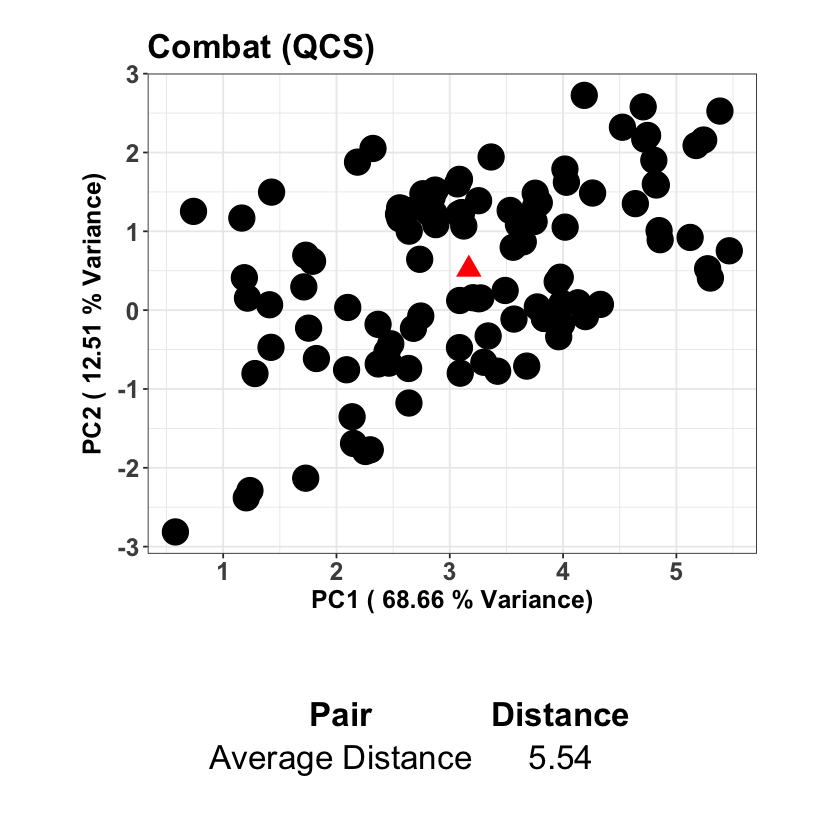

In [233]:
## QCS PCA Plot ##
# combat
# Load necessary libraries
library(ggplot2)
library(ggrepel)
library(cowplot)
library(gridExtra)

# gets rid of plot format
options(repr.plot.width = NULL, repr.plot.height = NULL)

# Calculate PCA scores
pca_scores <- batch_pca_combat_app$x

# Identify QCS samples based on sample types
qcs_samples <- which(sample_types_combat == "QCS")

# Extract PCA scores for QCS samples
qcs_scores <- pca_scores[qcs_samples, ]

# Compute the centroid of QCS samples
qcs_centroid <- colMeans(qcs_scores)

# Calculate PC1 and PC2 variances
pc1_variance <- round(batch_pca_combat_app$sdev[1]^2 / sum(batch_pca_combat_app$sdev^2) * 100, 2)
pc2_variance <- round(batch_pca_combat_app$sdev[2]^2 / sum(batch_pca_combat_app$sdev^2) * 100, 2)

# Plot PCA plot with QCS samples and their centroid
pca_plot_qcs_combat_app <- ggplot(data.frame(PC1 = qcs_scores[,1], PC2 = qcs_scores[,2]), aes(x = PC1, y = PC2)) +
  geom_point(size = 7) +  # Plot QCS samples
  geom_point(data = data.frame(PC1 = qcs_centroid[1], PC2 = qcs_centroid[2]), aes(x = PC1, y = PC2), shape = 17, fill = "red", color = "red", size = 5) +  # Plot centroid as triangle with filled red color
  labs(x = paste("PC1 (", pc1_variance, "% Variance)"), y = paste("PC2 (", pc2_variance, "% Variance)"), title = "Combat (QCS)") +
  theme_bw() +
  theme(axis.title.x = element_text(face = "bold", size = 15),
        axis.title.y = element_text(face = "bold", size = 15),
        axis.text = element_text(size = 15, face = "bold"),
        plot.margin = margin(20, 50, 10, 50),  # Adjust the bottom margin to 10 units
        plot.title = element_text(face = "bold", size = 20))  # Make the plot title bold and size 20

# Calculate average distance of QCS samples from the centroid
qcs_centroid_distances <- sqrt(rowSums((qcs_scores - qcs_centroid)^2))
average_qcs_distance_combat_app <- mean(qcs_centroid_distances)

# Create a data frame for average distance
average_distance_qcs_df_combat <- data.frame(
  Pair = "Average Distance",
  Distance = average_qcs_distance_combat_app
)

# Round distances for better presentation
average_distance_qcs_df_combat$Distance <- round(average_distance_qcs_df_combat$Distance, 2)

# Create a table plot
table_plot_qcs <- tableGrob(average_distance_qcs_df_combat, theme = ttheme_minimal(base_size = 20), rows = NULL)

# Combine the PCA plot and the table
combined_plot_combat_qcs_app <- plot_grid(pca_plot_qcs_combat_app, table_plot_qcs, ncol = 1, align = "v", axis = "lr", rel_heights = c(3, 1))

# Print the combined plot
print(combined_plot_combat_qcs_app)

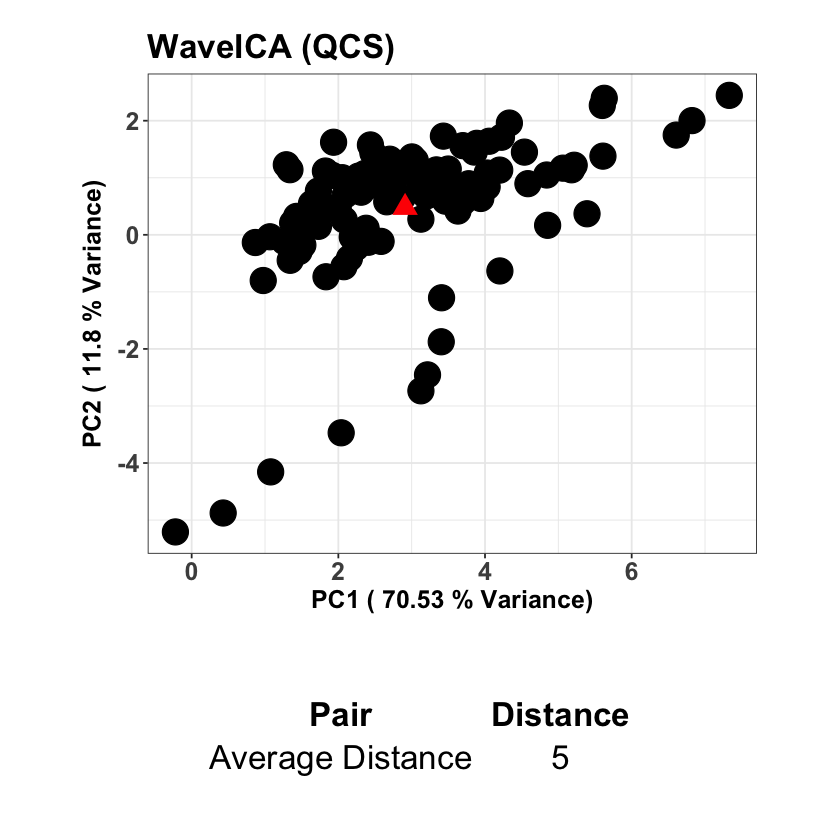

In [234]:
# waveica
## PCA plot of QCS ##
# Load necessary libraries
library(ggplot2)
library(ggrepel)
library(cowplot)
library(gridExtra)

# gets rid of plot format
options(repr.plot.width = NULL, repr.plot.height = NULL)

# Calculate PCA scores
pca_scores <- batch_pca_wave_app$x

# Identify QCS samples based on sample types
qcs_samples <- which(sample_types_wave == "QCS")

# Extract PCA scores for QCS samples
qcs_scores <- pca_scores[qcs_samples, ]

# Compute the centroid of QCS samples
qcs_centroid <- colMeans(qcs_scores)

# Calculate PC1 and PC2 variances
pc1_variance <- round(batch_pca_wave_app$sdev[1]^2 / sum(batch_pca_wave_app$sdev^2) * 100, 2)
pc2_variance <- round(batch_pca_wave_app$sdev[2]^2 / sum(batch_pca_wave_app$sdev^2) * 100, 2)

# Plot PCA plot with QCS samples and their centroid
pca_plot_qcs_wave <- ggplot(data.frame(PC1 = qcs_scores[,1], PC2 = qcs_scores[,2]), aes(x = PC1, y = PC2)) +
  geom_point(size = 7) +  # Plot QCS samples
  geom_point(data = data.frame(PC1 = qcs_centroid[1], PC2 = qcs_centroid[2]), aes(x = PC1, y = PC2), shape = 17, fill = "red", color = "red", size = 5) +  # Plot centroid as triangle with filled red color
  labs(x = paste("PC1 (", pc1_variance, "% Variance)"), y = paste("PC2 (", pc2_variance, "% Variance)"), title = "WaveICA (QCS)") +
  theme_bw() +
  theme(axis.title.x = element_text(face = "bold", size = 15),
        axis.title.y = element_text(face = "bold", size = 15),
        axis.text = element_text(size = 15, face = "bold"),
        plot.margin = margin(20, 50, 10, 50),  # Adjust the bottom margin to 10 units
        plot.title = element_text(face = "bold", size = 20))  # Make the plot title bold and size 20

# Calculate average distance of QCS samples from the centroid
qcs_centroid_distances <- sqrt(rowSums((qcs_scores - qcs_centroid)^2))
average_qcs_distance_wave_app <- mean(qcs_centroid_distances)

# Create a data frame for average distance
average_distance_qcs_df_wave <- data.frame(
  Pair = "Average Distance",
  Distance = average_qcs_distance_wave_app
)

# Round distances for better presentation
average_distance_qcs_df_wave$Distance <- round(average_distance_qcs_df_wave$Distance, 2)

# Create a table plot
table_plot_qcs <- tableGrob(average_distance_qcs_df_wave, theme = ttheme_minimal(base_size = 20), rows = NULL)

# Combine the PCA plot and the table
combined_plot_wave_qcs_app <- plot_grid(pca_plot_qcs_wave, table_plot_qcs, ncol = 1, align = "v", axis = "lr", rel_heights = c(3, 1))

# Print the combined plot
print(combined_plot_wave_qcs_app)

In [235]:
# normae
## PCA plot of QCS ##
# no normalization raw data
# Load necessary libraries
library(ggplot2)
library(ggrepel)
library(cowplot)
library(gridExtra)

# gets rid of plot format
options(repr.plot.width = NULL, repr.plot.height = NULL)

# Calculate PCA scores
pca_scores <- batch_pca_norm_app$x

# Identify QCS samples based on sample types
qcs_samples <- which(sample_types_norm == "QCS")

# Extract PCA scores for QCS samples
qcs_scores <- pca_scores[qcs_samples, ]

# Compute the centroid of QCS samples
qcs_centroid <- colMeans(qcs_scores)

# Calculate PC1 and PC2 variances
pc1_variance <- round(batch_pca_norm_app$sdev[1]^2 / sum(batch_pca_norm_app$sdev^2) * 100, 2)
pc2_variance <- round(batch_pca_norm_app$sdev[2]^2 / sum(batch_pca_norm_app$sdev^2) * 100, 2)

# Plot PCA plot with QCS samples and their centroid
pca_plot_qcs_norm <- ggplot(data.frame(PC1 = qcs_scores[,1], PC2 = qcs_scores[,2]), aes(x = PC1, y = PC2)) +
  geom_point(size = 7) +  # Plot QCS samples
  geom_point(data = data.frame(PC1 = qcs_centroid[1], PC2 = qcs_centroid[2]), aes(x = PC1, y = PC2), shape = 17, fill = "red", color = "red", size = 5) +  # Plot centroid as triangle with filled red color
  labs(x = paste("PC1 (", pc1_variance, "% Variance)"), y = paste("PC2 (", pc2_variance, "% Variance)"), title = "NormAE (QCS)") +
  theme_bw() +
  theme(axis.title.x = element_text(face = "bold", size = 15),
        axis.title.y = element_text(face = "bold", size = 15),
        axis.text = element_text(size = 15, face = "bold"),
        plot.margin = margin(20, 50, 10, 50),  # Adjust the bottom margin to 10 units
        plot.title = element_text(face = "bold", size = 20))  # Make the plot title bold and size 20

# Calculate average distance of QCS samples from the centroid
qcs_centroid_distances <- sqrt(rowSums((qcs_scores - qcs_centroid)^2))
average_qcs_distance_norm_app <- mean(qcs_centroid_distances)

# Create a data frame for average distance
average_distance_qcs_df_norm <- data.frame(
  Pair = "Average Distance",
  Distance = average_qcs_distance_norm_app
)

# Round distances for better presentation
average_distance_qcs_df_norm$Distance <- round(average_distance_qcs_df_norm$Distance, 2)

# Create a table plot
table_plot_qcs <- tableGrob(average_distance_qcs_df_norm, theme = ttheme_minimal(base_size = 20), rows = NULL)

# Combine the PCA plot and the table
combined_plot_norm_qcs_app <- plot_grid(pca_plot_qcs_norm, table_plot_qcs, ncol = 1, align = "v", axis = "lr", rel_heights = c(3, 1))

# Print the combined plot
print(combined_plot_norm_qcs_app)

ERROR: Error in eval(expr, envir, enclos): 객체 'batch_pca_norm_app'를 찾을 수 없습니다


In [236]:
## Calculate QCS eucleadan distance ##
# Combat 
qcs_indices <- which(pca_data_combat_app$Type == "QCS") # 108
pca_scores_qcs <- pca_data_combat_app[qcs_indices, -which(names(pca_data_combat_app) == "Score")]
numeric_cols <- sapply(pca_scores_qcs, is.numeric)
pca_scores_numeric <- pca_scores_qcs[, numeric_cols]

# calculate euclidean distance
euclidean_distances <- dist(pca_scores_numeric)
average_distance_ec_combat_app <- mean(euclidean_distances)
cat("Average QCS distance for Combat normalization is", average_distance_ec_combat_app, "\n")

Average QCS distance for Combat normalization is 5.104181 


In [237]:
## Calculate QCS eucleadan distance ##
# WaveICA
qcs_indices <- which(pca_data_wave_app$Type == "QCS") # 108
pca_scores_qcs <- pca_data_wave_app[qcs_indices, -which(names(pca_data_wave_app) == "Score")]
numeric_cols <- sapply(pca_scores_qcs, is.numeric)
pca_scores_numeric <- pca_scores_qcs[, numeric_cols]

# calculate euclidean distance
euclidean_distances <- dist(pca_scores_numeric)
average_distance_ec_wave_app <- mean(euclidean_distances)
cat("Average QCS distance for WaveICA normalization is", average_distance_ec_wave_app, "\n")

Average QCS distance for WaveICA normalization is 4.644119 


In [238]:
## Calculate QCS eucleadan distance ##
# NormAE
qcs_indices <- which(pca_data_norm_app$Type == "QCS") # 108
pca_scores_qcs <- pca_data_norm_app[qcs_indices, -which(names(pca_data_norm_app) == "Score")]
numeric_cols <- sapply(pca_scores_qcs, is.numeric)
pca_scores_numeric <- pca_scores_qcs[, numeric_cols]

# calculate euclidean distance
euclidean_distances <- dist(pca_scores_numeric)
average_distance_ec_norm_app <- mean(euclidean_distances)
cat("Average QCS distance for Norm normalization is", average_distance_ec_norm_app, "\n")

ERROR: Error in eval(expr, envir, enclos): 객체 'pca_data_norm_app'를 찾을 수 없습니다


In [239]:
## Tissue RSD Table ##
## Tissue Variation RSD Combat ##
## QCS RSD Calculation ## combat
data <- read.csv("dataset_app/app_combat_interday_corrected_data.csv", #check file path
                 header = TRUE,
                 stringsAsFactors = FALSE,
                 row.names = 1) 
row_names <- rownames(data)
batch_info_norm <- read.csv("input_app/app_batch_info_TIC.csv", #check file path
                            header = TRUE,
                            stringsAsFactors = FALSE)
injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data) # 128 obs of 119
new_row_names <- c("injection_order", "batch", row_names) #128 of 119 
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))
sample_set <- c("ChickenHeart", "ChickenLiver", "GoatLiver")
sample_set_regex <- paste(sample_set, collapse = "|")
sample_set_rows <- grep(sample_set_regex, rownames(transposed_data)) #126 obs of 121 variables
tissue_samples <- transposed_data[sample_set_rows,]
row_names <- rownames(tissue_samples)
tissue_samples <- as.data.frame(apply(tissue_samples, 2, as.numeric))
rownames(tissue_samples) <- row_names

# Function to calculate rsd for tissue
calculate_batch_rsd_combined <- function(tissue_samples) {
  # Function to calculate batch RSD for a given tissue dataset
  calculate_batch_rsd <- function(sample_dataset, batch_number) {
    # Extract data for the specified batch number
    batch_data <- sample_dataset[sample_dataset$batch == batch_number, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(batch_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(batch_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate interday RSD for a given tissue dataset
  calculate_interday_rsd <- function(sample_dataset) {
    # Extract data for interday calculation
    interday_data <- sample_dataset[, -(1:2)]
    
    # Calculate mean and standard deviation for each analyte
    means <- apply(interday_data, 2, mean, na.rm = TRUE)
    std_devs <- apply(interday_data, 2, sd, na.rm = TRUE)
    
    # Calculate RSD
    rsd <- (std_devs / means) * 100
    
    # Calculate mean RSD and standard deviation of RSD
    mean_rsd <- mean(rsd)
    std_rsd <- sd(rsd)
    
    # Format the results
    rsd_formatted <- sprintf("%.2f ± %.2f%%", mean_rsd, std_rsd)
    
    # Return the formatted RSD
    return(rsd_formatted)
  }
  
  # Function to calculate batch RSD for multiple batches
  calculate_batch_rsd_multiple <- function(sample_dataset, unique_batches) {
    rsd_results <- list()
    for (batch_number in unique_batches) {
      rsd_results[[as.character(batch_number)]] <- calculate_batch_rsd(sample_dataset, batch_number)
    }
    return(rsd_results)
  }
  
  # Extract unique tissue sample datasets for each tissue type
  unique_tissues <- unique(gsub(".*_(\\w+)_\\d+.*", "\\1", rownames(tissue_samples)))
  
  # Initialize list to store results for each tissue type
  rsd_results <- list()
  
  # Loop through each tissue type
  for (tissue_type in unique_tissues) {
    # Filter tissue samples for the current tissue type
    tissue_data <- tissue_samples[grep(paste0(tissue_type, "_"), rownames(tissue_samples)), ]
    
    # Order the dataset based on s_value
    sample_numbers <- as.numeric(gsub(".*S(\\d+)_.*", "\\1", rownames(tissue_data)))
    ordered_indices <- order(sample_numbers)
    tissue_data <- tissue_data[ordered_indices, ]
    
    # Replace negative values with 1
    tissue_data <- replace(tissue_data, tissue_data < 0, 1)
    
    # Calculate batch RSD for unique batches
    unique_batches <- unique(tissue_data$batch)
    rsd_results_tissue <- calculate_batch_rsd_multiple(tissue_data, unique_batches)
    
    # Calculate interday RSD
    interday_rsd <- calculate_interday_rsd(tissue_data)
    
    # Combine batch and interday RSD results into a data frame
    rsd_df_tissue <- data.frame(
      Batch = names(rsd_results_tissue),
      RSD = unlist(rsd_results_tissue)
    )
    rsd_df_tissue <- rbind(rsd_df_tissue, c("Interday", interday_rsd))
    rownames(rsd_df_tissue) <- NULL
    
    # Alter batch names to Intraday 1, Intraday 2, etc.
    batch_names <- c("Intraday 1", "Intraday 2", "Intraday 3")
    rsd_df_tissue$Batch <- ifelse(rsd_df_tissue$Batch == "Interday", "Interday", batch_names)
    
    # Store results for the current tissue type
    rsd_results[[tissue_type]] <- rsd_df_tissue
  }
  
  return(rsd_results)
}

rsd_results_combined_combat_app <- calculate_batch_rsd_combined(tissue_samples)

# Assuming rsd_results_combined is the output of calculate_batch_rsd_combined

library(kableExtra)
library(IRdisplay)

# Create a function to generate HTML tables for each tissue
generate_rsd_table <- function(rsd_results, tissue_name) {
  rsd_df <- rsd_results[[tissue_name]]
  kable(rsd_df, format = "html", row.names = FALSE) %>%
    kable_styling(full_width = FALSE)
}

# Generate HTML tables for each tissue
html_tables_combat <- lapply(names(rsd_results_combined_combat_app), function(tissue_name) {
  rsd_table <- generate_rsd_table(rsd_results_combined_combat_app, tissue_name)
  table_name <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>", sep = "")
  paste("<div style='display: inline-block; margin-right: 20px; text-align: center;'>", table_name, as.character(rsd_table), "</div>")
})

# Combine HTML tables into a single string
html_content_combat <- paste(html_tables_combat, collapse = "")

# Wrap the combined HTML content in a div with text-align: center
centered_html_content_combat <- paste("<div style='text-align: center;'>", html_content_combat, "</div>")

# Display the centered HTML content in JupyterLab
display_html(centered_html_content_combat)

Batch,RSD
Intraday 1,24.28 ± 9.46%
Intraday 2,29.43 ± 11.32%
Intraday 3,26.52 ± 13.12%
Interday,32.36 ± 13.80%
Batch,RSD
Intraday 1,37.52 ± 11.68%
Intraday 2,7.94 ± 6.32%
Intraday 3,12.53 ± 7.85%
Interday,27.61 ± 15.82%
Batch,RSD


In [240]:
## Tissue Variation RSD WaveICA ##
data <- as.data.frame(t(waveica_result_interday_app))  
row_names <- rownames(data)
batch_info_norm <- read.csv("input_app/app_batch_info_TIC.csv",  #check file path
                            header = TRUE,
                            stringsAsFactors = FALSE)

injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data)
new_row_names <- c("injection_order", "batch", row_names)
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))
sample_set_regex <- paste(sample_set, collapse = "|")
sample_set_rows <- grep(sample_set_regex, rownames(transposed_data)) #126 obs of 121 variables
tissue_samples <- transposed_data[sample_set_rows,]
row_names <- rownames(tissue_samples)
tissue_samples <- as.data.frame(apply(tissue_samples, 2, as.numeric))
rownames(tissue_samples) <- row_names

# run function
rsd_results_combined_wave_app <- calculate_batch_rsd_combined(tissue_samples)

# generate RSD table as html
library(kableExtra)
library(IRdisplay)

# Create a function to generate HTML tables for each tissue
generate_rsd_table <- function(rsd_results, tissue_name) {
  rsd_df <- rsd_results[[tissue_name]]
  kable(rsd_df, format = "html", row.names = FALSE) %>%
    kable_styling(full_width = FALSE)
}

# Generate HTML tables for each tissue
html_tables_wave <- lapply(names(rsd_results_combined_wave_app), function(tissue_name) {
  rsd_table <- generate_rsd_table(rsd_results_combined_wave_app, tissue_name)
  table_name <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>", sep = "")
  paste("<div style='display: inline-block; margin-right: 20px; text-align: center;'>", table_name, as.character(rsd_table), "</div>")
})

# Combine HTML tables into a single string
html_content_wave <- paste(html_tables_wave, collapse = "")

# Wrap the combined HTML content in a div with text-align: center
centered_html_content_wave <- paste("<div style='text-align: center;'>", html_content_wave, "</div>")

# Display the centered HTML content in JupyterLab
display_html(centered_html_content_wave)

Batch,RSD
Intraday 1,19.80 ± 16.86%
Intraday 2,20.09 ± 7.10%
Intraday 3,24.38 ± 15.86%
Interday,21.80 ± 11.00%
Batch,RSD
Intraday 1,38.82 ± 17.58%
Intraday 2,5.21 ± 4.62%
Intraday 3,12.32 ± 14.21%
Interday,31.97 ± 14.76%
Batch,RSD


In [241]:
## Tissue Variation RSD NormAE ##

## QCS RSD Table ## NormAE
data <- read.csv("dataset_app/app_Rec_nobe_no_norm.csv", #check file path
                 header = TRUE,
                 stringsAsFactors = FALSE)
row_names <- data[,1]
rownames(data) <- row_names
data <- data[, -1]

batch_info_norm <- read.csv("dataset_app/app_Ys.csv", #check file path
                            header = TRUE,
                            stringsAsFactors = FALSE)

injection_order_norm <- batch_info_norm$injection.order
batch_norm <- batch_info_norm$batch

# add injection_order and batch_info
new_data <- rbind(injection_order_norm, batch_norm, data)
new_row_names <- c("injection_order", "batch", row_names)
rownames(new_data) <- new_row_names

# Transpose the data
transposed_data <- as.data.frame(t(new_data))
sample_set_regex <- paste(sample_set, collapse = "|")
sample_set_rows <- grep(sample_set_regex, rownames(transposed_data)) #126 obs of 121 variables
tissue_samples <- transposed_data[sample_set_rows,]
row_names <- rownames(tissue_samples)
tissue_samples <- as.data.frame(apply(tissue_samples, 2, as.numeric))
rownames(tissue_samples) <- row_names

# run function
rsd_results_combined_norm_app <- calculate_batch_rsd_combined(tissue_samples)

# generate RSD table as html
library(kableExtra)
library(IRdisplay)

# Create a function to generate HTML tables for each tissue
generate_rsd_table <- function(rsd_results, tissue_name) {
  rsd_df <- rsd_results[[tissue_name]]
  kable(rsd_df, format = "html", row.names = FALSE) %>%
    kable_styling(full_width = FALSE)
}

# Generate HTML tables for each tissue
html_tables_norm <- lapply(names(rsd_results_combined_norm_app), function(tissue_name) {
  rsd_table <- generate_rsd_table(rsd_results_combined_norm_app, tissue_name)
  table_name <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>", sep = "")
  paste("<div style='display: inline-block; margin-right: 20px; text-align: center;'>", table_name, as.character(rsd_table), "</div>")
})

# Combine HTML tables into a single string
html_content_norm <- paste(html_tables_norm, collapse = "")

# Wrap the combined HTML content in a div with text-align: center
centered_html_content_norm <- paste("<div style='text-align: center;'>", html_content_norm, "</div>")

# Display the centered HTML content in JupyterLab
display_html(centered_html_content_norm)

Warning message in file(file, "rt"):
“파일 'dataset_app/app_Rec_nobe_no_norm.csv'를 여는데 실패했습니다: No such file or directory”


ERROR: Error in file(file, "rt"): 커넥션을 열 수 없습니다


TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


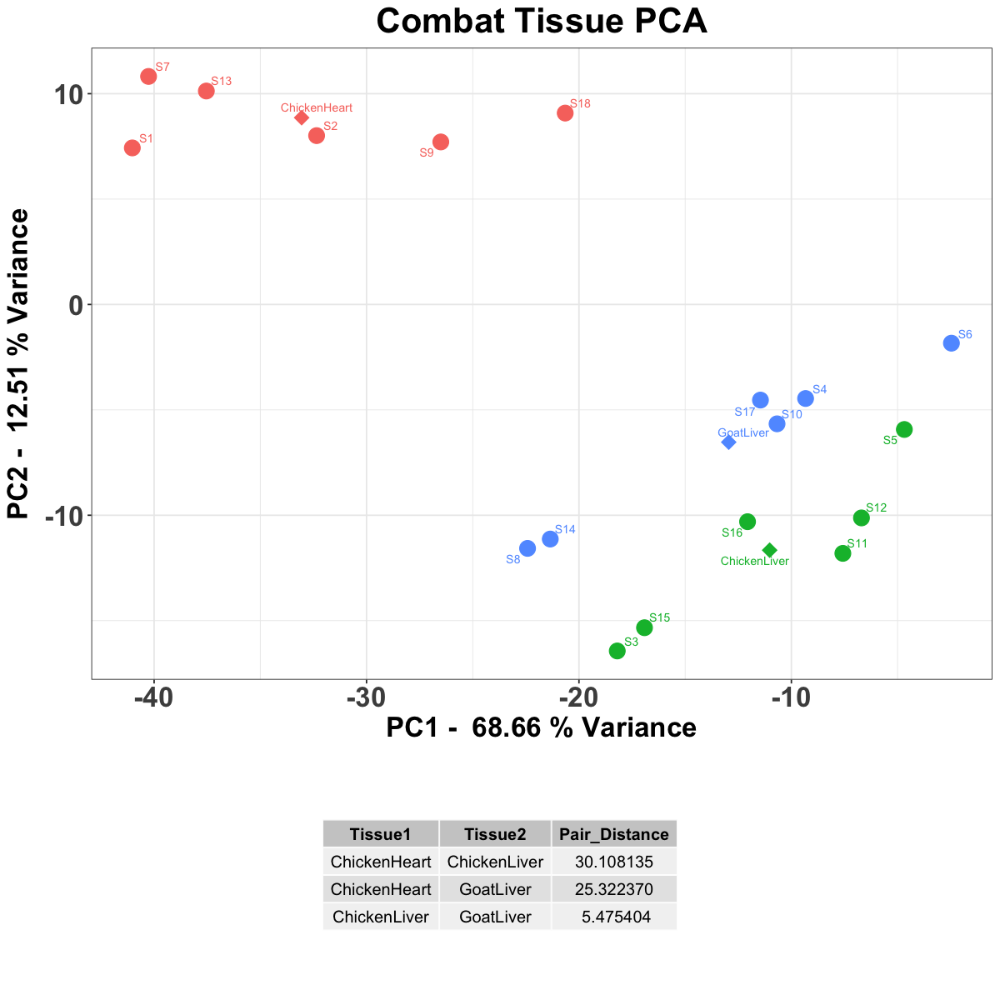

In [242]:
## Tissue PCA Plot Intergroup ##
# Combat #
## Tissue with centroid PCA plot intergroup no norm ##
library(ggplot2)
library(dplyr)
library(ggrepel)
library(gridExtra)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_combat_app %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Plot tissue-only PCA with centroids, data point labels, and axis labels
tissue_plot <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  # Using geom_text_repel to prevent label overlap
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  # Add labels for data points without overlap
  labs(title = "Combat Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_combat_app$sdev[1]^2 / sum(batch_pca_combat_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_combat_app$sdev[2]^2 / sum(batch_pca_combat_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# calculate intergroup distance #
# Create a data frame to store pairwise distances and tissue types
# Generate all possible combinations of tissue types
tissue_combinations <- combn(unique(centroids$Type), 2, simplify = TRUE)

# Initialize an empty data frame to store pairwise distances
centroid_distances_df_combat_app <- data.frame(Tissue1 = character(), Tissue2 = character(), Pair_Distance = numeric())

# Iterate over each pair of tissue combinations
for (i in 1:ncol(tissue_combinations)) {
  tissue_pair <- tissue_combinations[, i]
  centroid1 <- centroids %>% filter(Type == tissue_pair[1])
  centroid2 <- centroids %>% filter(Type == tissue_pair[2])
  distance <- sqrt((centroid1$Centroid_PC1 - centroid2$Centroid_PC1)^2 + (centroid1$Centroid_PC2 - centroid2$Centroid_PC2)^2)
  centroid_distances_df_combat_app <- rbind(centroid_distances_df_combat_app, data.frame(Tissue1 = tissue_pair[1], Tissue2 = tissue_pair[2], Pair_Distance = distance))
}

# Create the tissue plot
tissue_intergroup_plot_combat <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  
  labs(title = "Combat Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_combat_app$sdev[1]^2 / sum(batch_pca_combat_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_combat_app$sdev[2]^2 / sum(batch_pca_combat_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create a table grob for centroid distances
centroid_table_combat <- tableGrob(centroid_distances_df_combat_app, rows = NULL)

# Arrange plots and table vertically
combined_plot_combat_inter_app <- grid.arrange(tissue_intergroup_plot_combat, centroid_table_combat, ncol = 1, heights = c(3, 1))
print(combined_plot_combat_inter_app)

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


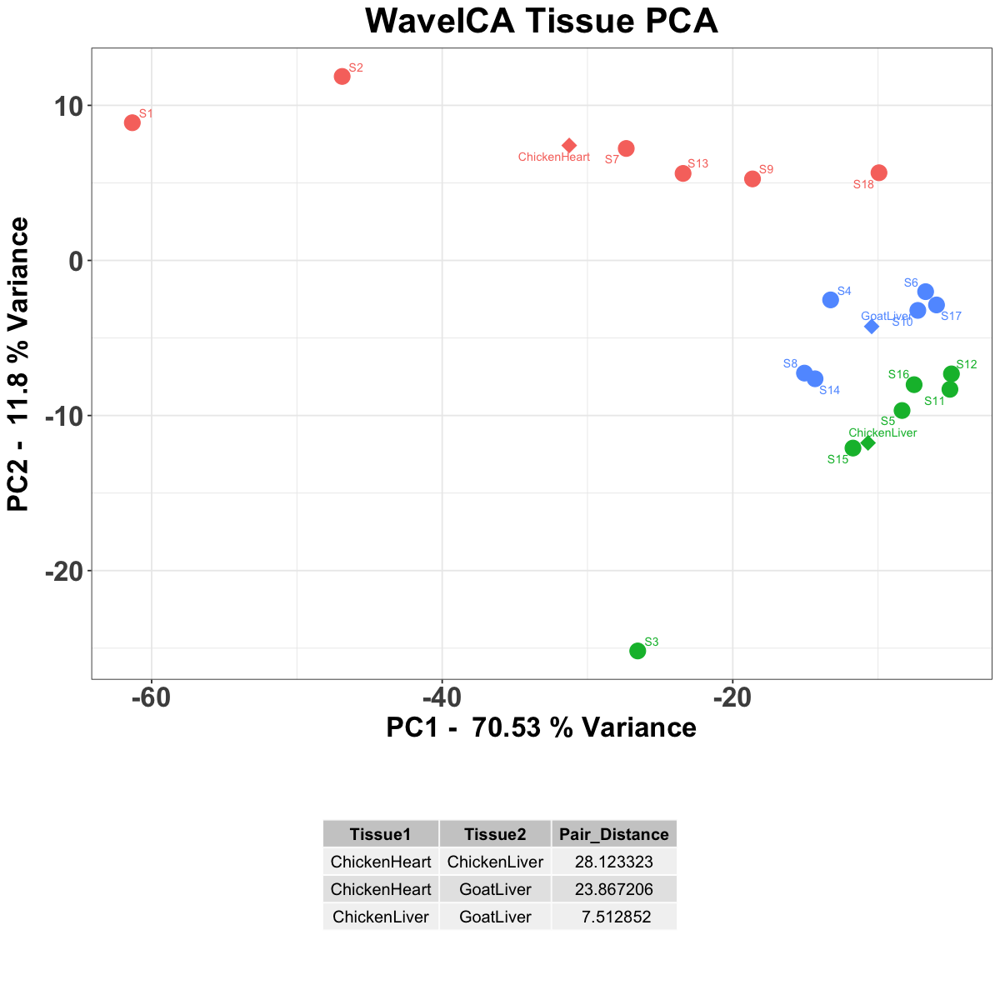

In [243]:
# WaveICA #
## Tissue with centroid PCA plot intergroup no norm ##
library(ggplot2)
library(dplyr)
library(ggrepel)
library(gridExtra)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_wave_app %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Plot tissue-only PCA with centroids, data point labels, and axis labels
tissue_plot <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  # Using geom_text_repel to prevent label overlap
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  # Add labels for data points without overlap
  labs(title = "WaveICA Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_wave_app$sdev[1]^2 / sum(batch_pca_wave_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_wave_app$sdev[2]^2 / sum(batch_pca_wave_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# calculate intergroup distance #
# Create a data frame to store pairwise distances and tissue types
# Generate all possible combinations of tissue types
tissue_combinations <- combn(unique(centroids$Type), 2, simplify = TRUE)

# Initialize an empty data frame to store pairwise distances
centroid_distances_df_wave_app <- data.frame(Tissue1 = character(), Tissue2 = character(), Pair_Distance = numeric())

# Iterate over each pair of tissue combinations
for (i in 1:ncol(tissue_combinations)) {
  tissue_pair <- tissue_combinations[, i]
  centroid1 <- centroids %>% filter(Type == tissue_pair[1])
  centroid2 <- centroids %>% filter(Type == tissue_pair[2])
  distance <- sqrt((centroid1$Centroid_PC1 - centroid2$Centroid_PC1)^2 + (centroid1$Centroid_PC2 - centroid2$Centroid_PC2)^2)
  centroid_distances_df_wave_app <- rbind(centroid_distances_df_wave_app, data.frame(Tissue1 = tissue_pair[1], Tissue2 = tissue_pair[2], Pair_Distance = distance))
}

# Create the tissue plot
tissue_intergroup_plot_wave <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  
  labs(title = "WaveICA Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_wave_app$sdev[1]^2 / sum(batch_pca_wave_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_wave_app$sdev[2]^2 / sum(batch_pca_wave_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create a table grob for centroid distances
centroid_table_wave <- tableGrob(centroid_distances_df_wave_app, rows = NULL)

# Arrange plots and table vertically
combined_plot_wave_inter_app <- grid.arrange(tissue_intergroup_plot_wave, centroid_table_wave, ncol = 1, heights = c(3, 1))
print(combined_plot_wave_inter_app)

In [244]:
# NormAE #
## Tissue with centroid PCA plot intergroup no norm ##
library(ggplot2)
library(dplyr)
library(ggrepel)
library(gridExtra)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_norm_app %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Plot tissue-only PCA with centroids, data point labels, and axis labels
tissue_plot <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  # Using geom_text_repel to prevent label overlap
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  # Add labels for data points without overlap
  labs(title = "Norm Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_norm_app$sdev[1]^2 / sum(batch_pca_norm_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_norm_app$sdev[2]^2 / sum(batch_pca_norm_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# calculate intergroup distance #
# Create a data frame to store pairwise distances and tissue types
# Generate all possible combinations of tissue types
tissue_combinations <- combn(unique(centroids$Type), 2, simplify = TRUE)

# Initialize an empty data frame to store pairwise distances
centroid_distances_df_norm_app <- data.frame(Tissue1 = character(), Tissue2 = character(), Pair_Distance = numeric())

# Iterate over each pair of tissue combinations
for (i in 1:ncol(tissue_combinations)) {
  tissue_pair <- tissue_combinations[, i]
  centroid1 <- centroids %>% filter(Type == tissue_pair[1])
  centroid2 <- centroids %>% filter(Type == tissue_pair[2])
  distance <- sqrt((centroid1$Centroid_PC1 - centroid2$Centroid_PC1)^2 + (centroid1$Centroid_PC2 - centroid2$Centroid_PC2)^2)
  centroid_distances_df_norm_app <- rbind(centroid_distances_df_norm_app, data.frame(Tissue1 = tissue_pair[1], Tissue2 = tissue_pair[2], Pair_Distance = distance))
}

# Create the tissue plot
tissue_intergroup_plot_norm <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +  
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +  
  labs(title = "Norm Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_norm_app$sdev[1]^2 / sum(batch_pca_norm_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_norm_app$sdev[2]^2 / sum(batch_pca_norm_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create a table grob for centroid distances
centroid_table_norm <- tableGrob(centroid_distances_df_norm_app, rows = NULL)

# Arrange plots and table vertically
combined_plot_norm_inter_app <- grid.arrange(tissue_intergroup_plot_norm, centroid_table_norm, ncol = 1, heights = c(3, 1))
print(combined_plot_norm_inter_app)

ERROR: Error in eval(expr, envir, enclos): 객체 'pca_data_norm_app'를 찾을 수 없습니다


TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


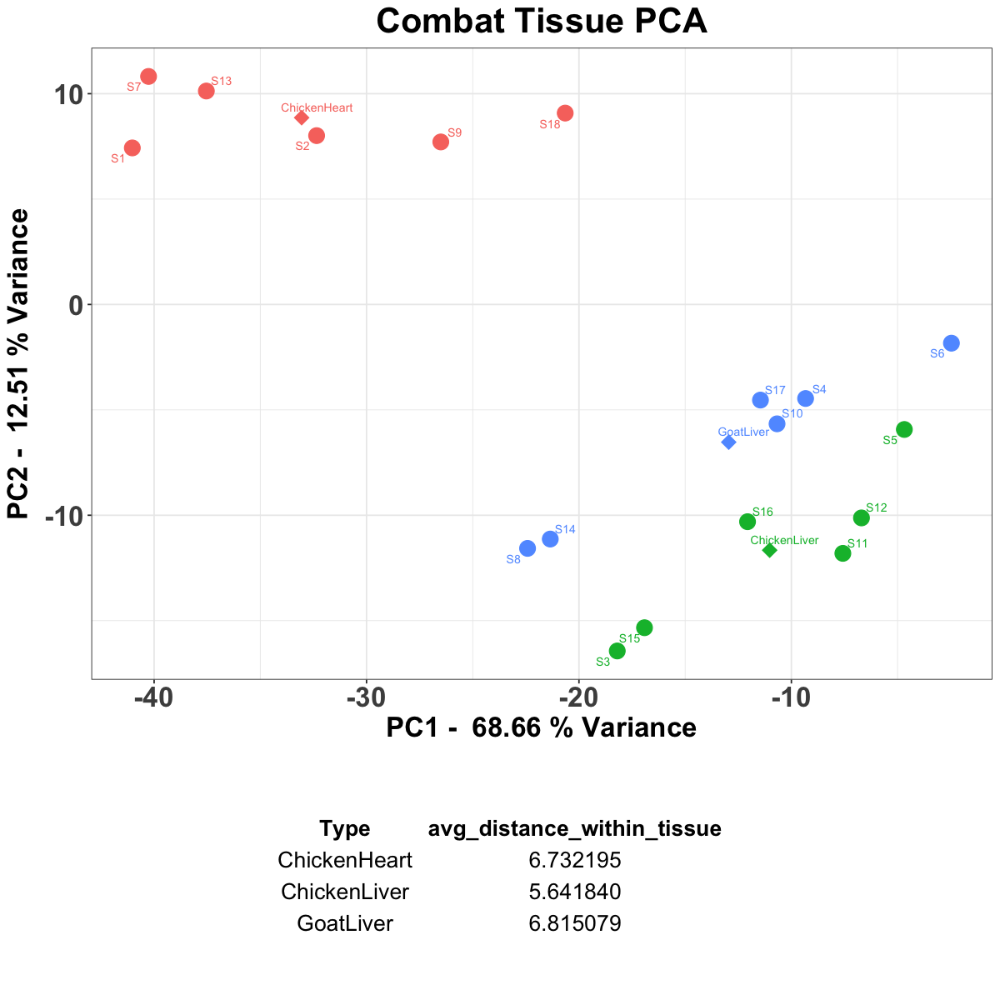

In [245]:
## Tissue PCA Plot Intragroup Combat ##
## Tissue PCA plot intragroup no norm ##
library(gridExtra)
library(dplyr)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_combat_app %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Calculate distances between each sample and its corresponding centroid within each tissue type
tissue_pca_data_with_centroids <- left_join(tissue_pca_data, centroids, by = "Type")
tissue_pca_data_with_centroids <- tissue_pca_data_with_centroids %>%
  mutate(distance_to_centroid = sqrt((PC1 - Centroid_PC1)^2 + (PC2 - Centroid_PC2)^2))

# Calculate average distance within each tissue type
tissue_avg_distances_combat_app <- tissue_pca_data_with_centroids %>%
  group_by(Type) %>%
  summarize(avg_distance_within_tissue = mean(distance_to_centroid))

# Create intragroup pca plot
tissue_intra_plot_combat <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +
  labs(title = "Combat Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_combat_app$sdev[1]^2 / sum(batch_pca_combat_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_combat_app$sdev[2]^2 / sum(batch_pca_combat_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create table plot
table_plot_combat <- tableGrob(tissue_avg_distances_combat_app, rows = NULL, theme = ttheme_minimal(base_size = 16))

# Arrange PCA plot and table plot
combined_plot_combat_intra_app <- grid.arrange(tissue_intra_plot_combat, table_plot_combat, ncol = 1, heights = c(3, 1))

# Print the combined plot
print(combined_plot_combat_intra_app)

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name               grob
1 1 (1-1,1-1) arrange     gtable[layout]
2 2 (2-2,1-1) arrange gtable[colhead-fg]


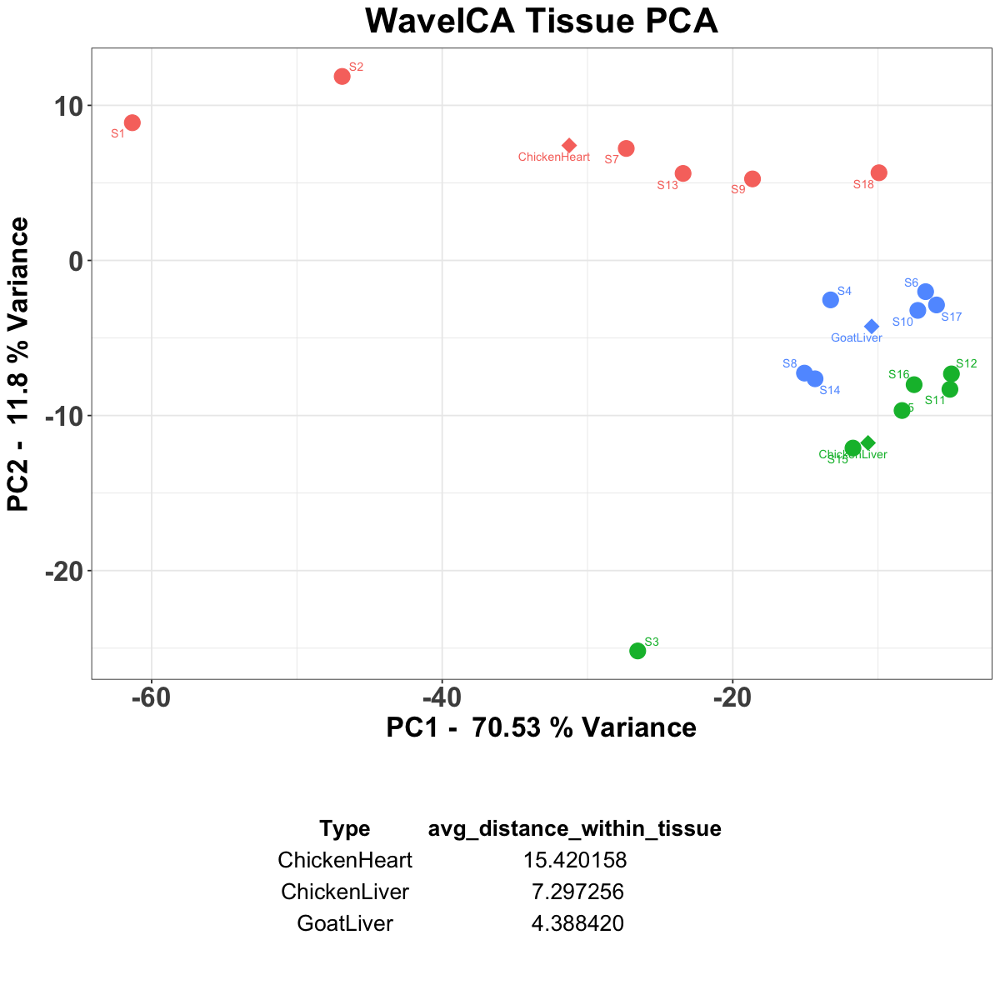

In [246]:
## Tissue PCA Plot Intragroup WaveICA ##
## Tissue PCA plot intragroup no norm ##
library(gridExtra)
library(dplyr)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_wave_app %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Calculate distances between each sample and its corresponding centroid within each tissue type
tissue_pca_data_with_centroids <- left_join(tissue_pca_data, centroids, by = "Type")
tissue_pca_data_with_centroids <- tissue_pca_data_with_centroids %>%
  mutate(distance_to_centroid = sqrt((PC1 - Centroid_PC1)^2 + (PC2 - Centroid_PC2)^2))

# Calculate average distance within each tissue type
tissue_avg_distances_wave_app <- tissue_pca_data_with_centroids %>%
  group_by(Type) %>%
  summarize(avg_distance_within_tissue = mean(distance_to_centroid))

# Create intragroup pca plot
tissue_intra_plot_wave <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +
  labs(title = "WaveICA Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_wave_app$sdev[1]^2 / sum(batch_pca_wave_app$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_wave_app$sdev[2]^2 / sum(batch_pca_wave_app$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create table plot
table_plot_wave <- tableGrob(tissue_avg_distances_wave_app, rows = NULL, theme = ttheme_minimal(base_size = 16))

# Arrange PCA plot and table plot
combined_plot_wave_intra_app <- grid.arrange(tissue_intra_plot_wave, table_plot_wave, ncol = 1, heights = c(3, 1))

# Print the combined plot
print(combined_plot_wave_intra_app)

In [247]:
## Tissue PCA plot intragroup NormAE
## Tissue PCA plot intragroup no norm ##
library(gridExtra)
library(dplyr)

options(repr.plot.width = 10, repr.plot.height = 10)  # Adjust width and height as desired

# Filter pca_data to include only tissue samples
tissue_pca_data <- pca_data_norm_app %>%
  filter(Type %in% sample_set)

# Calculate centroids for each tissue type
centroids <- tissue_pca_data %>%
  group_by(Type) %>%
  summarize(Centroid_PC1 = mean(PC1), Centroid_PC2 = mean(PC2))

# Calculate distances between each sample and its corresponding centroid within each tissue type
tissue_pca_data_with_centroids <- left_join(tissue_pca_data, centroids, by = "Type")
tissue_pca_data_with_centroids <- tissue_pca_data_with_centroids %>%
  mutate(distance_to_centroid = sqrt((PC1 - Centroid_PC1)^2 + (PC2 - Centroid_PC2)^2))

# Calculate average distance within each tissue type
tissue_avg_distances_norm_app <- tissue_pca_data_with_centroids %>%
  group_by(Type) %>%
  summarize(avg_distance_within_tissue = mean(distance_to_centroid))

# Create intragroup pca plot
tissue_intra_plot_norm <- ggplot(tissue_pca_data, aes(x = PC1, y = PC2, color = Type)) +
  geom_point(size = 5) +
  geom_point(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, color = Type), shape = 18, size = 5) +
  geom_text_repel(data = centroids, aes(x = Centroid_PC1, y = Centroid_PC2, label = Type), 
                  direction = "both", size = 3) +
  geom_text_repel(aes(label = Sample), direction = "both", size = 3) +
  labs(title = "NormAE Tissue PCA",
       x = paste("PC1 - ", round(batch_pca_norm$sdev[1]^2 / sum(batch_pca_norm$sdev^2) * 100, 2), "% Variance"),
       y = paste("PC2 - ", round(batch_pca_norm$sdev[2]^2 / sum(batch_pca_norm$sdev^2) * 100, 2), "% Variance")) +
  theme_bw() +
  theme(axis.text = element_text(size = 20, face = 'bold'), 
        axis.title = element_text(size = 20, face = 'bold'),
        plot.title = element_text(size = 25, hjust = 0.5, face = 'bold'),
        legend.position = "none")

# Create table plot
table_plot_norm <- tableGrob(tissue_avg_distances_norm_app, rows = NULL, theme = ttheme_minimal(base_size = 16))

# Arrange PCA plot and table plot
combined_plot_norm_intra_app <- grid.arrange(tissue_intra_plot_norm, table_plot_norm, ncol = 1, heights = c(3, 1))

# Print the combined plot
print(combined_plot_norm_intra_app)

ERROR: Error in eval(expr, envir, enclos): 객체 'pca_data_norm_app'를 찾을 수 없습니다


## Overview Comparision ##

In [249]:
## RSD Overview Table ##
# Create overview RSD table for Propranolol
overview_table_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  No_norm_RSD = NA,  
  TIC_norm_RSD = NA,
  IS_norm_RSD = NA,
  Combat_RSD = NA,
  WaveICA_RSD = NA,
  NormAE_RSD = NA
)

# Assign variables if they exist and their length is greater than 0
if (exists("rsd_propranolol_app") && length(rsd_propranolol_app) > 0) {
  overview_table_pro$No_norm_RSD <- rsd_propranolol_app[2]
}

if (exists("rsd_propranolol_TIC_app") && length(rsd_propranolol_TIC_app) > 0) {
  overview_table_pro$TIC_norm_RSD <- rsd_propranolol_TIC_app[2]
}

if (exists("rsd_ratio_app") && length(rsd_ratio_app) > 0) {
  overview_table_pro$IS_norm_RSD <- rsd_ratio_app[2]
}

if (exists("rsd_propranolol_combat_app") && length(rsd_propranolol_combat_app) > 0) {
  overview_table_pro$Combat_RSD <- rsd_propranolol_combat_app[2]
}

if (exists("rsd_propranolol_wave_app") && length(rsd_propranolol_wave_app) > 0) { 
  overview_table_pro$WaveICA_RSD <- rsd_propranolol_wave_app[2]
}

if (exists("rsd_propranolol_norm_app") && length(rsd_propranolol_norm_app) > 0) {
  overview_table_pro$NormAE_RSD <- rsd_propranolol_norm_app[2]
}

# Set the column names
colnames(overview_table_pro) <- c(paste("m/z value:", propranolol_mz_value),"No norm", "TIC norm", "IS norm", "Combat", "WaveICA", "NormAE")

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying overview RSD table
display_rsd_table_pro <- kable(overview_table_pro, format = "html", row.names = FALSE) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_pro <- paste("<h2 style='text-align: center;'>Overview RSD Table Propranolol</h2>", 
                               as.character(display_rsd_table_pro))

# Save HTML table to a file
display_html(display_rsd_table_pro)

# Create overview RSD table for d7-Propranolol
overview_table_d7_pro <- data.frame(
  Row_Names = c("Intraday 1", "Intraday 2", "Intraday 3", "Interday"),
  No_norm_RSD = NA,  
  TIC_norm_RSD = NA,
  IS_norm_RSD = NA,
  Combat_RSD = NA,
  WaveICA_RSD = NA,
  NormAE_RSD = NA
)

# Assign variables if they exist and their length is greater than 0
if (exists("rsd_d7_propranolol_app") && length(rsd_d7_propranolol_app) > 0) {
  overview_table_d7_pro$No_norm_RSD <- rsd_d7_propranolol_app[2]
}

if (exists("rsd_d7_propranolol_TIC_app") && length(rsd_d7_propranolol_TIC_app) > 0) {
  overview_table_d7_pro$TIC_norm_RSD <- rsd_d7_propranolol_TIC_app[2]
}

if (exists("rsd_ratio_app") && length(rsd_ratio_app) > 0) {
  overview_table_d7_pro$IS_norm_RSD <- rsd_ratio_app[2]
}

if (exists("rsd_d7_propranolol_combat_app") && length(rsd_d7_propranolol_combat_app) > 0) {
  overview_table_d7_pro$Combat_RSD <- rsd_d7_propranolol_combat_app[2]
}

if (exists("rsd_d7_propranolol_wave_app") && length(rsd_d7_propranolol_wave_app) > 0) { 
  overview_table_d7_pro$WaveICA_RSD <- rsd_d7_propranolol_wave_app[2]
}

if (exists("rsd_d7_propranolol_norm_app") && length(rsd_d7_propranolol_norm_app) > 0) {
  overview_table_d7_pro$NormAE_RSD <- rsd_d7_propranolol_norm_app[2]
}

# Set the column names
colnames(overview_table_d7_pro) <- c(paste("m/z value:", d7_propranolol_mz_value),"No Norm","TIC norm", "IS norm","Combat", "WaveICA", "NormAE")

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying overview RSD table
display_rsd_table_d7_pro <- kable(overview_table_d7_pro, format = "html", row.names = FALSE) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_d7_pro <- paste("<h2 style='text-align: center;'>Overview RSD Table D7-Propranolol</h2>", 
                               as.character(display_rsd_table_d7_pro))

# Save HTML table to a file
display_html(display_rsd_table_d7_pro)

m/z value: 260.14,No norm,TIC norm,IS norm,Combat,WaveICA,NormAE
Intraday 1,70.22%,63.3%,10.55%,57.63%,42.05%,NA
Intraday 2,41%,38.6%,13.8%,48.25%,33.04%,NA
Intraday 3,34.17%,36.6%,17.33%,38.85%,35.99%,NA
Interday,52.15%,50.78%,14.3%,48.17%,37.06%,NA


m/z value: 267.187,No Norm,TIC norm,IS norm,Combat,WaveICA,NormAE
Intraday 1,73.83%,67.07%,10.55%,59.3%,39.46%,NA
Intraday 2,39.52%,38.5%,13.8%,47.29%,30.31%,NA
Intraday 3,35.64%,36.84%,17.33%,39.29%,33.31%,NA
Interday,53.45%,53.43%,14.3%,48.71%,34.39%,NA


In [250]:
## Tissue RSD ##
## Overview RSD Table ##

# Create a function to generate HTML tables for each tissue
generate_rsd_table <- function(rsd_results, tissue_name) {
  rsd_df <- rsd_results[[tissue_name]]
  kable(rsd_df, format = "html", row.names = FALSE) %>%
    kable_styling(full_width = FALSE)
}
# Initialize an empty list to store combined HTML tables for each tissue
combined_html_list <- list()

# Iterate over each tissue type
for (tissue_name in names(rsd_results_combined_app)) {
  # Initialize rsd_tables to NULL
  rsd_table <- rsd_table_TIC <- rsd_table_combat <- rsd_table_wave <- rsd_table_norm <- "Null"

  # Try to generate rsd_tables, handle if variable is missing
  tryCatch({
    rsd_table <- generate_rsd_table(rsd_results_combined_app, tissue_name)
  }, error = function(e) NULL)
  
  tryCatch({
    rsd_table_TIC <- generate_rsd_table(rsd_results_combined_TIC_app, tissue_name)
  }, error = function(e) NULL)
  
  tryCatch({
    rsd_table_combat <- generate_rsd_table(rsd_results_combined_combat_app, tissue_name)
  }, error = function(e) NULL)
  
  tryCatch({
    rsd_table_wave <- generate_rsd_table(rsd_results_combined_wave_app, tissue_name)
  }, error = function(e) NULL)
  
  tryCatch({
    rsd_table_norm <- generate_rsd_table(rsd_results_combined_norm_app, tissue_name)
  }, error = function(e) NULL)

  # Combine HTML tables for the current tissue type horizontally
  combined_rsd_table <- paste("<h2 style='text-align: center;'>", tissue_name, " RSD Table</h2>",
                              "<div style='text-align: center;'>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>No Norm Raw Data</h3>", rsd_table, "</div>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>TIC Norm</h3>", rsd_table_TIC, "</div>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>Combat</h3>", rsd_table_combat, "</div>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>WaveICA</h3>", rsd_table_wave, "</div>",
                              "<div style='display: inline-block; margin-right: 20px; text-align: center;'>",
                              "<h3>NormAE</h3>", rsd_table_norm, "</div>",
                              "</div>")
  
  # Add the combined HTML table to the list
  combined_html_list[[tissue_name]] <- combined_rsd_table
}

# Combine HTML tables into a single HTML table with four columns
combined_html <- paste("<table style='width:100%; border-collapse: collapse;'>", 
                       "<tr>", paste("<td style='vertical-align: top;'>", 
                                     unlist(combined_html_list), 
                                     "</td>", sep = ""), "</tr></table>")

# Wrap the combined HTML content in a div with text-align: center
centered_combined_html <- paste("<div style='text-align: center;'>", combined_html, "</div>")

# Display the centered HTML content in JupyterLab
display_html(centered_combined_html)

Batch,RSD
Intraday 1,26.06 ± 8.25%
Intraday 2,24.88 ± 7.11%
Intraday 3,22.80 ± 9.89%
Interday,23.52 ± 5.77%
Batch,RSD
Intraday 1,9.55 ± 7.26%
Intraday 2,8.61 ± 5.49%
Intraday 3,9.48 ± 7.97%
Interday,13.18 ± 5.64%
Batch,RSD


TableGrob (3 x 2) "arrange": 4 grobs
        z     cells    name           grob
No Norm 1 (1-1,1-1) arrange gtable[layout]
TIC     2 (1-1,2-2) arrange gtable[layout]
Combat  3 (2-2,1-1) arrange gtable[layout]
Wave    4 (2-2,2-2) arrange gtable[layout]


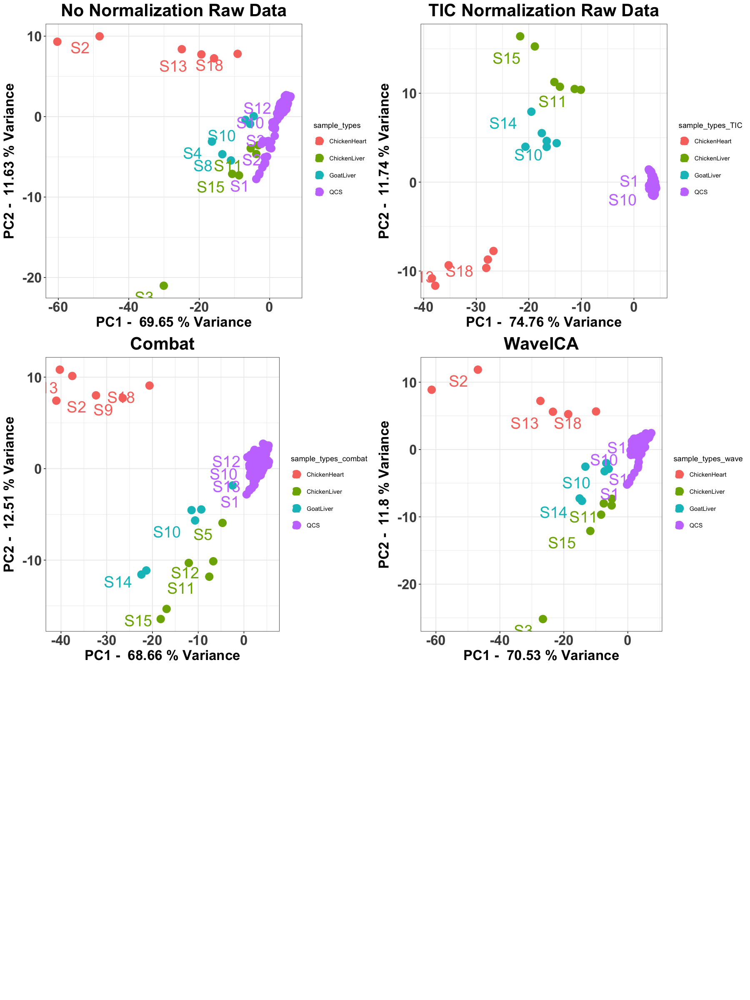

In [251]:
## PCA PLOT ##
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 20)

# Create a list to store the existing plots
plot_list <- list()

# Check if each plot exists and add it to the list
if (exists("plot_app")) {
  plot_list[["No Norm"]] <- plot_app
}

if (exists("plot_TIC_app")) {
  plot_list[["TIC"]] <- plot_TIC_app
}

if (exists("plot_combat_app")) {
  plot_list[["Combat"]] <- plot_combat_app
}

if (exists("plot_wave_app")) {
  plot_list[["Wave"]] <- plot_wave_app
}

if (exists("plot_norm_app")) {
  plot_list[["NormAE"]] <- plot_norm_app
}

# Check if any plots exist
if (length(plot_list) > 0) {
  # Arrange existing plots
  combined_plots_app <- grid.arrange(grobs = plot_list, nrow = 3)
  print(combined_plots_app)
} else {
  print("No plots to display.")
}

TableGrob (3 x 2) "arrange": 4 grobs
        z     cells    name           grob
No Norm 1 (1-1,1-1) arrange gtable[layout]
TIC     2 (1-1,2-2) arrange gtable[layout]
Combat  3 (2-2,1-1) arrange gtable[layout]
Wave    4 (2-2,2-2) arrange gtable[layout]


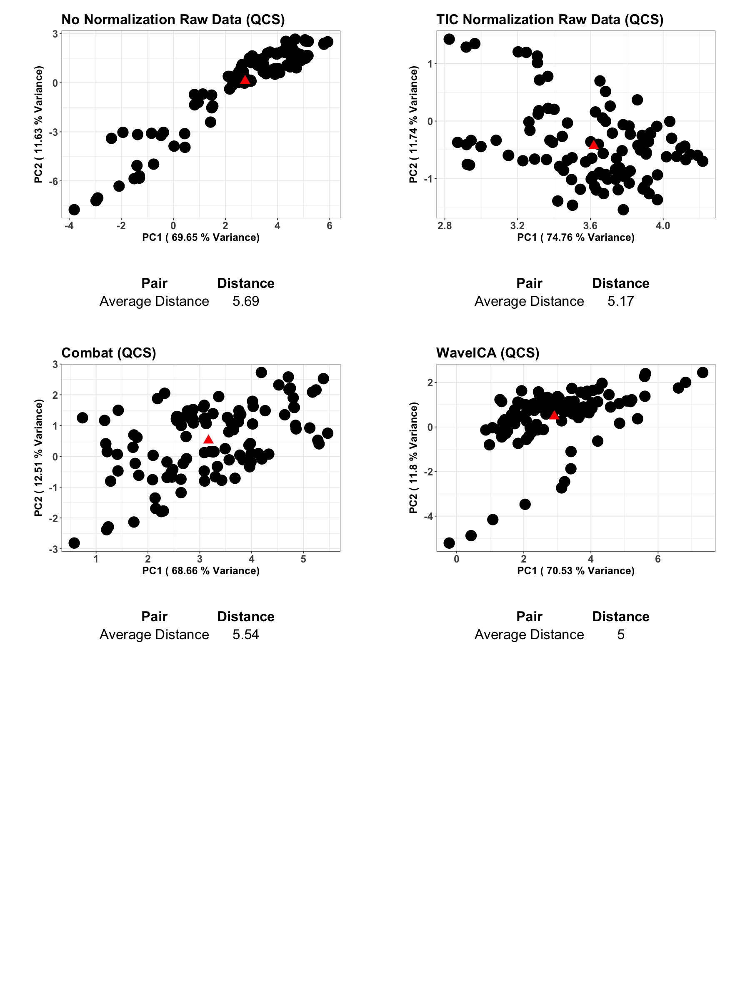

In [256]:
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 20)

# Create a list to store the existing plots
plot_list <- list()

# Check if each plot exists and add it to the list
if (exists("combined_plot_qcs_app")) {
  plot_list[["No Norm"]] <- combined_plot_qcs_app
}

if (exists("combined_plot_TIC_qcs_app")) {
  plot_list[["TIC"]] <- combined_plot_TIC_qcs_app
}

if (exists("combined_plot_combat_qcs_app")) {
  plot_list[["Combat"]] <- combined_plot_combat_qcs_app
}

if (exists("combined_plot_wave_qcs_app")) {
  plot_list[["Wave"]] <- combined_plot_wave_qcs_app
}

if (exists("combined_plot_norm_qcs_app")) {
  plot_list[["NormAE"]] <- combined_plot_norm_qcs_app
}

# Check if any plots exist
if (length(plot_list) > 0) {
  # Arrange existing plots
  combined_plots_app <- grid.arrange(grobs = plot_list, nrow = 3)
  print(combined_plots_app)
} else {
  print("No plots to display.")
}

Warning message:
“ggrepel: 9 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 10 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


TableGrob (3 x 2) "arrange": 4 grobs
        z     cells    name            grob
No Norm 1 (1-1,1-1) arrange gtable[arrange]
TIC     2 (1-1,2-2) arrange gtable[arrange]
Combat  3 (2-2,1-1) arrange gtable[arrange]
Wave    4 (2-2,2-2) arrange gtable[arrange]


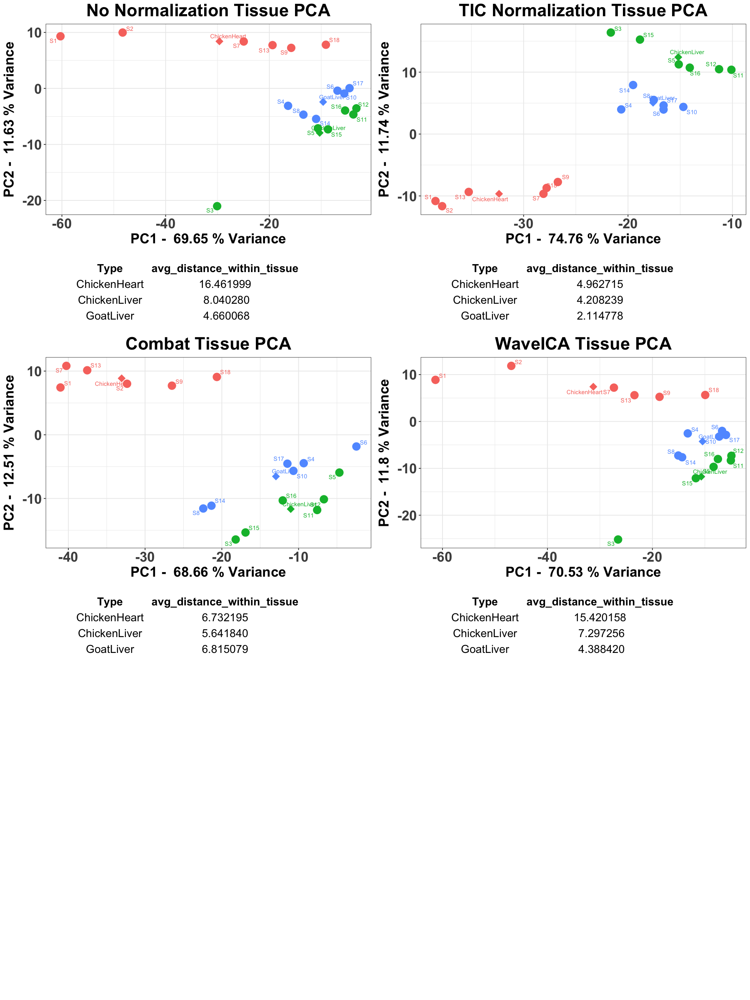

In [255]:
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 20)

# Create a list to store the existing plots
plot_list <- list()

# Check if each plot exists and add it to the list
if (exists("combined_plot_intra_app")) {
  plot_list[["No Norm"]] <- combined_plot_intra_app
}

if (exists("combined_plot_TIC_intra_app")) {
  plot_list[["TIC"]] <- combined_plot_TIC_intra_app
}

if (exists("combined_plot_combat_intra_app")) {
  plot_list[["Combat"]] <- combined_plot_combat_intra_app
}

if (exists("combined_plot_wave_intra_app")) {
  plot_list[["Wave"]] <- combined_plot_wave_intra_app
}

if (exists("combined_plot_norm_intra_app")) {
  plot_list[["NormAE"]] <- combined_plot_norm_intra_app
}

# Check if any plots exist
if (length(plot_list) > 0) {
  # Arrange existing plots
  combined_plots_app <- grid.arrange(grobs = plot_list, nrow = 3)
  print(combined_plots_app)
} else {
  print("No plots to display.")
}

Warning message:
“ggrepel: 9 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”
Warning message:
“ggrepel: 10 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


TableGrob (3 x 2) "arrange": 4 grobs
        z     cells    name            grob
No Norm 1 (1-1,1-1) arrange gtable[arrange]
TIC     2 (1-1,2-2) arrange gtable[arrange]
Combat  3 (2-2,1-1) arrange gtable[arrange]
Wave    4 (2-2,2-2) arrange gtable[arrange]


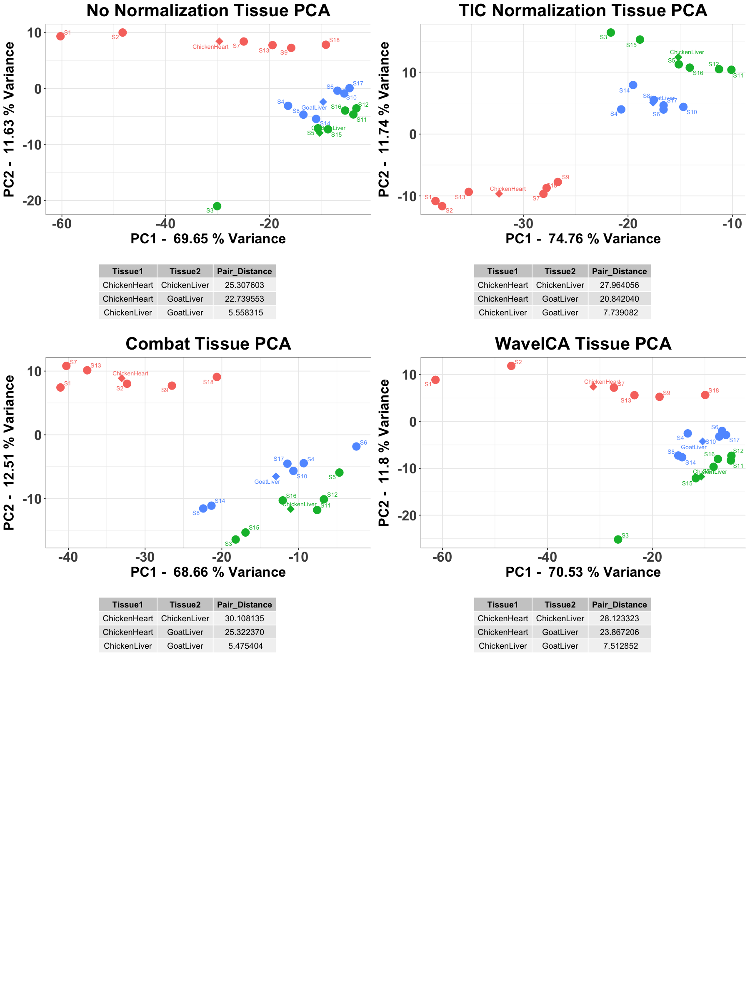

In [257]:
library(gridExtra)
options(repr.plot.width = 15, repr.plot.height = 20)

# Create a list to store the existing plots
plot_list <- list()

# Check if each plot exists and add it to the list
if (exists("combined_plot_inter_app")) {
  plot_list[["No Norm"]] <- combined_plot_inter_app
}

if (exists("combined_plot_TIC_inter_app")) {
  plot_list[["TIC"]] <- combined_plot_TIC_inter_app
}

if (exists("combined_plot_combat_inter_app")) {
  plot_list[["Combat"]] <- combined_plot_combat_inter_app
}

if (exists("combined_plot_wave_inter_app")) {
  plot_list[["Wave"]] <- combined_plot_wave_inter_app
}

if (exists("combined_plot_norm_inter_app")) {
  plot_list[["NormAE"]] <- combined_plot_norm_inter_app
}

# Check if any plots exist
if (length(plot_list) > 0) {
  # Arrange existing plots
  combined_plots_app <- grid.arrange(grobs = plot_list, nrow = 3)
  print(combined_plots_app)
} else {
  print("No plots to display.")
}

In [258]:
## Overview Average Distance Table ##
# Create separate rows for each tissue value
merged_data <- data.frame(
  Average_distances = c("QCS(centroid)", "QCS(euclidean)", "Tissue(intragroup)", "Tissue(intergroup)"),
  No_norm = NA,
  TIC_norm = NA,
  Combat_norm = NA,
  WaveICA_norm = NA,
  NormAE_norm = NA
)

# Check if variables exist and assign values if they do
if (exists("average_qcs_distance_app")) {
  merged_data$No_norm[1] <- average_qcs_distance_app
}
if (exists("average_distance_ec_app")) {
  merged_data$No_norm[2] <- average_distance_ec_app
}
if (exists("tissue_avg_distances_app")) {
  merged_data$No_norm[3] <- paste(tissue_avg_distances_app$avg_distance_within_tissue, collapse = ", ")
}
if (exists("centroid_distances_df_app")) {
  merged_data$No_norm[4] <- paste(centroid_distances_df_app$Pair_Distance, collapse = ", ")
}

# TIC normalization
if (exists("average_qcs_distance_TIC_app")) {
  merged_data$TIC_norm[1] <- average_qcs_distance_TIC_app
}
if (exists("average_distance_ec_TIC_app")) {
  merged_data$TIC_norm[2] <- average_distance_ec_TIC_app
}
if (exists("tissue_avg_distances_TIC_app")) {
  merged_data$TIC_norm[3] <- paste(tissue_avg_distances_TIC_app$avg_distance_within_tissue, collapse = ", ")
  merged_data$TIC_norm[3] <- gsub(" ", "\n", merged_data$TIC_norm[3])

}
if (exists("centroid_distances_df_TIC_app")) {
  merged_data$TIC_norm[4] <- paste(centroid_distances_df_TIC_app$Pair_Distance, collapse = ", ")
}

# Combat normalization
if (exists("average_qcs_distance_combat_app")) {
  merged_data$Combat_norm[1] <- average_qcs_distance_combat_app
}
if (exists("average_distance_ec_combat_app")) {
  merged_data$Combat_norm[2] <- average_distance_ec_combat_app
}
if (exists("tissue_avg_distances_combat_app")) {
  merged_data$Combat_norm[3] <- paste(tissue_avg_distances_combat_app$avg_distance_within_tissue, collapse = ", ") 
}
if (exists("centroid_distances_df_combat_app")) {
  merged_data$Combat_norm[4] <- paste(centroid_distances_df_combat_app$Pair_Distance, collapse = ", ")
}

# WaveICA normalization
if (exists("average_qcs_distance_wave_app")) {
  merged_data$WaveICA_norm[1] <- average_qcs_distance_wave_app
}
if (exists("average_distance_ec_wave_app")) {
  merged_data$WaveICA_norm[2] <- average_distance_ec_wave_app
}
if (exists("tissue_avg_distances_wave_app")) {
  merged_data$WaveICA_norm[3] <- paste(tissue_avg_distances_wave_app$avg_distance_within_tissue, collapse = ", ") 
}
if (exists("centroid_distances_df_wave_app")) {
  merged_data$WaveICA_norm[4] <- paste(centroid_distances_df_wave_app$Pair_Distance, collapse = ", ")
}

# NormAE normalization
if (exists("average_qcs_distance_norm_app")) {
  merged_data$NormAE_norm[1] <- average_qcs_distance_norm_app
}
if (exists("average_distance_ec_norm_app")) {
  merged_data$NormAE_norm[2] <- average_distance_ec_norm_app
}
if (exists("tissue_avg_distances_norm_app")) {
  merged_data$NormAE_norm[3] <- paste(tissue_avg_distances_norm_app$avg_distance_within_tissue, collapse = ", ") 
}
if (exists("centroid_distances_df_norm_app")) {
  merged_data$NormAE_norm[4] <- paste(centroid_distances_df_norm_app$Pair_Distance, collapse = ", ")
}

library(kableExtra)
library(htmltools)
library(IRdisplay)

# Displaying overview RSD table
display_rsd_table_pro <- kable(merged_data, format = "html", row.names = FALSE) %>%
  kable_styling(full_width = FALSE)

# Add table name
display_rsd_table_pro <- paste("<h2 style='text-align: center;'>Average Distance</h2>", 
                               as.character(display_rsd_table_pro))

# Save HTML table to a file
display_html(display_rsd_table_pro)

Average_distances,No_norm,TIC_norm,Combat_norm,WaveICA_norm,NormAE_norm
QCS(centroid),5.68792592863425,5.17055971850608,5.54384209286373,5.00398854016822,NA
QCS(euclidean),5.58888195331204,3.30956852922702,5.10418102674296,4.64411857869361,NA
Tissue(intragroup),"16.4619987446869, 8.04027981461993, 4.66006784860712","4.96271535668062, 4.20823859146443, 2.11477798959575","6.73219479272748, 5.64184045171987, 6.81507889735937","15.4201583507442, 7.2972555273052, 4.38841983846322",NA
Tissue(intergroup),"25.3076026343663, 22.7395528721276, 5.55831516021798","27.9640559221218, 20.8420400811023, 7.73908209769892","30.1081354268561, 25.3223704571915, 5.47540403755416","28.1233232805197, 23.8672059536166, 7.51285211435096",NA


## Output ##
1. csv file of each datasets --> check dataset_app
2. excel file of each datasets with rsd --> check dataset_app

In [259]:
## Excel Sheet ##
library(openxlsx)

create_batch_dataset_excel <- function(data, num_batches, propranolol_mz_value, file_name) {
  library(openxlsx)
  
  # Create a new Excel workbook
  wb <- createWorkbook()
  
  # Add sheets for Dataset, Intraday, and Interday
  sheet_names <- c("Dataset", paste0("Intraday ", 1:num_batches), "Interday")
  for (sheet_name in sheet_names) {
    addWorksheet(wb, sheet_name)
  }
  
  # Function to extract dataset for a specific batch
  extract_batch_dataset <- function(data, batch_number) {
    subset(data, batch == batch_number)
  }
  
  # Loop through each batch and write data to corresponding sheets
  for (i in 1:num_batches) {
    batch_dataset <- extract_batch_dataset(data, i)
    colnames(batch_dataset) <- sub("^X", "", colnames(batch_dataset))
    numeric_batch_dataset <- as.numeric(batch_dataset[,colnames(batch_dataset) == propranolol_mz_value, drop = TRUE])
    
    intraday_rsd <- calculate_rsd(numeric_batch_dataset)
    batch_dataset$intraday_rsd <- intraday_rsd
    batch_dataset <- as.data.frame(batch_dataset)
    
    # Write data to Intraday sheet
    writeData(wb, sheet = paste0("Intraday ", i), x = batch_dataset, rowNames = TRUE, colNames = TRUE)
  }
  
  # Calculate Interday RSD for all data
  numeric_interday_dataset <- as.numeric(data[,colnames(data) == propranolol_mz_value, drop = TRUE])
  interday_rsd <- calculate_rsd(numeric_interday_dataset)
  data$interday_rsd <- interday_rsd
  
  # Write data to Dataset and Interday sheets
  writeData(wb, sheet = "Dataset", x = data, rowNames = TRUE, colNames = TRUE)
  writeData(wb, sheet = "Interday", x = data, rowNames = TRUE, colNames = TRUE)
  
  # Save the workbook to a file
  file_path <- paste0("dataset_app/", file_name, ".xlsx")
  saveWorkbook(wb, file_path)
  
  return(file_path)
}
cat("Please change the number of batch and check the given dataset")

# Example usage:
if (exists("propranolol_data_app") && length(propranolol_data_app) > 0) {
    create_batch_dataset_excel(propranolol_data_app, 3, propranolol_mz_value, "propranolol_batch_dataset")
}
if (exists("propranolol_data_TIC_app") && length(propranolol_data_TIC_app) > 0) {
    create_batch_dataset_excel(propranolol_data_TIC_app, 3, propranolol_mz_value, "propranolol_batch_dataset_TIC")
}
if (exists("ratio_data_app") && length(ratio_data_app) > 0) {
    create_batch_dataset_excel(ratio_data_app, 3, propranolol_mz_value, "propranolol_batch_dataset_IS")
}
if (exists("propranolol_data_combat_app") && length(propranolol_data_combat_app) > 0) {
    create_batch_dataset_excel(propranolol_data_combat_app, 3, propranolol_mz_value, "propranolol_batch_dataset_combat")
}
if (exists("propranolol_data_wave_app") && length(propranolol_data_wave_app) > 0) {
    create_batch_dataset_excel(propranolol_data_wave_app, 3, propranolol_mz_value, "propranolol_batch_dataset_wave")
}
if (exists("propranolol_data_norm_app") && length(propranolol_data_norm_app) > 0) {
    create_batch_dataset_excel(propranolol_data_norm_app, 3, propranolol_mz_value, "propranolol_batch_dataset_normae")
}

Please change the number of batch and check the given dataset

[1] "dataset_app/propranolol_batch_dataset.xlsx"

[1] "dataset_app/propranolol_batch_dataset_TIC.xlsx"

[1] "dataset_app/propranolol_batch_dataset_IS.xlsx"

[1] "dataset_app/propranolol_batch_dataset_combat.xlsx"

[1] "dataset_app/propranolol_batch_dataset_wave.xlsx"